In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
from sklearn.linear_model import LinearRegression
from datetime import date, timedelta
from scipy.optimize import leastsq
#from sklearn.linear_model import LinearRegression
from matplotlib.dates import DateFormatter
from scipy.stats import chisquare

#from datetime import date, timedelta
yesterday = date.today() - timedelta(days=1)
d1 = yesterday.strftime("%Y-%m-%d")
countriesEU = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania",\
               "Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands",\
               "Denmark","Poland","Estonia","Portugal","Finland","Romania","France",\
               "Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
#x = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
d0 = date(2020, 3, 29)
d2 = date.today()
deltaT = d2 - d0
print(deltaT.days)
dT = deltaT.days
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
RkoreaCoeffs=[ 0.36242246,  2.56241634,  1.84890887,  0.13324732]
%matplotlib inline
expPopWorld = 2.67152730e+06
def moving_average(a, n=3) :
    ret = np.cumsum(a, dtype=float)
    ret[n:] = ret[n:] - ret[:-n]
    return ret[n - 1:] / n

def linreg(dfLT,population):
    
    dfLT['date'] = pd.to_datetime(dfLT['date'])
    yy = np.log(dfLT['cases'].values*10000./population)
    xx = np.array(range(dfLT['cases'].size)).reshape((-1, 1))
    model1 = LinearRegression().fit(xx, yy)
    r_sq1 = model1.score(xx, yy)
    return model1, r_sq1, dfLT

def plotpred(dfLT1, population, dateStart, dateEnd, filename, model1, country,level):
    
    #fig, ax = plt.subplots(figsize=(12, 12))
    plt.plot(dfLT1['date'].values,dfLT1['cases']*10000./population)
    date_form = DateFormatter("%m-%d")
    ax = plt.axes()
    ax.xaxis.set_major_formatter(date_form)
    ix1 = pd.date_range(dateStart, dateEnd, freq='D')
    ss1 = pd.DataFrame({'date': ix1},index=range(len(ix1)))
    y_pred1 = np.exp(model1.intercept_ + model1.coef_ * range(len(ix1)))
    ax.plot(ss1['date'].values,y_pred1)
    plt.xticks(rotation=90)
    plt.title(country)
    plt.ylabel('Tolat COVID-19 cases per 10000')
    ax.fill_between(ss1['date'].values, 1,level, facecolor='red', alpha=0.3)
    ax.fill_between(ss1['date'].values, yc,1, facecolor='m', alpha=0.3)
    ax.fill_between(ss1['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
    plt.xlabel('Date')
    #plt.yscale('log')
    plt.yscale('log')
    plt.grid()
    plt.savefig(filename)
    plt.show()
    ss1a = pd.DataFrame({'cases': (y_pred1*population/10000).astype(int)},index=range(len(y_pred1)))
    ss1t = pd.concat([ss1,ss1a], axis=1)
    return ss1t

def forecast(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases',pMAPE=True):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))#+coeffs[0]*.25/(1 + np.exp( - coeffs[1] * (t - 3.5*coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    if pMAPE:
        print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: logistic')
    print('coeffs: ',x)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    if cases=='cases':
        print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0)) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print(output)
    return x

def forecast2(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'bi-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: bi-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("bi-logistic approximation splitting point: %d"%(vL))
    print(output0)
    print(output)
    return x

def forecast3(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))+coeffsUS[3]/(1 + np.exp( - coeffsUS[4] * (t - coeffsUS[5])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendS1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: tri-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('forecast rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("tri-logistic approximation splitting points: %d,%d"%(vL[0],vL[1]))
    print(output0)
    print(output1)
    print(output)
    
    return x

def trend3(dfLV,dfLT1,dfES,lLV,lLT,lES,pLV,pLT,pES):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #dfLT1 = pd.read_csv("~/Desktop/coronaLT1.csv",",")
    y = np.log(np.diff(dfLT1["cases"].values)[:]/dfLT1["cases"].values[1:]**2)
    x = np.array(range(len(dfLT1["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLT)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLT) 
    plt.plot(range(len(x)+pLT),y_pred12,label='%s tr'%(lLT))

    y = np.log(np.diff(dfES["cases"].values)[:]/dfES["cases"].values[1:]**2)
    x = np.array(range(len(dfES["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lES)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pES) 
    plt.plot(range(len(x)+pES),y_pred12,label='%s tr'%(lES))
    plt.xlabel('t, days')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("pictures/logdifflogcorna%s%s%s.png"%(lLV,lLT,lES))
    plt.show()
    
def trend(dfLV,lLV,pLV):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    plt.xlabel('t [days]')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("pictures/logdifflogcorna%s.png"%(lLV))
    plt.show()

def trendS(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendS0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[:vL], y[:vL])
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend0 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x[:vL])+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL])+pLV,y_pred12, output

def trendS1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output
    
def forecastR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t, output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: Richards')
    print('coeffs: ',x)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1])) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print (output)
    return x

def forecast2R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] *coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])-coeffs2[0]/(1 + np.exp( - coeffs2[3] *coeffs2[1] * (tt - coeffs2[2])))**(1./coeffs2[3])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: bi-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print(output)
    return x

def forecast3R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] * coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])+coeffsUS[4]/(1 + np.exp( - coeffsUS[7] * coeffsUS[5] * (t - coeffsUS[6])))**(1./coeffsUS[7])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(waveform_1-model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel-6*diffStd0*np.ones(len(tt)),allmodel+6*diffStd0*np.ones(len(tt)), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model']) 
    ax2.set_xlabel('t, days')
    ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(np.diff(waveform_1)-np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)-3*diffStd*np.ones(len(tt)-1), np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t [days]')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s_R.png"%(Cntr))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    rint('model: tri-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    print('\t total death: ', int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0]))
    print(output)
    return x

def get_cases(df,threshold):    
    dfA = df[df[['Country','TotCasesper1Mpop']].TotCasesper1Mpop>=threshold]
    #y = df[df['Country','TotCasesper1Mpop'].TotCasesper1Mpop>=56.]
    dfA = dfA.sort_values(by=['TotCasesper1Mpop'], ascending=False)
    country = dfA['Country']
    #country = country.tolist()
    cases = dfA['TotCasesper1Mpop']/100
    #case = cases.tolist()
    return country, cases

def stat_picture(country, cases, high=35, picname="pictures/coronage0.png"):
# Import the necessary packages and modules


    # Prepare the data
    #x = dfA['Country']
    fig = plt.figure( figsize=(6, high))
    fig.subplots_adjust(bottom=0.2, left=0.1)
    # Plot the data
    y_pos = cases
    #barh(y_pos, performance, xerr=error, align='center')
    plt.barh(country,y_pos)
    #plt.xticks(rotation=90)
    plt.xlabel('COVID-19 cases per 10000')
    # Add a legend
    plt.legend()
    ax = plt.axes() 
    x = range(len(country))
    ax.fill_betweenx(x, 1,1000, facecolor='red', alpha=0.3)
    yc = 0.56
    ax.fill_betweenx(x, yc,1, facecolor='m', alpha=0.3)
    ax.fill_betweenx(x, 1e-4,yc, facecolor='y', alpha=0.3)
    plt.vlines(yc, 0, len(country)-1, colors='g', linestyles='solid')
    #plt.ylim([1e-2,60])
    ax.xaxis.grid() # horizontal lines
    #ax.xaxis.grid() # vertical lines

    ax.set_yticks(range(len(country)))
    ax.set_yticklabels(country)
    #ax.invert_yaxis()
    plt.xscale("log")
    # Show the plot

    plt.savefig(picname, bbox_inches='tight')
    plt.show()
    
def read_df(dfRM,lRM):
    dfRM = pd.read_csv("data/corona%s.csv"%(lRM),",")
    dfRM['date'] = pd.to_datetime(dfRM['date'])
    print("%s\n"%(lRM),dfRM.tail())
    return dfRM

63


In [2]:
from sklearn.linear_model import Ridge
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline

def forecastRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    locStr = 'upper left'
    if Cntr in ['New Zealand']:
        locStr = 'lower right'
    ax2.legend(['COVID-19 %s'%(Cntr), 'Richards','-3days'],loc=locStr) 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecastRRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]) )))#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast2RRR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * ((t- coeffsUS[2])*(t- coeffsUS[3]))))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    24.31714688, 0.00530186**2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-logisticQ approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast3RRR(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])* (t - coeffsUS[3])))+coeffsUS[4]/(1 + np.exp( - coeffsUS[5] * (t - coeffsUS[6])* (t - coeffsUS[7])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.01 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendSQ1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: tri-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "tri-logisticQ approximation splitting points: %d,%d"%(vL[0],vL[1])
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output1)
    ff.write(output1.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def trendSQ(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL:], y[vL:]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSQ0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[:vL], y[:vL]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL]),y_pred12, output

def trendSQ1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL[1], np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL[1]]),y_pred12, output

def trendSS(dfLV,vL=0,pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSS0(dfLV,vL=0,pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[:vL], y[:vL])
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

In [3]:
def forecastQR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * coeffs[4] * ((t- coeffs[2])*(t- coeffs[3]) )))**(1./coeffs[4])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001, 5.0e-2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3],xcoef[4]*x[4]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3],xcoef[4]*x_1[4]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'RichardsQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_QR.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_QR.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: RichardsQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x


def forecast2RR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)   
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3]*coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL,nu=x[3])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-Richards approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast2QR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)   
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[4]*coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))**(1./coeffs[4])+coeffsUS[0]/(1 + np.exp( - coeffsUS[4]*coeffsUS[1] * (t - coeffsUS[2])* (t - coeffsUS[3])))**(1./coeffsUS[4])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[4]*coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))**(1./coeffs[4])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001, 5.0e-2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-logisticQ approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

In [21]:
dfp = pd.read_csv("data/population.csv",",")
#dfp[dfp['Country (or dependency)']=='China'].Population.tolist()[0]
dfp.head()

,Country (or dependency),Population,Yearly Change,Net Change,Density (P/Km²),Land Area (Km²),Migrants (net),Fert. Rate,Med. Age,Urban Pop %,World Share
0,World,7774108745,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,European Union,445250514,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,China,1439323776,0.39 %,5540090.0,153.0,9388211.0,-348399.0,1.7,38,61 %,18.47 %
3,India,1380004385,0.99 %,13586631.0,464.0,2973190.0,-532687.0,2.2,28,35 %,17.70 %
4,United States,331002651,0.59 %,1937734.0,36.0,9147420.0,954806.0,1.8,38,83 %,4.25 %


In [22]:
popEU = sum(dfp[dfp["Country (or dependency)"].isin(countriesEU) ].Population)

In [23]:
#df = pd.read_csv("~/Desktop/coronaAllT.csv","\t")
df = pd.read_csv("data/coronaAll_%s.csv"%(d1),",")
dfAll = df#pd.read_csv("~/Desktop/coronaAll_2020-03-28.csv",",")

In [24]:
df.head()

,#,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,NaN,1250003,North America,North America,NaN,3635.0,386.0,NaN,19435.0,NaN,2044468,123858.0,670607.0,NaN,NaN
1,NaN,461707,South America,South America,NaN,2389.0,25.0,NaN,11281.0,NaN,847008,39340.0,345961.0,NaN,NaN
2,NaN,852704,Europe,Europe,NaN,14.0,1.0,NaN,8796.0,NaN,2004240,173281.0,978255.0,NaN,NaN
3,NaN,408494,Asia,Asia,NaN,4954.0,98.0,NaN,13578.0,NaN,1112475,30305.0,673676.0,NaN,NaN
4,NaN,78690,Africa,Africa,NaN,NaN,NaN,NaN,370.0,NaN,143769,4092.0,60987.0,NaN,NaN


In [25]:
df.tail()

,#,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
225,NaN,408494,Asia,Total:,NaN,4954.0,98.0,NaN,13578.0,NaN,1112475,30305.0,673676.0,NaN,NaN
226,NaN,78690,Africa,Total:,NaN,NaN,NaN,NaN,370.0,NaN,143769,4092.0,60987.0,NaN,NaN
227,NaN,483,Australia/Oceania,Total:,NaN,10.0,NaN,NaN,4.0,NaN,8804,125.0,8196.0,NaN,NaN
228,NaN,55,NaN,Total:,NaN,NaN,NaN,NaN,4.0,NaN,721,15.0,651.0,NaN,NaN
229,NaN,306992,Europe,European Union,283.550487,14.0,1.0,NaN,4239.0,44447.140155,1201370,126251.0,727821.0,19790112.0,2698.188912


In [26]:
dfAll.head()

,#,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,NaN,1250003,North America,North America,NaN,3635.0,386.0,NaN,19435.0,NaN,2044468,123858.0,670607.0,NaN,NaN
1,NaN,461707,South America,South America,NaN,2389.0,25.0,NaN,11281.0,NaN,847008,39340.0,345961.0,NaN,NaN
2,NaN,852704,Europe,Europe,NaN,14.0,1.0,NaN,8796.0,NaN,2004240,173281.0,978255.0,NaN,NaN
3,NaN,408494,Asia,Asia,NaN,4954.0,98.0,NaN,13578.0,NaN,1112475,30305.0,673676.0,NaN,NaN
4,NaN,78690,Africa,Africa,NaN,NaN,NaN,NaN,370.0,NaN,143769,4092.0,60987.0,NaN,NaN


In [27]:
dfAll.fillna(0, inplace=True)
dfAll[dfAll["Country"]=="Lithuania"]

,#,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
102,96.0,371,Europe,Lithuania,26.0,0.0,0.0,"2,725,125",17.0,109877.0,1670,70.0,1229.0,299428.0,613.0


No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


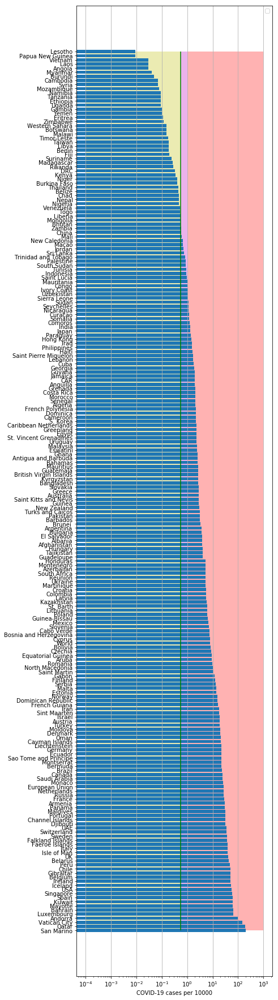

In [28]:
country, cases = get_cases(df,0.01)
country.values, cases.values
stat_picture(country.values, cases.values, high=35, picname="pictures/coronage0.png")

No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


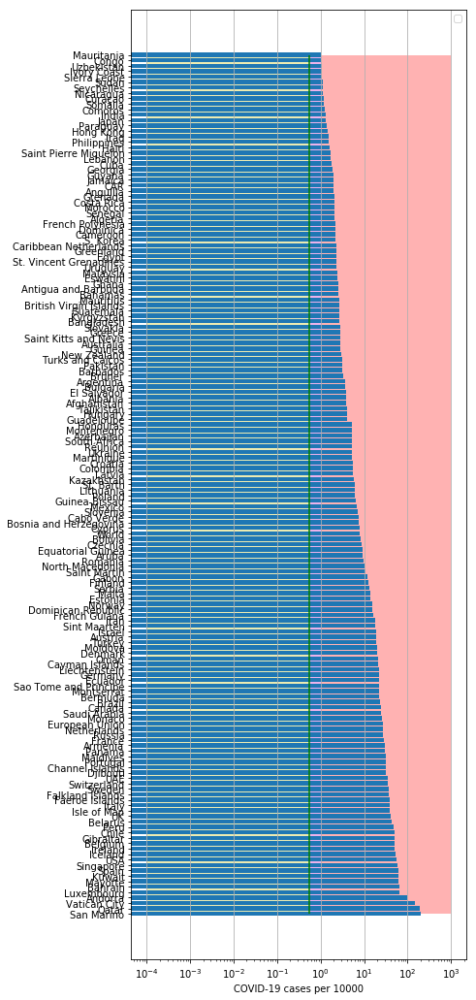

In [29]:
country, cases = get_cases(df,100.0)
stat_picture(country.values, cases.values, high=20, picname="pictures/coronage1.png")

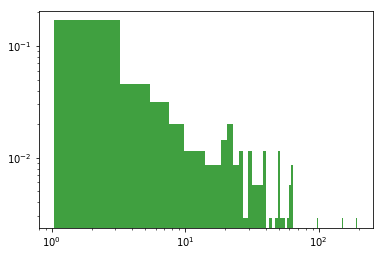

In [30]:
n, bins, patches = plt.hist(cases, 90, density=True,facecolor='g', alpha=0.75)
plt.yscale("log")
plt.xscale("log")

In [31]:
dfSP = read_df(pd.DataFrame(),"SP")
dfGB = read_df(pd.DataFrame(),"GB")
dfIT = read_df(pd.DataFrame(),"IT")
dfLT = read_df(pd.DataFrame(),"LT")
dfUkr = read_df(pd.DataFrame(),"Ukr")
dfUS = read_df(pd.DataFrame(),"US")
dfCN = read_df(pd.DataFrame(),"CN")
dfFR = read_df(pd.DataFrame(),"FR")
dfKR = read_df(pd.DataFrame(),"KR")
dfW = read_df(pd.DataFrame(),"World")
dfDK = read_df(pd.DataFrame(),"DK")
dfNG = read_df(pd.DataFrame(),"NG")
dfGR = read_df(pd.DataFrame(),"GR")
dfES = read_df(pd.DataFrame(),"ES")
dfSW = read_df(pd.DataFrame(),"SW")
dfPL = read_df(pd.DataFrame(),"PL")
dfIS = read_df(pd.DataFrame(),"IS")
dfUR = read_df(pd.DataFrame(),"Ukr")
dfSZ = read_df(pd.DataFrame(),"SZ")
dfIN = read_df(pd.DataFrame(),"IN")
#dfKRA = read_df(pd.DataFrame(),"KRA")
dfRS = read_df(pd.DataFrame(),"RS")
dfJP = read_df(pd.DataFrame(),"JP")
dfNL = read_df(pd.DataFrame(),"NL")
dfAT = read_df(pd.DataFrame(),"AT")
dfBG = read_df(pd.DataFrame(),"BG")
dfSG = read_df(pd.DataFrame(),"SG")
dfLV = read_df(pd.DataFrame(),"LV")
dfCA = read_df(pd.DataFrame(),"CA")
dfPT = read_df(pd.DataFrame(),"PT")
dfTR = read_df(pd.DataFrame(),"TR")
dfBZ = read_df(pd.DataFrame(),"BZ")
dfAS = read_df(pd.DataFrame(),"AS")
dfML = read_df(pd.DataFrame(),"ML")
dfZL = read_df(pd.DataFrame(),"ZL")
dfBR = read_df(pd.DataFrame(),"BR")
dfIR = read_df(pd.DataFrame(),"IR")
dfCL = read_df(pd.DataFrame(),"CL")
dfCH = read_df(pd.DataFrame(),"CH")
dfRM = read_df(pd.DataFrame(),"RM")
dfFI = read_df(pd.DataFrame(),"FI")
dfID = read_df(pd.DataFrame(),"ID")
dfED = read_df(pd.DataFrame(),"ED")
dfPH = read_df(pd.DataFrame(),"PH")
#dfPK = read_df(pd.DataFrame(),"PK")
dfLX = read_df(pd.DataFrame(),"LX")
dfTH = read_df(pd.DataFrame(),"TH")
dfIE = read_df(pd.DataFrame(),"IE")
dfMX = read_df(pd.DataFrame(),"MX")
dfPM = read_df(pd.DataFrame(),"PM")
dfPU = read_df(pd.DataFrame(),"PU")
dfSB = read_df(pd.DataFrame(),"SB")
dfAG = read_df(pd.DataFrame(),"AG")
dfCT = read_df(pd.DataFrame(),"CT")
dfEG = read_df(pd.DataFrame(),"EG")
dfSV = read_df(pd.DataFrame(),"SV")
dfMR = read_df(pd.DataFrame(),"MR")
dfIQ = read_df(pd.DataFrame(),"IQ")
dfIC = read_df(pd.DataFrame(),"IC")
dfQR = read_df(pd.DataFrame(),"QR")
dfCB = read_df(pd.DataFrame(),"CB")
dfBL = read_df(pd.DataFrame(),"BL")
dfAG = read_df(pd.DataFrame(),"AR")
dfEU = read_df(pd.DataFrame(),"EU")
dfMT = read_df(pd.DataFrame(),"MT")
dfCP = read_df(pd.DataFrame(),"CP")

SP
          date   cases  active    death
91 2020-05-26  283339   59264  27117.0
92 2020-05-27  283849   59773  27118.0
93 2020-05-28  284986   60909  27119.0
94 2020-05-29  285644   61565  27121.0
95 2020-05-30  286308   62225  27125.0
GB
          date   cases  active    death
90 2020-05-26  265227       0  37048.0
91 2020-05-27  267240       0  37460.0
92 2020-05-28  269127       0  37837.0
93 2020-05-29  271222       0  38161.0
94 2020-05-30  272826       0  38376.0
IT
          date   cases  active    death
93 2020-05-26  230555   52942  32955.0
94 2020-05-27  231139   50966  33072.0
95 2020-05-28  231732   47986  33142.0
96 2020-05-29  232248   46175  33229.0
97 2020-05-30  232664   43691  33340.0
LT
          date   cases  active  death     tests
78 2020-05-26  1647.0     389   66.0  281232.0
79 2020-05-27  1656.0     395   68.0  287982.0
80 2020-05-28  1662.0     370   68.0  294091.0
81 2020-05-29  1670.0     362   70.0  299428.0
82 2020-05-30  1670.0     371   70.0       NaN


SB
          date  cases  active  death
77 2020-05-26  11227  4921.0  239.0
78 2020-05-27  11275  4758.0  240.0
79 2020-05-28  11300  4621.0  241.0
80 2020-05-29  11354  4588.0  242.0
81 2020-05-30  11381  4533.0  242.0
AG
          date    cases   active  death
83 2020-05-26  13228.0   8577.0  484.0
84 2020-05-27  13933.0   9084.0  500.0
85 2020-05-28  14702.0   9577.0  508.0
86 2020-05-29  15419.0  10111.0  520.0
87 2020-05-30  16214.0  10898.0  528.0
CT
          date   cases  active  death
87 2020-05-26  2244.3    97.0  101.0
88 2020-05-27  2244.4    96.0  101.0
89 2020-05-28  2245.0    92.0  102.0
90 2020-05-29  2245.0    83.0  103.0
91 2020-05-30  2246.0    80.0  103.0
EG
          date  cases  active  death
81 2020-05-26  18756   12932  797.0
82 2020-05-27  19666   13645  816.0
83 2020-05-28  20793   14589  845.0
84 2020-05-29  22082   15692  879.0
85 2020-05-30  23449   16843  913.0
SV
          date   cases  active  death
82 2020-05-26  1471.0     9.0  108.0
83 2020-05-27  147

In [32]:
dfBL = dfBL.fillna(0)
dfRM = dfRM.fillna(0)
dfSV = dfSV.fillna(0)
dfCT = dfCT.fillna(0)
#dfAR = dfAR.fillna(0)
dfSB = dfSB.fillna(0)
dfCP = dfCP.fillna(0)
dfID = dfID.fillna(0)
dfAG = dfAG.fillna(0)
dfMX = dfMX.fillna(0)
dfPU = dfPU.fillna(0)
dfIQ = dfIQ.fillna(0)
dfIE = dfIE.fillna(0)
dfPH = dfPH.fillna(0)
dfTH = dfTH.fillna(0)
dfMR = dfMR.fillna(0)
dfCP = dfCP.fillna(0)

In [33]:
from sklearn.linear_model import LinearRegression
populationSp = dfp[dfp['Country (or dependency)']=='Spain'].Population.tolist()[0]
y = np.log(dfSP['cases'].values*10000./populationSp)
x = np.array(range(dfSP['cases'].size)).reshape((-1, 1))
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)


coefficient of determination: 0.6847953317404266
intercept: -1.7242331966527211
slope: [0.08227581]


/usr/local/lib/python3.5/dist-packages/pandas/plotting/_converter.py:129: FutureWarning: Using an implicitly registered datetime converter for a matplotlib plotting method. The converter was registered by pandas on import. Future versions of pandas will require you to explicitly register matplotlib converters.

To register the converters:
	>>> from pandas.plotting import register_matplotlib_converters
	>>> register_matplotlib_converters()
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


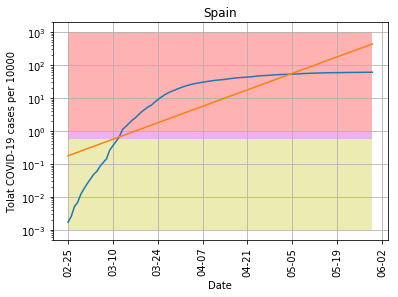

In [34]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
yc = 0.56
plt.plot(dfSP['date'].values,dfSP['cases']*10000./populationSp)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix = pd.date_range('2020-02-25', '2020-05-30', freq='D')
ss = pd.DataFrame({'date': ix})
y_pred = np.exp(model.intercept_ + model.coef_ * range(len(ix)))
ax.plot(ss['date'].values,y_pred)
plt.xticks(rotation=90)
plt.title('Spain')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
plt.yscale('log')
plt.grid()
plt.savefig("pictures/coronaSP.png")
plt.show()

In [35]:
populationUK = dfp[dfp['Country (or dependency)']=='United Kingdom'].Population.tolist()[0]
model1, r_sql, dfGB1 = linreg(dfGB,populationUK)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.8147711886057731
intercept: -3.3596613174799117
slope: [0.0957397]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


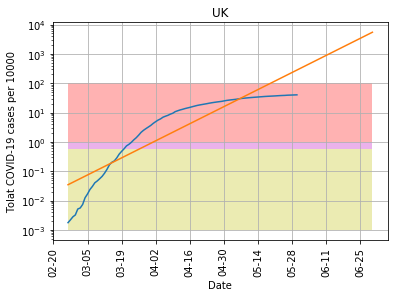

In [37]:
ss1t = plotpred(dfGB1,populationUK,'2020-02-26', '2020-06-30', "pictures/coronaGB.png", model1, 'UK',100)

In [38]:
populationIT = dfp[dfp['Country (or dependency)']=='Italy'].Population.tolist()[0]
coefIT = 4.0378751-0.3
yy1 = np.log(coefIT-np.log(dfIT['cases'].values*10000./populationIT))
xx1 = np.array(range(dfIT['cases'].size)).reshape((-1, 1))
model11 = LinearRegression().fit(xx1, yy1)
r_sq1 = model11.score(xx1, yy1)
print('coefficient of determination:', r_sq1)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.9855844942474976
intercept: 1.7899073869162563
slope: [-0.04771709]


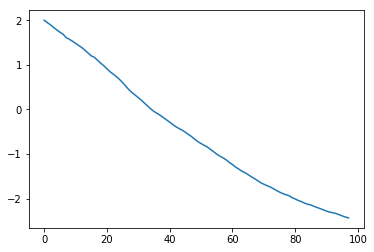

In [39]:
plt.plot(xx1,yy1)

/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


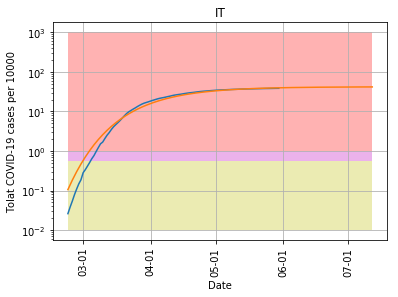

In [40]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
plt.plot(dfIT['date'].values,dfIT['cases']*10000./populationIT)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix11 = pd.date_range('2020-02-23', '2020-07-12', freq='D')
ss11 = pd.DataFrame({'date': ix11})
y_pred11 = np.exp(coefIT-np.exp(model11.intercept_ + model11.coef_ * range(len(ix11))))
ax.plot(ss11['date'].values,y_pred11)
plt.xticks(rotation=90)
plt.title('IT')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss11['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss11['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss11['date'].values, 1e-2,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
#plt.yscale('log')
plt.grid()
plt.savefig("pictures/coronaIT.png")
plt.show()

In [41]:
cs=y_pred11[-1]/10000.*populationIT

In [42]:
cs

252089.56034481508

In [43]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
model1, r_sql, dfLT1 = linreg(dfLT[1:],populationLT)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.598249884545913
intercept: -1.6328235665650885
slope: [0.05708453]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


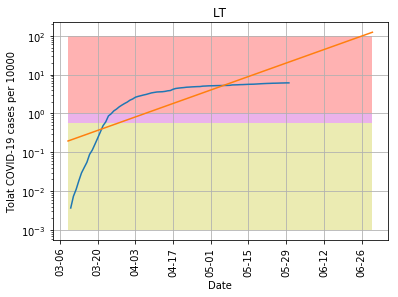

In [44]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
ss1t = plotpred(dfLT[1:],populationLT,'2020-03-09', '2020-06-30', "pictures/coronaLT.png", model1, 'LT',100)

In [45]:
populationUKr = dfp[dfp['Country (or dependency)']=='Ukraine'].Population.tolist()[0]
model11, r_sql, dfUkr1 = linreg(dfUkr, populationUKr)
print('coefficient of determination:', r_sql)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.8195193349595585
intercept: -5.1351743368308265
slope: [0.10486853]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


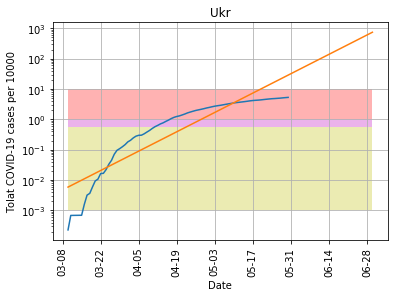

In [46]:
ss1t1 = plotpred(dfUkr1,populationUKr,'2020-03-10', '2020-06-30', "pictures/coronaUkr.png", model11, 'Ukr',10)

No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


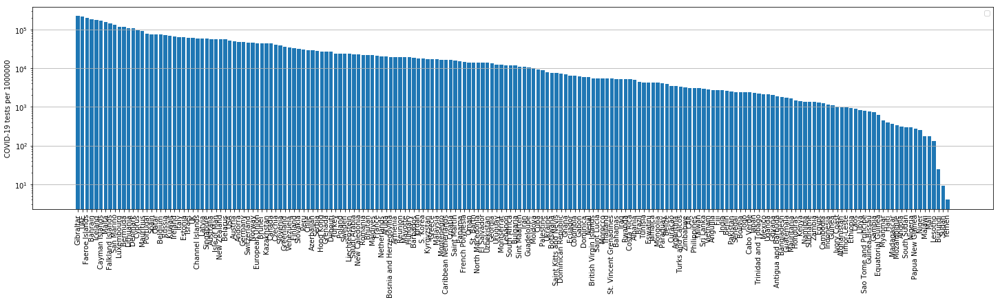

In [47]:
# Prepare the data
dfTs = dfAll
dfTs = dfTs.sort_values(by=['Testsper1Mpop'], ascending=False)
dfTs = dfTs[dfTs['Testsper1Mpop']>0]
x = dfTs['Country']
y = dfTs['Testsper1Mpop']
fig = plt.figure( figsize=(25, 6))
fig.subplots_adjust(bottom=0.2)
# Plot the data
plt.bar(x, y)

plt.xticks(rotation=90)
plt.ylabel('COVID-19 tests per 1000000')
# Add a legend
plt.legend()
ax = plt.axes() 
#ax.fill_between(x, 1,10, facecolor='red', alpha=0.3)
yc = 0.56
#ax.fill_between(x, yc,1, facecolor='m', alpha=0.3)
#ax.fill_between(x, 1e-4,yc, facecolor='y', alpha=0.3)
#plt.hlines(yc, 0, len(df)-1, colors='g', linestyles='solid')
#plt.ylim([1e-4,10])
ax.yaxis.grid() # horizontal lines
#ax.xaxis.grid() # vertical lines
plt.yscale("log")
# Show the plot
plt.savefig("pictures/coronaTests.png")
plt.show()

In [48]:
populationUS= dfp[dfp['Country (or dependency)']=='United States'].Population.tolist()[0]
model11, r_sql, dfUS1 = linreg(dfUS, populationUS)
print('coefficient of determination:', r_sql)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.7738572001646092
intercept: -2.815037582596358
slope: [0.09728733]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


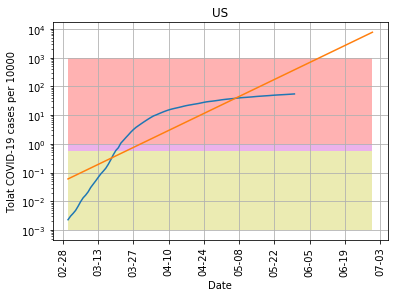

In [49]:
ss1t = plotpred(dfUS1,populationUS,'2020-03-01', '2020-06-30', "pictures/coronaUS.png", model11, 'US',1000)

In [50]:
dfAll[dfAll["Country"]=="Latvia"]
dfAll.fillna(0, inplace=True)

North America
            Country         0
229  European Union  0.105089


(0, 0.15)

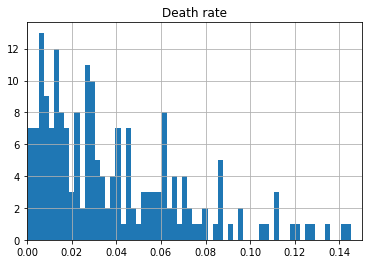

In [51]:
dfT1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
print(dfTT.Country[0])
print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
hist = dfTTh[dfTTh[0]>0].hist(bins=9*12)
plt.title("Death rate")
plt.xlim([0,0.15])

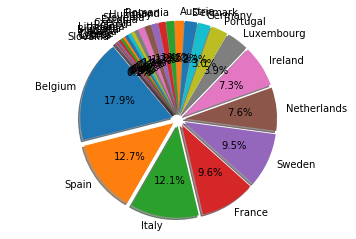

In [52]:
cLst = countriesEU
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
#dfD1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["Deathsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfTTh = dfTT.sort_values(by=["Deathsper1Mpop"], ascending=False)
dfTTh.rename(columns={0: "DeathRate"})
#hist = dfTTh.hist(bins=9*16)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])
#plt.show()
#import matplotlib.pyplot as plt

labels = dfTTh.Country.tolist()#'apple', 'banana', 'cherry', 'durian', 'elderberries', 'figs', 'grapes'
sizes = dfTTh.Deathsper1Mpop.values#[32, 20, 15, 10, 10, 8, 5]

p = plt.pie(sizes, labels=labels, explode=(.07,)*len(sizes), autopct='%1.1f%%', startangle=130, shadow=True)
plt.axis('equal')

            
plt.show()

In [53]:
dfTTh.head()

,Country,Deathsper1Mpop
24,Belgium,816.0
10,Spain,580.0
12,Italy,551.0
13,France,441.0
30,Sweden,435.0


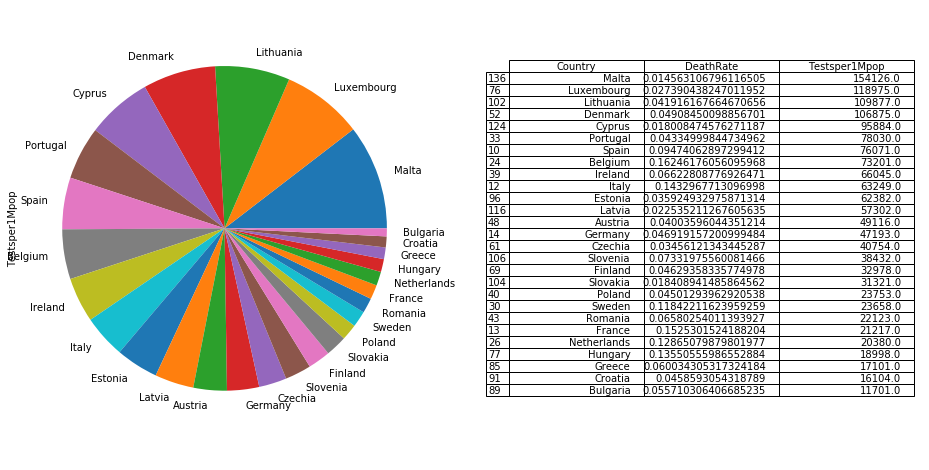

In [54]:
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=["Testsper1Mpop"], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
#import matplotlib.pyplot as plt
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfTTh.plot.pie(y=["Testsper1Mpop"],ax=ax1,labels=dfTTh['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfTTh, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("pictures/DeathRate2.png")
plt.show()

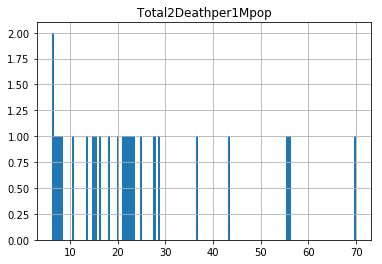

In [55]:
dfD1 = dfAll[dfAll['Country'].isin(cLst)]#[dfAll["Total Cases"]>0]
dfDD = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"],dfD1["Deathsper1Mpop"]], axis=1)
dfDD2 = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"]/dfD1["Testsper1Mpop"]], axis=1)
dfDD = dfDD[dfDD["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfDD1 = pd.concat([dfDD["Country"],dfDD["TotCasesper1Mpop"]/dfDD["Deathsper1Mpop"]], axis=1)
dfDDh = dfDD1.sort_values(by=[0], ascending=False)
dfDDh=dfDDh.rename(columns={0:"Total2Deathper1Mpop"})
dfDDh2=dfDD2.rename(columns={0:"Cases2Testsper1Mpop"})
hist = dfDDh.hist(bins=9*15)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])

In [56]:
dfDD.head()

,Country,TotCasesper1Mpop,Deathsper1Mpop
10,Spain,6124.0,580.0
12,Italy,3848.0,551.0
13,France,2890.0,441.0
14,Germany,2188.0,103.0
24,Belgium,5022.0,816.0


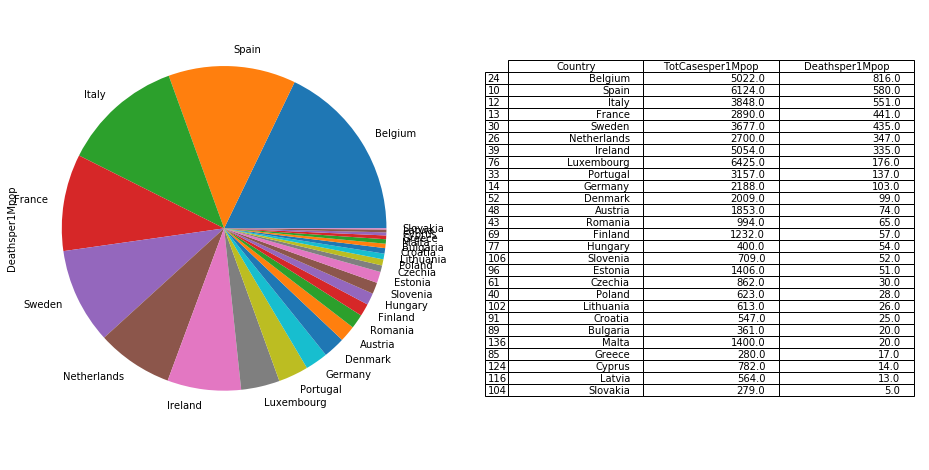

In [57]:
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfDD = dfDD.sort_values(by=['Deathsper1Mpop'], ascending=False)
dfDD.plot.pie(y='Deathsper1Mpop',ax=ax1,labels=dfDD['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfDD, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("pictures/DeathRate1.png")
plt.show()

In [58]:
dfAll.head()

,#,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,0.0,1250003,North America,North America,0.0,3635.0,386.0,0,19435.0,0.0,2044468,123858.0,670607.0,0.0,0.0
1,0.0,461707,South America,South America,0.0,2389.0,25.0,0,11281.0,0.0,847008,39340.0,345961.0,0.0,0.0
2,0.0,852704,Europe,Europe,0.0,14.0,1.0,0,8796.0,0.0,2004240,173281.0,978255.0,0.0,0.0
3,0.0,408494,Asia,Asia,0.0,4954.0,98.0,0,13578.0,0.0,1112475,30305.0,673676.0,0.0,0.0
4,0.0,78690,Africa,Africa,0.0,0.0,0.0,0,370.0,0.0,143769,4092.0,60987.0,0.0,0.0


In [59]:
dfDDh2.head()

,Country,Cases2Testsper1Mpop
10,Spain,0.080504
12,Italy,0.060839
13,France,0.136212
14,Germany,0.046363
24,Belgium,0.068606


In [60]:
dfDDh2 = dfDDh2.sort_values(by=["Cases2Testsper1Mpop"], ascending=False)

     Country  Cases2Testsper1Mpop
      Sweden             0.155423
      France             0.136212
 Netherlands             0.132483
       Spain             0.080504
     Ireland             0.076524
     Belgium             0.068606
       Italy             0.060839
  Luxembourg             0.054003
     Germany             0.046363
     Romania             0.044931
    Portugal             0.040459
     Austria             0.037727
     Finland             0.037358
     Croatia             0.033967
    Bulgaria             0.030852
      Poland             0.026228
     Estonia             0.022539
     Czechia             0.021151
     Hungary             0.021055
     Denmark             0.018798
    Slovenia             0.018448
      Greece             0.016373
      Latvia             0.009843
       Malta             0.009083
    Slovakia             0.008908
      Cyprus             0.008156
   Lithuania             0.005579


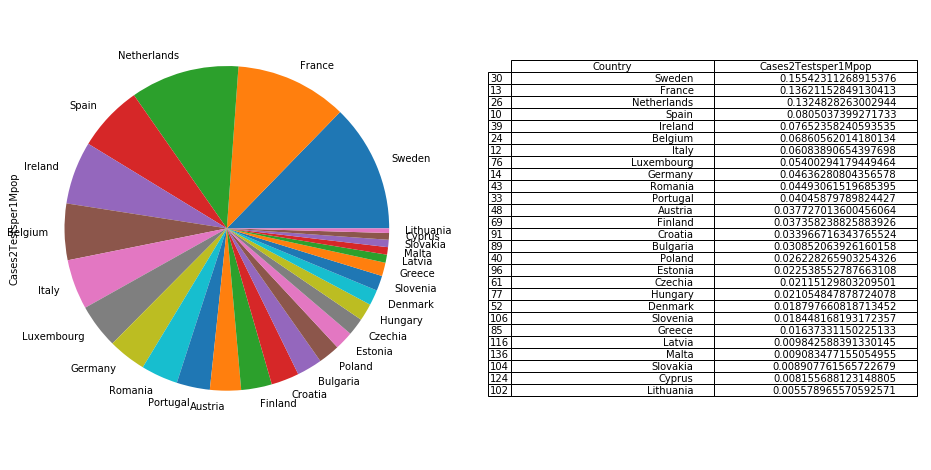

In [61]:
print (dfDDh2[dfDDh2["Cases2Testsper1Mpop"]<1000].to_string(index=False))
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfDDh2.plot.pie(y='Cases2Testsper1Mpop',ax=ax1,labels=dfDDh2['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfDDh2, loc='center')
#tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.show()

In [62]:
dfT1 = dfAll
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
dfTT[dfTT[0]>=0.000001].sort_values(by=[0], ascending=True)
#dfTT[dfTT.Country=="France"]

,Country,0,Testsper1Mpop
25,Qatar,0.000651,75779.000000
31,Singapore,0.000669,57247.000000
122,CAR,0.001040,3115.000000
56,Bahrain,0.001575,182572.000000
143,French Guiana,0.002096,0.000000
144,Réunion,0.002123,19223.000000
150,Rwanda,0.002786,5183.000000
101,Maldives,0.002990,21819.000000
55,Kazakhstan,0.003500,43338.000000
114,Hong Kong,0.003693,27087.000000


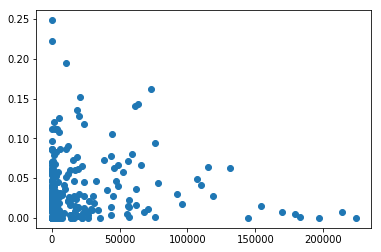

In [63]:
plt.plot(dfTTh["Testsper1Mpop"],dfTTh['DeathRate'],'o')

/usr/local/lib/python3.5/dist-packages/matplotlib/patches.py:694: RuntimeWarning: invalid value encountered in double_scalars
  self._x1 = self._x0 + self._width
/usr/local/lib/python3.5/dist-packages/matplotlib/projections/polar.py:67: RuntimeWarning: invalid value encountered in less
  mask = r < 0


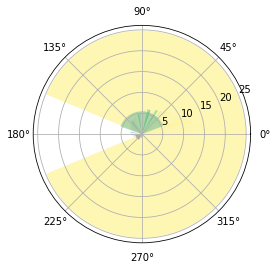

In [64]:
import numpy as np
import matplotlib.pyplot as plt


# Fixing random state for reproducibility
np.random.seed(19680801)

# Compute pie slices
N = len(dfTTh)
theta = np.linspace(0.0, 2*np.pi, N, endpoint=False)
radii = 100 * dfTTh['DeathRate']
width = 2*np.pi* 3.5/ dfTTh["Testsper1Mpop"]
colors = plt.cm.viridis(radii / 10.)

ax = plt.subplot(111, projection='polar')
ax.bar(theta, radii, width=width, bottom=0.0, color=colors, alpha=0.35)

plt.show()

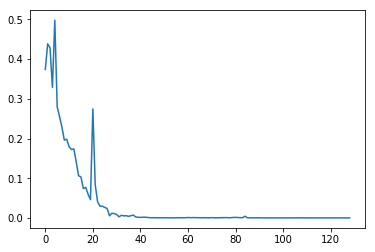

In [65]:
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)))

In [66]:
#np.diff(np.log(dfCN["cases"].values))

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: RuntimeWarning: divide by zero encountered in log
  """Entry point for launching an IPython kernel.


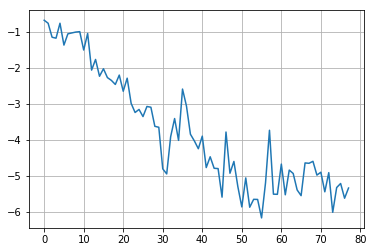

In [67]:
plt.plot(range(len(dfLT["cases"].values[3:])-1),np.log(np.diff(np.log(dfLT["cases"].values[3:]))))
plt.grid()

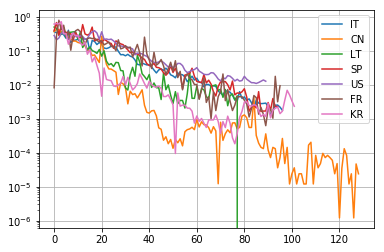

In [68]:
plt.plot(range(len(dfIT["cases"].values)-1),np.diff(np.log(dfIT["cases"].values))[:],label='IT')
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)),label='CN')
plt.plot(range(len(dfLT["cases"].values)-4),np.diff(np.log(dfLT["cases"].values))[3:],label='LT')
plt.plot(range(len(dfSP["cases"].values)-1),np.diff(np.log(dfSP["cases"].values)),label='SP')
plt.plot(range(len(dfUS["cases"].values)-1),np.diff(np.log(dfUS["cases"].values)),label='US')
plt.plot(range(len(dfFR["cases"].values)-10),np.diff(np.log(dfFR["cases"].values))[9:],label='FR')
plt.plot(range(len(dfKR["cases"].values)-4),np.diff(np.log(dfKR["cases"].values))[3:],label='KR')
plt.yscale('log')
plt.grid()
plt.legend()
plt.show()

90 90
coefficient of determination: 0.8753000534252066
intercept: -8.829187120566118
slope: [-0.13717663]


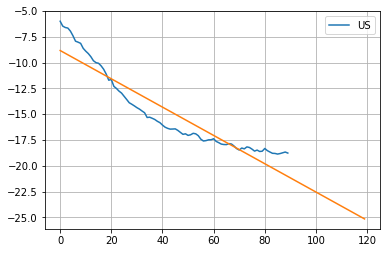

In [69]:
y = np.log(np.diff(dfUS["cases"].values)[:]/dfUS["cases"].values[1:]**2)
x = np.array(range(len(dfUS["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='US')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+30) 
plt.plot(range(len(x)+30),y_pred11)
plt.grid()
plt.legend()
plt.savefig("pictures/logdiffUS.png")
plt.show()

97 97
coefficient of determination: 0.9091956657597093
intercept: -9.58527003905619
slope: [-0.10865524]


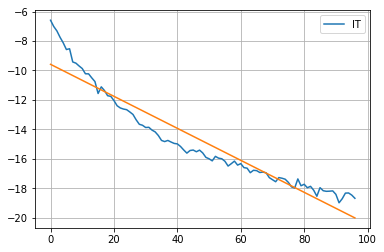

In [70]:
y = np.log(np.diff(dfIT["cases"].values)[:]/dfIT["cases"].values[1:]**2)
x = np.array(range(len(dfIT["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='IT')
y_pred12 = model.intercept_ + model.coef_ * range(len(x)) 
plt.plot(x,y_pred12)
plt.grid()
plt.legend()
plt.show()

In [77]:
#model11.coef_

In [78]:
#np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)

79 79
coefficient of determination: 0.9294821848094597
intercept: -14.926371000083783
slope: [-0.07051513]


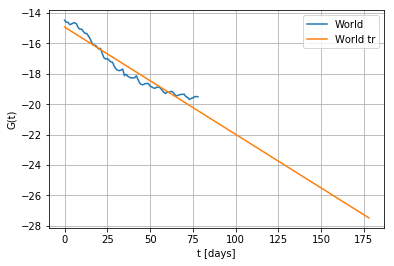

In [71]:
y = np.log(np.diff(dfW["cases"].values)[50:]/dfW["cases"].values[51:]**2)
x = np.array(range(len(dfW["cases"].values[50:])-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='World')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+100)
plt.plot(range(len(x)+100),y_pred11,label='World tr')
plt.legend()
plt.xlabel('t [days]')
plt.ylabel('G(t)')
plt.grid()
plt.savefig("pictures/logdifflogcoronaW.png")

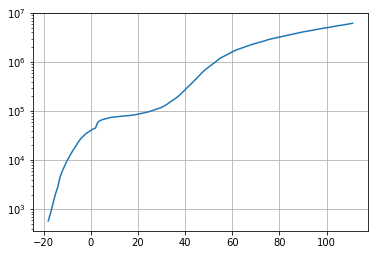

In [72]:
waveform_1 = dfW['cases'].values
waveform_A = dfW['active'].values
t = np.arange(-18,len(waveform_1)-18)
plt.plot(t, waveform_1) 
plt.yscale("log")
plt.grid()
plt.show()

In [73]:
dfW['cases'].values

array([    580,     845,    1317,    2015,    2800,    4581,    6058,
          7813,    9823,   11950,   14553,   17391,   20630,   24545,
         28266,   31439,   34876,   37552,   40553,   43099,   45134,
         59287,   64438,   67100,   69197,   71329,   73332,   75184,
         75700,   76677,   77673,   78651,   79205,   80087,   80828,
         81820,   83112,   84615,   86604,   88585,   90443,   93016,
         95314,   98425,  102050,  106099,  109991,  114381,  118948,
        126214,  134576,  145483,  156653,  169593,  182490,  198238,
        218822,  244933,  275597,  305036,  337489,  378860,  422629,
        471035,  531864,  596366,  663079,  723279,  784738,  858355,
        936237, 1016330, 1117928, 1203058, 1274578, 1347566, 1432869,
       1519195, 1605277, 1700004, 1780713, 1853505, 1925330, 2000065,
       2084633, 2183942, 2252370, 2332650, 2407467, 2482272, 2557917,
       2638909, 2725972, 2833697, 2921571, 2995209, 3065871, 3139009,
       3221029, 3308

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in exp
  after removing the cwd from sys.path.
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in true_divide
  after removing the cwd from sys.path.
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


[ 8.72748955e+06  2.58541647e+00 -6.93385082e+01  1.15133569e-02]


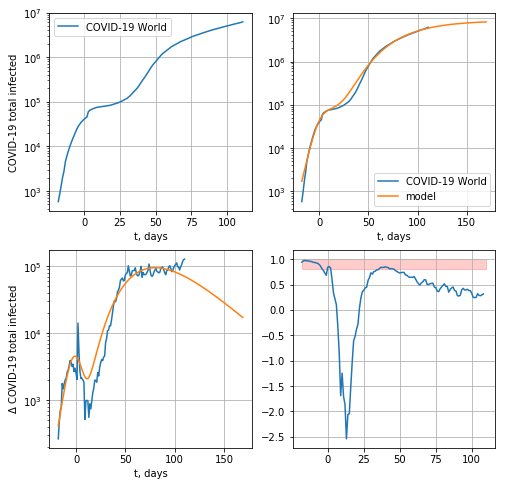

77231.42255606885


In [74]:
def model(t, coeffs):
    coeffsCN = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
    #coeffsCN = [2.06174475e+06, 1.67277852e-01, 5.36255447e+01]
    return coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3]) + coeffsCN[0]/(1 + np.exp( - coeffsCN[1] * (t - coeffsCN[2])))

x0 = np.array([2.06174475e+06, 1.67277852e-01, 5.36255447e+01, 0.9 ], dtype=float)
#x0 = np.array([8.08757112e+04,  2.24114193e-01, -6.94900467e-01 ], dtype=float)
def residuals(coeffs, y, t):
    return y - model(t, coeffs)
from scipy.optimize import leastsq
x, flag = leastsq(residuals, x0, args=(waveform_1, t))
print(x)
tt = np.arange(-18,len(waveform_1)-18+59)
fig, ((ax3,ax1),(ax2,ax4)) = plt.subplots(2,2,figsize=(8,8), sharex=False, sharey=False)
ax3.plot(t, waveform_1) 
ax3.legend(['COVID-19 World']) 
ax3.set_xlabel('t, days')
ax3.set_yscale("log")
ax3.set_ylabel(r'COVID-19 total infected')
ax3.grid()
ax1.plot(t, waveform_1, tt, model(tt, x)) 
ax1.legend(['COVID-19 World', 'model']) 
ax1.set_xlabel('t, days')
ax1.set_yscale("log")
ax1.grid()
ax2.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(model(tt, x)))
ax2.set_ylabel(r'$\Delta$ COVID-19 total infected')
ax2.set_yscale("log")
ax2.grid()
ax2.set_xlabel('t, days')
z = np.diff(moving_average(waveform_A, n=3) )/np.diff(moving_average(waveform_1, n=3))
ax4.plot(t[:-3],z)
#ax4.axhline(y=2.2587741081036339/2, color='r')
ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
#ax4.set_yscale("log")
ax4.grid()
plt.savefig("pictures/covidworld.png")

plt.show()
print(np.std(residuals(x, waveform_1, t)))
#expPopWorld = x[0]
expPopWorld = 2.67152730e+06

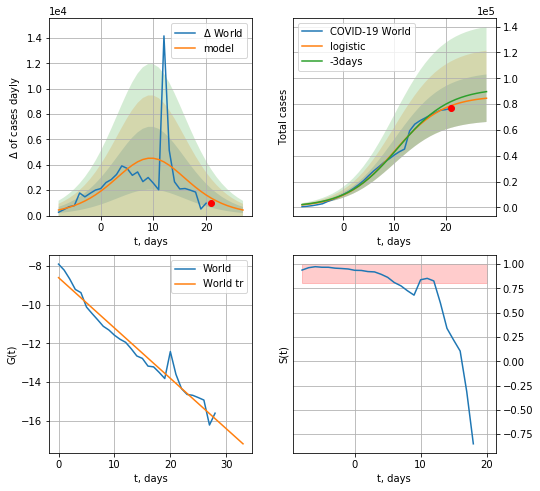

World data at: 2020-05-30
+3 day model MAPE: 0.04256770161128604
model: logistic
coeffs:  [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.2178111789766563
forecast at the end of period: +7 days
	 deltaDaycases:  439
	 total cases:  84536 ± 18412
	 total death:  5090 ± 3325
trend coefficient of determination: 0.960820
 intercept: -8.598458
 slope: -0.260482


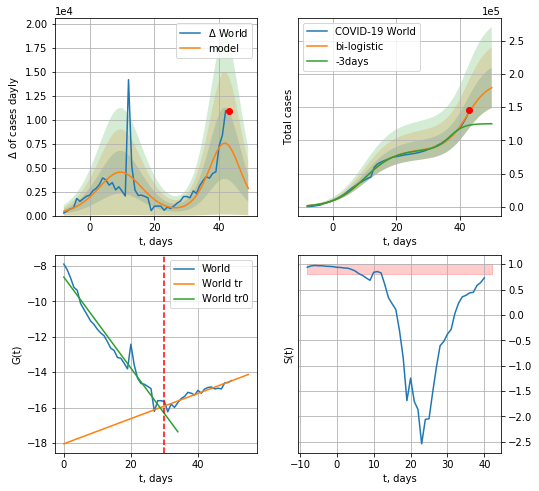

World data at: 2020-05-30
+3 day model MAPE: 0.2157297639626565
model: bi-logistic
coeffs:  [1.02227608e+05 2.95650820e-01 4.22366999e+01] [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.16992860985061978
forecast at the end of period: +7 days
	 deltaDaycases:  2839
	 total cases:  179325 ± 30472
	 total death:  10798 ± 5504
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend coefficient of determination: 0.868835
 intercept: -18.049568
 slope: 0.071157


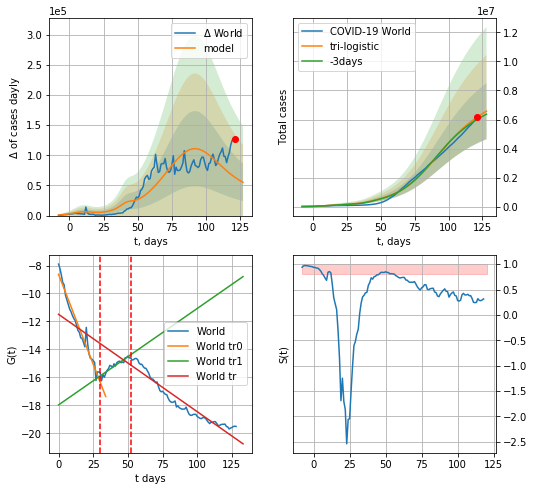

World data at: 2020-05-30
+3 day model MAPE: 0.02779166255933914
model: tri-logistic
coeffs:  [6.30669674e+06 6.74186177e-02 9.10955430e+01] [8.64735804e+04 2.09600360e-01 9.98515269e+00 1.02227608e+05
 2.95650820e-01 4.22366999e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.2940552742327243
forecast at the end of period: +7 days
	 deltaDaycases:  55183
	 total cases:  6576605 ± 1933885
	 total death:  396012 ± 349348
tri-logistic approximation splitting points: 30,52
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend1 coefficient of determination: 0.872494
 intercept: -17.970431
 slope: 0.068998
trend coefficient of determination: 0.924326
 intercept: -11.490327
 slope: -0.069640


In [76]:
vL = 30
x = forecast("World",dfW[:vL],d1,7*10-dT,1.0,False)
xx = forecast2("World",dfW[:52],d1,7*10-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("World",dfW,d1,7*10-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,52])

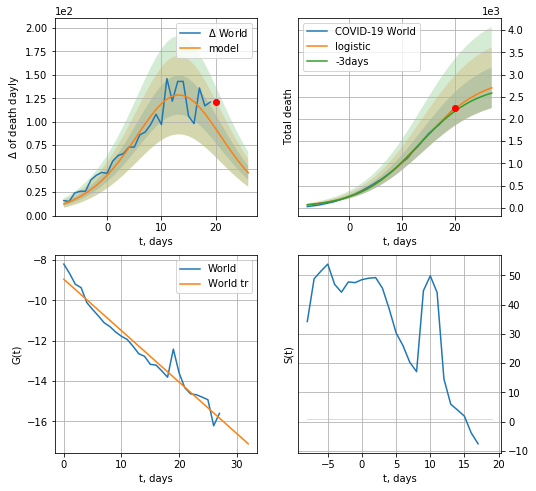

World data at: 2020-05-30
+3 day model MAPE: 0.027312192470115494
model: logistic
coeffs:  [2.96959017e+03 1.73350949e-01 1.36930068e+01]
rational stdev:  0.16928081921473714
forecast at the end of period: +7 days
	 total death:  2700 ± 457
trend coefficient of determination: 0.959176
 intercept: -8.958870
 slope: -0.254930


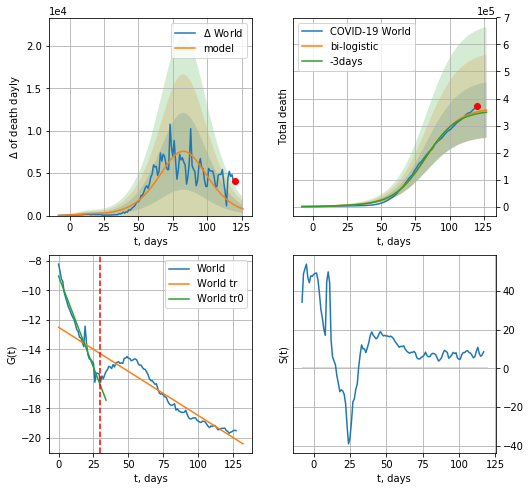

World data at: 2020-05-30
+3 day model MAPE: 0.020553499511299346
model: bi-logistic
coeffs:  [3.63558920e+05 8.33425193e-02 8.30810693e+01] [2.96959017e+03 1.73350949e-01 1.36930068e+01]
rational stdev:  0.2868631294655369
forecast at the end of period: +7 days
	 deltaDaydeath:  770
	 total death:  357410 ± 102527
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.960969
 intercept: -9.026339
 slope: -0.247583
trend coefficient of determination: 0.890740
 intercept: -12.495877
 slope: -0.059921


In [77]:
vL = 30
vL1=52
x = forecast("World",dfW[1:vL],d1,7*10-dT,1.0,False,cases='death')
xx = forecast2("World",dfW[1:],d1,7*10-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("World",dfW,d1,7*20-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

In [85]:
#vL = 30
#x = forecast("World",dfW[:vL],d1,7*9-dT,1.0,False)
#xx = forecast2("World",dfW,d1,7*15-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.7],vL=vL)
#trend(dfW,"W",10)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


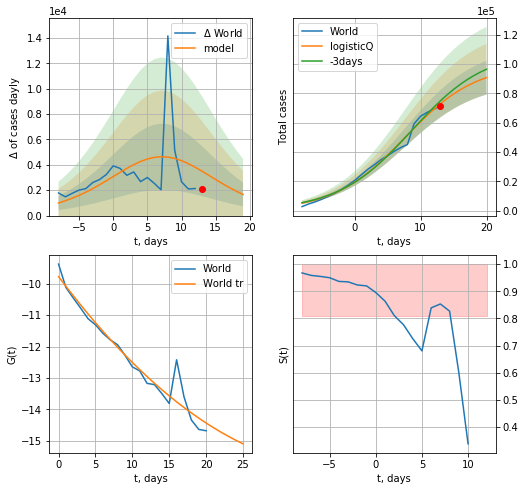

World data at: 2020-05-30
+3 day model MAPE: 0.031802
model: logisticQ
coeffs: [ 9.98643255e+04  1.79652646e-05  7.63889680e+00 -1.03375904e+04]
rational stdev: 0.126959
forecast at the end of period: +7 days
	 deltaDaycases: 1662
	 total cases: 90765 ± 11523
	 total death: 5465 ± 2081
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


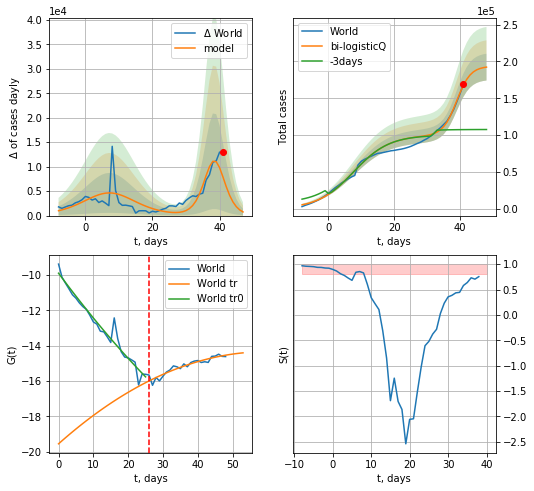

World data at: 2020-05-30
+3 day model MAPE: 0.635593
model: bi-logisticQ
coeffs: [ 9.37578627e+04  2.55228565e-05  3.89552969e+01 -1.87082152e+04]
rational stdev: 0.094698
forecast at the end of period: +7 days
	 deltaDaycases: 744
	 total cases: 192349 ± 18215
	 total death: 11582 ± 3290
bi-logisticQ approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.893677
 intercept_: -19.558019139425994
 coeffs_: [ 0.          0.17538587 -0.00147405]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:435: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


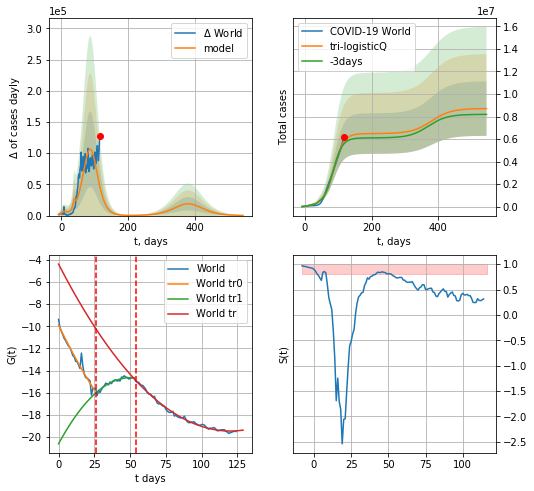

World data at: 2020-05-30
+3 day model MAPE: 0.035588
model: tri-logisticQ
coeffs: [ 6.28969204e+06  4.41368111e-07  8.70578035e+01 -1.53311633e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.277793
forecast at the end of period: +427 days
	 deltaDaycases: 282
	 total cases: 8702751 ± 2417565
	 total death: 524039 ± 436723
tri-logisticQ approximation splitting points: 26,54
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.900515
 intercept_: -20.622215746086294
 coeffs_: [ 0.          0.23801537 -0.00236922]
trend coefficient of determination: 0.992546
 intercept_: -4.38407408874026
 coeffs_: [ 0.         -0.25117828  0.00104565]


In [79]:
vL=30 - 4
vL1=59 - 5
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
x = forecastRRR("World",dfW[4:vL],d1,7*10-dT,1.0,False)
xx = forecast2RRR("World",dfW[4:vL1],d1,7*10-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*70-dT, xx, shift=1.,addpred=True,xcoef=koreaCoeffs,vL=[vL,vL1])

130


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


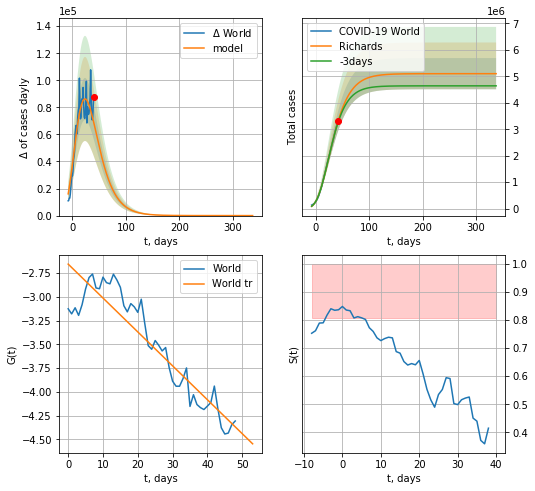

World data at: 2020-05-30
+3 day model MAPE: 0.014871
model: Richards
coeffs: [ 5.10254335e+06  1.04395582e+00 -4.20545297e+01  4.49970923e-02]
rational stdev: 0.115529
forecast at the end of period: +297 days
	 deltaDaycases: 0
	 total cases: 5102541 ± 589489
	 total death: 307251 ± 106488
trend coefficient of determination: 0.854892
 intercept: -2.655636
 slope: -0.035656


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


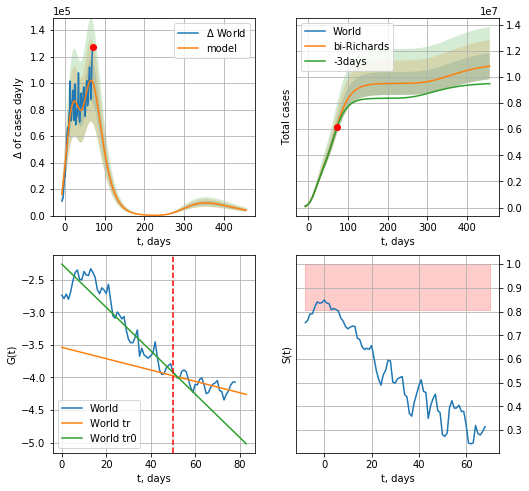

World data at: 2020-05-30
+3 day model MAPE: 0.012869
model: bi-Richards
coeffs: [ 4.40010308e+06  3.86245465e+00 -1.97334353e+01  1.23812105e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.092352
forecast at the end of period: +387 days
	 deltaDaycases: 4096
	 total cases: 10822966 ± 999523
	 total death: 651708 ± 180559
bi-Richards approximation splitting point: 50
trend coefficient of determination: 0.839032
 intercept: -2.260799
 slope: -0.033232
trend coefficient of determination: 0.392173
 intercept: -3.538141
 slope: -0.008701


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


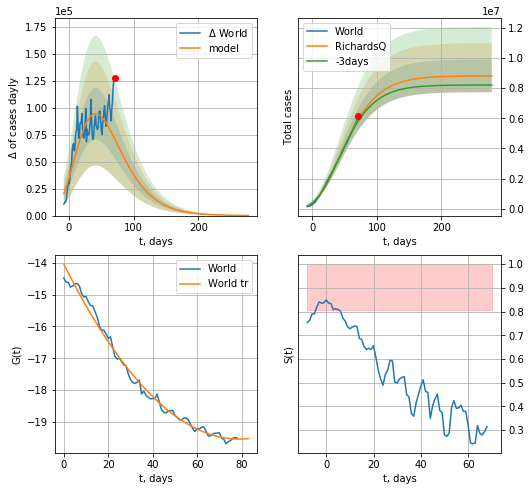

World data at: 2020-05-30
+3 day model MAPE: 0.019731
model: RichardsQ
coeffs: [ 8.81677577e+06  4.89828668e-03 -1.82508414e+02 -1.24348078e+03
  3.95369327e-03]
rational stdev: 0.123016
forecast at the end of period: +207 days
	 deltaDaycases: 111
	 total cases: 8813923 ± 1084252
	 total death: 530733 ± 195865
trend coefficient of determination: 0.990513
 intercept_: -14.040134651731009
 coeffs_: [ 0.         -0.13957944  0.00088548]


In [80]:
print (len(dfW))
vL = 100
x = forecastRR("World",dfW[50:vL],d1,40*9-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("World",dfW[50:],d1,50*9-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL-50)
x = forecastQR("World",dfW[50:],d1,30*9-dT,1.0,addpred=False)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


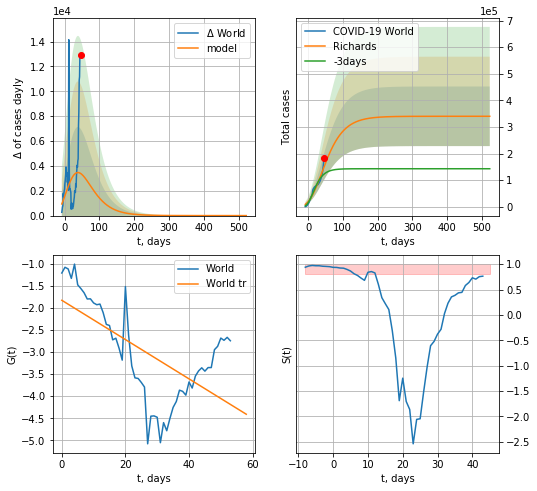

World data at: 2020-05-30
+3 day model MAPE: 0.241624
model: Richards
coeffs: [ 3.40077948e+05  3.51040118e+00 -1.35212982e+02  7.92067107e-03]
rational stdev: 0.329278
forecast at the end of period: +477 days
	 deltaDaycases: 0
	 total cases: 340077 ± 111979
	 total death: 20477 ± 20227
trend coefficient of determination: 0.389866
 intercept: -1.829818
 slope: -0.044449


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


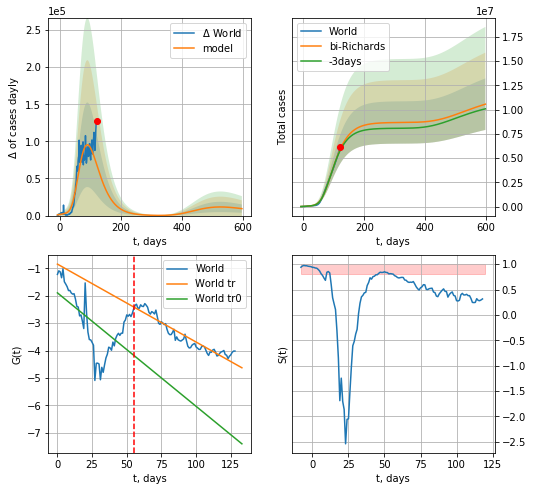

World data at: 2020-05-30
+3 day model MAPE: 0.021164
model: bi-Richards
coeffs: [ 8.33475820e+06  3.44029835e+00 -6.27518880e+01  8.91904746e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.251408
forecast at the end of period: +477 days
	 deltaDaycases: 9365
	 total cases: 10554521 ± 2653495
	 total death: 635544 ± 479343
bi-Richards approximation splitting point: 55
trend coefficient of determination: 0.356024
 intercept: -1.893697
 slope: -0.041401
trend coefficient of determination: 0.901621
 intercept: -0.845279
 slope: -0.028429


In [81]:
vL = 55
x = forecastRR("World",dfW[:vL],d1,60*9-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("World",dfW[:],d1,60*9-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


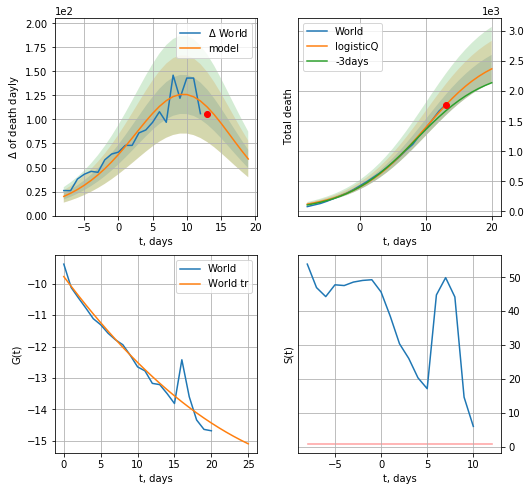

World data at: 2020-05-30
+3 day model MAPE: 0.067194
model: logisticQ
coeffs: [ 2.67019299e+03  8.28077677e-04  9.49653382e+00 -2.18469917e+02]
rational stdev: 0.098000
forecast at the end of period: +7 days
	 total death: 2372 ± 232
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


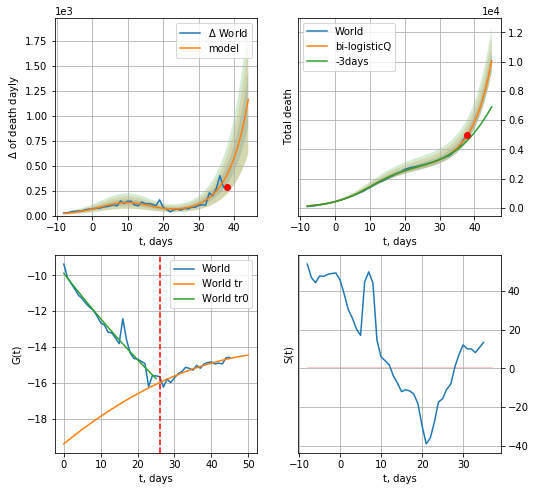

World data at: 2020-05-30
+3 day model MAPE: 0.105655
model: bi-logisticQ
coeffs: [ 6.42204134e+06  6.90051546e-04  7.95652837e+01 -2.38689793e+02]
rational stdev: 0.076590
forecast at the end of period: +7 days
	 total death: 10056 ± 770
bi-logisticQ approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.866834
 intercept_: -19.41123113056416
 coeffs_: [ 0.          0.16686573 -0.0013545 ]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:435: RuntimeWarning: overflow encountered in exp


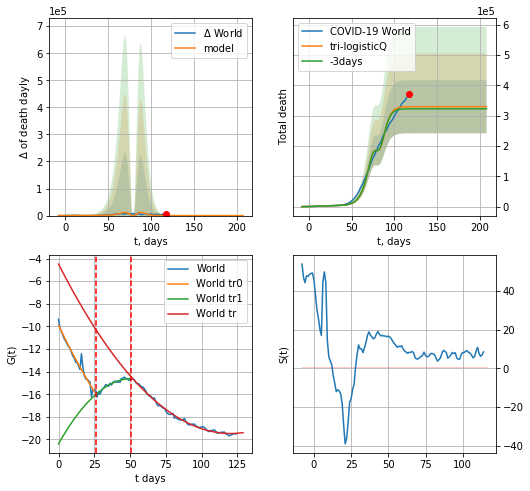

World data at: 2020-05-30
+3 day model MAPE: 0.022012
model: tri-logisticQ
coeffs: [-6.09502999e+06  5.09767261e-04 -3.75253283e+02  7.96200267e+01]
rational stdev: 0.266047
forecast at the end of period: +91 days
	 total death: 329681 ± 87710
tri-logisticQ approximation splitting points: 26,51
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.890965
 intercept_: -20.382525077358043
 coeffs_: [ 0.          0.22422642 -0.00217733]
trend coefficient of determination: 0.993751
 intercept_: -4.4961480506428195
 coeffs_: [ 0.         -0.24873095  0.00103277]


In [83]:
vL=30 - 4
vL1=51
x = forecastRRR("World",dfW[4:vL],d1,7*10-dT,1.0,False,cases='death')
xx = forecast2RRR("World",dfW[4:vL1],d1,7*10-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*22-dT, xx, shift=1.,addpred=False,xcoef=[.35,.5,4.,1.],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


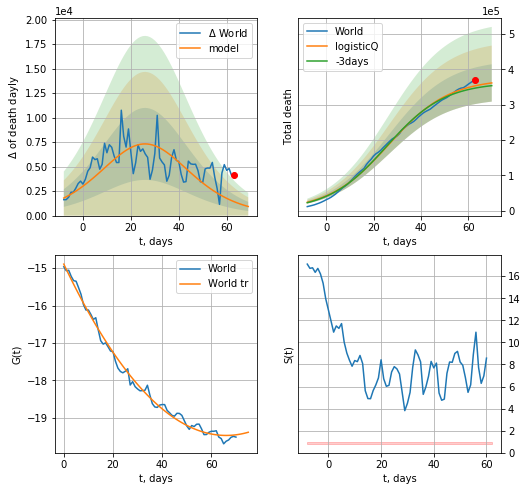

World data at: 2020-05-30
+3 day model MAPE: 0.019159
model: logisticQ
coeffs: [ 3.73213803e+05  7.93841865e-07  2.63759384e+01 -9.88197161e+04]
rational stdev: 0.146271
forecast at the end of period: +7 days
	 total death: 361444 ± 52868
trend coefficient of determination: 0.992547
 intercept_: -14.895648180665473
 coeffs_: [ 0.         -0.13849699  0.00104914]


In [85]:
x = forecastRRR("World",dfW[58:],d1,7*10-dT,1.0,False,cases='death')

In [98]:
#trend(dfSP,'SP',10)

In [99]:
#vL = len(dfSP[:])-16-dT
#x = forecast('Spain',dfSP[:vL],d1,30-dT,1.0)
#xx = forecast2('Spain',dfSP,d1,7*6-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.8],vL=vL)

SP
          date   cases  active    death
91 2020-05-26  283339   59264  27117.0
92 2020-05-27  283849   59773  27118.0
93 2020-05-28  284986   60909  27119.0
94 2020-05-29  285644   61565  27121.0
95 2020-05-30  286308   62225  27125.0


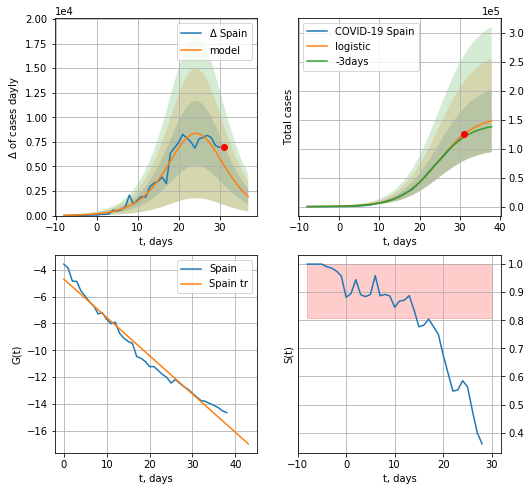

Spain data at: 2020-05-30
+3 day model MAPE: 0.04562669977631666
model: logistic
coeffs:  [1.56957534e+05 2.13812412e-01 2.47399190e+01]
rational stdev:  0.3648922799171356
forecast at the end of period: +7 days
	 deltaDaycases:  1934
	 total cases:  148253 ± 54096
	 total death:  14045 ± 15374
trend coefficient of determination: 0.974785
 intercept: -4.699916
 slope: -0.285083


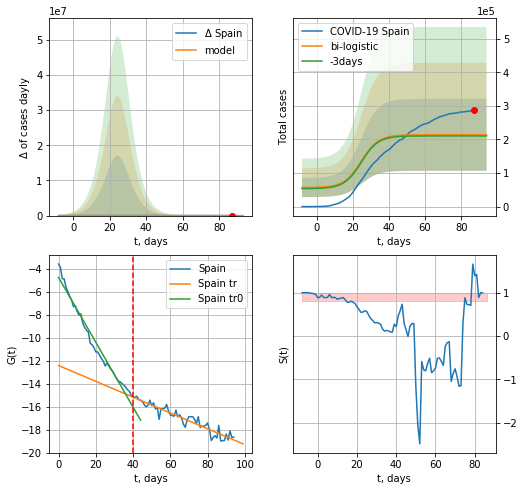

Spain data at: 2020-05-30
+3 day model MAPE: 0.015953213391216654
model: bi-logistic
coeffs:  [ 4.54439726e+04 -4.42456433e+00  1.19085275e+02] [1.56957534e+05 2.13812412e-01 2.47399190e+01]
scenario coeffs:  [0.25, 1.0, 1.6]
rational stdev:  0.5010040477520662
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  213762 ± 107095
	 total death:  20251 ± 30437
bi-logistic approximation splitting point: 40
trend0 coefficient of determination: 0.974598
 intercept: -4.739484
 slope: -0.281959
trend coefficient of determination: 0.895069
 intercept: -12.398372
 slope: -0.068720


In [87]:
dfSP = read_df(pd.DataFrame(),"SP")
vL = 40#len(dfSP[:])-7-dT
x = forecast('Spain',dfSP[:vL],d1,7*10-dT,1.0,cases='cases')
xx = forecast2('Spain',dfSP[:],d1,7*10-dT,x,1.0,addpred=True,xcoef=[.25,1.,1.6],vL=vL,cases='cases')

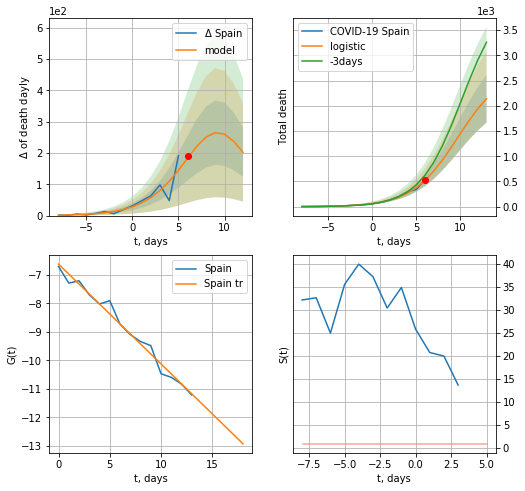

Spain data at: 2020-05-30
+3 day model MAPE: 0.1992580202993838
model: logistic
coeffs:  [2.74529349e+03 3.87912491e-01 9.73356455e+00]
rational stdev:  0.22139705331908888
forecast at the end of period: +7 days
	 total death:  2141 ± 474
trend coefficient of determination: 0.980020
 intercept: -6.621221
 slope: -0.350134


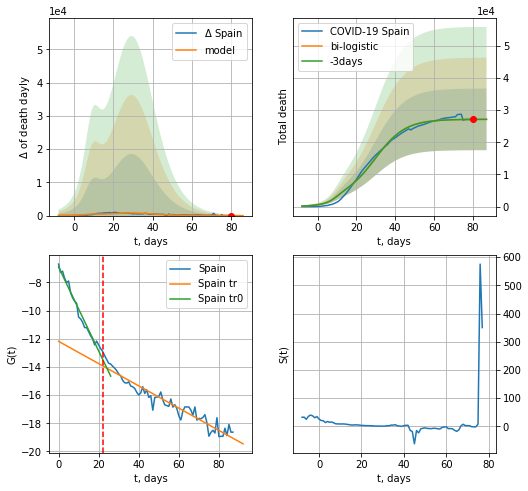

Spain data at: 2020-05-30
+3 day model MAPE: 2.5284948257699068e-05
model: bi-logistic
coeffs:  [2.44133017e+04 1.29451851e-01 2.96906213e+01] [2.74529349e+03 3.87912491e-01 9.73356455e+00]
rational stdev:  0.3531701113402712
forecast at the end of period: +7 days
	 deltaDaydeath:  2
	 total death:  27143 ± 9586
bi-logistic approximation splitting point: 22
trend0 coefficient of determination: 0.976968
 intercept: -6.910878
 slope: -0.297821
trend coefficient of determination: 0.924611
 intercept: -12.186818
 slope: -0.079056


In [89]:
vL = 22#len(dfSP[:])-7-dT
#dfSP = read_df(pd.DataFrame(),"SP")
x = forecast('Spain',dfSP[7:vL],d1,7*10-dT,1.0,cases='death')
xx = forecast2('Spain',dfSP[7:],d1,7*10-dT,x,1.0,addpred=False,xcoef=[.25,1.,1.8],vL=vL,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


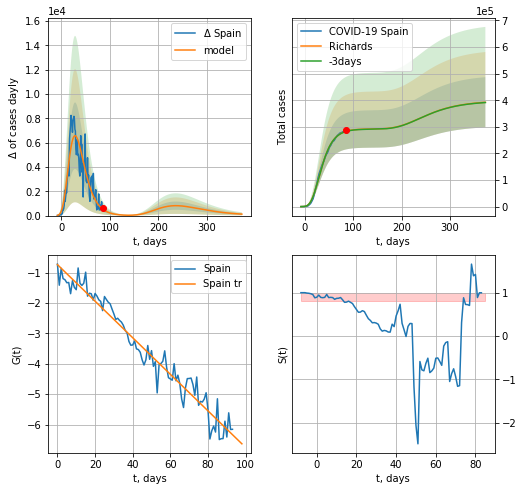

Spain data at: 2020-05-30
+3 day model MAPE: 0.002088
model: Richards
coeffs: [ 2.92276525e+05  8.47106091e+00 -5.14531422e+01  7.24511678e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.240881
forecast at the end of period: +287 days
	 deltaDaycases: 120
	 total cases: 392347 ± 94508
	 total death: 37171 ± 26861
trend coefficient of determination: 0.956356
 intercept: -0.731993
 slope: -0.060245


In [90]:
x = forecastRR('Spain',dfSP[1:],d1,7*50-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:75: RuntimeWarning: divide by zero encountered in true_divide


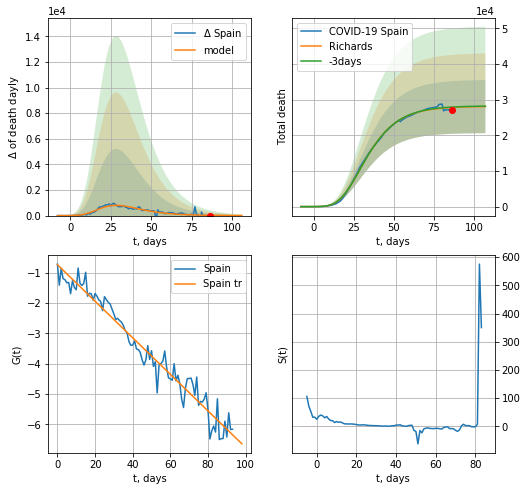

Spain data at: 2020-05-30
+3 day model MAPE: 0.004224
model: Richards
coeffs: [ 2.80980590e+04  9.83590176e+00 -3.34291330e+01  7.91369712e-03]
rational stdev: 0.265568
forecast at the end of period: +21 days
	 total death: 28034 ± 7445
trend coefficient of determination: 0.956463
 intercept: -0.736857
 slope: -0.060295


In [91]:
x = forecastRR('Spain',dfSP[1:],d1,7*12-dT,1.0,addpred=False,xcoef=[.25,1.,3.,1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


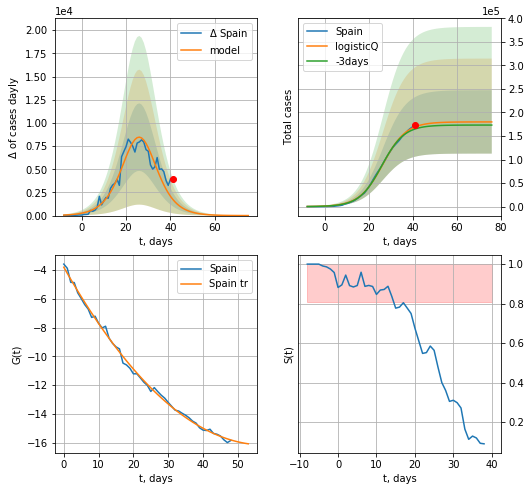

Spain data at: 2020-05-30
+3 day model MAPE: 0.028163
model: logisticQ
coeffs: [ 1.79944314e+05  4.82942779e-06  2.63952863e+01 -3.89581546e+04]
rational stdev: 0.373922
forecast at the end of period: +35 days
	 deltaDaycases: 3
	 total cases: 179928 ± 67279
	 total death: 17046 ± 19121
trend coefficient of determination: 0.997334
 intercept_: -3.7990007659330134
 coeffs_: [ 0.         -0.42831531  0.00370949]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


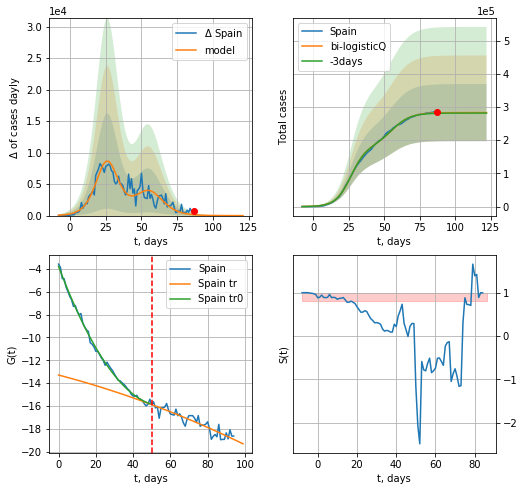

Spain data at: 2020-05-30
+3 day model MAPE: 0.004641
model: bi-logisticQ
coeffs: [ 1.03069495e+05  8.30825404e-07  5.55168538e+01 -1.80223128e+05]
rational stdev: 0.303837
forecast at the end of period: +35 days
	 deltaDaycases: 0
	 total cases: 283008 ± 85988
	 total death: 26812 ± 24439
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.997131
 intercept_: -3.7751216617675887
 coeffs_: [ 0.         -0.43240435  0.00381547]
trend coefficient of determination: 0.833464
 intercept_: -13.292895290286147
 coeffs_: [ 0.         -0.04256692 -0.0001841 ]


In [92]:
x = forecastRRR('Spain',dfSP[:50],d1,7*14-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])
xx = forecast2RRR('Spain',dfSP[:],d1,7*14-dT,x,1.0,addpred=False,xcoef=koreaCoeffs,vL=50)#[.35,.5,3.,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


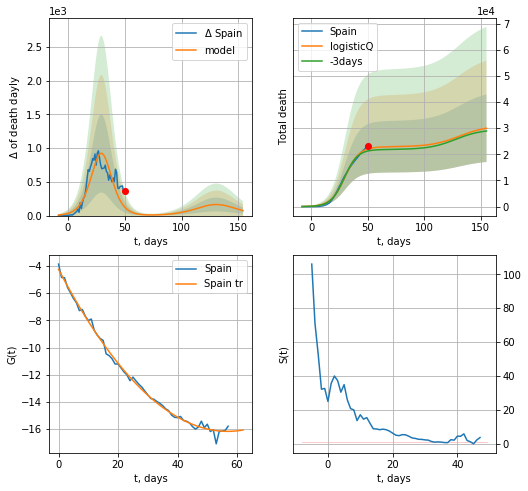

Spain data at: 2020-05-30
+3 day model MAPE: 0.037624
model: logisticQ
coeffs: [ 2.28798062e+04  1.92571131e-06  3.00460867e+01 -8.38155043e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.430820
forecast at the end of period: +105 days
	 total death: 29976 ± 12914
trend coefficient of determination: 0.995937
 intercept_: -4.2575122176431694
 coeffs_: [ 0.         -0.41856419  0.00368029]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:347: RuntimeWarning: divide by zero encountered in true_divide


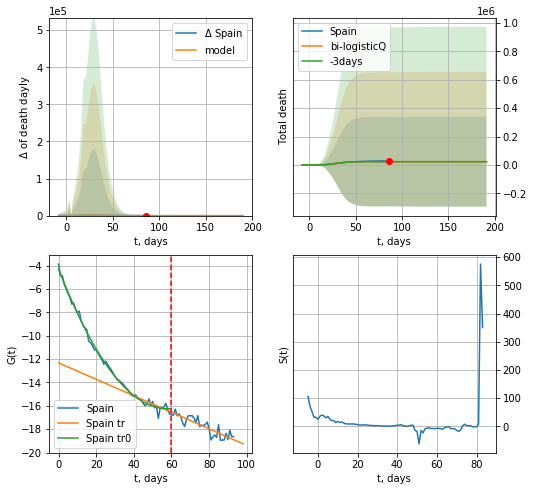

Spain data at: 2020-05-30
+3 day model MAPE: 0.000003
model: bi-logisticQ
coeffs: [-6.82059526e+02 -6.31143430e-02  1.88974018e+01  4.23347740e+00]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 13.816436
forecast at the end of period: +105 days
	 total death: 22879 ± 316117
bi-logisticQ approximation splitting point: 60
trend coefficient of determination: 0.995783
 intercept_: -4.28878212009627
 coeffs_: [ 0.         -0.41413346  0.00358475]
trend coefficient of determination: 0.742259
 intercept_: -12.32666268379657
 coeffs_: [ 0.00000000e+00 -6.98373651e-02 -8.19268971e-06]


In [93]:
x = forecastRRR('Spain',dfSP[1:60],d1,7*24-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1])
xx = forecast2RRR('Spain',dfSP[1:],d1,7*24-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,cases='death',vL=60)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


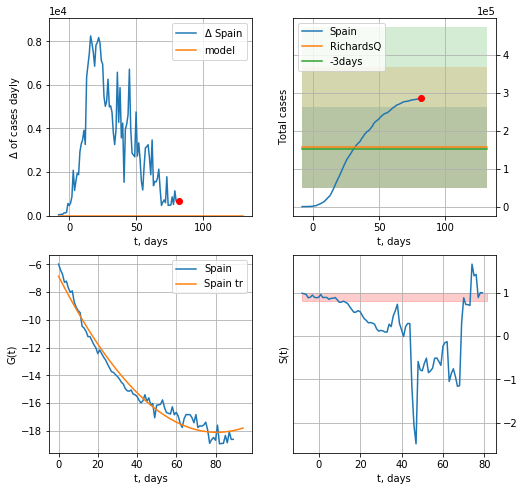

Spain data at: 2020-05-30
+3 day model MAPE: 0.029081
model: RichardsQ
coeffs: [ 1.56181945e+05 -2.38567580e+00 -2.53773880e+01 -9.57891879e+01
 -2.00302747e-01]
rational stdev: 0.678701
forecast at the end of period: +49 days
	 deltaDaycases: 0
	 total cases: 156181 ± 106000
	 total death: 14796 ± 30126
trend coefficient of determination: 0.975893
 intercept_: -6.848456403590069
 coeffs_: [ 0.         -0.27963942  0.00173422]


In [94]:
x = forecastQR('Spain',dfSP[5:],d1,7*16-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])

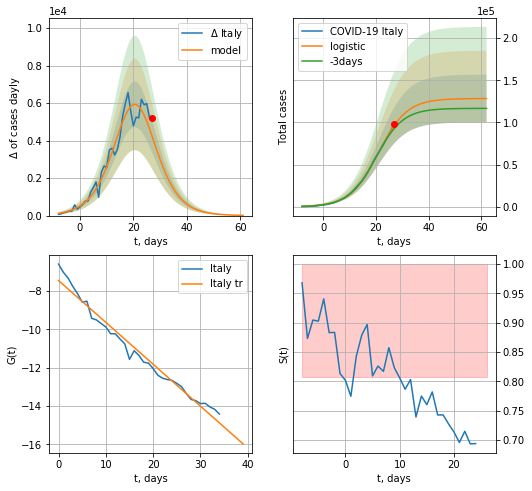

Italy data at: 2020-05-30
+3 day model MAPE: 0.04536229058229775
model: logistic
coeffs:  [1.28444604e+05 1.85121746e-01 2.10190970e+01]
rational stdev:  0.22074329651570546
forecast at the end of period: +35 days
	 deltaDaycases:  13
	 total cases:  128379 ± 28338
	 total death:  18396 ± 12182
trend coefficient of determination: 0.974900
 intercept: -7.448538
 slope: -0.218710


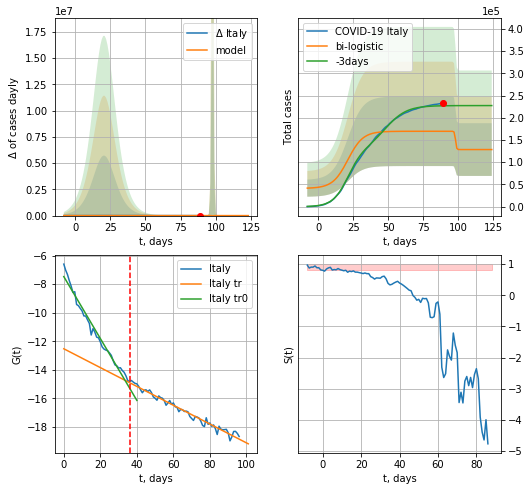

Italy data at: 2020-05-30
+3 day model MAPE: 0.2528769870884577
model: bi-logistic
coeffs:  [ 4.11320683e+04 -2.85933752e+00  9.81031449e+01] [1.28444604e+05 1.85121746e-01 2.10190970e+01]
rational stdev:  0.46132424541871075
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  128444 ± 59254
	 total death:  18405 ± 25472
bi-logistic approximation splitting point: 36
trend0 coefficient of determination: 0.975991
 intercept: -7.466382
 slope: -0.217136
trend coefficient of determination: 0.973161
 intercept: -12.529902
 slope: -0.066011


In [95]:
vL = 36#len(dfIT)-6-dT
x = forecast('Italy',dfIT[:vL],d1,14*7-dT,1.0)
xx = forecast2('Italy',dfIT,d1,14*7-dT,x,1.0,vL=vL)

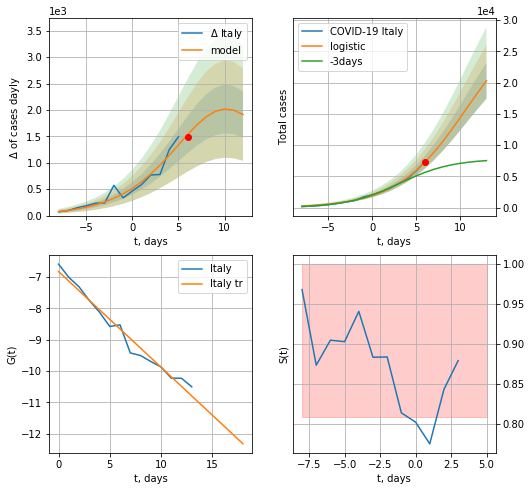

Italy data at: 2020-05-30
+3 day model MAPE: 0.4420796150765939
model: logistic
coeffs:  [3.15102860e+04 2.56561304e-01 1.06831560e+01]
rational stdev:  0.1413171221665118
forecast at the end of period: +7 days
	 deltaDaycases:  1912
	 total cases:  20304 ± 2869
	 total death:  2909 ± 1233
trend coefficient of determination: 0.972659
 intercept: -6.827339
 slope: -0.305199


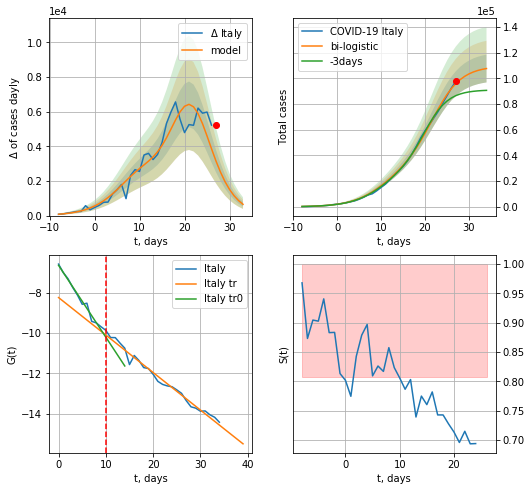

Italy data at: 2020-05-30
+3 day model MAPE: 0.12719416413980916
model: bi-logistic
coeffs:  [7.80633996e+04 3.07326084e-01 2.18190350e+01] [3.15102860e+04 2.56561304e-01 1.06831560e+01]
rational stdev:  0.10039113205484494
forecast at the end of period: +7 days
	 deltaDaycases:  652
	 total cases:  107689 ± 10811
	 total death:  15431 ± 4647
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980956
 intercept: -6.650523
 slope: -0.355965
trend coefficient of determination: 0.983136
 intercept: -8.246485
 slope: -0.185719


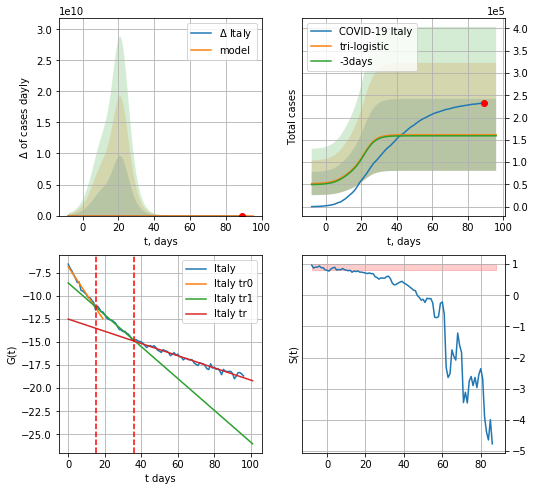

Italy data at: 2020-05-30
+3 day model MAPE: 0.014112109585070037
model: tri-logistic
coeffs:  [ 5.16120870e+04 -3.82336534e+00  1.03996863e+02] [3.15102860e+04 2.56561304e-01 1.06831560e+01 7.80633996e+04
 3.07326084e-01 2.18190350e+01]
forecast rational stdev:  0.500721007766619
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  161185 ± 80709
	 total death:  23097 ± 34695
tri-logistic approximation splitting points: 15,36
trend0 coefficient of determination: 0.972874
 intercept: -6.864841
 slope: -0.296544
trend1 coefficient of determination: 0.980760
 intercept: -8.621359
 slope: -0.172242
trend coefficient of determination: 0.973161
 intercept: -12.529902
 slope: -0.066011


In [97]:
vL = 15#len(dfSP[:])-11-dT
vL1=36
x = forecast('Italy',dfIT[:vL],d1,7*10-dT,1.0)
xx = forecast2('Italy',dfIT[:vL1],d1,7*10-dT,x,1.0)#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*10-dT, xx, shift=1.,addpred=False,xcoef=[.35,1.,1.5],vL=[vL,vL1])

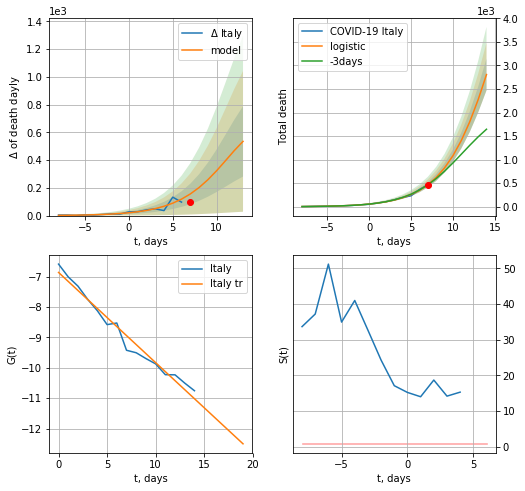

Italy data at: 2020-05-30
+3 day model MAPE: 0.04050471838994123
model: logistic
coeffs:  [8.02160580e+03 3.09188022e-01 1.60041165e+01]
rational stdev:  0.12009380059110428
forecast at the end of period: +7 days
	 total death:  2806 ± 337
trend coefficient of determination: 0.972874
 intercept: -6.864841
 slope: -0.296544


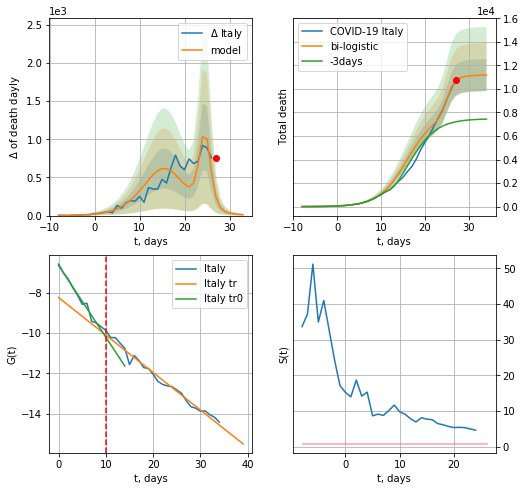

Italy data at: 2020-05-30
+3 day model MAPE: 0.5045455507817326
model: bi-logistic
coeffs:  [3.18991891e+03 1.24679374e+00 2.50159525e+01] [8.02160580e+03 3.09188022e-01 1.60041165e+01]
rational stdev:  0.12176249997037505
forecast at the end of period: +7 days
	 deltaDaydeath:  11
	 total death:  11180 ± 1361
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980956
 intercept: -6.650523
 slope: -0.355965
trend coefficient of determination: 0.983136
 intercept: -8.246485
 slope: -0.185719


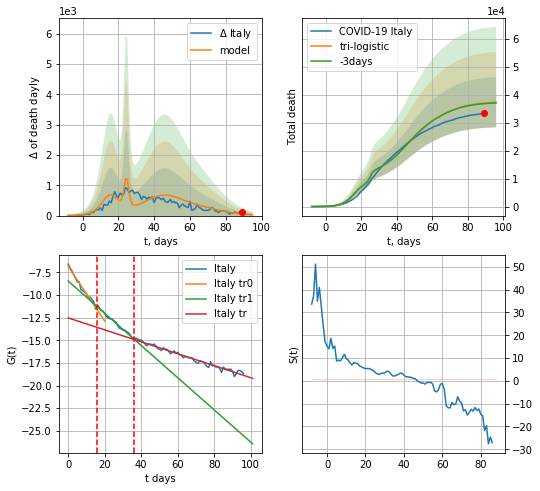

Italy data at: 2020-05-30
+3 day model MAPE: 0.006952876631033867
model: tri-logistic
coeffs:  [2.10776473e+04 1.21882220e-01 4.55402088e+01] [8.02160580e+03 3.09188022e-01 1.60041165e+01 3.18991891e+03
 1.24679374e+00 2.50159525e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.24058285183790246
forecast at the end of period: +7 days
	 deltaDaydeath:  27
	 total death:  37339 ± 8983
tri-logistic approximation splitting points: 16,36
trend0 coefficient of determination: 0.976838
 intercept: -6.838821
 slope: -0.302120
trend1 coefficient of determination: 0.986419
 intercept: -8.458056
 slope: -0.177939
trend coefficient of determination: 0.973161
 intercept: -12.529902
 slope: -0.066011


In [99]:
vL = 16#len(dfSP[:])-11-dT
vL1=36
x = forecast('Italy',dfIT[:vL],d1,7*10-dT,1.0,cases='death')
xx = forecast2('Italy',dfIT[:vL1],d1,7*10-dT,x,1.0,cases='death')#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*10-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


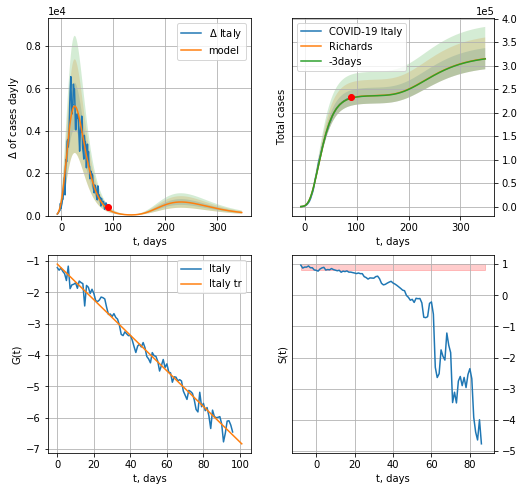

Italy data at: 2020-05-30
+3 day model MAPE: 0.001130
model: Richards
coeffs: [ 2.36656390e+05  5.92896981e+00 -5.10921852e+01  1.00600065e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.071551
forecast at the end of period: +259 days
	 deltaDaycases: 146
	 total cases: 314960 ± 22535
	 total death: 45132 ± 9687
trend coefficient of determination: 0.985489
 intercept: -1.098675
 slope: -0.056733


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


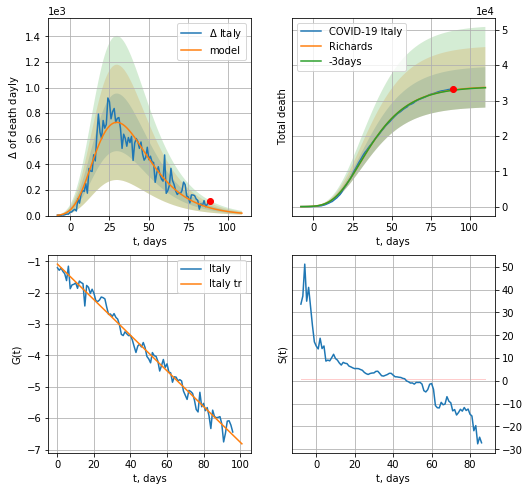

Italy data at: 2020-05-30
+3 day model MAPE: 0.002308
model: Richards
coeffs: [ 3.40321012e+04  6.41435635e+00 -5.01936878e+01  9.11672199e-03]
rational stdev: 0.169199
forecast at the end of period: +21 days
	 total death: 33714 ± 5704
trend coefficient of determination: 0.985448
 intercept: -1.090588
 slope: -0.056683


In [100]:
x = forecastRR('Italy',dfIT[:],d1,46*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
x = forecastRR('Italy',dfIT[:],d1,12*7-dT,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


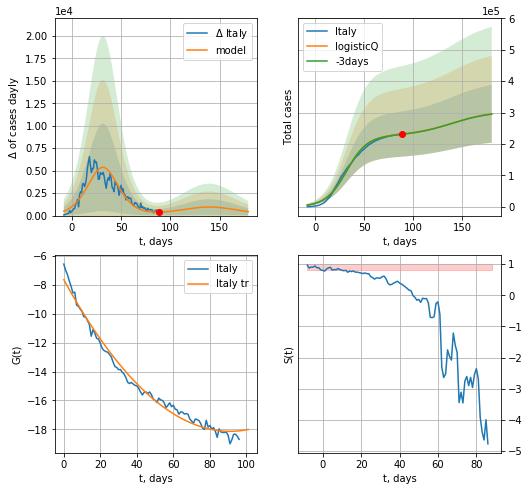

Italy data at: 2020-05-30
+3 day model MAPE: 0.004640
model: logisticQ
coeffs: [ 2.26332173e+05  4.13634343e-07  3.20910712e+01 -2.28472597e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.311833
forecast at the end of period: +91 days
	 deltaDaycases: 436
	 total cases: 296135 ± 92344
	 total death: 42435 ± 39697
trend coefficient of determination: 0.986375
 intercept_: -7.66442848227301
 coeffs_: [ 0.         -0.2299777   0.00126381]


In [101]:
x = forecastRRR('Italy',dfIT[:],d1,7*22-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


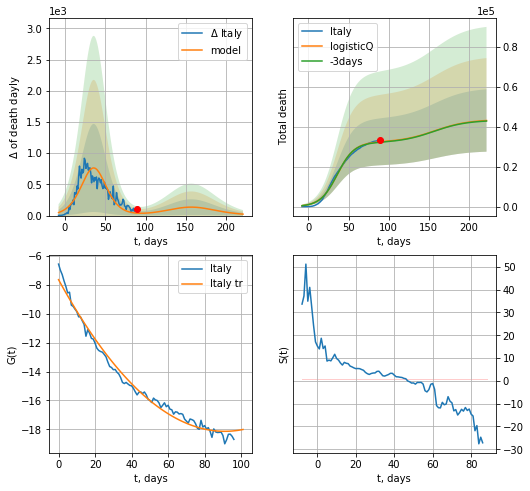

Italy data at: 2020-05-30
+3 day model MAPE: 0.006882
model: logisticQ
coeffs: [ 3.22691028e+04  4.13332863e-07  3.60503620e+01 -2.28548490e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.362318
forecast at the end of period: +133 days
	 total death: 43197 ± 15651
trend coefficient of determination: 0.986375
 intercept_: -7.66442848227301
 coeffs_: [ 0.         -0.2299777   0.00126381]


In [102]:
x = forecastRRR('Italy',dfIT[:],d1,7*28-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

In [103]:
dT

63

FR
           date     cases  active    death
101 2020-05-26  182722.0   88313  28530.0
102 2020-05-27  182913.0   87733  28596.0
103 2020-05-28  186238.0   90385  28662.0
104 2020-05-29  186835.0   90318  28714.0
105 2020-05-30  188625.0   91586  28771.0


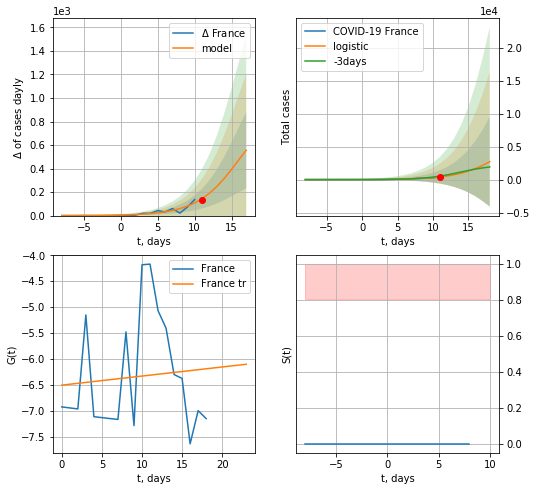

France data at: 2020-05-30
+3 day model MAPE: 0.23575809672955655
model: logistic
coeffs:  [8.54680047e+03 3.19224428e-01 2.03751890e+01]
rational stdev:  2.5037018951863894
forecast at the end of period: +7 days
	 deltaDaycases:  555
	 total cases:  2726 ± 6826
	 total death:  415 ± 3117
trend coefficient of determination: 0.008192
 intercept: -6.507496
 slope: 0.017520


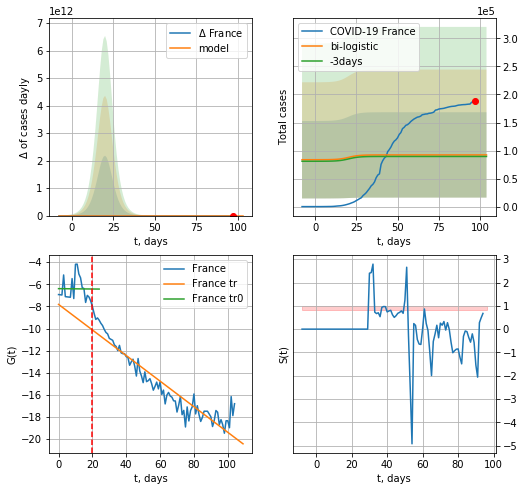

France data at: 2020-05-30
+3 day model MAPE: 0.030958582376970176
model: bi-logistic
coeffs:  [ 8.36409337e+04 -5.57312092e+00  1.45674713e+02] [8.54680047e+03 3.19224428e-01 2.03751890e+01]
rational stdev:  0.8255453484480699
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  92187 ± 76105
	 total death:  14061 ± 34823
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.000072
 intercept: -6.392996
 slope: -0.001563
trend coefficient of determination: 0.889131
 intercept: -7.816927
 slope: -0.115779


In [105]:
# prideta 1990 2020-04-17
# prideta 3824 2020-04-18
dfFR = read_df(pd.DataFrame(),"FR")
vL=20
x = forecast('France',dfFR[:vL],d1,10*7-dT,1.0)
xx = forecast2('France',dfFR,d1,10*7-dT,x,1.0,addpred=False,xcoef=[.25,1.,1.5],vL=vL)

In [106]:
#vL=len(dfFR)-9-5-dT
#x = forecast('France',dfFR[10:-9-dT],d1,7*5-dT-4,1.0)
#xx = forecast2('France',dfFR[10:],d1,7*7-dT-4,x,1.0,addpred=True,xcoef=[.25,1.,1.4],vL=vL)

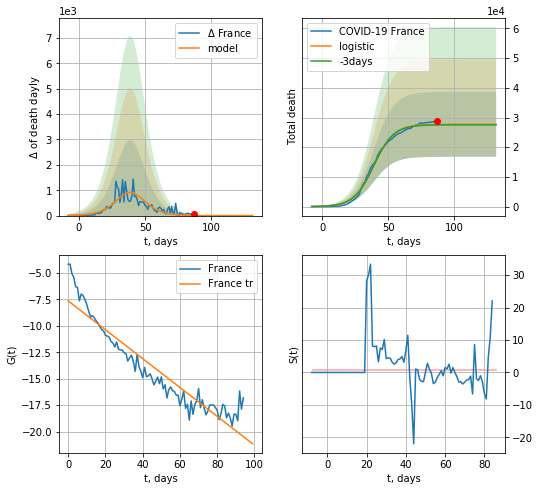

France data at: 2020-05-30
+3 day model MAPE: 0.006352828782864628
model: logistic
coeffs:  [2.77243790e+04 1.31782724e-01 3.92405668e+01]
rational stdev:  0.39425610733535654
forecast at the end of period: +45 days
	 total death:  27724 ± 10930
trend coefficient of determination: 0.887824
 intercept: -7.645054
 slope: -0.136425


In [107]:
#dfFR = read_df(pd.DataFrame(),"FR")
x = forecast('France',dfFR[10:],d1,7*16-dT-4,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


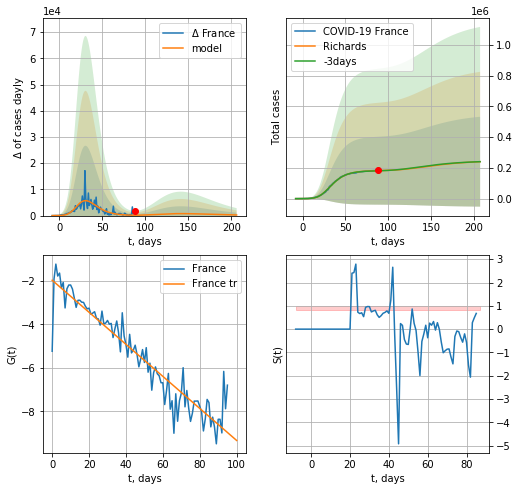

France data at: 2020-05-30
+3 day model MAPE: 0.004574
model: Richards
coeffs: [1.82394657e+05 5.24441296e-01 1.23567396e+01 1.76134027e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 1.215929
forecast at the end of period: +119 days
	 deltaDaycases: 237
	 total cases: 240569 ± 292515
	 total death: 36694 ± 133851
trend coefficient of determination: 0.886953
 intercept: -1.962170
 slope: -0.073836


In [108]:
x = forecastRR('France',dfFR[9:],d1,26*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


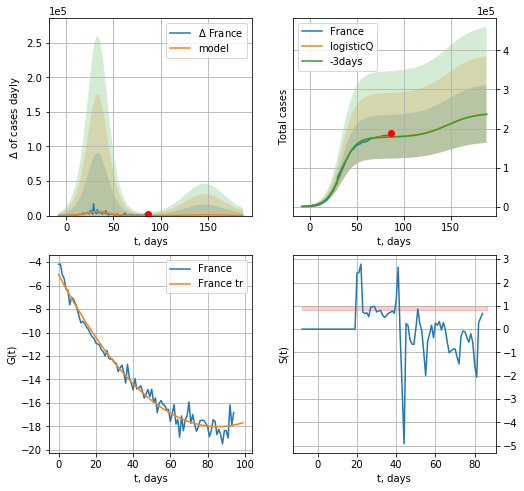

France data at: 2020-05-30
+3 day model MAPE: 0.006858
model: logisticQ
coeffs: [ 1.78237604e+05  7.48717364e-07  3.36977152e+01 -1.76257012e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.312610
forecast at the end of period: +101 days
	 deltaDaycases: 247
	 total cases: 237501 ± 74245
	 total death: 36226 ± 33973
trend coefficient of determination: 0.978430
 intercept_: -5.056901535273221
 coeffs_: [ 0.         -0.30341077  0.00177649]


In [109]:
x = forecastRRR('France',dfFR[10:],d1,24*7-dT-4,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,3.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


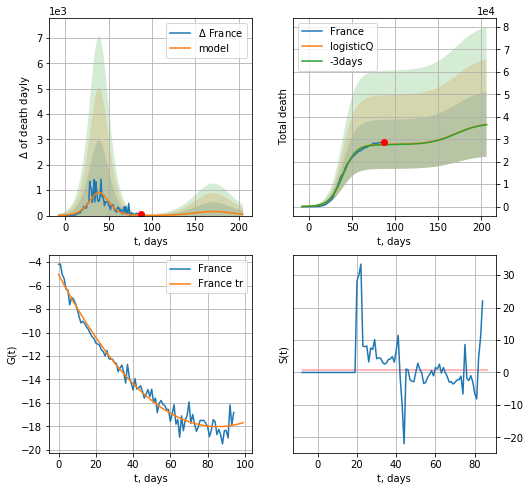

France data at: 2020-05-30
+3 day model MAPE: 0.006404
model: logisticQ
coeffs: [ 2.77240259e+04  6.23990771e-07  3.92406783e+01 -2.11085351e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.394345
forecast at the end of period: +119 days
	 total death: 36662 ± 14457
trend coefficient of determination: 0.978430
 intercept_: -5.056901535273221
 coeffs_: [ 0.         -0.30341077  0.00177649]


In [110]:
x = forecastRRR('France',dfFR[10:],d1,26*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1.])

In [124]:
#x = forecastR('France',dfFR[:],d1,8*7-dT-4,1.0,addpred=True,xcoef=[0.25,1.,20.,1])

In [125]:
#trend3(dfGR,dfUS,dfGB[:],'GR','US','GB',40,40,40)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


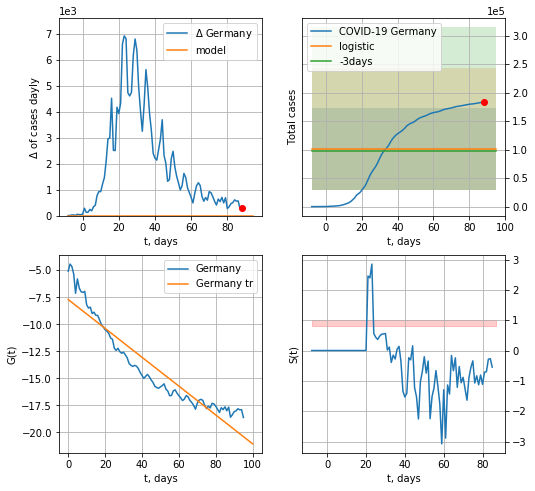

Germany data at: 2020-05-30
+3 day model MAPE: 0.026655927744951673
model: logistic
coeffs:  [ 1.00864784e+05 -4.21048159e+00  1.29579126e+02]
rational stdev:  0.709028808650755
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  100864 ± 71516
	 total death:  4732 ± 10065
trend coefficient of determination: 0.886992
 intercept: -7.709965
 slope: -0.133420


In [112]:
x = forecast('Germany',dfGR[:],d1,7*10-dT,1.0)
#xx = forecast2('Germany',dfGR,d1,7*7-dT,x,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


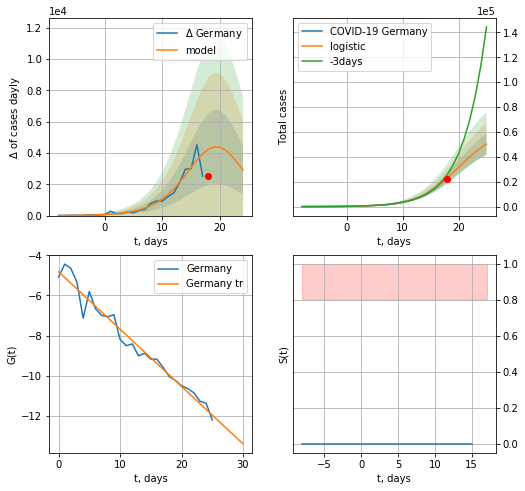

Germany data at: 2020-05-30
+3 day model MAPE: 0.18319320379671997
model: logistic
coeffs:  [6.16394025e+04 2.86275294e-01 1.98444846e+01]
rational stdev:  0.17054836328949527
forecast at the end of period: +7 days
	 deltaDaycases:  2914
	 total cases:  50171 ± 8556
	 total death:  2354 ± 1204
trend coefficient of determination: 0.966826
 intercept: -4.817840
 slope: -0.285777


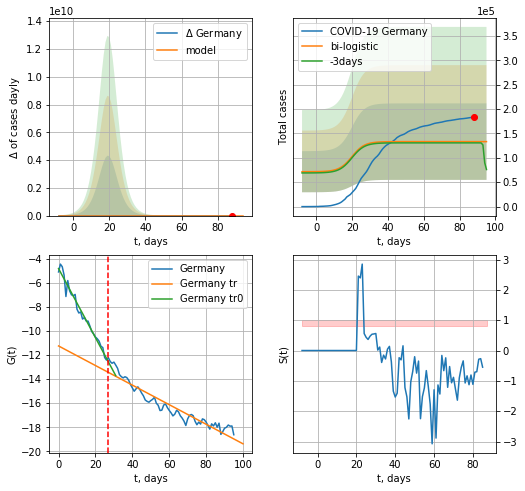

Germany data at: 2020-05-30
+3 day model MAPE: 0.01955858497928673
model: bi-logistic
coeffs:  [ 5.72377654e+04 -1.56327618e+00  1.06844126e+02] [6.16394025e+04 2.86275294e-01 1.98444846e+01]
scenario coeffs:  [0.25, 1.0, 1.6]
rational stdev:  0.5884084743300423
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  133186 ± 78368
	 total death:  6249 ± 11030
bi-logistic approximation splitting point: 27
trend0 coefficient of determination: 0.970373
 intercept: -4.806769
 slope: -0.287106
trend coefficient of determination: 0.903243
 intercept: -11.240089
 slope: -0.081356


In [114]:
vL = 27
x = forecast('Germany',dfGR[:vL],d1,10*7-dT,1.0)#,addpred=True,xcoef=[0.25,1.,2.0,1])
xx = forecast2('Germany',dfGR,d1,7*10-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.6],vL=vL)

GR
          date   cases  active   death
92 2020-05-26  181288   10790  8498.0
93 2020-05-27  181895   10562  8533.0
94 2020-05-28  182452   10682  8570.0
95 2020-05-29  183019   10325  8594.0
96 2020-05-30  183294    9794  8600.0


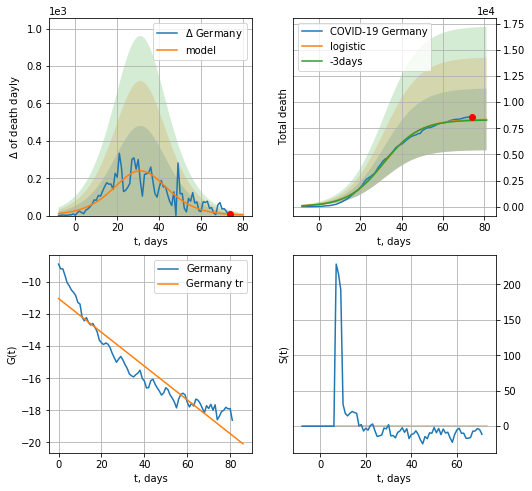

Germany data at: 2020-05-30
+3 day model MAPE: 0.008307979068561707
model: logistic
coeffs:  [8.37024940e+03 1.14620260e-01 3.14959548e+01]
rational stdev:  0.35399867547268904
forecast at the end of period: +7 days
	 total death:  8341 ± 2952
trend coefficient of determination: 0.890408
 intercept: -11.027669
 slope: -0.105407


In [116]:
dfGR = read_df(pd.DataFrame(),"GR")
x = forecast('Germany',dfGR[14:],d1,10*7-dT,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


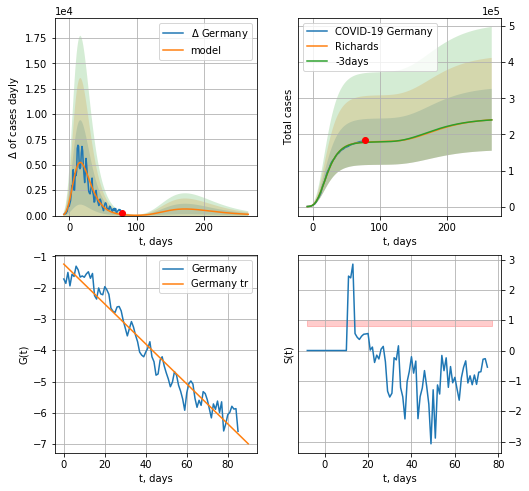

Germany data at: 2020-05-30
+3 day model MAPE: 0.004072
model: Richards
coeffs: [ 1.80065883e+05  1.09075377e+01 -4.49693519e+01  7.28210541e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.356422
forecast at the end of period: +189 days
	 deltaDaycases: 128
	 total cases: 240462 ± 85706
	 total death: 11282 ± 12063
trend coefficient of determination: 0.953111
 intercept: -1.251437
 slope: -0.063752


In [117]:
x = forecastRR('Germany',dfGR[10:],d1,36*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


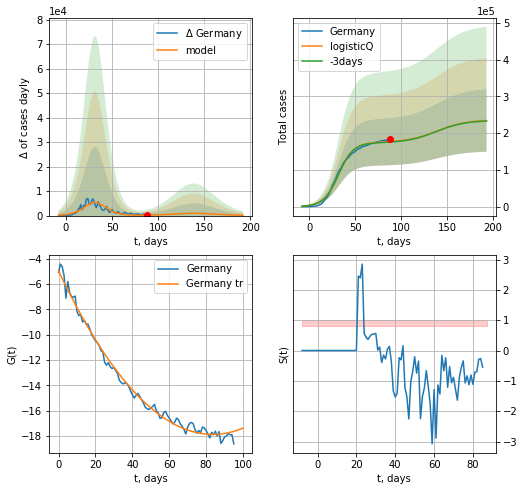

Germany data at: 2020-05-30
+3 day model MAPE: 0.006332
model: logisticQ
coeffs: [ 1.74588806e+05  4.43600630e-07  3.18495169e+01 -2.78299389e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.362556
forecast at the end of period: +105 days
	 deltaDaycases: 127
	 total cases: 234358 ± 84967
	 total death: 10995 ± 11958
trend coefficient of determination: 0.991207
 intercept_: -4.9645288943560235
 coeffs_: [ 0.         -0.30866895  0.00184477]


In [118]:
x = forecastRRR('Germany',dfGR[:],d1,24*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.0,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


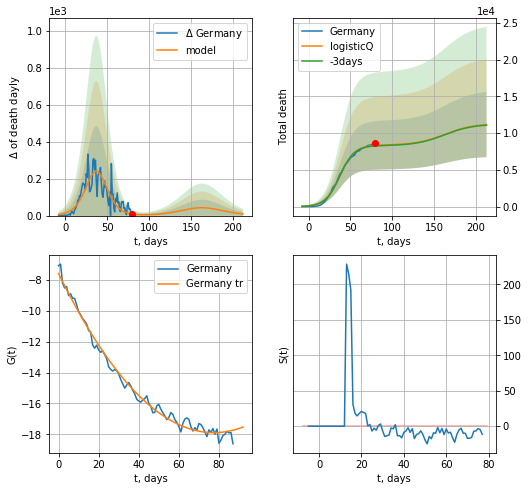

Germany data at: 2020-05-30
+3 day model MAPE: 0.008375
model: logisticQ
coeffs: [ 8.36779021e+03  1.67378596e-06  3.74910001e+01 -6.84968202e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.396757
forecast at the end of period: +133 days
	 total death: 11171 ± 4432
trend coefficient of determination: 0.989495
 intercept_: -7.564510213376573
 coeffs_: [ 0.         -0.2669044   0.00172387]


In [119]:
x = forecastRRR('Germany',dfGR[8:],d1,28*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.0,1])

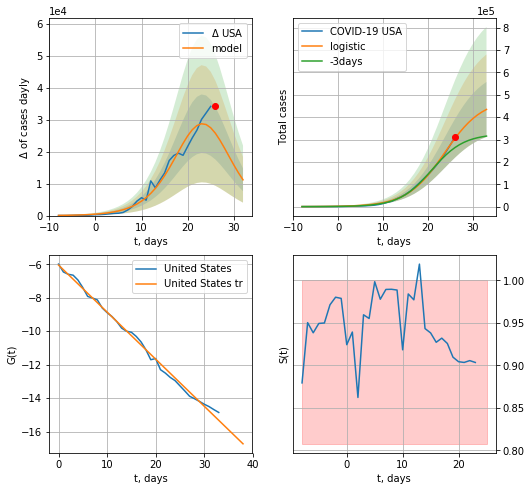

USA data at: 2020-05-30
+3 day model MAPE: 0.19535827238289116
model: logistic
coeffs:  [4.82026100e+05 2.38779089e-01 2.37021772e+01]
rational stdev:  0.2829911701138887
forecast at the end of period: +7 days
	 deltaDaycases:  11191
	 total cases:  434807 ± 123046
	 total death:  25262 ± 21446
trend coefficient of determination: 0.994973
 intercept: -6.048067
 slope: -0.281243


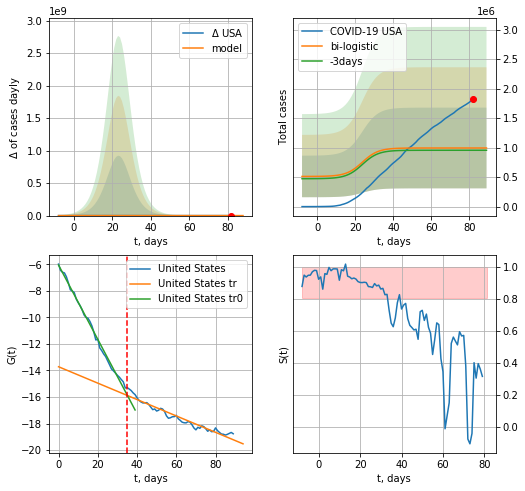

USA data at: 2020-05-30
+3 day model MAPE: 0.040274428798680005
model: bi-logistic
coeffs:  [ 4.08767712e+05 -5.83862850e+00  1.51748522e+02] [4.82026100e+05 2.38779089e-01 2.37021772e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
rational stdev:  0.6885705891384963
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  992985 ± 683740
	 total death:  57692 ± 119175
bi-logistic approximation splitting point: 35
trend0 coefficient of determination: 0.995079
 intercept: -6.063262
 slope: -0.279862
trend coefficient of determination: 0.941130
 intercept: -13.721755
 slope: -0.061757


In [120]:
vL=35
x = forecast('USA',dfUS[:vL],d1,10*7-dT,1.0,addpred=False,xcoef=[0.25,1.,2.])
xx = forecast2('USA',dfUS[:],d1,10*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.5],vL=vL)

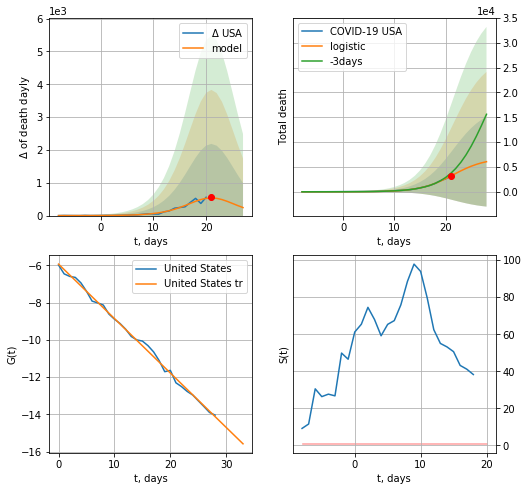

USA data at: 2020-05-30
+3 day model MAPE: 0.214213224760407
model: logistic
coeffs:  [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  1.4929056707100332
forecast at the end of period: +7 days
	 total death:  6060 ± 9047
trend coefficient of determination: 0.996563
 intercept: -5.939898
 slope: -0.291951


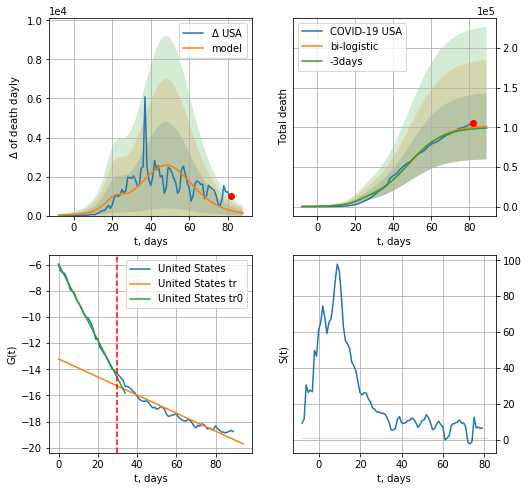

USA data at: 2020-05-30
+3 day model MAPE: 0.020773980106293687
model: bi-logistic
coeffs:  [9.55555271e+04 1.08012236e-01 4.85187692e+01] [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  0.4125634700964519
forecast at the end of period: +7 days
	 deltaDaydeath:  133
	 total death:  101198 ± 41750
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.996662
 intercept: -5.952610
 slope: -0.290589
trend coefficient of determination: 0.926999
 intercept: -13.206076
 slope: -0.069095


In [122]:
vL=30
x = forecast('USA',dfUS[:vL],d1,7*10-dT,1.0,cases='death')
xx = forecast2('USA',dfUS,d1,7*10-dT,x,1.0,cases='death',vL=vL)
#x = forecast('USA',dfUS[:],d1,28*3-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


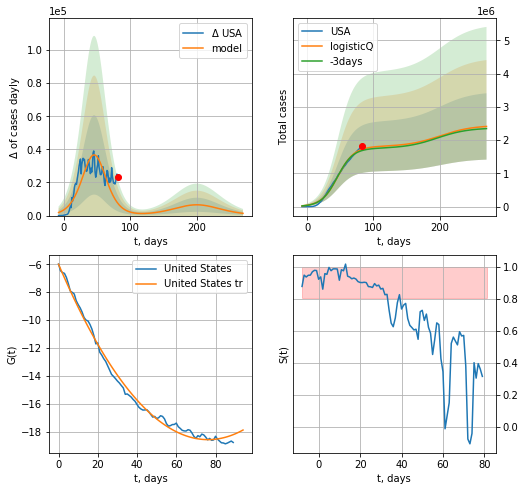

USA data at: 2020-05-30
+3 day model MAPE: 0.022579
model: logisticQ
coeffs: [ 1.80547280e+06  4.91943493e-07  4.60559750e+01 -1.64898331e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.413763
forecast at the end of period: +189 days
	 deltaDaycases: 1352
	 total cases: 2410536 ± 997391
	 total death: 140051 ± 173843
trend coefficient of determination: 0.993133
 intercept_: -6.002677041440464
 coeffs_: [ 0.         -0.32990428  0.00216554]


In [123]:
x = forecastRRR('USA',dfUS[:],d1,7*36-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.,1.])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


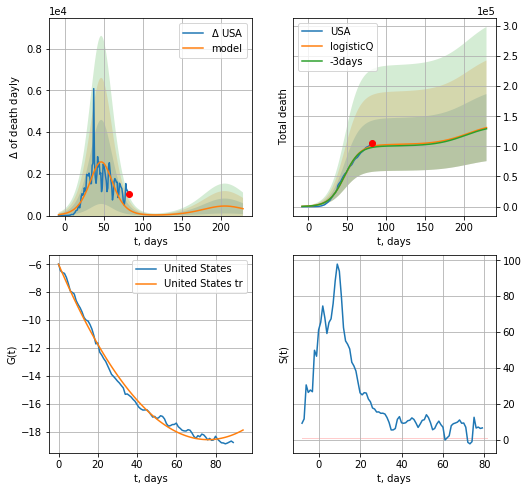

USA data at: 2020-05-30
+3 day model MAPE: 0.019391
model: logisticQ
coeffs: [ 1.03131111e+05  7.23483864e-07  4.70569041e+01 -1.37875868e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.424801
forecast at the end of period: +147 days
	 total death: 131198 ± 55733
trend coefficient of determination: 0.993133
 intercept_: -6.002677041440464
 coeffs_: [ 0.         -0.32990428  0.00216554]


In [124]:
x = forecastRRR('USA',dfUS[:],d1,7*30-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


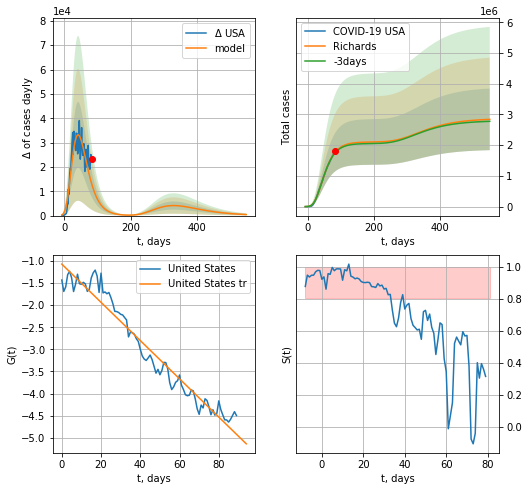

USA data at: 2020-05-30
+3 day model MAPE: 0.011389
model: Richards
coeffs: [ 2.10688107e+06  4.38173514e+00 -6.56533487e+01  9.82012022e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.353212
forecast at the end of period: +469 days
	 deltaDaycases: 425
	 total cases: 2841125 ± 1003519
	 total death: 165068 ± 174911
trend coefficient of determination: 0.952626
 intercept: -1.071037
 slope: -0.043274


In [125]:
x = forecastRR('USA',dfUS[:],d1,7*76-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


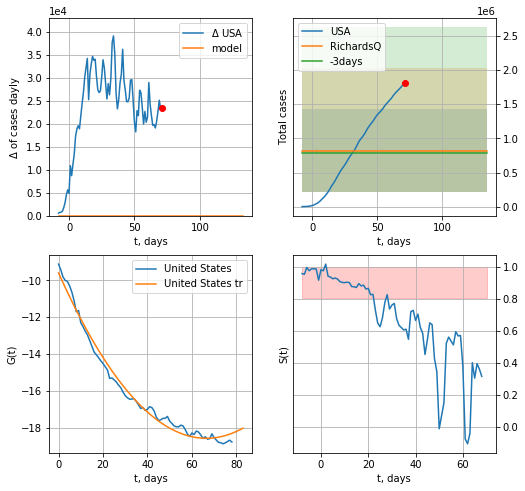

USA data at: 2020-05-30
+3 day model MAPE: 0.048562
model: RichardsQ
coeffs: [ 8.19175690e+05  2.70532986e+00 -2.10286775e+03  1.77786560e+03
 -2.92839778e+00]
rational stdev: 0.737322
forecast at the end of period: +63 days
	 deltaDaycases: 0
	 total cases: 819175 ± 603995
	 total death: 47593 ± 105274
trend coefficient of determination: 0.986500
 intercept_: -9.599392257871752
 coeffs_: [ 0.         -0.26973073  0.00202808]


In [126]:
x = forecastQR('USA',dfUS[11:],d1,7*18-dT,1.0,addpred=False,xcoef=[0.35,.5,3.,1.,1.])

GB
          date   cases  active    death
90 2020-05-26  265227       0  37048.0
91 2020-05-27  267240       0  37460.0
92 2020-05-28  269127       0  37837.0
93 2020-05-29  271222       0  38161.0
94 2020-05-30  272826       0  38376.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


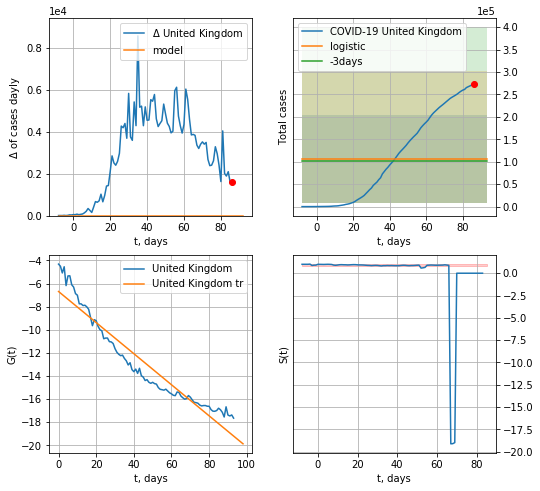

United Kingdom data at: 2020-05-30
+3 day model MAPE: 0.05338433572338445
model: logistic
coeffs:  [ 1.06124579e+05 -6.71020595e+00  1.79482704e+02]
rational stdev:  0.9245724341450171
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  106124 ± 98119
	 total death:  14927 ± 41403
trend coefficient of determination: 0.918462
 intercept: -6.689301
 slope: -0.134546


In [128]:
dfGB = read_df(pd.DataFrame(),"GB")
x = forecast('United Kingdom',dfGB[:],d1,7*10-dT,1.)
#x = forecast('United Kingdom',dfGB[:-8-dT],d1,4*7-dT,1.)
#xx = forecast2('United Kingdom',dfGB[:],d1,4*7-dT,x,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


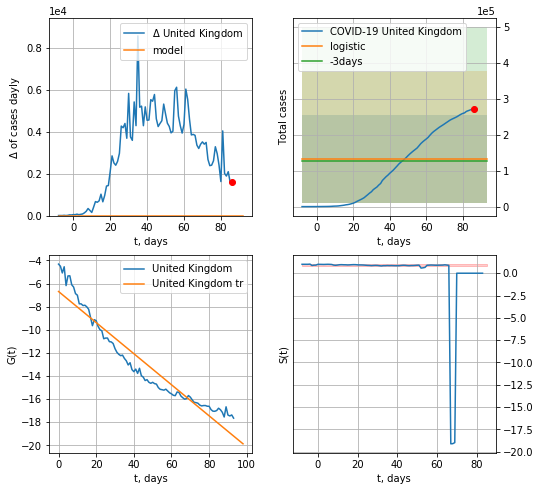

United Kingdom data at: 2020-05-30
+3 day model MAPE: 0.053384335723384455
model: logistic
coeffs:  [ 1.06124579e+05 -6.71020595e+00  1.79482704e+02]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.9245724341450171
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  132655 ± 122649
	 total death:  18659 ± 51754
trend coefficient of determination: 0.918462
 intercept: -6.689301
 slope: -0.134546


In [129]:
x = forecast('United Kingdom',dfGB[:],d1,10*7-dT,1.,addpred=True,xcoef=[0.25,1.,1.8])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: divide by zero encountered in true_divide


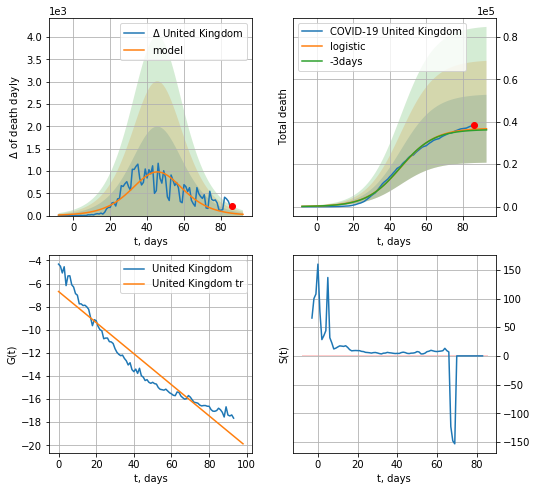

United Kingdom data at: 2020-05-30
+3 day model MAPE: 0.014069332712702491
model: logistic
coeffs:  [3.69836540e+04 1.05858772e-01 4.60330424e+01]
rational stdev:  0.4359799630251277
forecast at the end of period: +7 days
	 total death:  36729 ± 16013
trend coefficient of determination: 0.918462
 intercept: -6.689301
 slope: -0.134546


In [130]:
x = forecast('United Kingdom',dfGB[:],d1,10*7-dT,1.,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


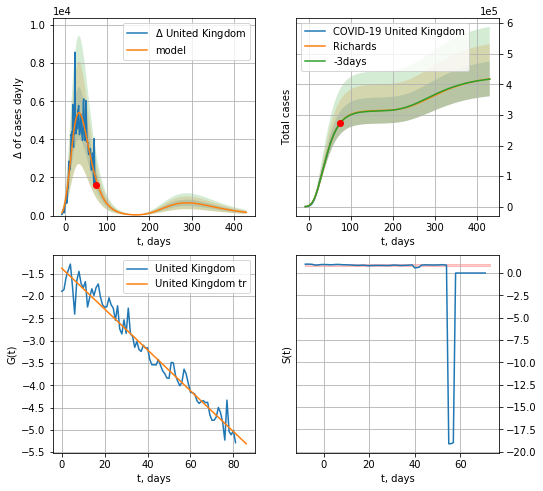

United Kingdom data at: 2020-05-30
+3 day model MAPE: 0.002273
model: Richards
coeffs: [ 3.14948480e+05  3.91386376e+00 -6.12267197e+01  1.19736556e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.135657
forecast at the end of period: +357 days
	 deltaDaycases: 171
	 total cases: 417858 ± 56685
	 total death: 58776 ± 23920
trend coefficient of determination: 0.960924
 intercept: -1.381045
 slope: -0.045712


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


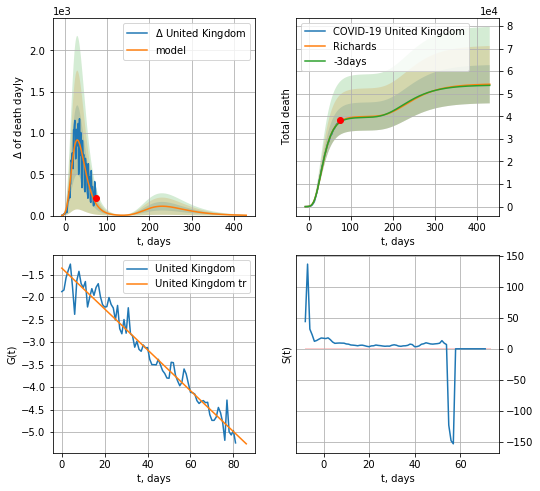

United Kingdom data at: 2020-05-30
+3 day model MAPE: 0.006654
model: Richards
coeffs: [ 3.99392343e+04  7.36689424e+00 -4.70642380e+01  8.48982119e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.156173
forecast at the end of period: +357 days
	 total death: 54214 ± 8466
trend coefficient of determination: 0.960319
 intercept: -1.352822
 slope: -0.045472


In [131]:
x = forecastRR('United Kingdom',dfGB[12:],d1,60*7-dT,1.,addpred=True,xcoef=RkoreaCoeffs)
x = forecastRR('United Kingdom',dfGB[12:],d1,60*7-dT,1.,addpred=True,xcoef=RkoreaCoeffs,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


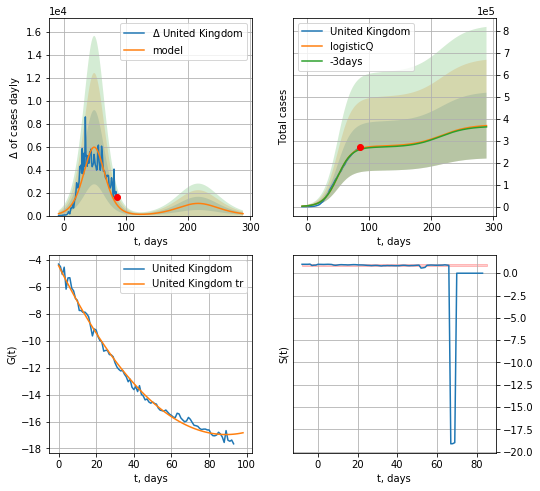

United Kingdom data at: 2020-05-30
+3 day model MAPE: 0.013067
model: logisticQ
coeffs: [ 2.74968633e+05  5.94407235e-07  4.96643013e+01 -1.45426014e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.406357
forecast at the end of period: +203 days
	 deltaDaycases: 169
	 total cases: 368371 ± 149690
	 total death: 51815 ± 63166
trend coefficient of determination: 0.993822
 intercept_: -4.425528760327605
 coeffs_: [ 0.         -0.28219155  0.00158763]


In [132]:
x = forecastRRR('United Kingdom',dfGB[:],d1,38*7-dT,1.,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


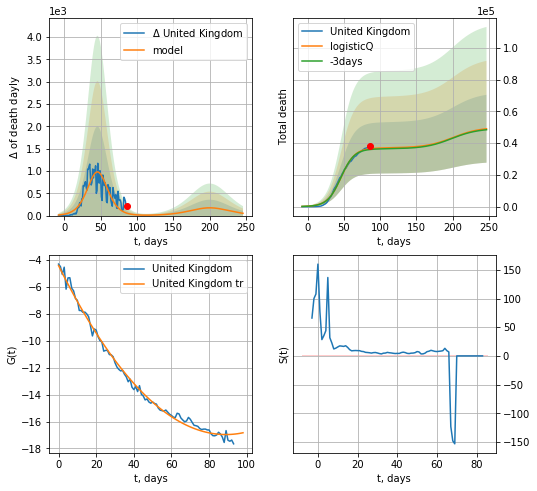

United Kingdom data at: 2020-05-30
+3 day model MAPE: 0.014126
model: logisticQ
coeffs: [ 3.69820851e+04  6.45643238e-07  4.60328231e+01 -1.63884009e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.436008
forecast at the end of period: +161 days
	 total death: 49056 ± 21389
trend coefficient of determination: 0.993822
 intercept_: -4.425528760327605
 coeffs_: [ 0.         -0.28219155  0.00158763]


In [133]:
x = forecastRRR('United Kingdom',dfGB[:],d1,32*7-dT,1.,addpred=True,xcoef=koreaCoeffs,cases='death')

In [126]:
#x = forecastQR('United Kingdom',dfGB[:],d1,18*7-dT,1.,addpred=True,xcoef=[0.35,.5,3,1,1])

In [127]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,2.4,1])

In [128]:
#trend3(dfDK,dfNG,dfSW[:],'DK','NG','SW',40,40,40)

In [129]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,4.,1])

In [130]:
#x = forecast('Denmark',dfDK[:15],d1,2*7-dT,1.0)
#xx = forecast2('Denmark',dfDK[:],d1,4*7-dT, x,1.0)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3('Denmark',dfDK[:],d1,14-dT, xx)

In [134]:
dT

63

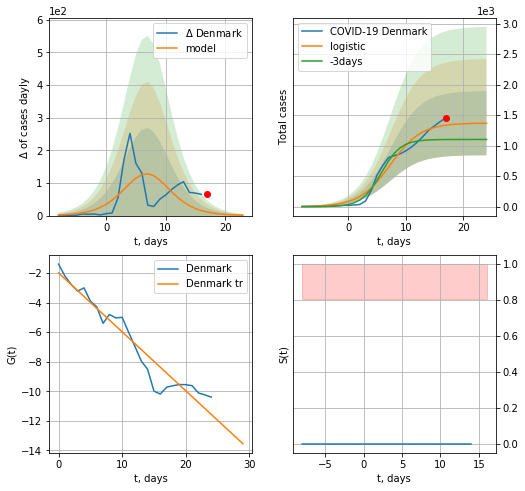

Denmark data at: 2020-05-30
+3 day model MAPE: 0.22309164372685597
model: logistic
coeffs:  [1.36966073e+03 3.75718860e-01 7.30059729e+00]
rational stdev:  0.38476605910227335
forecast at the end of period: +7 days
	 deltaDaycases:  1
	 total cases:  1367 ± 526
	 total death:  67 ± 77
trend coefficient of determination: 0.928037
 intercept: -1.984791
 slope: -0.399221


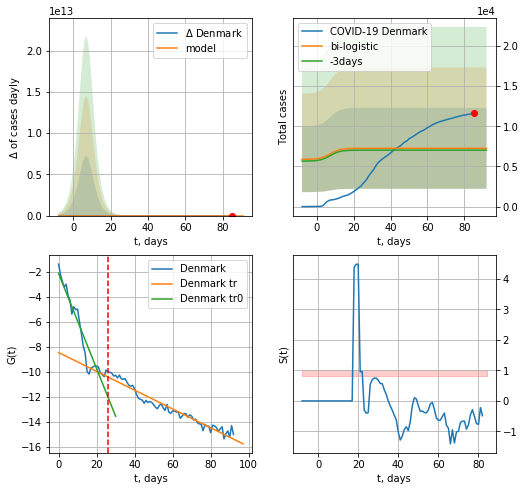

Denmark data at: 2020-05-30
+3 day model MAPE: 0.032253648233333085
model: bi-logistic
coeffs:  [ 4.70848838e+03 -3.33311186e+00  9.77707927e+01] [1.36966073e+03 3.75718860e-01 7.30059729e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.6939350158157909
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  7255 ± 5034
	 total death:  356 ± 741
bi-logistic approximation splitting point: 26
trend0 coefficient of determination: 0.914728
 intercept: -2.128126
 slope: -0.381304
trend coefficient of determination: 0.943764
 intercept: -8.466626
 slope: -0.075394


In [136]:
vL = 26
x = forecast('Denmark',dfDK[:vL],d1,7*10-dT,1.0)
xx = forecast2('Denmark',dfDK[:],d1,10*7-dT, x,1.0,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


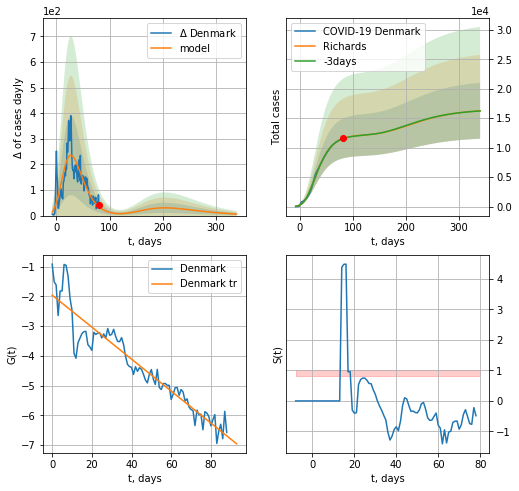

Denmark data at: 2020-05-30
+3 day model MAPE: 0.002243
model: Richards
coeffs: [ 1.21802901e+04  5.71722306e-01 -1.49255197e+01  9.61326710e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.291610
forecast at the end of period: +259 days
	 deltaDaycases: 6
	 total cases: 16260 ± 4741
	 total death: 798 ± 698
trend coefficient of determination: 0.899024
 intercept: -1.957917
 slope: -0.053729


In [137]:
x = forecastRR('Denmark',dfDK[4:],d1,46*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
#x2 = forecast2R('Denmark',dfDK[:],d1,16*7-dT,x,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


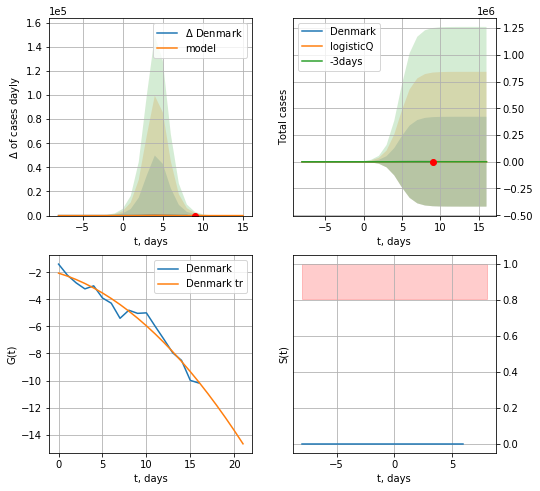

Denmark data at: 2020-05-30
+3 day model MAPE: 2.879608
model: logisticQ
coeffs: [ 8.62480490e+02  2.49401516e-04  4.73670538e+00 -4.50088701e+03]
rational stdev: 487.269302
forecast at the end of period: +7 days
	 deltaDaycases: 0
	 total cases: 862 ± 420258
	 total death: 42 ± 61395
trend coefficient of determination: 0.965266
 intercept_: -2.0557034713075613
 coeffs_: [ 0.         -0.1970759  -0.01925246]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


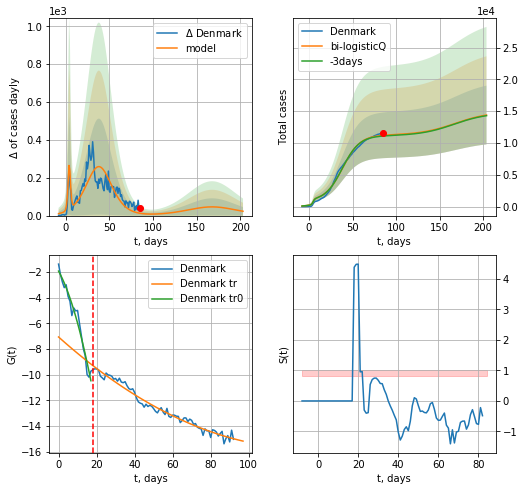

Denmark data at: 2020-05-30
+3 day model MAPE: 0.009447
model: bi-logisticQ
coeffs: [ 1.03811582e+04  3.86666992e-07  3.85622176e+01 -2.57530717e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.320658
forecast at the end of period: +119 days
	 deltaDaycases: 22
	 total cases: 14398 ± 4617
	 total death: 706 ± 679
bi-logisticQ approximation splitting point: 18
trend coefficient of determination: 0.963211
 intercept_: -1.9308894789691964
 coeffs_: [ 0.         -0.26605777 -0.01390014]
trend coefficient of determination: 0.973609
 intercept_: -7.061394636194977
 coeffs_: [ 0.         -0.13259621  0.00050486]


In [139]:
x = forecastRRR('Denmark',dfDK[:18],d1,10*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[0.35,0.5,4.5,1.])
x = forecast2RRR('Denmark',dfDK[:],d1,26*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=18)

NG
          date  cases  active  death
90 2020-05-26   8383     421  235.0
91 2020-05-27   8401     439  235.0
92 2020-05-28   8411     448  236.0
93 2020-05-29   8422     459  236.0
94 2020-05-30   8437     474  236.0


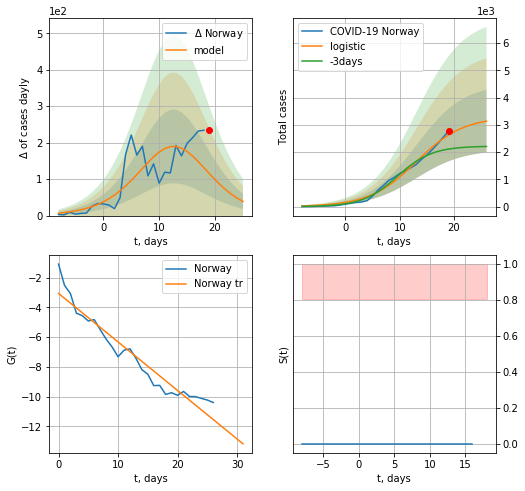

Norway data at: 2020-05-30
+3 day model MAPE: 0.2814819001616187
model: logistic
coeffs:  [3.29798793e+03 2.30651156e-01 1.30696563e+01]
rational stdev:  0.3674391911615601
forecast at the end of period: +7 days
	 deltaDaycases:  38
	 total cases:  3138 ± 1153
	 total death:  87 ± 95
trend coefficient of determination: 0.927855
 intercept: -3.067798
 slope: -0.326083


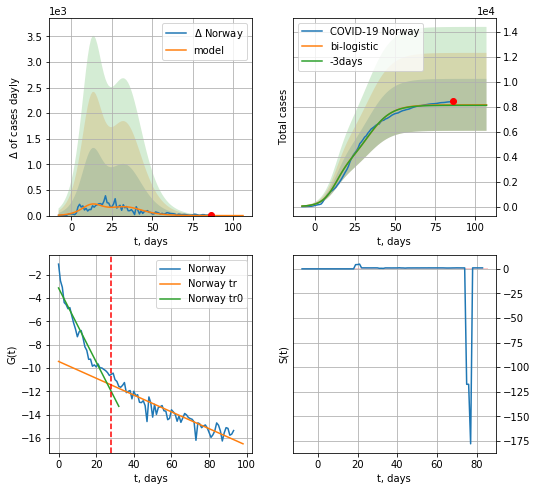

Norway data at: 2020-05-30
+3 day model MAPE: 0.004456262486029132
model: bi-logistic
coeffs:  [4.87053508e+03 1.36582513e-01 3.36698328e+01] [3.29798793e+03 2.30651156e-01 1.30696563e+01]
rational stdev:  0.25527363362636135
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  8168 ± 2085
	 total death:  228 ± 174
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.925279
 intercept: -3.146002
 slope: -0.317060
trend coefficient of determination: 0.872727
 intercept: -9.445195
 slope: -0.072088


In [140]:
dfNG = read_df(pd.DataFrame(),"NG")
vL=28
x = forecast('Norway',dfNG[:vL],d1,7*10-dT,1.0)
xx = forecast2('Norway',dfNG[:],d1,12*7-dT,x,1.0,vL=vL)
#xx = np.concatenate((x, xx), axis=0)

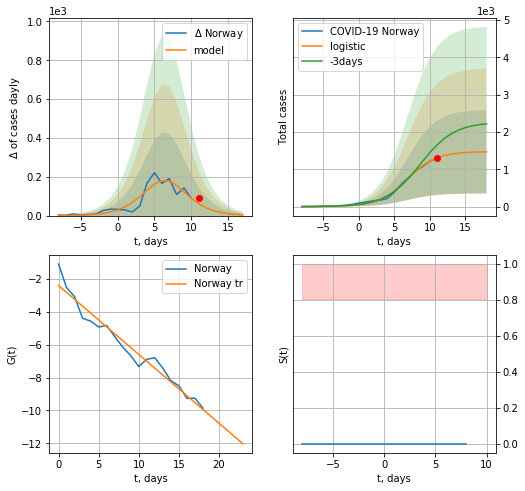

Norway data at: 2020-05-30
+3 day model MAPE: 0.247655347933597
model: logistic
coeffs:  [1.47478891e+03 4.95866797e-01 6.87524749e+00]
rational stdev:  0.7596156049961639
forecast at the end of period: +7 days
	 deltaDaycases:  3
	 total cases:  1468 ± 1115
	 total death:  41 ± 93
trend coefficient of determination: 0.956890
 intercept: -2.403448
 slope: -0.418410


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


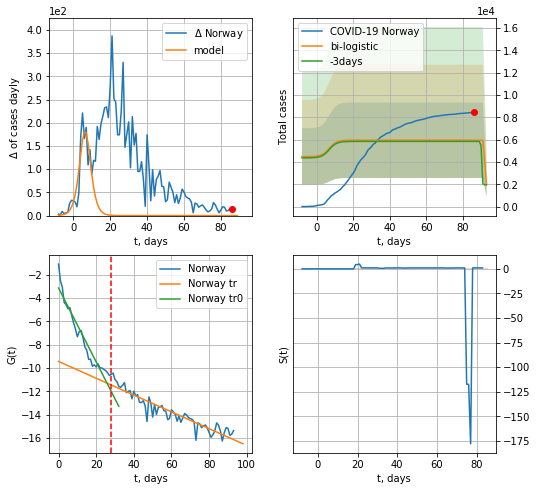

Norway data at: 2020-05-30
+3 day model MAPE: 0.018679560804651427
model: bi-logistic
coeffs:  [3975.69195059   -5.68293026   92.00848075] [1.47478891e+03 4.95866797e-01 6.87524749e+00]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.5686358728689
forecast at the end of period: +7 days
	 deltaDaycases:  -2021
	 total cases:  1985 ± 1129
	 total death:  55 ± 93
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.925279
 intercept: -3.146002
 slope: -0.317060
trend coefficient of determination: 0.872727
 intercept: -9.445195
 slope: -0.072088


In [141]:
vL = 28#len(dfNG)-13-dT
x = forecast('Norway',dfNG[:-12-dT],d1,7*10-dT,1.0)
xx = forecast2('Norway',dfNG[:],d1,10*7-dT,x,1.0,addpred=True,xcoef=[0.25/2,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


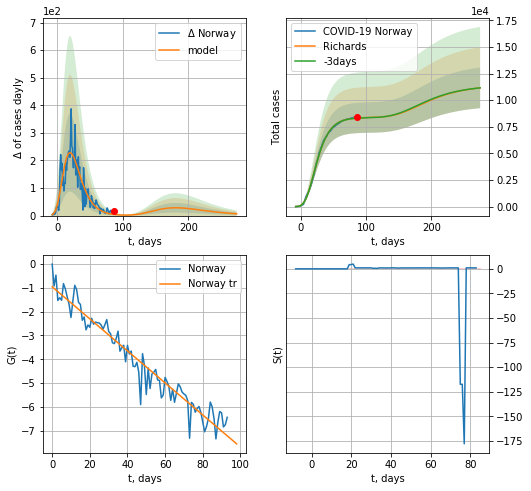

Norway data at: 2020-05-30
+3 day model MAPE: 0.001927
model: Richards
coeffs: [ 8.38068863e+03  6.64890159e+00 -4.05409633e+01  1.11949148e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.171145
forecast at the end of period: +189 days
	 deltaDaycases: 6
	 total cases: 11151 ± 1908
	 total death: 311 ± 159
trend coefficient of determination: 0.939501
 intercept: -0.963878
 slope: -0.067146


In [142]:
x = forecastRR('Norway',dfNG[:],d1,36*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
#x = forecastQR('Norway',dfNG[:],d1,8*7-dT,1.0)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


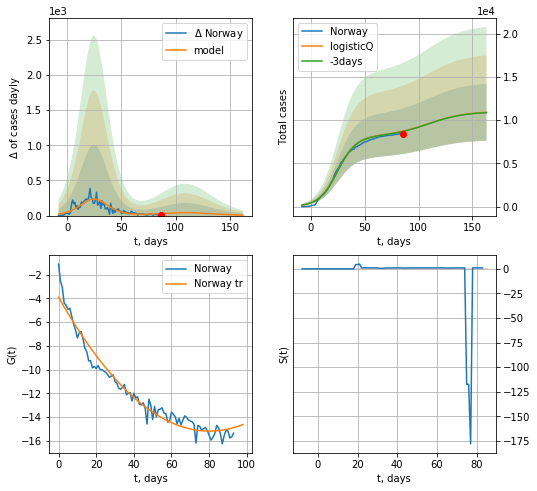

Norway data at: 2020-05-30
+3 day model MAPE: 0.003228
model: logisticQ
coeffs: [ 8.13608261e+03  4.91309793e-07  2.50181879e+01 -2.35047590e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.301855
forecast at the end of period: +77 days
	 deltaDaycases: 6
	 total cases: 10897 ± 3289
	 total death: 304 ± 275
trend coefficient of determination: 0.961949
 intercept_: -3.88825164361897
 coeffs_: [ 0.         -0.2820372   0.00175849]


In [143]:
x = forecastRRR('Norway',dfNG[:],d1,20*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


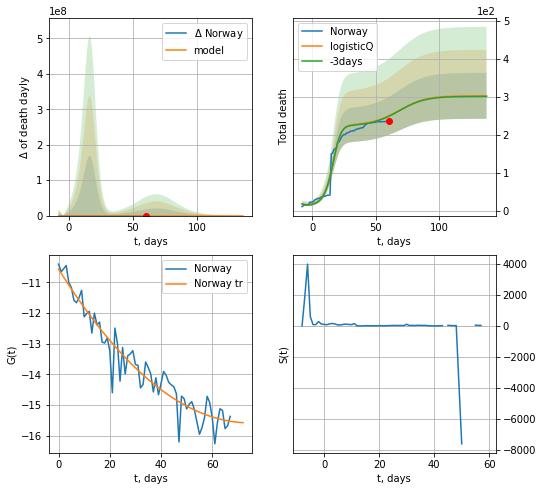

Norway data at: 2020-05-30
+3 day model MAPE: 0.004351
model: logisticQ
coeffs: [ 2.23923968e+02  6.97803337e-03  1.55593797e+01 -2.31279026e+01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.199850
forecast at the end of period: +77 days
	 total death: 303 ± 60
trend coefficient of determination: 0.921495
 intercept_: -10.56187918456046
 coeffs_: [ 0.         -0.13446906  0.00089989]


In [144]:
x = forecastRRR('Norway',dfNG[26:],d1,20*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

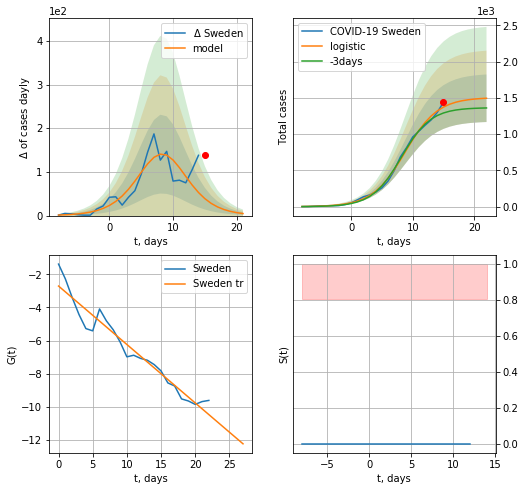

Sweden data at: 2020-05-30
+3 day model MAPE: 0.0730548600677782
model: logistic
coeffs:  [1.50473584e+03 3.76040161e-01 8.77120622e+00]
rational stdev:  0.21926973222081286
forecast at the end of period: +7 days
	 deltaDaycases:  4
	 total cases:  1494 ± 327
	 total death:  176 ± 115
trend coefficient of determination: 0.941971
 intercept: -2.710792
 slope: -0.352814


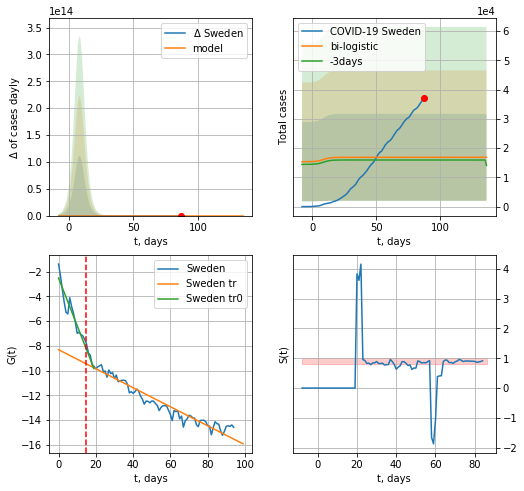

Sweden data at: 2020-05-30
+3 day model MAPE: 0.05735074701370752
model: bi-logistic
coeffs:  [ 1.22731872e+04 -5.29177829e+00  1.42620152e+02] [1.50473584e+03 3.76040161e-01 8.77120622e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.8816098250287341
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  16846 ± 14851
	 total death:  1994 ± 5273
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.870123
 intercept: -2.515075
 slope: -0.384868
trend coefficient of determination: 0.928297
 intercept: -8.306552
 slope: -0.076864


In [146]:
vL = 15#len(dfSW)-12-dT
x = forecast('Sweden',dfSW[:-9-dT],d1,7*10-dT,1.0)
xx = forecast2('Sweden',dfSW[:],d1,7*16-dT,x,1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)

SW
          date  cases  active   death
91 2020-05-26  34440   25344  4125.0
92 2020-05-27  35088   25897  4220.0
93 2020-05-28  35727   26490  4266.0
94 2020-05-29  36476   27155  4350.0
95 2020-05-30  37113   27747  4395.0


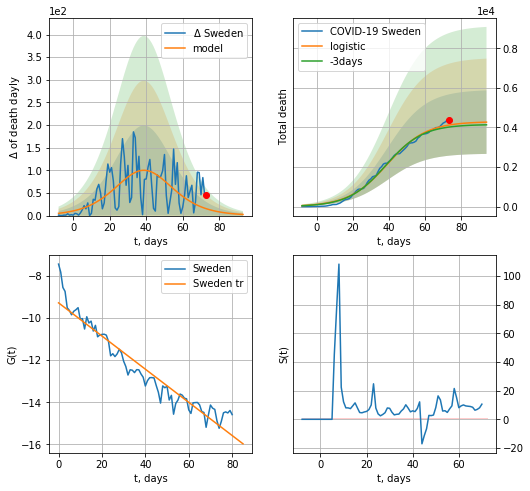

Sweden data at: 2020-05-30
+3 day model MAPE: 0.0259265090898859
model: logistic
coeffs:  [4.29543256e+03 9.32939915e-02 3.91877371e+01]
rational stdev:  0.3759300765377386
forecast at the end of period: +21 days
	 total death:  4269 ± 1605
trend coefficient of determination: 0.922419
 intercept: -9.289079
 slope: -0.078608


In [147]:
dfSW = read_df(pd.DataFrame(),"SW")
x = forecast('Sweden',dfSW[14:],d1,3*7,shift=1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


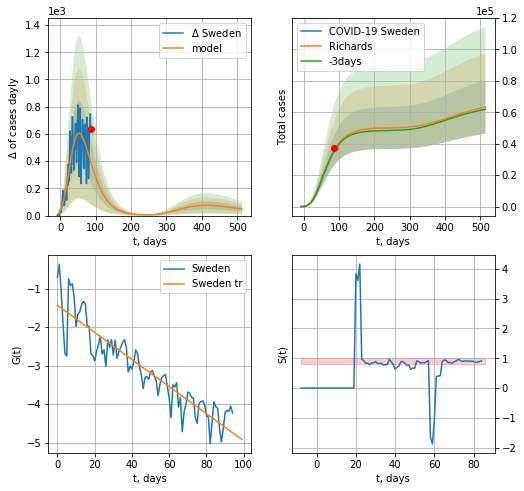

Sweden data at: 2020-05-30
+3 day model MAPE: 0.011388
model: Richards
coeffs: [ 5.01923065e+04  2.09932357e+00 -7.22250086e+01  1.57362673e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.267812
forecast at the end of period: +427 days
	 deltaDaycases: 47
	 total cases: 63390 ± 16976
	 total death: 7506 ± 6030
trend coefficient of determination: 0.838698
 intercept: -1.436451
 slope: -0.035145


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:75: RuntimeWarning: invalid value encountered in true_divide


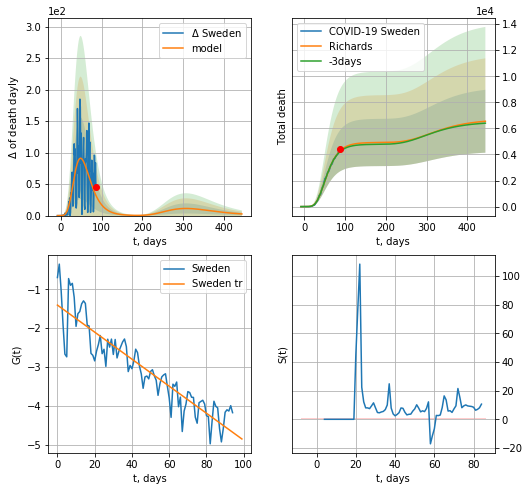

Sweden data at: 2020-05-30
+3 day model MAPE: 0.014400
model: Richards
coeffs: [ 4.92422210e+03  5.22970171e+00 -4.27068003e+01  9.66485215e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.368365
forecast at the end of period: +357 days
	 total death: 6549 ± 2412
trend coefficient of determination: 0.836301
 intercept: -1.406816
 slope: -0.034692


In [148]:
x = forecastRR('Sweden',dfSW[:],d1,70*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
x = forecastRR('Sweden',dfSW[:],d1,60*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs,cases='death')
#x = forecastQR('Sweden',dfSW[:],d1,16*7-dT,1.0)
#xx = forecast2R('Sweden',dfSW[:],d1,12*7-dT,x,1.0)#,addpred=True,xcoef=[0.25,1.,2.3,1]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


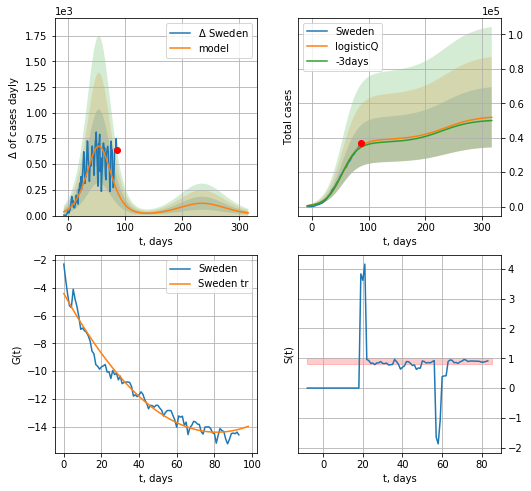

Sweden data at: 2020-05-30
+3 day model MAPE: 0.025168
model: logisticQ
coeffs: [ 3.88811524e+04  5.70987661e-07  5.39542487e+01 -1.21435003e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.336989
forecast at the end of period: +231 days
	 deltaDaycases: 25
	 total cases: 51902 ± 17490
	 total death: 6146 ± 6213
trend coefficient of determination: 0.967181
 intercept_: -4.3978179768770715
 coeffs_: [ 0.         -0.246026    0.00151352]


In [149]:
x = forecastRRR('Sweden',dfSW[1:],d1,42*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


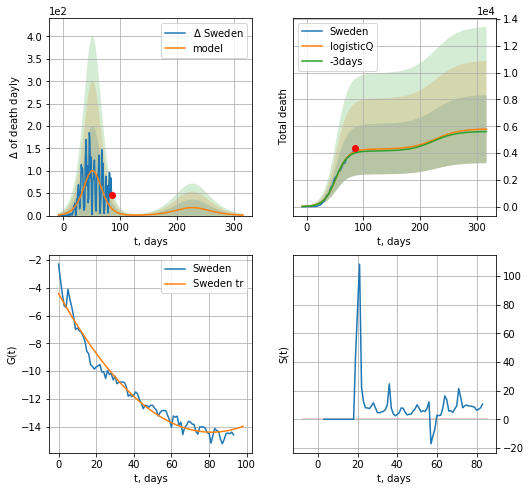

Sweden data at: 2020-05-30
+3 day model MAPE: 0.026017
model: logisticQ
coeffs: [ 4.29096133e+03  6.18967393e-07  5.21593269e+01 -1.51120187e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.439418
forecast at the end of period: +231 days
	 total death: 5788 ± 2543
trend coefficient of determination: 0.967181
 intercept_: -4.3978179768770715
 coeffs_: [ 0.         -0.246026    0.00151352]


In [150]:
x = forecastRRR('Sweden',dfSW[1:],d1,42*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')

CN
           date    cases  active   death
125 2020-05-26  82993.0      79  4634.0
126 2020-05-27  82995.0      73  4634.0
127 2020-05-28  82995.1      70  4634.0
128 2020-05-29  82999.0      63  4634.0
129 2020-05-30  83001.0      63  4634.0


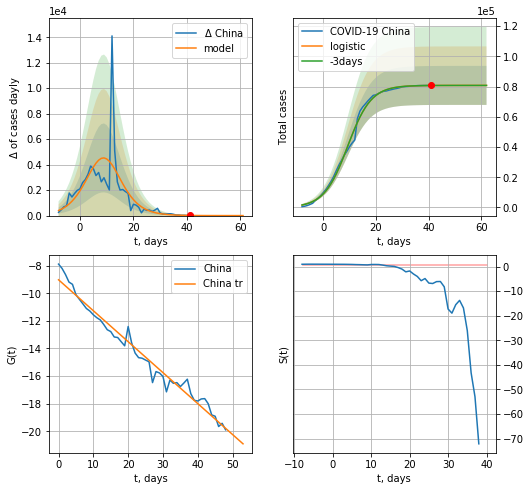

China data at: 2020-05-30
+3 day model MAPE: 0.00012785692335583266
model: logistic
coeffs:  [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.15971316009002232
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  80809 ± 12906
	 total death:  4511 ± 2161
trend coefficient of determination: 0.972183
 intercept: -9.021396
 slope: -0.224243


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


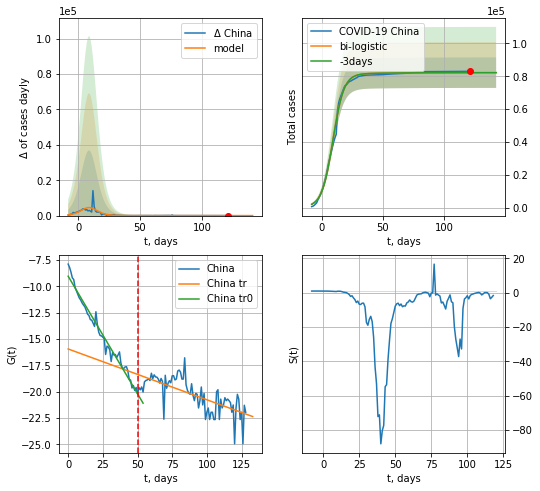

China data at: 2020-05-30
+3 day model MAPE: 5.559397264302254e-05
model: bi-logistic
coeffs:  [1.40330851e+03 3.51462460e-02 1.63706186e+01] [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.11302160908943099
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  82196 ± 9290
	 total death:  4589 ± 1555
bi-logistic approximation splitting point: 50
trend0 coefficient of determination: 0.973282
 intercept: -9.036652
 slope: -0.223289
trend coefficient of determination: 0.480792
 intercept: -15.947480
 slope: -0.048246


In [151]:
dfCN = read_df(pd.DataFrame(),"CN")
try:
    x = forecast('China',dfCN[:50],d1,7*12-dT,1.0)
    #xx = forecast('China',dfCN[21:-32],d1,17)
    #xx = np.concatenate((x, xx), axis=0)
    xx = forecast2('China',dfCN[:],d1,12*7-dT,x,1.0,vL=50)
except:
    print ("Exception occurs")

In [152]:
#dfTT[dfTT.Country=='%s'%('China')][0].values[0]

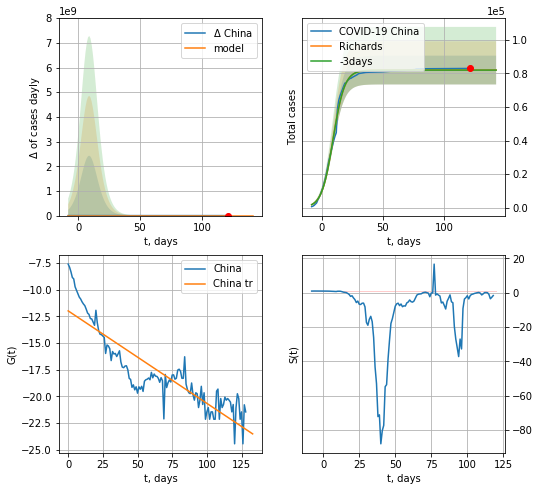

China data at: 2020-05-30
+3 day model MAPE: 0.000410
model: Richards
coeffs: [8.20426590e+04 2.23326783e-01 9.18145386e+00 9.55740405e-01]
rational stdev: 0.104558
forecast at the end of period: +21 days
	 deltaDaycases: 0
	 total cases: 82042 ± 8578
	 total death: 4580 ± 1436
trend coefficient of determination: 0.787638
 intercept: -11.977207
 slope: -0.086798


In [153]:
x = forecastRR('China',dfCN[:],d1,12*7-dT,1.0)
#x = forecastQR('China',dfCN[:],d1,6*7-dT,1.0)
#xx = forecast('China',dfCN[21:-32],d1,17)
#xx = np.concatenate((x, xx), axis=0)
#xx = forecast2R('China',dfCN[:],d1,6*7-dT,x,1.0)

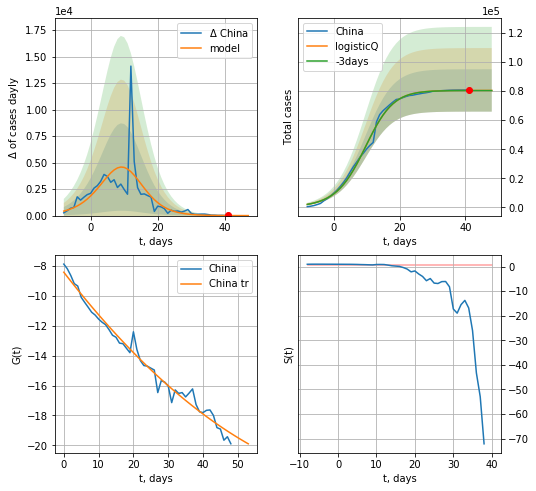

China data at: 2020-05-30
+3 day model MAPE: 0.001323
model: logisticQ
coeffs: [ 8.04175259e+04  1.07650457e-03  9.35257488e+00 -2.02425652e+02]
rational stdev: 0.181019
forecast at the end of period: +7 days
	 deltaDaycases: 0
	 total cases: 80415 ± 14556
	 total death: 4489 ± 2437
trend coefficient of determination: 0.979964
 intercept_: -8.428864441790822
 coeffs_: [ 0.         -0.29994819  0.00157784]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


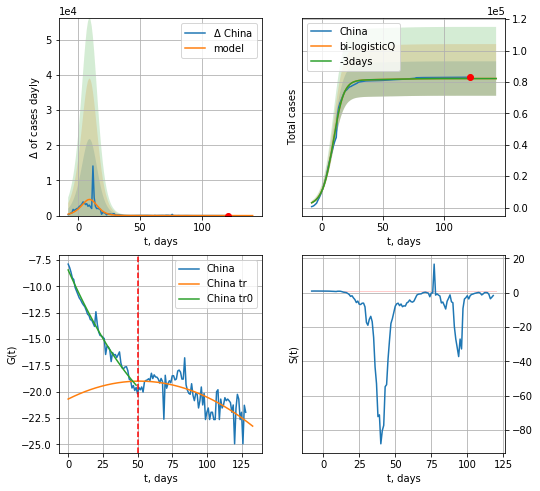

China data at: 2020-05-30
+3 day model MAPE: 0.000471
model: bi-logisticQ
coeffs: [ 1.77518646e+03  5.77243815e-04  2.47696256e+01 -2.41267681e-02]
rational stdev: 0.133381
forecast at the end of period: +21 days
	 deltaDaycases: 0
	 total cases: 82192 ± 10962
	 total death: 4588 ± 1835
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.980847
 intercept_: -8.442415731989867
 coeffs_: [ 0.         -0.29762768  0.00151769]
trend coefficient of determination: 0.516336
 intercept_: -20.703476971519333
 coeffs_: [ 0.          0.06614116 -0.00064263]


In [155]:
x = forecastRRR('China',dfCN[:50],d1,7*10-dT,1.0)
xx=forecast2RRR('China',dfCN[:],d1,12*7-dT,x,1.0,vL=50)

In [156]:
#x = forecastQR('China',dfCN[50:],d1,6*7-dT,1.0)

KR
           date  cases  active  death
101 2020-05-26  11265   701.0  269.0
102 2020-05-27  11344   735.0  269.0
103 2020-05-28  11402   770.0  269.0
104 2020-05-29  11441   774.0  269.0
105 2020-05-30  11468   793.0  270.0


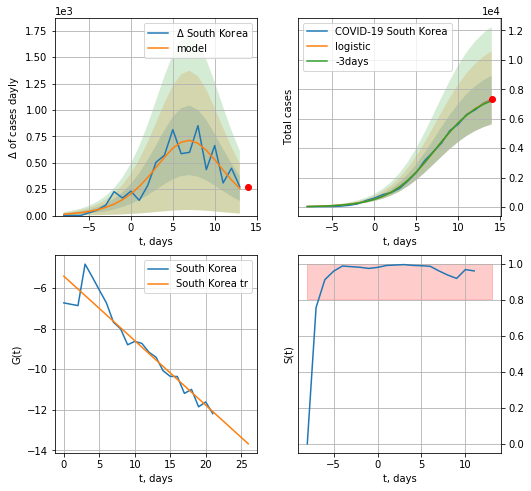

South Korea data at: 2020-05-30
model: logistic
coeffs:  [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.2275932520547523
forecast at the end of period: +0 days
	 deltaDaycases:  256
	 total cases:  7270 ± 1654
	 total death:  171 ± 116
trend coefficient of determination: 0.904554
 intercept: -5.419235
 slope: -0.317547


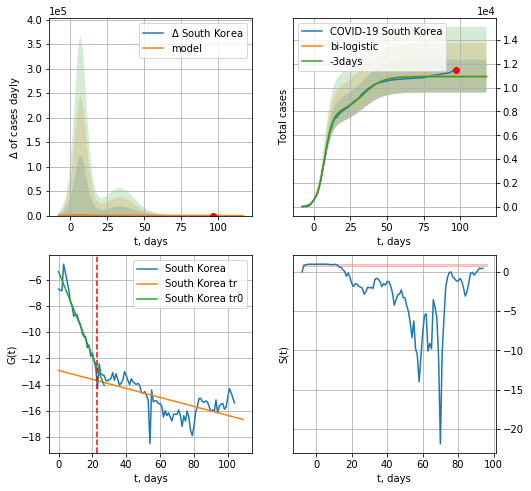

South Korea data at: 2020-05-30
+3 day model MAPE: 0.004006159409961639
model: bi-logistic
coeffs:  [3.01991962e+03 1.46492879e-01 3.40177937e+01] [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.12550649504612862
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  10961 ± 1375
	 total death:  258 ± 97
bi-logistic approximation splitting point: 23
trend0 coefficient of determination: 0.916463
 intercept: -5.394262
 slope: -0.321115
trend coefficient of determination: 0.413120
 intercept: -12.920537
 slope: -0.034242


In [157]:
dfKR = read_df(pd.DataFrame(),"KR")
x = forecast('South Korea',dfKR[:23],d1,7*9-dT,1.0,pMAPE=False)
xx=forecast2('South Korea',dfKR[:],d1,12*7-dT,x,1.0,vL=23)

In [158]:
#vL = 30
#x = forecastRRR('South Korea',dfKR[:vL],d1,8*7-dT,1.0)
#x1 = forecastRRR('South Korea',dfKR[39:],d1,12*7-dT,1.0)
#xx = np.concatenate((x, x1), axis=0)
#xx=forecast2RRR('South Korea',dfKR[:],d1,8*7-dT,x,1.0,vL=vL)

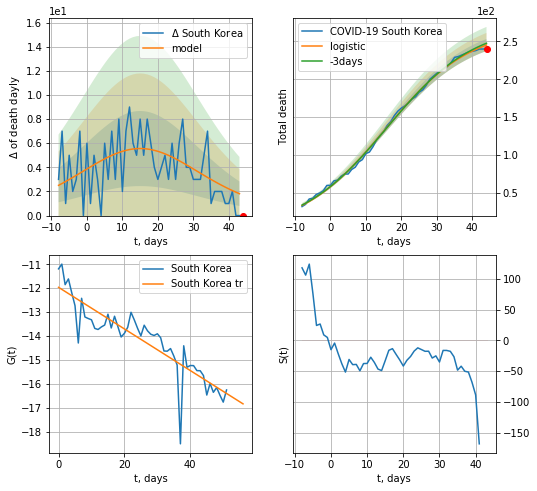

South Korea data at: 2020-05-30
model: logistic
coeffs:  [2.68513907e+02 8.28168908e-02 1.55065021e+01]
rational stdev:  0.03241893689547546
forecast at the end of period: +0 days
	 total death:  245 ± 7
trend coefficient of determination: 0.782213
 intercept: -11.965009
 slope: -0.087016


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:245: RuntimeWarning: divide by zero encountered in true_divide


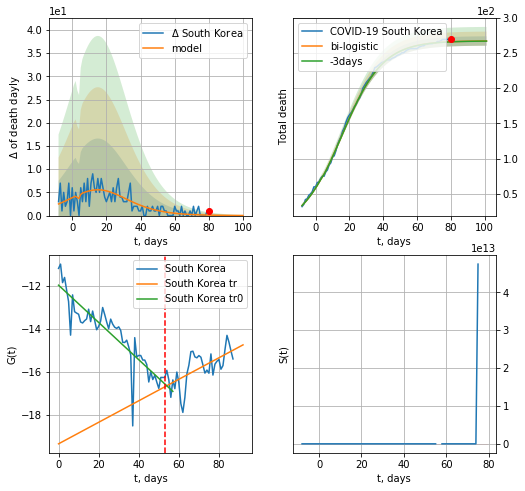

South Korea data at: 2020-05-30
+3 day model MAPE: 0.0005768187022286579
model: bi-logistic
coeffs:  [-1.52444838  2.82407064  4.18399079] [2.68513907e+02 8.28168908e-02 1.55065021e+01]
rational stdev:  0.02496515433961193
forecast at the end of period: +21 days
	 deltaDaydeath:  0
	 total death:  266 ± 6
bi-logistic approximation splitting point: 53
trend0 coefficient of determination: 0.789613
 intercept: -11.973248
 slope: -0.086531
trend coefficient of determination: 0.413659
 intercept: -19.340373
 slope: 0.049949


In [160]:
x = forecast('South Korea',dfKR[17:70],d1,9*7-dT,1.0,cases='death',pMAPE=False)
xx=forecast2('South Korea',dfKR[17:],d1,12*7-dT,x,1.0,vL=70-17,cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


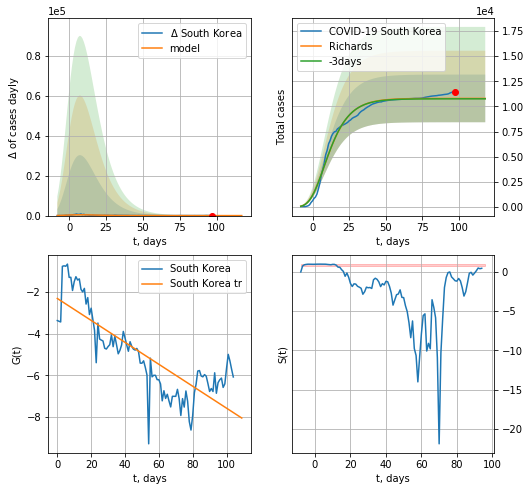

South Korea data at: 2020-05-30
+3 day model MAPE: 0.003923
model: Richards
coeffs: [ 1.08003213e+04  3.01163071e+01 -4.72864073e+01  3.42060921e-03]
rational stdev: 0.219682
forecast at the end of period: +21 days
	 deltaDaycases: 0
	 total cases: 10800 ± 2372
	 total death: 254 ± 167
trend coefficient of determination: 0.659337
 intercept: -2.319738
 slope: -0.052575


In [161]:
x = forecastRR('South Korea',dfKR[:],d1,12*7-dT,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


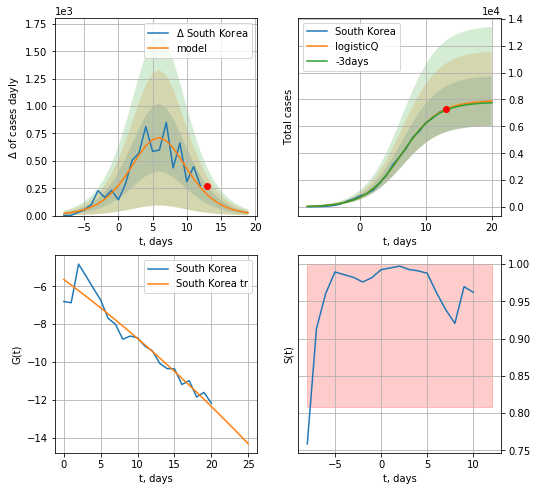

South Korea data at: 2020-05-30
+3 day model MAPE: 0.011158
model: logisticQ
coeffs: [ 7.93644801e+03  5.70813767e-05  6.37140978e+00 -6.30171017e+03]
rational stdev: 0.233522
forecast at the end of period: +7 days
	 deltaDaycases: 24
	 total cases: 7878 ± 1839
	 total death: 185 ± 129
trend coefficient of determination: 0.923340
 intercept_: -5.639271391154587
 coeffs_: [ 0.         -0.28882126 -0.00235709]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


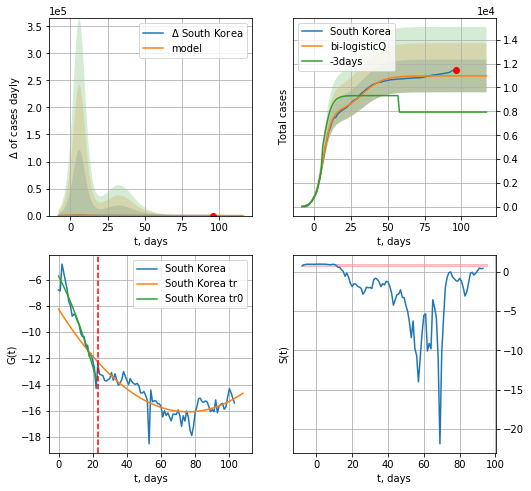

South Korea data at: 2020-05-30
+3 day model MAPE: 0.381083
model: bi-logisticQ
coeffs: [ 3.02470380e+03  4.54072996e-07  3.29943709e+01 -3.22114517e+05]
rational stdev: 0.124684
forecast at the end of period: +21 days
	 deltaDaycases: 0
	 total cases: 10961 ± 1366
	 total death: 258 ± 96
bi-logisticQ approximation splitting point: 23
trend coefficient of determination: 0.939645
 intercept_: -5.742054822567119
 coeffs_: [ 0.         -0.24685696 -0.00483449]
trend coefficient of determination: 0.691191
 intercept_: -8.24470984292185
 coeffs_: [ 0.         -0.20667734  0.00136427]


In [163]:
vL=23
x = forecastRRR('South Korea',dfKR[1:vL],d1,10*7-dT,1.0)
xx=forecast2RRR('South Korea',dfKR[1:],d1,12*7-dT,x,1.0,vL=vL)

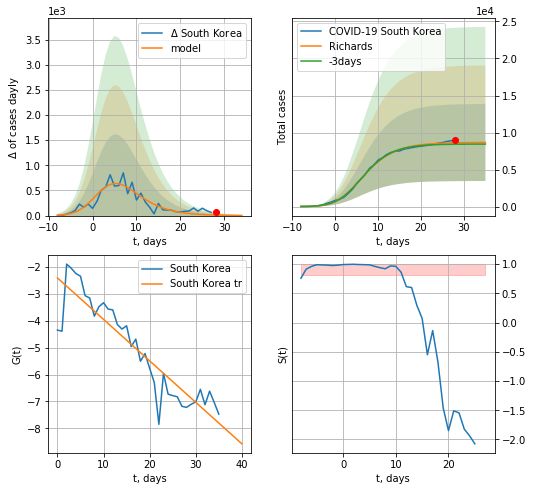

South Korea data at: 2020-05-30
+3 day model MAPE: 0.024309
model: Richards
coeffs: [8.67151677e+03 8.21539864e-01 1.26405006e-01 2.78237807e-01]
rational stdev: 0.600538
forecast at the end of period: +7 days
	 deltaDaycases: 2
	 total cases: 8660 ± 5201
	 total death: 203 ± 365
trend coefficient of determination: 0.823737
 intercept: -2.408294
 slope: -0.154215


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


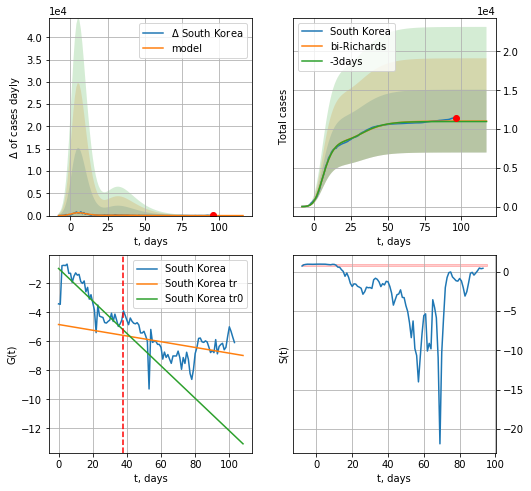

South Korea data at: 2020-05-30
+3 day model MAPE: 0.004960
model: bi-Richards
coeffs: [ 2.35209937e+03  3.82255324e+01 -2.35108398e+01  2.71652466e-03]
rational stdev: 0.367180
forecast at the end of period: +21 days
	 deltaDaycases: 0
	 total cases: 11023 ± 4047
	 total death: 259 ± 285
bi-Richards approximation splitting point: 38
trend coefficient of determination: 0.699557
 intercept: -0.969596
 slope: -0.111969
trend coefficient of determination: 0.125714
 intercept: -4.834078
 slope: -0.019773


In [168]:
vL=38
x = forecastRR('South Korea',dfKR[1:vL],d1,10*7-dT,1.0)
xx=forecast2RR('South Korea',dfKR[1:],d1,12*7-dT,x,1.0,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


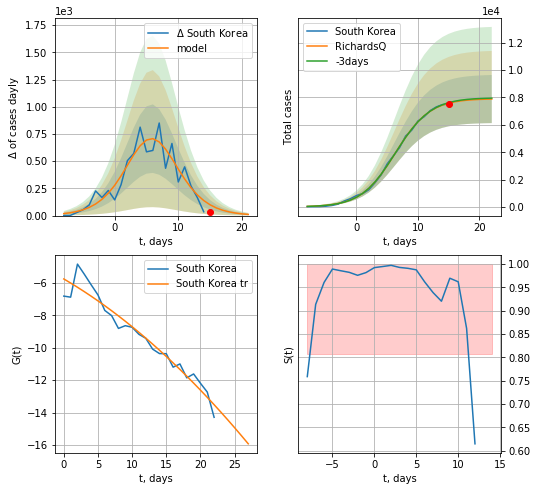

South Korea data at: 2020-05-30
+3 day model MAPE: 0.006079
model: RichardsQ
coeffs: [ 7.90607495e+03  3.14377481e-03 -1.32150046e+02  5.22462480e+00
  7.59593205e-01]
rational stdev: 0.222738
forecast at the end of period: +7 days
	 deltaDaycases: 10
	 total cases: 7884 ± 1756
	 total death: 185 ± 123
trend coefficient of determination: 0.939645
 intercept_: -5.742054822567119
 coeffs_: [ 0.         -0.24685696 -0.00483449]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:296: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:296: RuntimeWarning: overflow encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


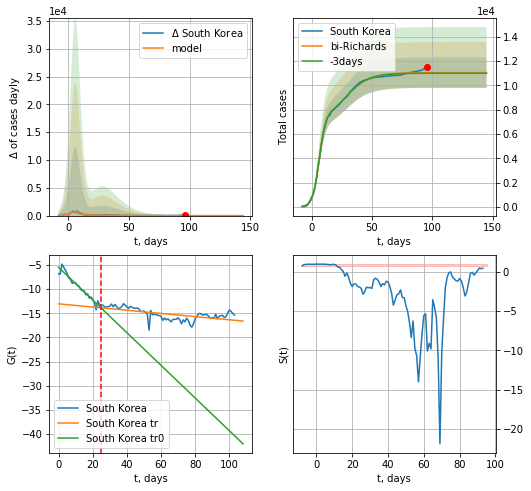

South Korea data at: 2020-05-30
+3 day model MAPE: 0.004496
model: bi-Richards
coeffs: [ 3.13083632e+03  1.94409821e-01 -6.61019691e+01 -1.29262488e+03
  3.29433243e-04]
rational stdev: 0.113361
forecast at the end of period: +49 days
	 deltaDaycases: 0
	 total cases: 11036 ± 1251
	 total death: 259 ± 88
bi-logisticQ approximation splitting point: 25
trend coefficient of determination: 0.936460
 intercept: -5.478818
 slope: -0.338423
trend coefficient of determination: 0.376229
 intercept: -13.052866
 slope: -0.032967


In [170]:
vL=25
x = forecastQR('South Korea',dfKR[1:vL],d1,10*7-dT,1.0)
xx=forecast2QR('South Korea',dfKR[1:],d1,16*7-dT,x,1.0,vL=vL)

In [171]:
a = np.array([ 7.90607495e+03,  3.14377481e-03, -1.32150046e+02,  5.22462480e+00, 7.59593205e-01])
b = np.array([ 2.91876181e+03,  1.43325056e-01, -3.99886263e+01, -3.39427361e+02, 1.77367535e-03])
QRkoreaCoeffs=b/a
QRkoreaCoeffs,RkoreaCoeffs,koreaCoeffs

(array([ 3.69179628e-01,  4.55901153e+01,  3.02600169e-01, -6.49668395e+01,
         2.33503320e-03]),
 [0.36242246, 2.56241634, 1.84890887, 0.13324732],
 [0.35416971, 0.02606324, 4.35859408, 19.30413219])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


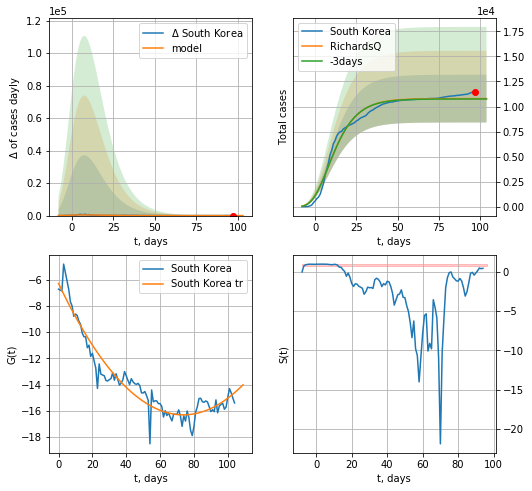

South Korea data at: 2020-05-30
+3 day model MAPE: 0.003862
model: RichardsQ
coeffs: [ 1.07942516e+04  1.34385549e-01 -7.38562142e+01 -2.49616721e+03
  2.95610568e-04]
rational stdev: 0.220630
forecast at the end of period: +7 days
	 deltaDaycases: 0
	 total cases: 10793 ± 2381
	 total death: 254 ± 168
trend coefficient of determination: 0.923956
 intercept_: -6.299535588169786
 coeffs_: [ 0.         -0.27135937  0.00184022]


In [173]:
x = forecastQR('South Korea',dfKR[:],d1,10*7-dT,1.0)

SG
           date  cases  active  death
124 2020-05-26  32343   15876   23.0
125 2020-05-27  32876   15577   23.0
126 2020-05-28  33249   14932   23.0
127 2020-05-29  33860   14206   23.0
128 2020-05-30  34366   13616   23.0


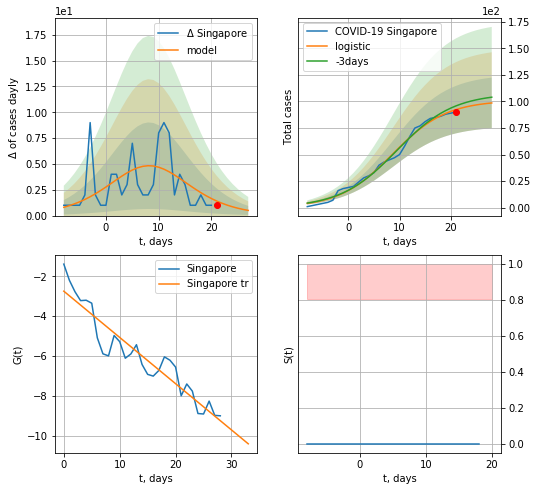

Singapore data at: 2020-05-30
+3 day model MAPE: 0.03963437966370839
model: logistic
coeffs:  [101.02990869   0.19128696   8.67555654]
rational stdev:  0.24212715882466435
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  98 ± 23
	 total death:  0 ± 0
trend coefficient of determination: 0.887345
 intercept: -2.744831
 slope: -0.232145


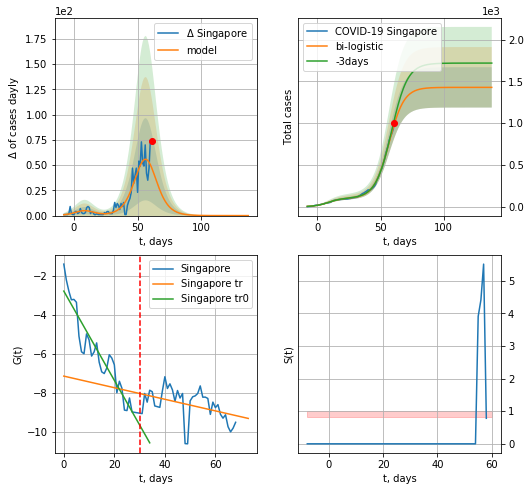

Singapore data at: 2020-05-30
+3 day model MAPE: 0.06119828055586902
model: bi-logistic
coeffs:  [1.32695355e+03 1.68329223e-01 5.66911530e+01] [101.02990869   0.19128696   8.67555654]
rational stdev:  0.16894112354758975
forecast at the end of period: +77 days
	 deltaDaycases:  0
	 total cases:  1427 ± 241
	 total death:  0 ± 0
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.893525
 intercept: -2.772249
 slope: -0.229208
trend coefficient of determination: 0.177815
 intercept: -7.138791
 slope: -0.029776


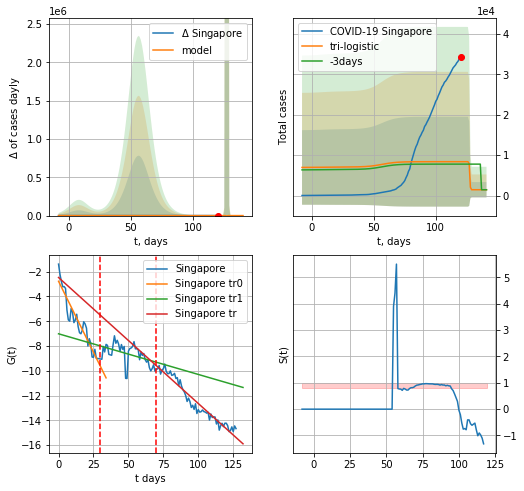

Singapore data at: 2020-05-30
+3 day model MAPE: 0.07795389134196357
model: tri-logistic
coeffs:  [ 6.95018103e+03 -4.92866143e+00  1.27524811e+02] [1.01029909e+02 1.91286963e-01 8.67555654e+00 1.32695355e+03
 1.68329223e-01 5.66911530e+01]
forecast rational stdev:  1.3282936415522297
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  1427 ± 1896
	 total death:  0 ± 0
tri-logistic approximation splitting points: 30,70
trend0 coefficient of determination: 0.893525
 intercept: -2.772249
 slope: -0.229208
trend1 coefficient of determination: 0.215531
 intercept: -7.009854
 slope: -0.032798
trend coefficient of determination: 0.942129
 intercept: -2.466782
 slope: -0.101682


In [175]:
vL = 30
vL1 = 70
dfSG = read_df(pd.DataFrame(),"SG")
x = forecast('Singapore',dfSG[:vL],d1,7*10-dT,1.0)
xx = forecast2('Singapore',dfSG[:vL1],d1,20*7-dT,x,1.0,vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Singapore",dfSG,d1,12*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


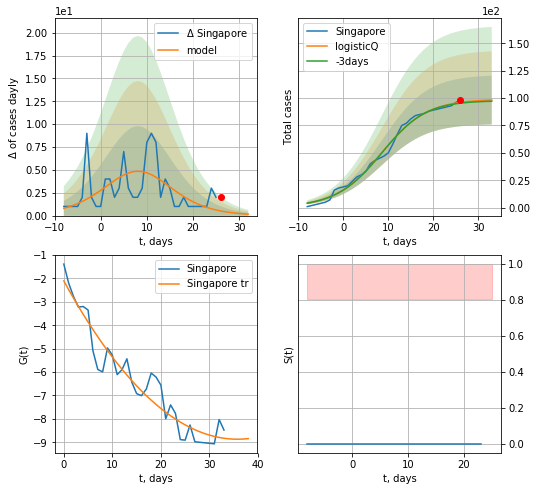

Singapore data at: 2020-05-30
+3 day model MAPE: 0.008158
model: logisticQ
coeffs: [ 9.88556757e+01  2.70682558e-04  8.43151542e+00 -7.17677228e+02]
rational stdev: 0.226599
forecast at the end of period: +7 days
	 deltaDaycases: 0
	 total cases: 98 ± 22
	 total death: 0 ± 0
trend coefficient of determination: 0.918167
 intercept_: -2.103369555726971
 coeffs_: [ 0.         -0.37832792  0.00528917]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


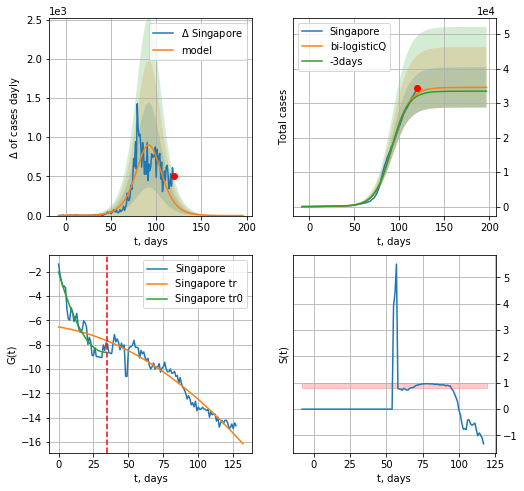

Singapore data at: 2020-05-30
+3 day model MAPE: 0.023555
model: bi-logisticQ
coeffs: [ 3.44540960e+04  1.04785801e-06  9.21814173e+01 -9.96643863e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.169213
forecast at the end of period: +77 days
	 deltaDaycases: 0
	 total cases: 34552 ± 5846
	 total death: 23 ± 11
bi-logisticQ approximation splitting point: 35
trend coefficient of determination: 0.914568
 intercept_: -2.036640634366525
 coeffs_: [ 0.         -0.39517788  0.00592335]
trend coefficient of determination: 0.939279
 intercept_: -6.55141549898083
 coeffs_: [ 0.         -0.01843661 -0.00041152]


In [177]:
vL = 35
x = forecastRRR('Singapore',dfSG[:vL],d1,7*10-dT,1.0)
xx = forecast2RRR('Singapore',dfSG[:],d1,20*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

In [178]:
#vL = 31
#x = forecast('Singapore',dfSG[:vL],d1,6*7-dT,1.0)
#xx = forecast2('Singapore',dfSG[:],d1,12*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

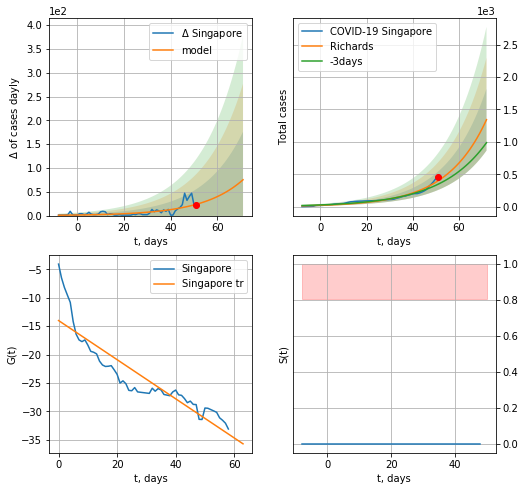

Singapore data at: 2020-05-30
+3 day model MAPE: 0.162175
model: Richards
coeffs: [9.30440928e+03 5.77261259e-02 1.05546035e+02 4.91744477e+00]
rational stdev: 0.355378
forecast at the end of period: +21 days
	 deltaDaycases: 75
	 total cases: 1341 ± 476
	 total death: 0 ± 0
trend coefficient of determination: 0.813965
 intercept: -14.017324
 slope: -0.343928


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:154: RuntimeWarning: overflow encountered in power


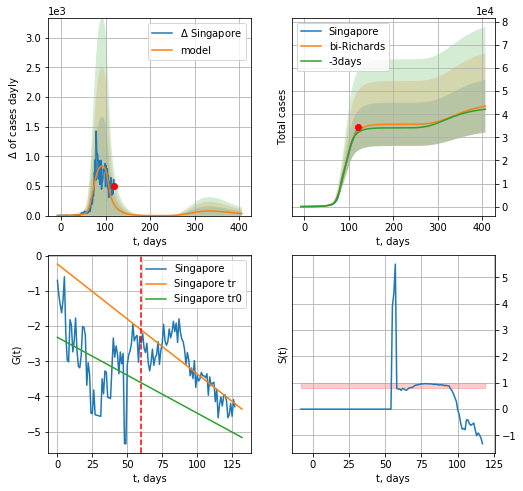

Singapore data at: 2020-05-30
+3 day model MAPE: 0.024336
model: bi-Richards
coeffs: [2.63711658e+04 9.06248260e+00 1.04028983e+01 7.15075358e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.262817
forecast at the end of period: +287 days
	 deltaDaycases: 34
	 total cases: 43522 ± 11438
	 total death: 29 ± 22
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.124822
 intercept: -2.317262
 slope: -0.021568
trend coefficient of determination: 0.648701
 intercept: -0.235784
 slope: -0.031226


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


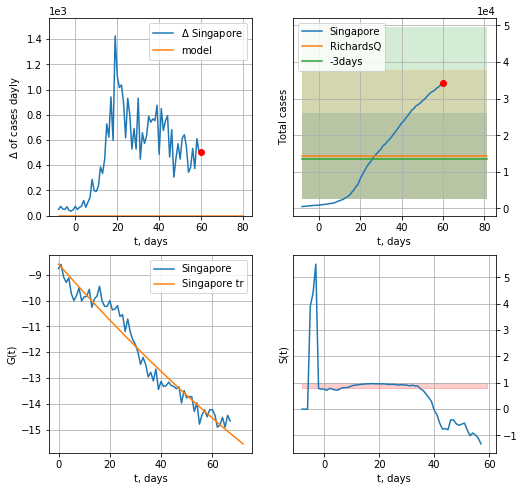

Singapore data at: 2020-05-30
+3 day model MAPE: 0.066319
model: RichardsQ
coeffs: [ 1.42825217e+04  7.27551569e+00 -2.23546257e+03  1.99753614e+03
 -3.67718321e+00]
rational stdev: 0.824378
forecast at the end of period: +21 days
	 deltaDaycases: 0
	 total cases: 14282 ± 11774
	 total death: 9 ± 22
trend coefficient of determination: 0.956609
 intercept_: -8.59152586051539
 coeffs_: [ 0.         -0.11263788  0.00022296]


In [179]:
vL = 60
x = forecastRR('Singapore',dfSG[:vL],d1,12*7-dT,1.0)
x = forecast2RR('Singapore',dfSG[:],d1,50*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
#xx = forecast2R('Singapore',dfSG[:],d1,28*7-dT,x,1.0)
x = forecastQR('Singapore',dfSG[60:],d1,12*7-dT,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


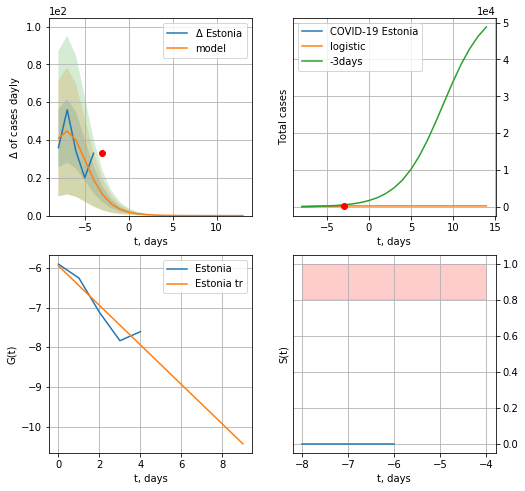

Estonia data at: 2020-05-30
+3 day model MAPE: 0.6707560476295664
model: logistic
coeffs:  [277.64023436   0.65084323  -6.57074778]
rational stdev:  0.028784635346108894
forecast at the end of period: +17 days
	 deltaDaycases:  0
	 total cases:  277 ± 7
	 total death:  9 ± 0
trend coefficient of determination: 0.881874
 intercept: -5.949047
 slope: -0.498463


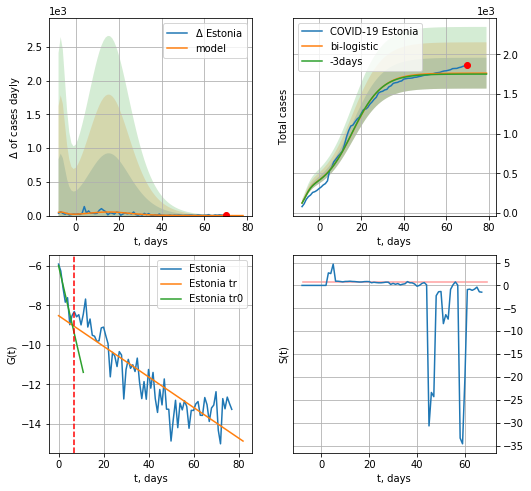

Estonia data at: 2020-05-30
+3 day model MAPE: 0.006663125424127631
model: bi-logistic
coeffs:  [1.48637255e+03 1.43057221e-01 1.58569853e+01] [277.64023436   0.65084323  -6.57074778]
rational stdev:  0.11036414876924808
forecast at the end of period: +9 days
	 deltaDaycases:  0
	 total cases:  1763 ± 194
	 total death:  63 ± 20
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.894917
 intercept: -5.986038
 slope: -0.491580
trend coefficient of determination: 0.769890
 intercept: -8.520564
 slope: -0.077535


In [180]:
shift = 1.0
x = forecast('Estonia',dfES[1:7],d1,17,1.)
xx = forecast2('Estonia',dfES[1:],d1,12*6-dT,x,1.,addpred=False,xcoef=[0.25,1.,3.5],vL=7)

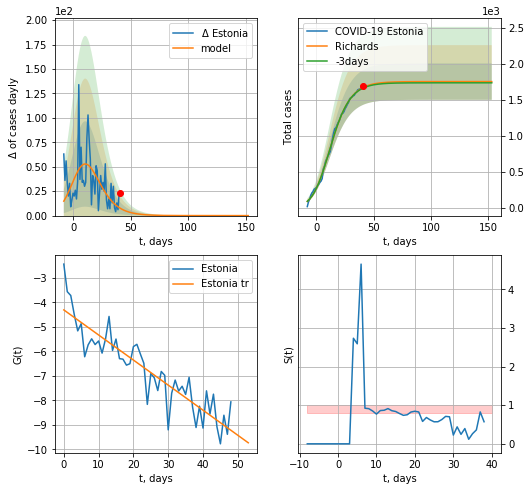

Estonia data at: 2020-05-30
+3 day model MAPE: 0.005500
model: Richards
coeffs: [1.74994618e+03 2.01777902e-01 4.40550518e+00 5.06367091e-01]
rational stdev: 0.144467
forecast at the end of period: +112 days
	 deltaDaycases: 0
	 total cases: 1749 ± 252
	 total death: 62 ± 26
trend coefficient of determination: 0.813896
 intercept: -4.307388
 slope: -0.102288


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


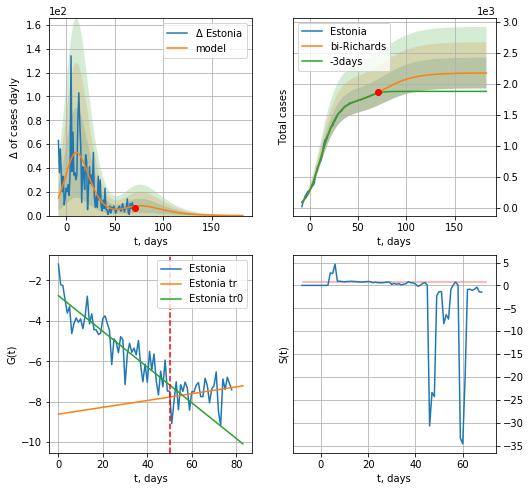

Estonia data at: 2020-05-30
+3 day model MAPE: 0.008790
model: bi-Richards
coeffs: [4.27945227e+02 2.57246942e-01 5.12490249e+01 2.21012655e-01]
rational stdev: 0.114241
forecast at the end of period: +112 days
	 deltaDaycases: 0
	 total cases: 2176 ± 248
	 total death: 78 ± 26
bi-Richards approximation splitting point: 50
trend coefficient of determination: 0.784850
 intercept: -2.753238
 slope: -0.088281
trend coefficient of determination: 0.047635
 intercept: -8.611852
 slope: 0.016843


In [181]:
vL=50
x = forecastRR('Estonia',dfES[:vL],d1,7*25-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
#x = forecastQR('Estonia',dfES[10:],d1,7*10-dT,1.)
xx = forecast2RR('Estonia',dfES[:],d1,7*25-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


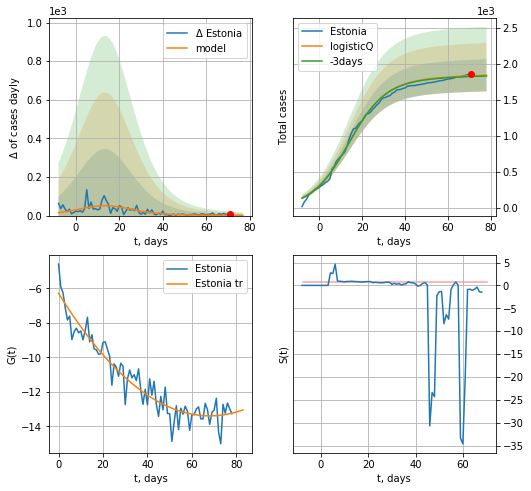

Estonia data at: 2020-05-30
+3 day model MAPE: 0.005341
model: logisticQ
coeffs: [ 1.78265523e+03  7.72447256e-07  1.38008935e+01 -1.49041834e+05]
S.Korea scenario coeffs: [0.04375, 0.5, 4.0, 1]
rational stdev: 0.121741
forecast at the end of period: +7 days
	 deltaDaycases: 0
	 total cases: 1843 ± 224
	 total death: 66 ± 24
trend coefficient of determination: 0.907249
 intercept_: -6.286295508140359
 coeffs_: [ 0.         -0.20914599  0.00153812]


In [182]:
x = forecastRRR('Estonia',dfES[:],d1,7*10-dT,1.,addpred=True,xcoef=[0.35/8,.5,4.,1])

LV
          date   cases  active  death
80 2020-05-26  1057.0     293   23.0
81 2020-05-27  1061.0     296   24.0
82 2020-05-28  1064.0     295   24.0
83 2020-05-29  1065.0     296   24.0
84 2020-05-30  1065.0     296   24.0


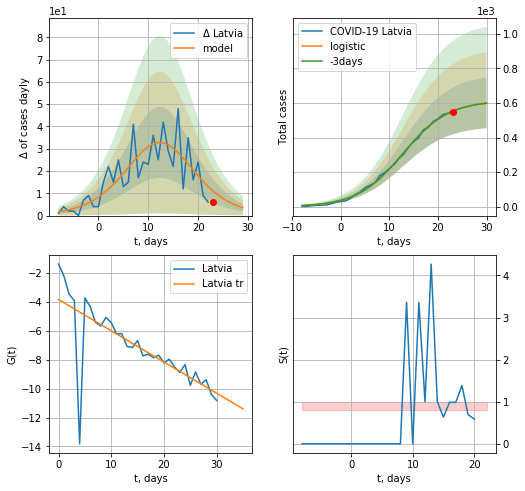

Latvia data at: 2020-05-30
+3 day model MAPE: 0.0032633377916749073
model: logistic
coeffs:  [6.16080291e+02 2.13516215e-01 1.27871959e+01]
rational stdev:  0.24373797630646024
forecast at the end of period: +7 days
	 deltaDaycases:  3
	 total cases:  600 ± 146
	 total death:  13 ± 9
trend coefficient of determination: 0.538666
 intercept: -3.837099
 slope: -0.216023
Exception occurs


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


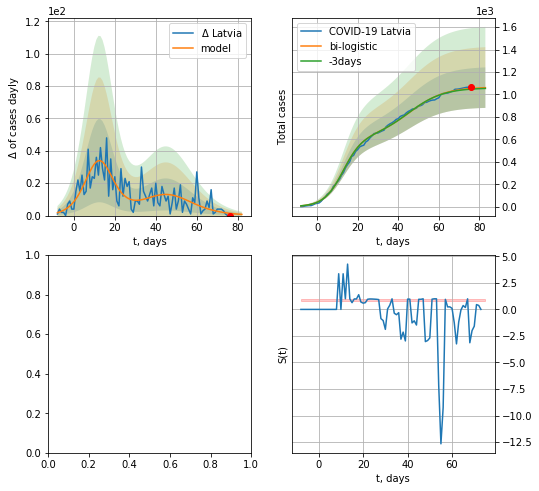

In [183]:
vL=32
dfLV = read_df(pd.DataFrame(),"LV")
try:
    x = forecast('Latvia',dfLV[:vL],d1,10*7-dT,1.)
    xx=forecast2('Latvia',dfLV[:],d1,10*7-dT,x,1.,addpred=False,xcoef=[0.25,1.,3.],vL=vL)
except:
    print("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:647: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

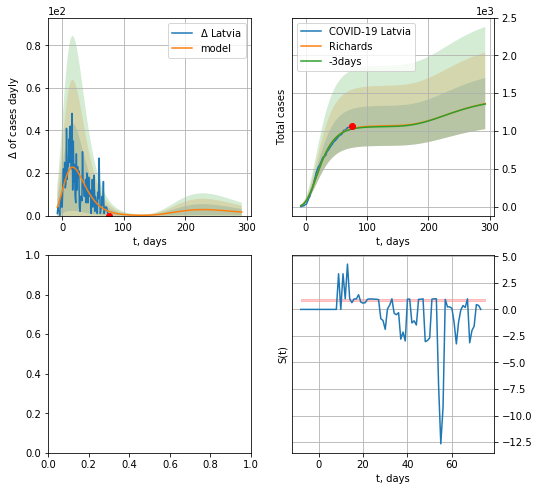

In [184]:
x = forecastRR('Latvia',dfLV[:],d1,7*40-dT,1.,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Latvia',dfLV[:],d1,7*10-dT,1.)
#xx=forecast2R('Latvia',dfLV[:],d1,10*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


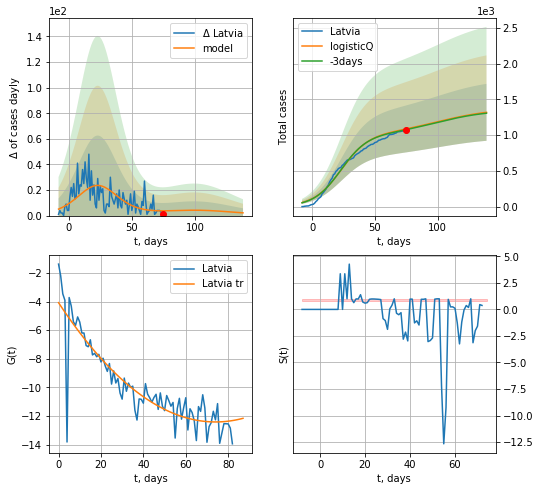

Latvia data at: 2020-05-29
+3 day model MAPE: 0.009221
model: logisticQ
coeffs: [ 1.01362179e+03  2.99442191e-07  2.32636374e+01 -3.05448177e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.301798
forecast at the end of period: +64 days
	 deltaDaycases: 2
	 total cases: 1318 ± 397
	 total death: 29 ± 26
trend coefficient of determination: 0.790930
 intercept_: -4.079782686872317
 coeffs_: [ 0.         -0.22505607  0.00151936]


In [398]:
#trend3(dfCA[12:],dfPT,dfTR[4:],'CA','PT','TR',40,40,40)
x = forecastRRR('Latvia',dfLV[:],d1,7*18-dT,1.,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


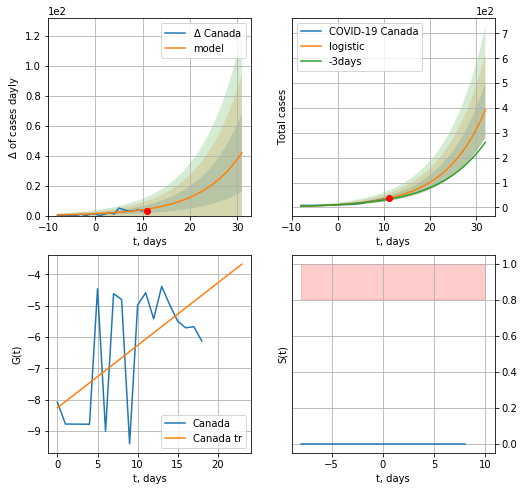

Canada data at: 2020-05-30
+3 day model MAPE: 0.14132705134128837
model: logistic
coeffs:  [1.25340432e+05 1.13222117e-01 8.29016731e+01]
rational stdev:  0.2833741000964234
forecast at the end of period: +21 days
	 deltaDaycases:  41
	 total cases:  392 ± 111
	 total death:  30 ± 25
trend coefficient of determination: 0.348503
 intercept: -8.254919
 slope: 0.199271


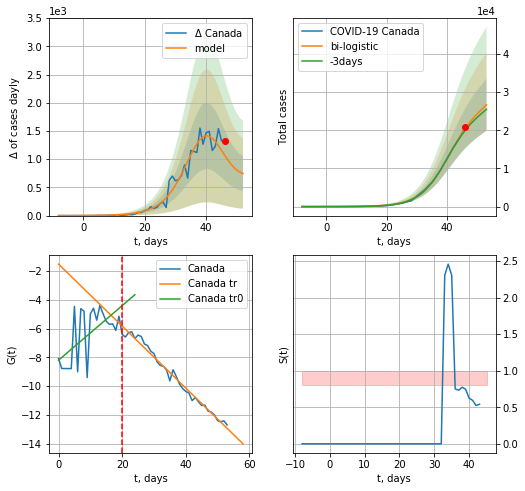

Canada data at: 2020-05-30
+3 day model MAPE: 0.02936701556145869
model: bi-logistic
coeffs:  [2.40154010e+04 2.16961372e-01 4.02658693e+01] [1.25340432e+05 1.13222117e-01 8.29016731e+01]
rational stdev:  0.2549294046309869
forecast at the end of period: +7 days
	 deltaDaycases:  746
	 total cases:  26694 ± 6805
	 total death:  2093 ± 1600
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend coefficient of determination: 0.982767
 intercept: -1.518979
 slope: -0.215271


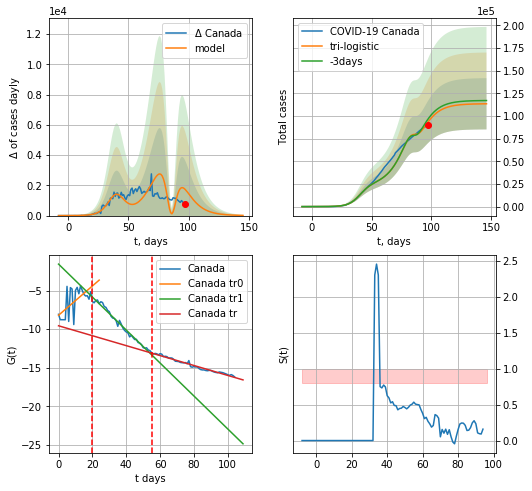

Canada data at: 2020-05-30
+3 day model MAPE: 0.03388261418330569
model: tri-logistic
coeffs:  [-3.57163518e+04  3.71867106e-01  8.60268124e+01] [1.25340432e+05 1.13222117e-01 8.29016731e+01 2.40154010e+04
 2.16961372e-01 4.02658693e+01]
forecast rational stdev:  0.2492449545099451
forecast at the end of period: +49 days
	 deltaDaycases:  11
	 total cases:  113540 ± 28299
	 total death:  8904 ± 6657
tri-logistic approximation splitting points: 20,55
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend1 coefficient of determination: 0.983223
 intercept: -1.572806
 slope: -0.213535
trend coefficient of determination: 0.973063
 intercept: -9.560079
 slope: -0.064307


In [186]:
vL=20
vL1=55
x = forecast('Canada',dfCA[:vL],d1,3*7,1.)
xx=forecast2('Canada',dfCA[:vL1],d1,10*7-dT,x,1.,vL=vL)#,addpred=True,xcoef=[0.25,1.,2.]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Canada",dfCA[:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

CA
           date    cases  active   death
101 2020-05-26  86647.0   34669  6639.0
102 2020-05-27  87519.0   34590  6765.0
103 2020-05-28  88512.0   34795  6877.0
104 2020-05-29  89418.0   34921  6979.0
105 2020-05-30  90190.0   35014  7073.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


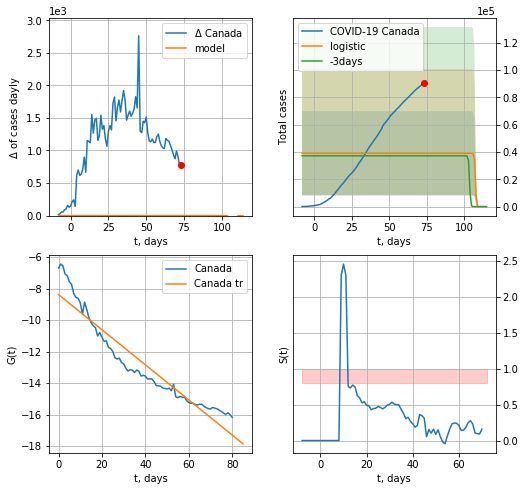

Canada data at: 2020-05-30
+3 day model MAPE: 0.051327486456674024
model: logistic
coeffs:  [ 3.91021829e+04 -3.31471903e+00  1.07609866e+02]
rational stdev:  0.7884601964102521
forecast at the end of period: +42 days
	 deltaDaycases:  0
	 total cases:  0 ± 0
	 total death:  0 ± 0
trend coefficient of determination: 0.905894
 intercept: -8.378494
 slope: -0.111436


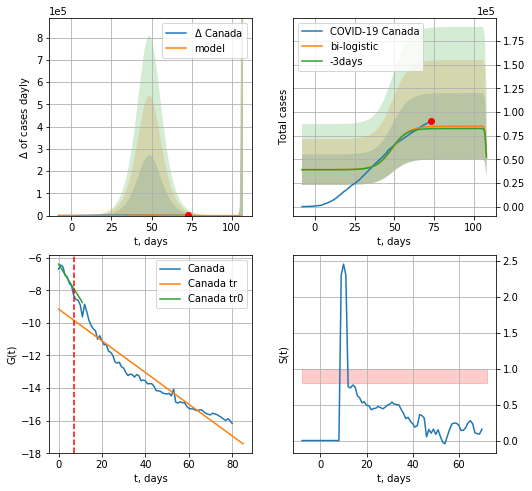

Canada data at: 2020-05-30
+3 day model MAPE: 0.027891637471663514
model: bi-logistic
coeffs:  [4.59242842e+04 1.97640429e-01 4.90544970e+01] [ 3.91021829e+04 -3.31471903e+00  1.07609866e+02]
rational stdev:  0.41106910939647817
forecast at the end of period: +35 days
	 deltaDaycases:  -26109
	 total cases:  54343 ± 22338
	 total death:  4261 ± 5254
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.859073
 intercept: -6.392122
 slope: -0.214001
trend coefficient of determination: 0.918767
 intercept: -9.154149
 slope: -0.097255


In [187]:
dfCA = read_df(pd.DataFrame(),"CA")
x = forecast('Canada',dfCA[24:],d1,6*7,1.,cases='cases')
xx=forecast2('Canada',dfCA[24:],d1,14*7-dT,x,1.,vL=31-24,cases='cases')

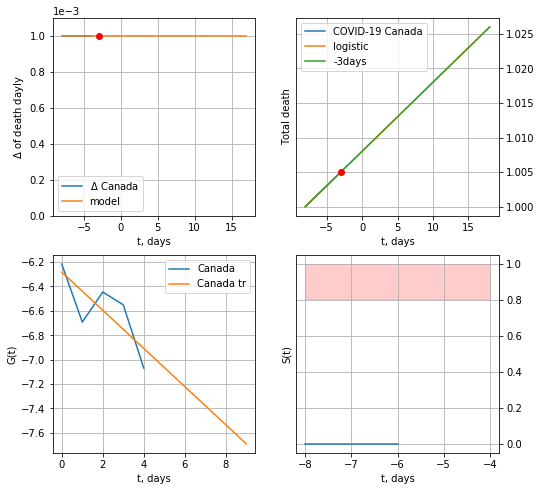

Canada data at: 2020-05-30
+3 day model MAPE: 5.06934136593531e-07
model: logistic
coeffs:  [2.01698683e+00 1.98322956e-03 4.93279263e-01]
rational stdev:  1.4705534785239981e-08
forecast at the end of period: +21 days
	 total death:  1 ± 0
trend coefficient of determination: 0.608158
 intercept: -6.282802
 slope: -0.156326


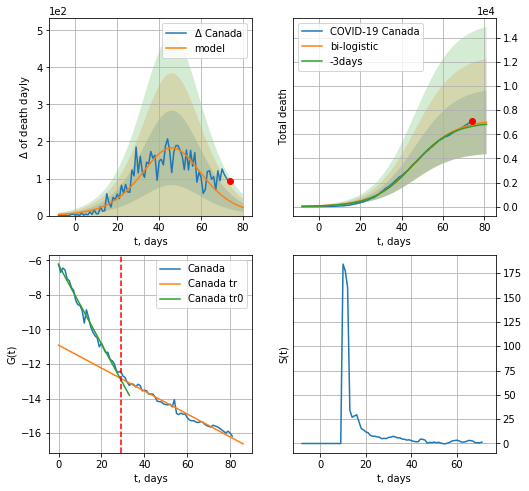

Canada data at: 2020-05-30
+3 day model MAPE: 0.02049693570840046
model: bi-logistic
coeffs:  [7.20249511e+03 1.01557244e-01 4.64631151e+01] [2.01698683e+00 1.98322956e-03 4.93279263e-01]
rational stdev:  0.377019227551729
forecast at the end of period: +7 days
	 deltaDaydeath:  21
	 total death:  6993 ± 2636
bi-logistic approximation splitting point: 29
trend0 coefficient of determination: 0.986075
 intercept: -6.260314
 slope: -0.228750
trend coefficient of determination: 0.973232
 intercept: -10.905106
 slope: -0.066393


In [188]:
vL=29
vL1=50
x = forecast('Canada',dfCA[23:vL],d1,3*7,1.,cases='death')
xx=forecast2('Canada',dfCA[23:],d1,10*7-dT,x,1.,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,2.]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Canada",dfCA[24:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


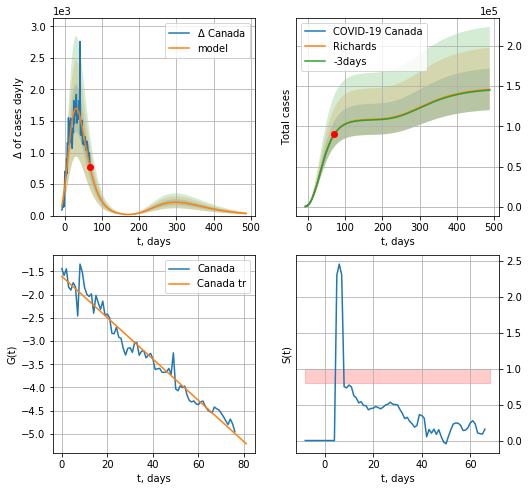

Canada data at: 2020-05-30
+3 day model MAPE: 0.003283
model: Richards
coeffs: [ 1.08922036e+05  2.54945233e+00 -6.44896396e+01  1.67925267e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.177074
forecast at the end of period: +420 days
	 deltaDaycases: 33
	 total cases: 146042 ± 25860
	 total death: 11453 ± 6084
trend coefficient of determination: 0.963373
 intercept: -1.605260
 slope: -0.044551


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


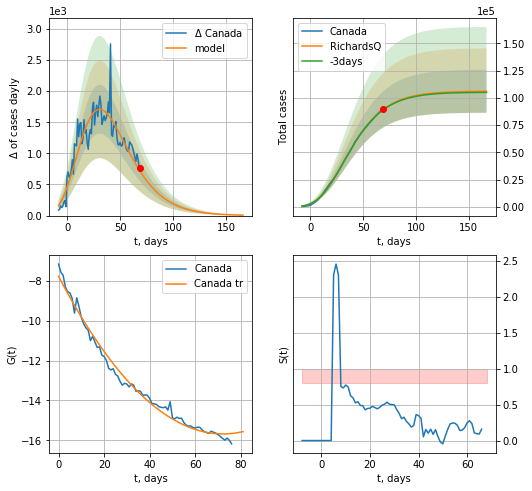

Canada data at: 2020-05-30
+3 day model MAPE: 0.004223
model: RichardsQ
coeffs: [ 1.06132474e+05  1.09271812e-02 -1.17710597e+02 -8.52181613e+02
  3.88937857e-03]
rational stdev: 0.185630
forecast at the end of period: +98 days
	 deltaDaycases: 6
	 total cases: 106012 ± 19679
	 total death: 8313 ± 4629
trend coefficient of determination: 0.987138
 intercept_: -7.785934180778384
 coeffs_: [ 0.         -0.21834923  0.00151084]


In [189]:
x = forecastRR('Canada',dfCA[28:],d1,60*7,1.,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Canada',dfCA[28:],d1,14*7,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


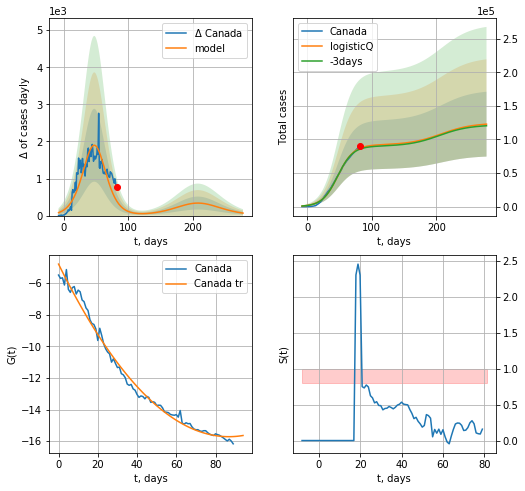

Canada data at: 2020-05-30
+3 day model MAPE: 0.015754
model: logisticQ
coeffs: [ 9.18833982e+04  6.59172188e-07  4.76512838e+01 -1.25192507e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.393116
forecast at the end of period: +196 days
	 deltaDaycases: 66
	 total cases: 122759 ± 48258
	 total death: 9627 ± 11353
trend coefficient of determination: 0.990171
 intercept_: -4.799676503077549
 coeffs_: [ 0.         -0.25162417  0.00144956]


In [190]:
x = forecastRRR('Canada',dfCA[15:],d1,7*28,1.,addpred=True,xcoef=koreaCoeffs)

PT
          date  cases  active   death
85 2020-05-26  31007   11569  1342.0
86 2020-05-27  31292   11587  1356.0
87 2020-05-28  31596   11590  1369.0
88 2020-05-29  31946   11652  1383.0
89 2020-05-30  32203   11621  1396.0


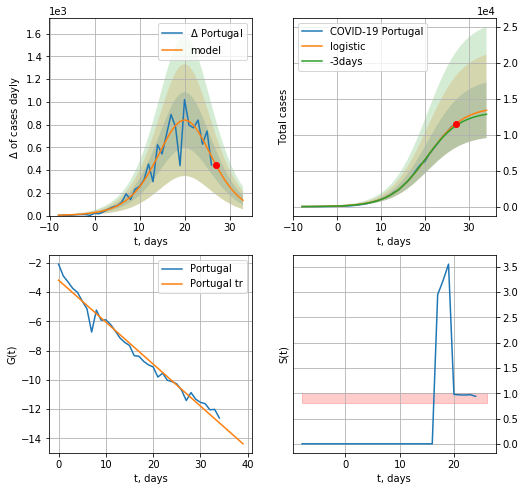

Portugal data at: 2020-05-30
+3 day model MAPE: 0.028768813359110825
model: logistic
coeffs:  [1.39435560e+04 2.41732854e-01 2.05234131e+01]
rational stdev:  0.2880659201380634
forecast at the end of period: +7 days
	 deltaDaycases:  134
	 total cases:  13426 ± 3867
	 total death:  582 ± 502
trend coefficient of determination: 0.976552
 intercept: -3.178197
 slope: -0.287215


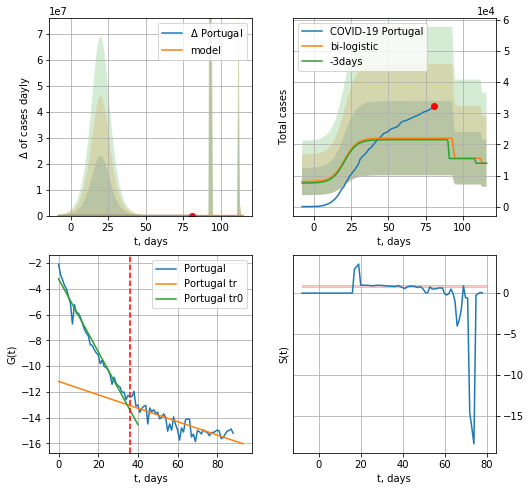

Portugal data at: 2020-05-30
+3 day model MAPE: 0.023093477864945075
model: bi-logistic
coeffs:  [6448.44600475   -9.56386872   93.9145875 ] [1.39435560e+04 2.41732854e-01 2.05234131e+01]
scenario coeffs:  [0.25, 1.0, 1.2]
rational stdev:  0.542033236012068
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  13943 ± 7557
	 total death:  604 ± 982
bi-logistic approximation splitting point: 36
trend0 coefficient of determination: 0.975262
 intercept: -3.226992
 slope: -0.282910
trend coefficient of determination: 0.700611
 intercept: -11.191320
 slope: -0.052136


In [192]:
vL = 36
dfPT = read_df(pd.DataFrame(),"PT")
x = forecast('Portugal',dfPT[:vL],d1,10*7-dT,1.)
xx=forecast2('Portugal',dfPT[:],d1,14*7-dT,x,addpred=True,xcoef=[0.25,1.,1.2],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


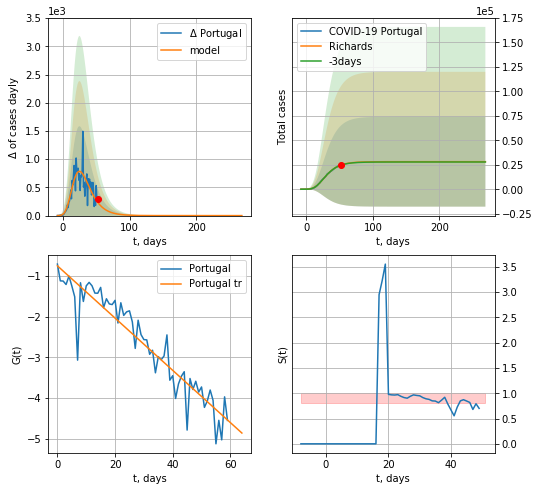

Portugal data at: 2020-05-30
+3 day model MAPE: 0.005985
model: Richards
coeffs: [ 2.81684838e+04  5.82693578e+00 -3.14773431e+01  1.30834824e-02]
rational stdev: 1.629434
forecast at the end of period: +217 days
	 deltaDaycases: 0
	 total cases: 28168 ± 45898
	 total death: 1221 ± 5968
trend coefficient of determination: 0.876328
 intercept: -0.753757
 slope: -0.064134


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


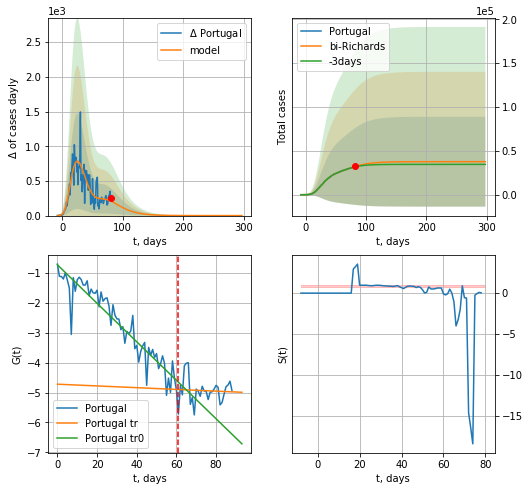

Portugal data at: 2020-05-30
+3 day model MAPE: 0.011914
model: bi-Richards
coeffs: [ 9.51196957e+03  5.10873018e+00 -1.05379599e+01  1.02453596e-02]
rational stdev: 1.359671
forecast at the end of period: +217 days
	 deltaDaycases: 0
	 total cases: 37680 ± 51232
	 total death: 1633 ± 6661
bi-Richards approximation splitting point: 61
trend coefficient of determination: 0.880483
 intercept: -0.731624
 slope: -0.064325
trend coefficient of determination: 0.003245
 intercept: -4.721076
 slope: -0.002903


In [193]:
vL=61
x = forecastRR('Portugal',dfPT[:vL],d1,40*7-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Portugal',dfPT[:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


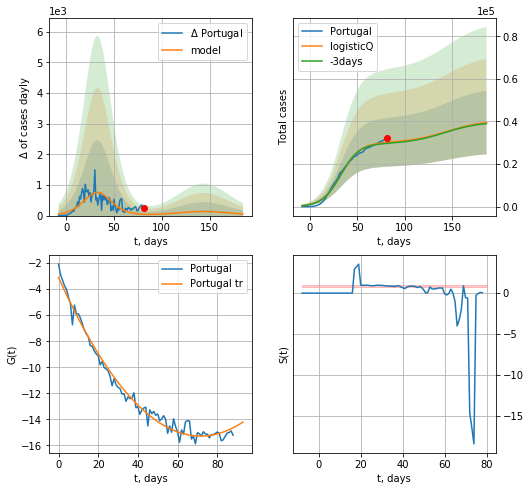

Portugal data at: 2020-05-30
+3 day model MAPE: 0.016024
model: logisticQ
coeffs: [ 2.99845465e+04  3.73663596e-07  3.30528333e+01 -2.69804304e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.379175
forecast at the end of period: +105 days
	 deltaDaycases: 52
	 total cases: 39473 ± 14967
	 total death: 1711 ± 1946
trend coefficient of determination: 0.984618
 intercept_: -3.102489640825164
 coeffs_: [ 0.         -0.33971484  0.00237002]


In [194]:
x = forecastRRR('Portugal',dfPT[:],d1,24*7-dT,1.,addpred=True,xcoef=koreaCoeffs)

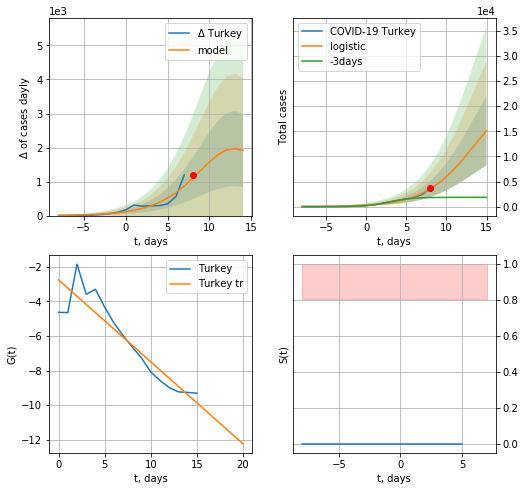

Turkey data at: 2020-05-30
+3 day model MAPE: 1.5246814929812549
model: logistic
coeffs:  [2.42672036e+04 3.25610640e-01 1.34529779e+01]
rational stdev:  0.45520286558776807
forecast at the end of period: +7 days
	 deltaDaycases:  1915
	 total cases:  15126 ± 6885
	 total death:  418 ± 570
trend coefficient of determination: 0.850665
 intercept: -2.746555
 slope: -0.474541


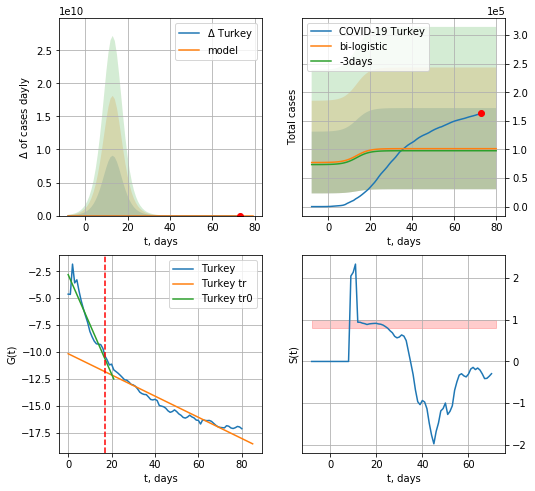

Turkey data at: 2020-05-30
+3 day model MAPE: 0.036953476924917066
model: bi-logistic
coeffs:  [ 6.16899640e+04 -2.94591338e+00  9.13491230e+01] [2.42672036e+04 3.25610640e-01 1.34529779e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.7004322957378503
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  101379 ± 71009
	 total death:  2806 ± 5896
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.862807
 intercept: -2.813054
 slope: -0.461241
trend coefficient of determination: 0.921743
 intercept: -10.154656
 slope: -0.098366


In [197]:
vL=17
x = forecast('Turkey',dfTR[:vL],d1,7*10-dT,1.)
xx=forecast2('Turkey',dfTR[:],d1,10*7-dT,x,1.,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


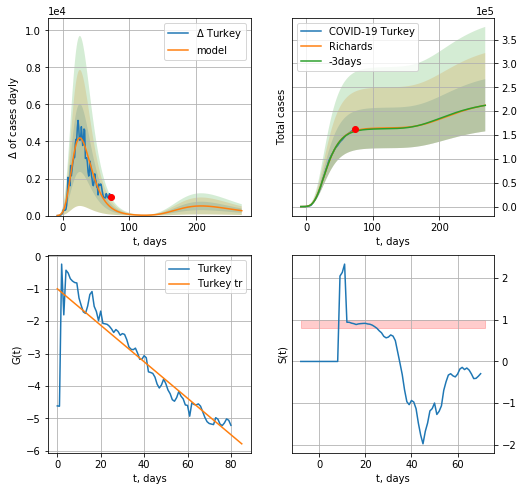

Turkey data at: 2020-05-30
+3 day model MAPE: 0.007529
model: Richards
coeffs: [ 1.65057449e+05  8.09869276e+00 -4.23839052e+01  8.56429094e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.257682
forecast at the end of period: +196 days
	 deltaDaycases: 265
	 total cases: 212377 ± 54725
	 total death: 5879 ± 4544
trend coefficient of determination: 0.802619
 intercept: -1.003053
 slope: -0.056260


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


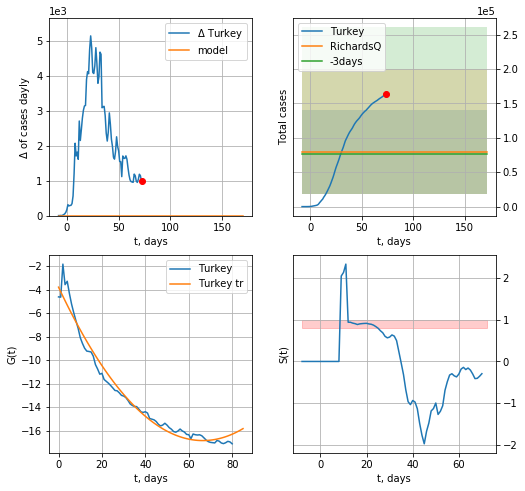

Turkey data at: 2020-05-30
+3 day model MAPE: 0.041102
model: RichardsQ
coeffs: [ 7.94596587e+04  1.93160317e+00 -7.88817137e+02  6.57222940e+02
 -1.25943165e+00]
rational stdev: 0.762435
forecast at the end of period: +98 days
	 deltaDaycases: 0
	 total cases: 79459 ± 60582
	 total death: 2199 ± 5029
trend coefficient of determination: 0.974401
 intercept_: -3.798245526315201
 coeffs_: [ 0.         -0.39245308  0.00295277]


In [198]:
x = forecastRR('Turkey',dfTR[:],d1,28*7,1.,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Turkey',dfTR[:],d1,14*7,1.,addpred=False,xcoef=[0.35,.5,3,1,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


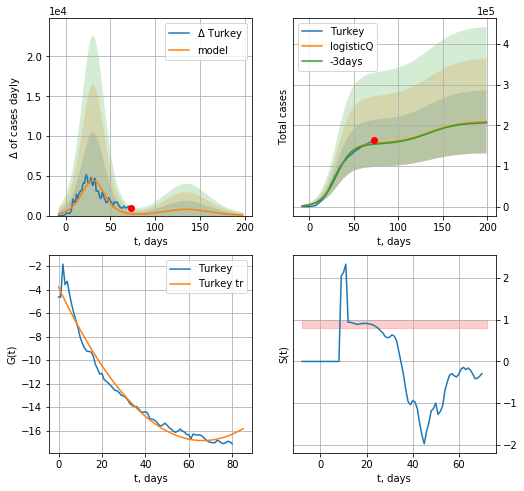

Turkey data at: 2020-05-30
+3 day model MAPE: 0.013583
model: logisticQ
coeffs: [ 1.55192396e+05  5.98898481e-07  3.09711438e+01 -1.91052160e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.372303
forecast at the end of period: +126 days
	 deltaDaycases: 77
	 total cases: 208811 ± 77741
	 total death: 5780 ± 6455
trend coefficient of determination: 0.974401
 intercept_: -3.798245526315201
 coeffs_: [ 0.         -0.39245308  0.00295277]


In [199]:
x = forecastRRR('Turkey',dfTR[:],d1,18*7,1.,addpred=True,xcoef=koreaCoeffs)

#xx=forecast2R('Turkey',dfTR[:],d1,14*7-dT,x,1.)

In [200]:
dfTT[dfTT.Country=='%s'%("Latvia")][0].values[0]

0.022535211267605635

In [201]:
#trend3(dfPL[1:],dfIS[7:],dfSW,'PL','IS','SW',40,40,40)

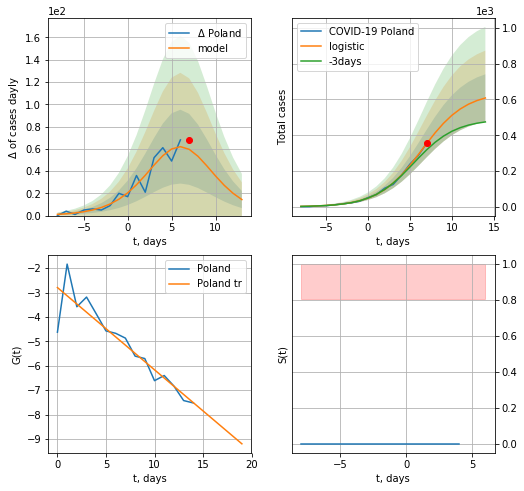

Poland data at: 2020-05-30
+3 day model MAPE: 0.14646234511665837
model: logistic
coeffs:  [6.41107567e+02 3.87606719e-01 6.46563498e+00]
rational stdev:  0.21770687952847212
forecast at the end of period: +7 days
	 deltaDaycases:  14
	 total cases:  608 ± 132
	 total death:  27 ± 17
trend coefficient of determination: 0.843228
 intercept: -2.795749
 slope: -0.337043


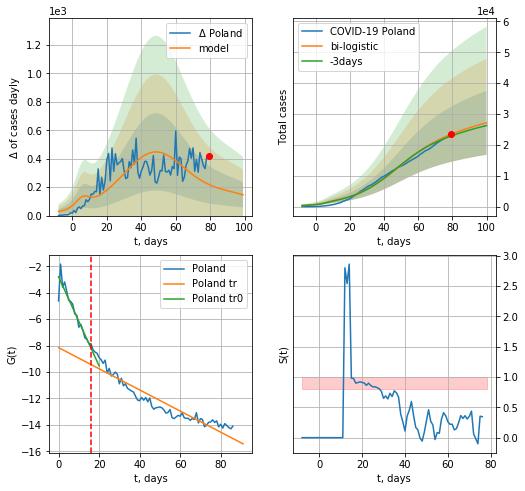

Poland data at: 2020-05-30
+3 day model MAPE: 0.025329711401264863
model: bi-logistic
coeffs:  [2.36880179e+04 7.35863235e-02 4.82939004e+01] [6.41107567e+02 3.87606719e-01 6.46563498e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.38148164990747985
forecast at the end of period: +21 days
	 deltaDaycases:  146
	 total cases:  27144 ± 10354
	 total death:  1221 ± 1397
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.867285
 intercept: -2.795308
 slope: -0.337138
trend coefficient of determination: 0.885138
 intercept: -8.155579
 slope: -0.080039


In [203]:
vL=16
vL1=38
x =  forecast('Poland',dfPL[:vL],d1,7*10-dT,1.)
xx = forecast2('Poland',dfPL[:],d1,12*7-dT,x,1.,vL=vL,addpred=True,xcoef=[0.25,1.,2.])
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Poland",dfPL,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.5,1.,1.3],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


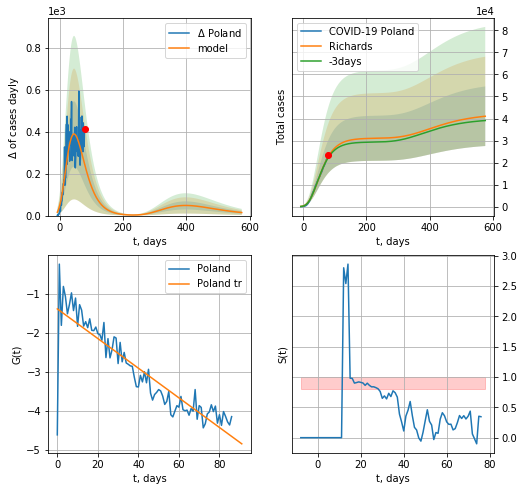

Poland data at: 2020-05-30
+3 day model MAPE: 0.019775
model: Richards
coeffs: [ 3.10826791e+04  3.09784555e+00 -8.58850163e+01  1.10716073e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.329550
forecast at the end of period: +497 days
	 deltaDaycases: 14
	 total cases: 41032 ± 13522
	 total death: 1846 ± 1825
trend coefficient of determination: 0.794780
 intercept: -1.389818
 slope: -0.037966


In [204]:
x =  forecastRR('Poland',dfPL[:],d1,80*7-dT,addpred=True,xcoef=RkoreaCoeffs)
#xx = forecast2R('Poland',dfPL[:],d1,8*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


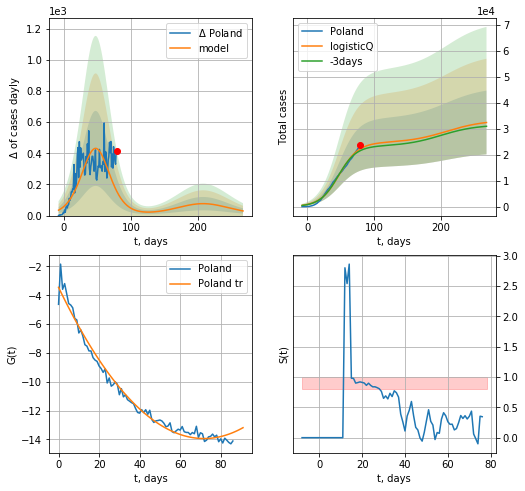

Poland data at: 2020-05-30
+3 day model MAPE: 0.033265
model: logisticQ
coeffs: [ 2.45756670e+04  4.18982004e-07  4.77025235e+01 -1.67279503e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.379036
forecast at the end of period: +189 days
	 deltaDaycases: 29
	 total cases: 32345 ± 12260
	 total death: 1455 ± 1654
trend coefficient of determination: 0.981323
 intercept_: -3.4474470432007633
 coeffs_: [ 0.         -0.29228042  0.00203634]


In [205]:
x =  forecastRRR('Poland',dfPL[:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

IS
          date    cases  active  death
94 2020-05-26  16757.0    2019  281.0
95 2020-05-27  16793.0    1942  281.0
96 2020-05-28  16872.0    1909  284.0
97 2020-05-29  16987.0    1927  284.0
98 2020-05-30  17024.0    1928  284.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


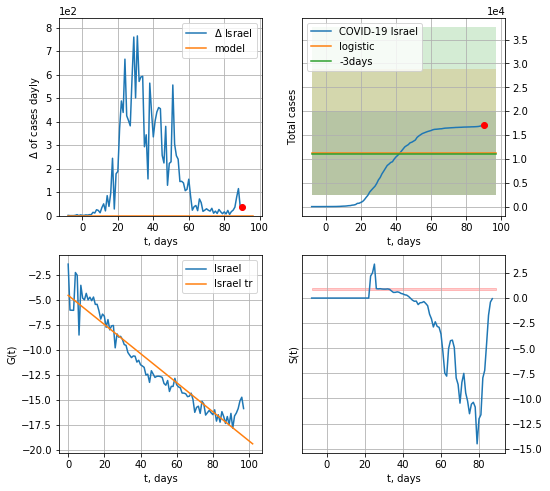

Israel data at: 2020-05-30
+3 day model MAPE: 0.028175155933899243
model: logistic
coeffs:  [ 9.03671788e+03 -4.17830300e+00  1.19137309e+02]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.777433756381256
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  11295 ± 8781
	 total death:  188 ± 438
trend coefficient of determination: 0.915888
 intercept: -4.517123
 slope: -0.145992


In [206]:
dfIS = read_df(pd.DataFrame(),"IS")
x = forecast('Israel',dfIS[:],d1,10*7-dT,addpred=True,xcoef=[0.25,1.,1.8])
#xx = forecast2('Israel',dfIS[:],d1,20-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


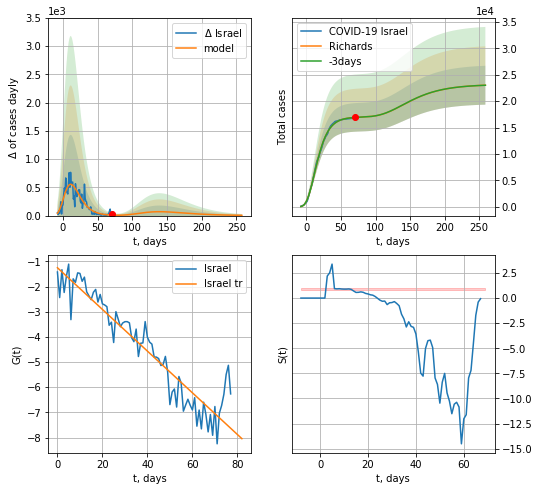

Israel data at: 2020-05-30
+3 day model MAPE: 0.000486
model: Richards
coeffs: [ 1.70095687e+04  6.46617945e+00 -3.65235323e+01  1.37764918e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.159672
forecast at the end of period: +189 days
	 deltaDaycases: 4
	 total cases: 23013 ± 3674
	 total death: 383 ± 183
trend coefficient of determination: 0.880569
 intercept: -1.254023
 slope: -0.082804


In [207]:
x = forecastRR('Israel',dfIS[20:],d1,36*7-dT,addpred=True,xcoef=RkoreaCoeffs)
#xx = forecast2R('Israel',dfIS[:],d1,7*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


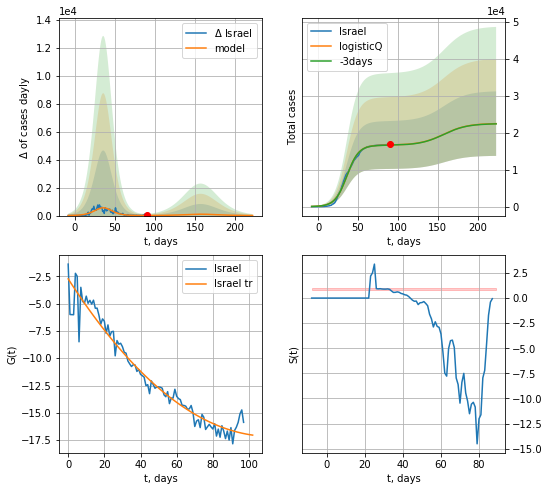

Israel data at: 2020-05-30
+3 day model MAPE: 0.002745
model: logisticQ
coeffs: [ 1.66100352e+04  7.61422527e-07  3.61333088e+01 -1.77048774e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.388671
forecast at the end of period: +133 days
	 deltaDaycases: 4
	 total cases: 22424 ± 8715
	 total death: 374 ± 436
trend coefficient of determination: 0.952136
 intercept_: -2.736279881178591
 coeffs_: [ 0.         -0.25730129  0.00114755]


In [208]:
x = forecastRRR('Israel',dfIS[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


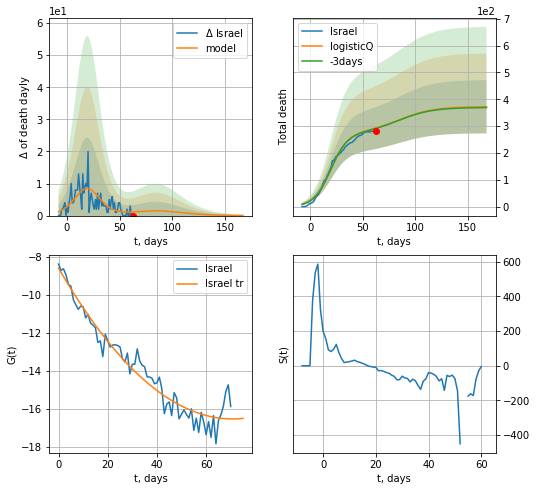

Israel data at: 2020-05-30
+3 day model MAPE: 0.006322
model: logisticQ
coeffs: [ 2.75491460e+02  7.32773053e-07  1.95179584e+01 -1.65956366e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.265749
forecast at the end of period: +105 days
	 total death: 372 ± 98
trend coefficient of determination: 0.942991
 intercept_: -8.593618442117055
 coeffs_: [ 0.         -0.22441982  0.00158637]


In [209]:
x = forecastRRR('Israel',dfIS[27:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


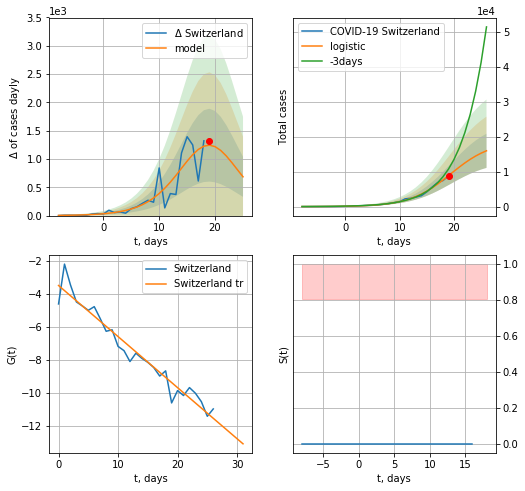

Switzerland data at: 2020-05-30
+3 day model MAPE: 0.24949892382467553
model: logistic
coeffs:  [1.87061213e+04 2.66466230e-01 1.93986309e+01]
rational stdev:  0.30604789910568747
forecast at the end of period: +7 days
	 deltaDaycases:  685
	 total cases:  15957 ± 4883
	 total death:  992 ± 910
trend coefficient of determination: 0.944448
 intercept: -3.508672
 slope: -0.309041


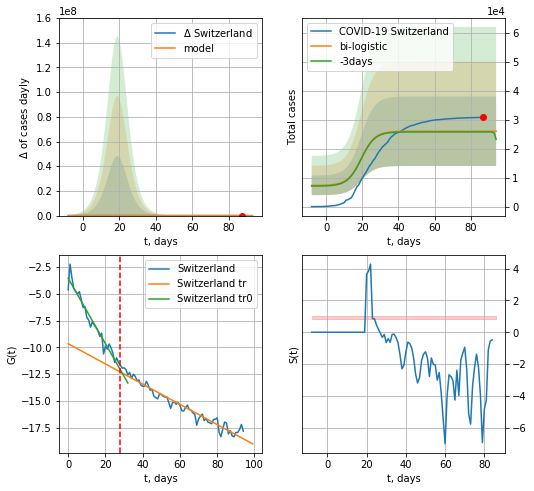

Switzerland data at: 2020-05-30
+3 day model MAPE: 0.00976612297217821
model: bi-logistic
coeffs:  [ 5.87022788e+03 -2.31947633e+00  1.08654089e+02] [1.87061213e+04 2.66466230e-01 1.93986309e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.46113616386923156
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  26043 ± 12009
	 total death:  1620 ± 2241
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.947988
 intercept: -3.537068
 slope: -0.305765
trend coefficient of determination: 0.948718
 intercept: -9.658804
 slope: -0.094549


In [211]:
vL= 28
x = forecast('Switzerland',dfSZ[:vL],d1,7*10-dT)
xx = forecast2('Switzerland',dfSZ[:],d1,7*10-dT,x,vL=vL,addpred=True,xcoef=[0.25,1.,2.])#,addpred=False,xcoef=[0.25,1.,2.5]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


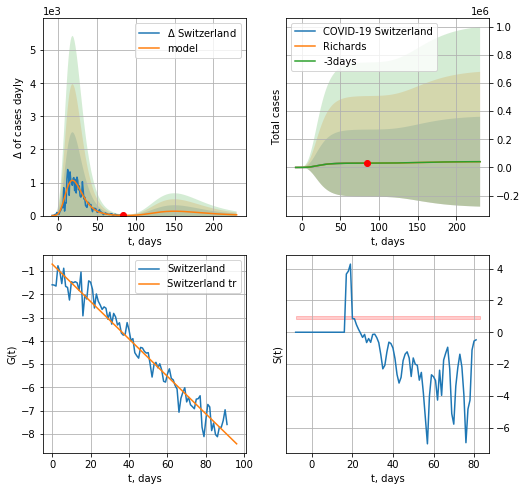

Switzerland data at: 2020-05-30
+3 day model MAPE: 0.000601
model: Richards
coeffs: [ 3.07202327e+04  1.01570188e+01 -3.06449626e+01  9.33057224e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 7.777753
forecast at the end of period: +147 days
	 deltaDaycases: 24
	 total cases: 41070 ± 319438
	 total death: 2555 ± 59616
trend coefficient of determination: 0.962012
 intercept: -0.695914
 slope: -0.080595


In [212]:
x = forecastRR('Switzerland',dfSZ[3:],d1,7*30-dT,addpred=True,xcoef=RkoreaCoeffs)
#xx = forecastR('Switzerland',dfSZ[:],d1,7*5-dT,x,vL=15)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


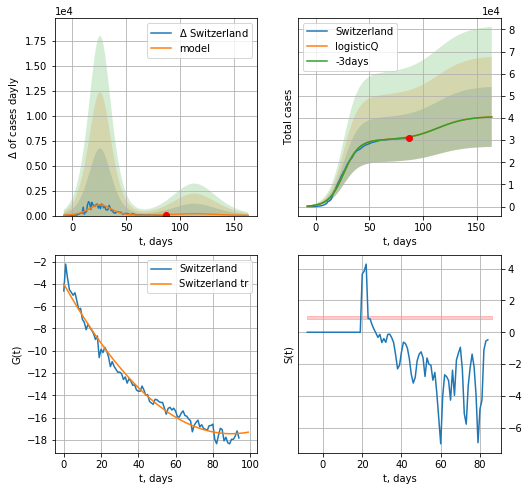

Switzerland data at: 2020-05-30
+3 day model MAPE: 0.001931
model: logisticQ
coeffs: [ 3.01432514e+04  6.92672328e-07  2.60415632e+01 -2.06324243e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.334003
forecast at the end of period: +77 days
	 deltaDaycases: 19
	 total cases: 40543 ± 13541
	 total death: 2522 ± 2527
trend coefficient of determination: 0.982583
 intercept_: -3.996448962958615
 coeffs_: [ 0.         -0.29944382  0.00166552]


In [213]:
x = forecastRRR('Switzerland',dfSZ[:],d1,7*20-dT,addpred=True,xcoef=koreaCoeffs)

In [214]:
#trend3(dfUR[5:],dfIN[7:],dfRS[5:],'UR','IN','RS',40,40,40)

Ukr
          date    cases  active  death
77 2020-05-26  21584.0   13365  644.0
78 2020-05-27  21905.0   13252  658.0
79 2020-05-28  22382.0   13274  669.0
80 2020-05-29  22811.0   13198  679.0
81 2020-05-30  23204.0   13197  696.0


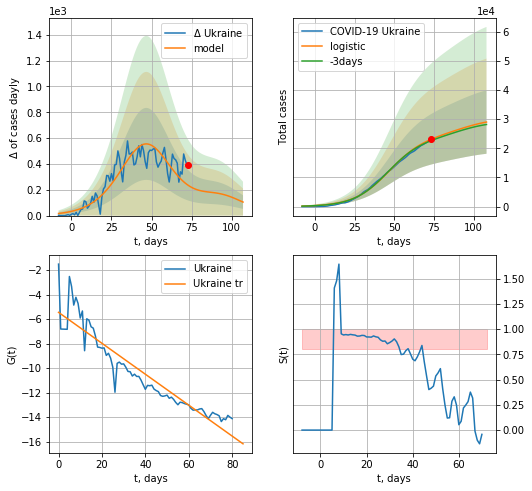

Ukraine data at: 2020-05-30
+3 day model MAPE: 0.0208067384598894
model: logistic
coeffs:  [2.43268690e+04 9.00031766e-02 4.68715314e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.37503298311356087
forecast at the end of period: +35 days
	 deltaDaycases:  104
	 total cases:  28989 ± 10872
	 total death:  869 ± 977
trend coefficient of determination: 0.875176
 intercept: -5.446422
 slope: -0.126355


In [215]:
dfUR = read_df(pd.DataFrame(),"Ukr")
try:
    x=forecast('Ukraine',dfUR[:],d1,14*7-dT,addpred=True,xcoef=[0.25,1.,2.])
except:
      print("Exaption occurs") 

#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: invalid value encountered in true_divide


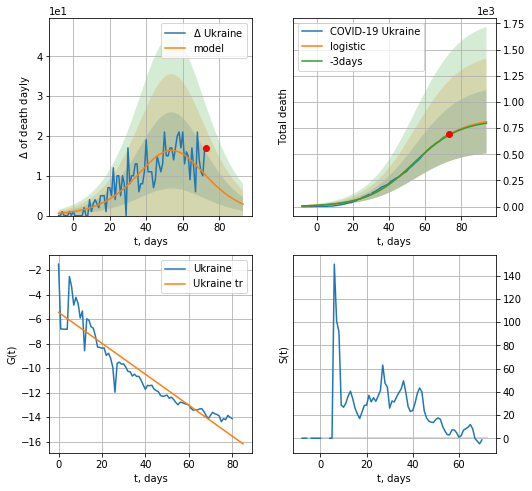

Ukraine data at: 2020-05-30
+3 day model MAPE: 0.009435782136230867
model: logistic
coeffs:  [8.48025745e+02 7.72200752e-02 5.43324230e+01]
rational stdev:  0.3727020055159811
forecast at the end of period: +21 days
	 total death:  810 ± 301
trend coefficient of determination: 0.875176
 intercept: -5.446422
 slope: -0.126355


In [216]:
x=forecast('Ukraine',dfUR[:],d1,12*7-dT,addpred=False,xcoef=[0.25,1.,2.],cases='death')
#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


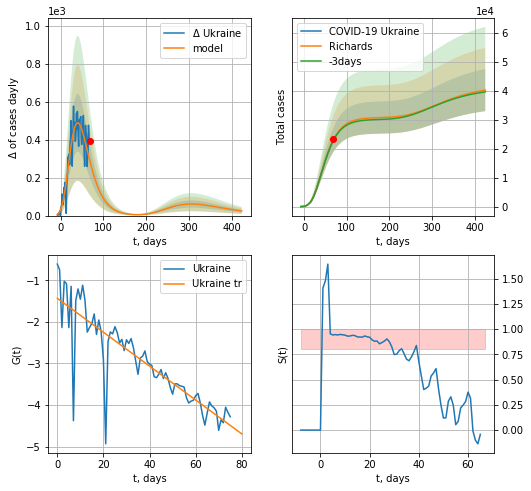

Ukraine data at: 2020-05-30
+3 day model MAPE: 0.007492
model: Richards
coeffs: [ 3.08002721e+04  2.15477029e+00 -4.90744897e+01  2.02558479e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.180798
forecast at the end of period: +357 days
	 deltaDaycases: 24
	 total cases: 40216 ± 7271
	 total death: 1206 ± 654
trend coefficient of determination: 0.747115
 intercept: -1.432423
 slope: -0.040757


In [217]:
x=forecastRR('Ukraine',dfUR[5:],d1,7*60-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


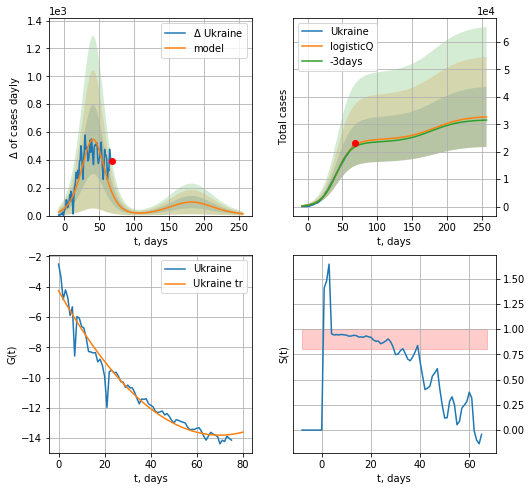

Ukraine data at: 2020-05-30
+3 day model MAPE: 0.024556
model: logisticQ
coeffs: [ 2.43460281e+04  1.08940689e-06  4.18952795e+01 -8.24027814e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.334245
forecast at the end of period: +189 days
	 deltaDaycases: 12
	 total cases: 32679 ± 10922
	 total death: 980 ± 982
trend coefficient of determination: 0.959414
 intercept_: -4.266204254606275
 coeffs_: [ 0.         -0.27286737  0.00195282]


In [218]:
x=forecastRRR('Ukraine',dfUR[5:],d1,7*36-dT,addpred=True,xcoef=koreaCoeffs)

In [219]:
#np.log(np.diff(dfIS["cases"].values)[:]/dfIS["cases"].values[1:]**2)

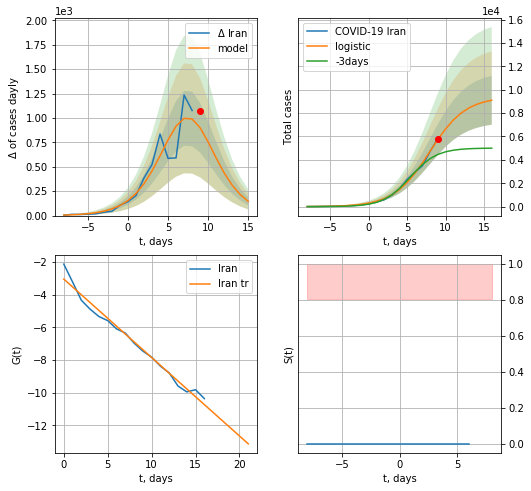

Iran data at: 2020-05-30
+3 day model MAPE: 0.41768987892528675
model: logistic
coeffs:  [9.38566037e+03 4.29600563e-01 7.92981697e+00]
rational stdev:  0.2297342175744371
forecast at the end of period: +7 days
	 deltaDaycases:  145
	 total cases:  9101 ± 2090
	 total death:  472 ± 325
trend coefficient of determination: 0.980602
 intercept: -3.037586
 slope: -0.480406


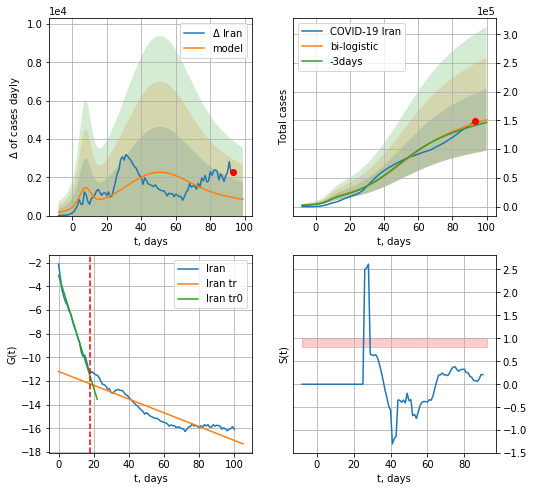

Iran data at: 2020-05-30
+3 day model MAPE: 0.027781127475432602
model: bi-logistic
coeffs:  [1.30333566e+05 6.73027000e-02 5.03793188e+01] [9.38566037e+03 4.29600563e-01 7.92981697e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.3567180866835478
forecast at the end of period: +7 days
	 deltaDaycases:  846
	 total cases:  151132 ± 53911
	 total death:  7847 ± 8397
bi-logistic approximation splitting point: 18
trend0 coefficient of determination: 0.982944
 intercept: -3.059655
 slope: -0.476268
trend coefficient of determination: 0.838267
 intercept: -11.190622
 slope: -0.058239


In [221]:
x = forecast('Iran',dfIN[:18],d1,7*10-dT)
xx = forecast2('Iran',dfIN[:],d1,10*7-dT,x,vL=18,addpred=True,xcoef=[0.25,1.,2.0])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


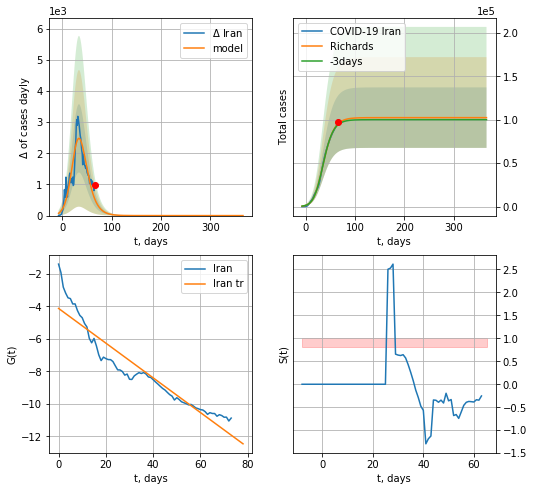

Iran data at: 2020-05-30
+3 day model MAPE: 0.012009
model: Richards
coeffs: [1.02478153e+05 1.52216321e-01 2.65523922e+01 5.45962709e-01]
rational stdev: 0.339941
forecast at the end of period: +301 days
	 deltaDaycases: 0
	 total cases: 102478 ± 34836
	 total death: 5321 ± 5426
trend coefficient of determination: 0.893485
 intercept: -4.118017
 slope: -0.106957


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:154: RuntimeWarning: overflow encountered in power


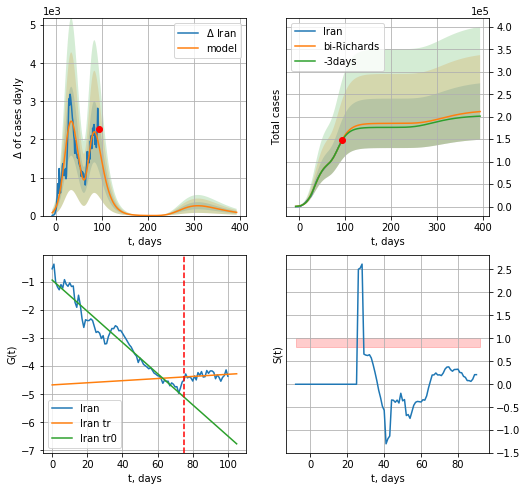

Iran data at: 2020-05-30
+3 day model MAPE: 0.009255
model: bi-Richards
coeffs: [8.28925244e+04 4.50248715e+00 2.42786627e+01 1.52579529e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.296853
forecast at the end of period: +301 days
	 deltaDaycases: 84
	 total cases: 211577 ± 62807
	 total death: 10985 ± 9782
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.949240
 intercept: -0.937748
 slope: -0.055497
trend coefficient of determination: 0.058492
 intercept: -4.667998
 slope: 0.003768


In [222]:
vL = 75
x = forecastRR('Iran',dfIN[:vL],d1,52*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Iran',dfIN[:],d1,52*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


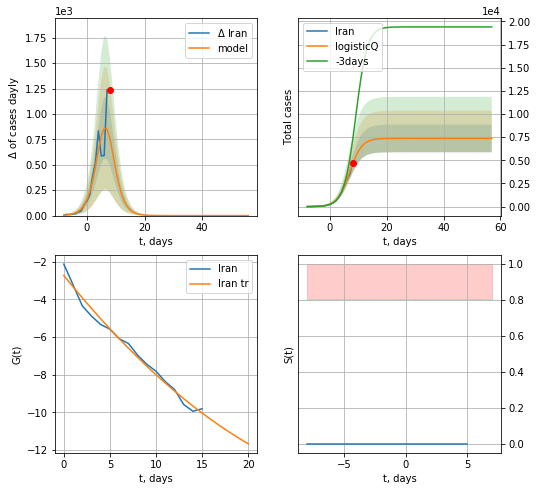

Iran data at: 2020-05-30
+3 day model MAPE: 0.437963
model: logisticQ
coeffs: [ 7.36885538e+03  7.42900276e-05 -6.37012173e+03  6.90117085e+00]
rational stdev: 0.203007
forecast at the end of period: +49 days
	 deltaDaycases: 0
	 total cases: 7368 ± 1495
	 total death: 382 ± 232
trend coefficient of determination: 0.985826
 intercept_: -2.7244557798652984
 coeffs_: [ 0.         -0.60810956  0.00802289]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


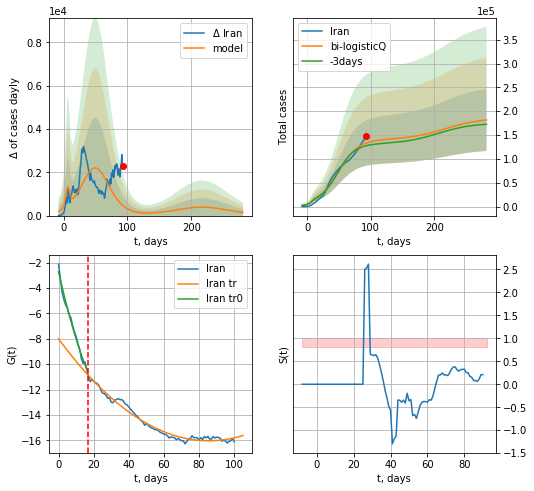

Iran data at: 2020-05-30
+3 day model MAPE: 0.044618
model: bi-logisticQ
coeffs: [ 1.32307012e+05  1.85630462e-07  4.97866257e+01 -3.57878164e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.357663
forecast at the end of period: +189 days
	 deltaDaycases: 145
	 total cases: 181744 ± 65003
	 total death: 9436 ± 10124
bi-logisticQ approximation splitting point: 17
trend coefficient of determination: 0.987745
 intercept_: -2.720144864989817
 coeffs_: [ 0.         -0.61067547  0.00823538]
trend coefficient of determination: 0.978001
 intercept_: -8.004384987680242
 coeffs_: [ 0.         -0.18773387  0.00109812]


In [223]:
x = forecastRRR('Iran',dfIN[:17],d1,16*7-dT,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Iran',dfIN[:],d1,36*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=17)

RS
          date     cases  active   death
87 2020-05-26  362342.0  227406  3807.0
88 2020-05-27  370680.0  224504  3968.0
89 2020-05-28  379051.0  223916  4142.0
90 2020-05-29  387623.0  223992  4374.0
91 2020-05-30  396575.0  224551  4555.0


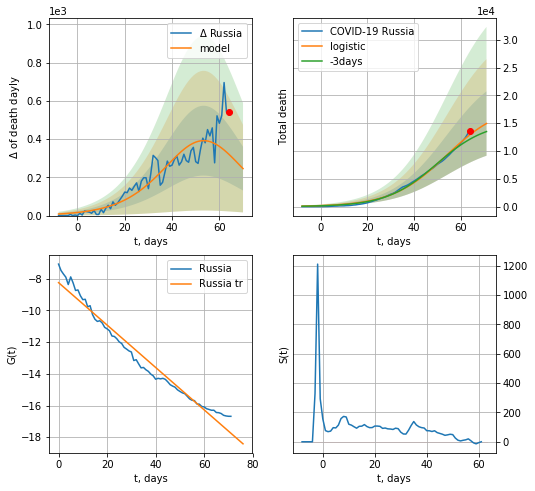

Russia data at: 2020-05-30
+3 day model MAPE: 0.07248989704139744
model: logistic
coeffs:  [1.84024466e+04 8.52380545e-02 5.38314963e+01]
rational stdev:  0.38747261523224197
forecast at the end of period: +7 days
	 total death:  14943 ± 5790
trend coefficient of determination: 0.967077
 intercept: -8.246345
 slope: -0.133815


In [224]:
dfRS = read_df(pd.DataFrame(),"RS")
x = forecast('Russia',dfRS[19:],d1,10*7-dT,shift=3.,cases='death')
#xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14)#,addpred=True,xcoef=[0.5,1.,3.5]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


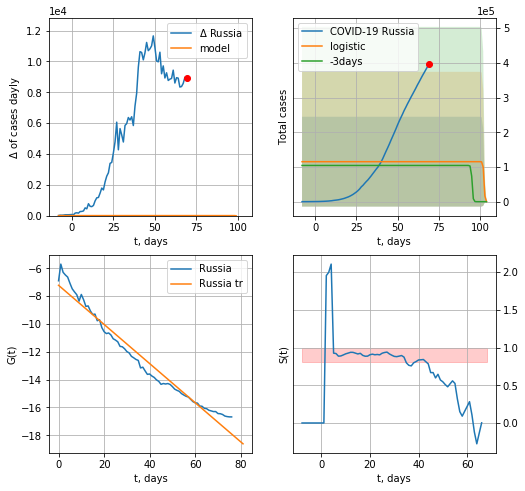

Russia data at: 2020-05-30
+3 day model MAPE: 0.10439784295535634
model: logistic
coeffs:  [ 1.15290859e+05 -3.61166257e+00  1.02504630e+02]
rational stdev:  1.1231973423252977
forecast at the end of period: +35 days
	 deltaDaycases:  -15989
	 total cases:  517 ± 581
	 total death:  5 ± 16
trend coefficient of determination: 0.964307
 intercept: -7.225582
 slope: -0.140607


In [225]:
x = forecast('Russia',dfRS[14:],d1,14*7-dT,shift=1.)
#xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14,shift=1.)#,addpred=True,xcoef=[0.5,1.,3.5]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


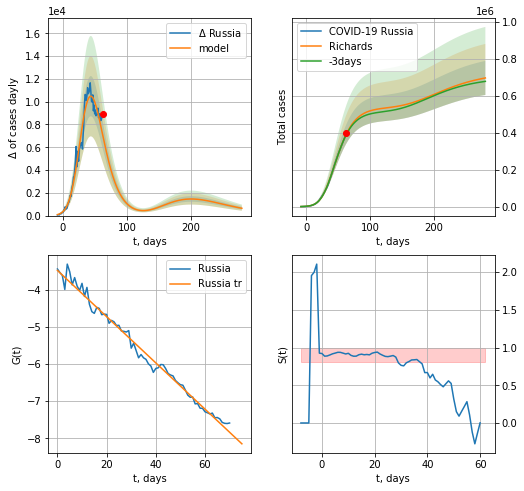

Russia data at: 2020-05-30
+3 day model MAPE: 0.008515
model: Richards
coeffs: [5.35772058e+05 2.06614500e-01 2.43545094e+01 2.94638045e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.132212
forecast at the end of period: +217 days
	 deltaDaycases: 642
	 total cases: 696023 ± 92022
	 total death: 7994 ± 3170
trend coefficient of determination: 0.987466
 intercept: -3.477126
 slope: -0.062297


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


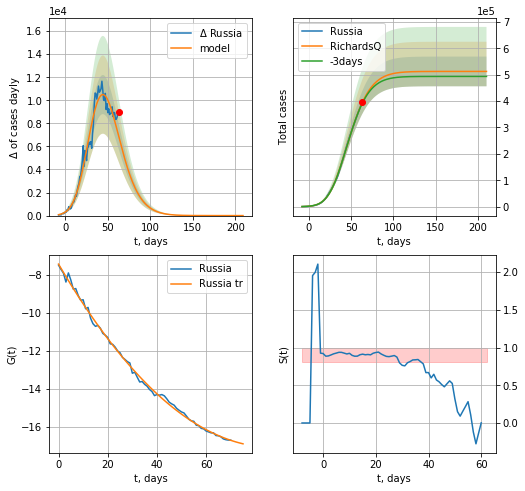

Russia data at: 2020-05-30
+3 day model MAPE: 0.008733
model: RichardsQ
coeffs: [ 5.12455577e+05  5.19667828e-03 -8.51332580e+01 -5.08731086e+01
  4.94087120e-02]
rational stdev: 0.109727
forecast at the end of period: +147 days
	 deltaDaycases: 0
	 total cases: 512455 ± 56230
	 total death: 5885 ± 1937
trend coefficient of determination: 0.997639
 intercept_: -7.422413075661415
 coeffs_: [ 0.         -0.22142639  0.00127185]


In [226]:
x = forecastRR('Russia',dfRS[20:],d1,40*7-dT,addpred=True,xcoef=RkoreaCoeffs)#,addpred=True,xcoef=[0.25,1.,1.5,1]
x = forecastQR('Russia',dfRS[20:],d1,30*7-dT)#,addpred=True,xcoef=[0.25,1.,1.5,1]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


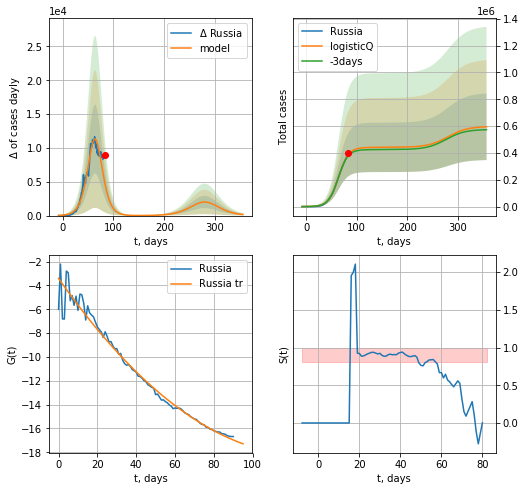

Russia data at: 2020-05-30
+3 day model MAPE: 0.022003
model: logisticQ
coeffs: [ 4.41553907e+05  2.38222394e-06  6.41656884e+01 -4.29481242e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.416924
forecast at the end of period: +273 days
	 deltaDaycases: 155
	 total cases: 594928 ± 248039
	 total death: 6833 ± 8546
trend coefficient of determination: 0.973631
 intercept_: -3.4076636907911
 coeffs_: [ 0.         -0.23218849  0.00090572]


In [227]:
x = forecastRRR('Russia',dfRS[:],d1,48*7-dT,addpred=True,xcoef=koreaCoeffs)

JP
           date    cases  active  death
125 2020-05-26  16623.0    1967  846.0
126 2020-05-27  16651.0    1820  858.0
127 2020-05-28  16683.0    1669  867.0
128 2020-05-29  16719.0    1591  874.0
129 2020-05-30  16804.0    1512  886.0


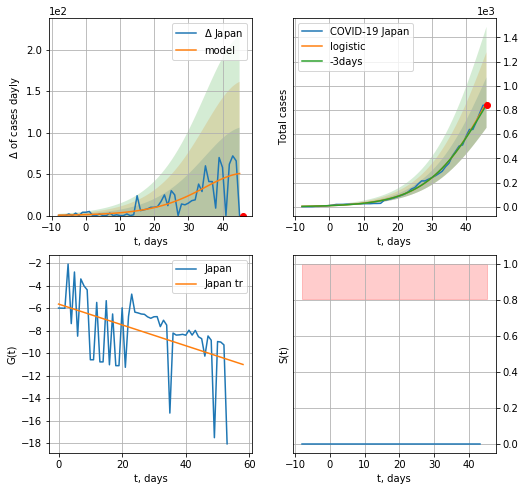

Japan data at: 2020-05-30
Exception occurs


In [228]:
dfJP = read_df(pd.DataFrame(),"JP")
try:
    x = forecast('Japan',dfJP[:55],d1,7*9-dT)
    xx = forecast2('Japan',dfJP[:],d1,10*7-dT,x,addpred=False,xcoef=[0.25,1.,1.25],vL=55)
except:
    print ("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


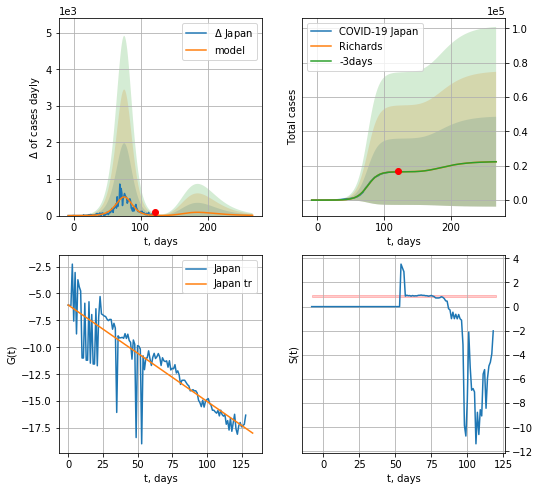

Japan data at: 2020-05-30
+3 day model MAPE: 0.003734
model: Richards
coeffs: [1.65461561e+04 1.13526888e-01 7.69453615e+01 1.13142642e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 1.167852
forecast at the end of period: +147 days
	 deltaDaycases: 6
	 total cases: 22385 ± 26142
	 total death: 1180 ± 4134
trend coefficient of determination: 0.771765
 intercept: -6.068270
 slope: -0.089404


In [229]:
x = forecastRR('Japan',dfJP[:],d1,30*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


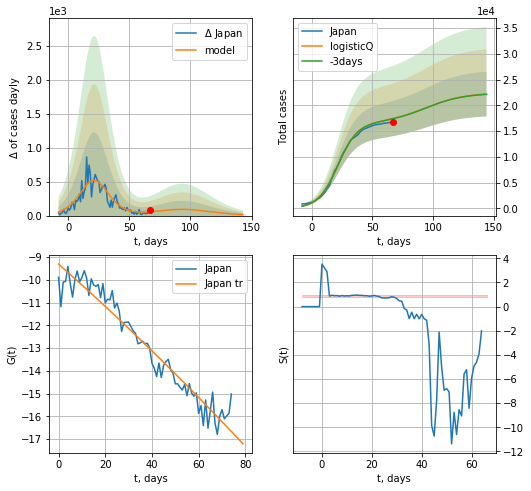

Japan data at: 2020-05-30
+3 day model MAPE: 0.002290
model: logisticQ
coeffs: [ 1.65684547e+04  4.71107647e-06  2.15359083e+01 -2.63042342e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.195803
forecast at the end of period: +77 days
	 deltaDaycases: 15
	 total cases: 22189 ± 4344
	 total death: 1169 ± 686
trend coefficient of determination: 0.940457
 intercept_: -9.311425348956453
 coeffs_: [ 0.         -0.0905015  -0.00011894]


In [230]:
x = forecastRRR('Japan',dfJP[54:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


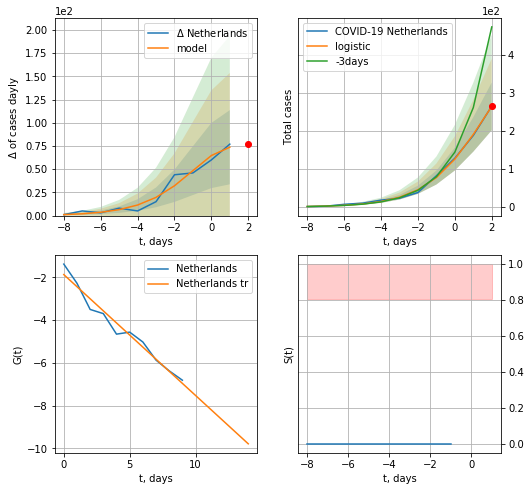

Netherlands data at: 2020-05-30
model: logistic
coeffs:  [487.74708253   0.61204074   1.72557629]
rational stdev:  0.23761280835096962
forecast at the end of period: +0 days
	 deltaDaycases:  73
	 total cases:  264 ± 62
	 total death:  34 ± 24
trend coefficient of determination: 0.966773
 intercept: -1.876651
 slope: -0.565279


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


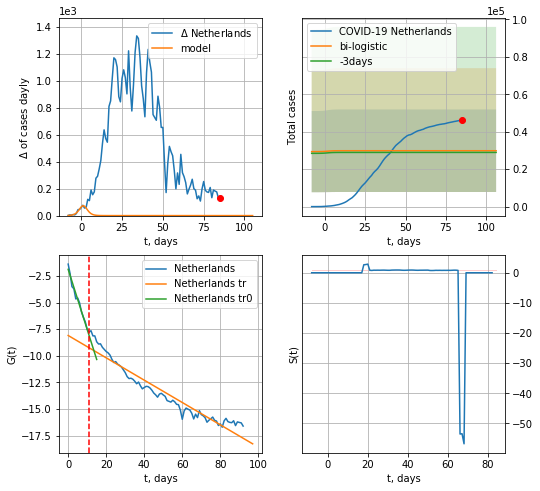

Netherlands data at: 2020-05-30
+3 day model MAPE: 0.03151696248708064
model: bi-logistic
coeffs:  [ 2.34905082e+04 -4.93552653e+00  1.49195014e+02] [487.74708253   0.61204074   1.72557629]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.7385503415179194
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  29850 ± 22046
	 total death:  3840 ± 8508
bi-logistic approximation splitting point: 11
trend0 coefficient of determination: 0.974821
 intercept: -1.878275
 slope: -0.564738
trend coefficient of determination: 0.926224
 intercept: -8.094967
 slope: -0.104958


In [231]:
vL=11
vL1=32
x = forecast('Netherlands',dfNL[:vL],d1,9*7-dT,pMAPE=False)
xx = forecast2('Netherlands',dfNL[:],d1,12*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Philippines",dfPH,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

NL
          date  cases  active   death
89 2020-05-26  45578       0  5856.0
90 2020-05-27  45768       0  5871.0
91 2020-05-28  45950       0  5903.0
92 2020-05-29  46126       0  5931.0
93 2020-05-30  46257       0  5951.0


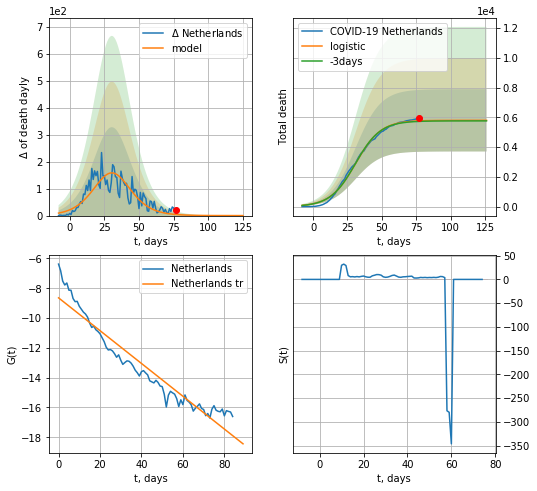

Netherlands data at: 2020-05-30
+3 day model MAPE: 0.006014361233040108
model: logistic
coeffs:  [5.80399341e+03 1.09306199e-01 3.09039829e+01]
rational stdev:  0.3608681011639674
forecast at the end of period: +49 days
	 total death:  5803 ± 2094
trend coefficient of determination: 0.921846
 intercept: -8.642875
 slope: -0.110109


In [232]:
dfNL = read_df(pd.DataFrame(),"NL")
x = forecast('Netherlands',dfNL[8:],d1,16*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


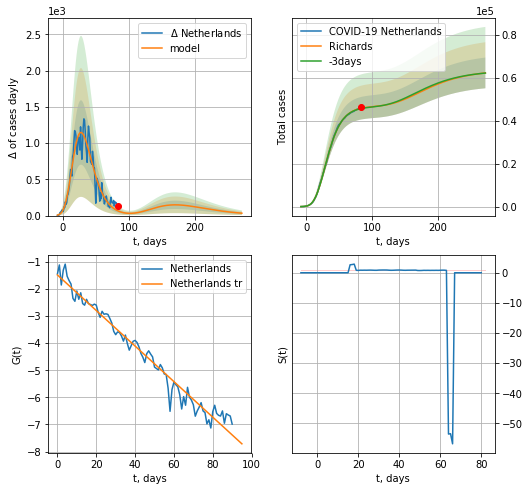

Netherlands data at: 2020-05-30
+3 day model MAPE: 0.003148
model: Richards
coeffs: [ 4.66628198e+04  6.74722036e-01 -4.05951173e+00  1.04157315e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.114722
forecast at the end of period: +189 days
	 deltaDaycases: 33
	 total cases: 62149 ± 7129
	 total death: 7995 ± 2751
trend coefficient of determination: 0.970104
 intercept: -1.481821
 slope: -0.065592


In [233]:
x = forecastRR('Netherlands',dfNL[2:],d1,36*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


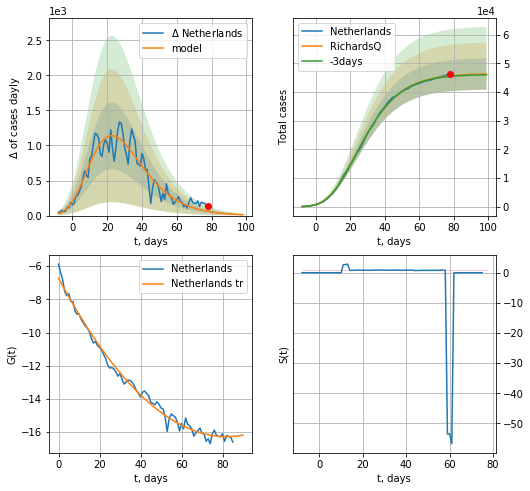

Netherlands data at: 2020-05-30
+3 day model MAPE: 0.004769
model: RichardsQ
coeffs: [ 4.64229740e+04  1.01788024e-02 -5.51135475e+01 -5.19943679e+02
  1.06254643e-02]
rational stdev: 0.118054
forecast at the end of period: +21 days
	 deltaDaycases: 12
	 total cases: 46278 ± 5463
	 total death: 5953 ± 2108
trend coefficient of determination: 0.990500
 intercept_: -6.726343926158464
 coeffs_: [ 0.         -0.23260325  0.00141609]


In [234]:
x = forecastQR('Netherlands',dfNL[7:],d1,12*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


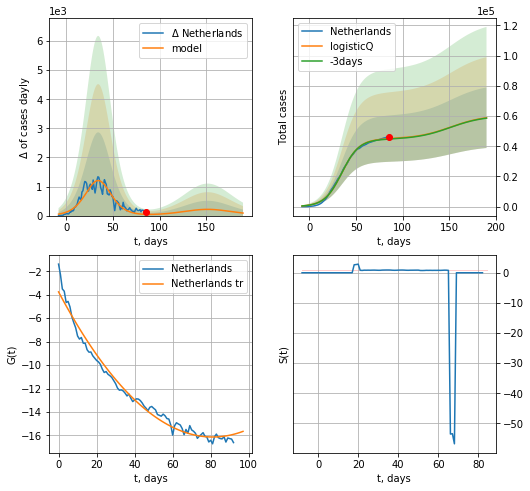

Netherlands data at: 2020-05-30
+3 day model MAPE: 0.006090
model: logisticQ
coeffs: [ 4.47850638e+04  6.93881321e-07  3.47893079e+01 -1.54878708e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.340689
forecast at the end of period: +105 days
	 deltaDaycases: 86
	 total cases: 58876 ± 20058
	 total death: 7574 ± 7741
trend coefficient of determination: 0.979931
 intercept_: -3.754708935335442
 coeffs_: [ 0.         -0.30545429  0.0018846 ]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


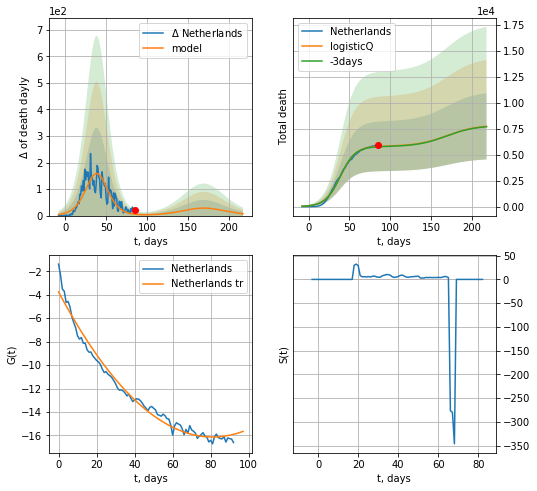

Netherlands data at: 2020-05-30
+3 day model MAPE: 0.006089
model: logisticQ
coeffs: [ 5.80172962e+03  6.79072110e-07  3.88964985e+01 -1.61218363e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.412794
forecast at the end of period: +133 days
	 total death: 7723 ± 3188
trend coefficient of determination: 0.979931
 intercept_: -3.754708935335442
 coeffs_: [ 0.         -0.30545429  0.0018846 ]


In [235]:
x = forecastRRR('Netherlands',dfNL[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Netherlands',dfNL[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

In [236]:
#trend3(dfAT[1:],dfSG[:],dfBG[:],'AT','SG','BG',40,35,35)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


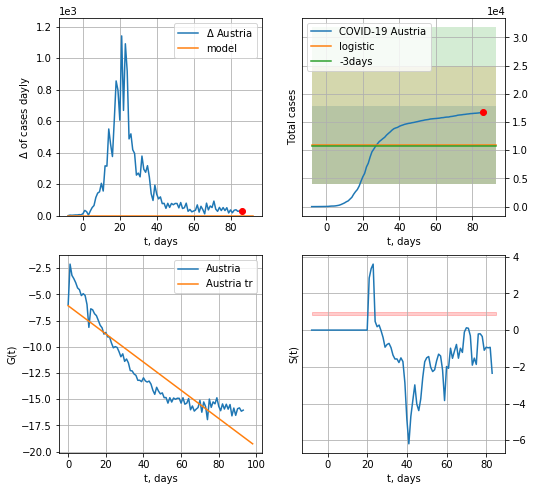

Austria data at: 2020-05-30
+3 day model MAPE: 0.0205060230716425
model: logistic
coeffs:  [ 1.03055580e+04 -3.26530684e+00  1.16363129e+02]
scenario coeffs:  [0.0625, 1.0, 2.0]
rational stdev:  0.6363789534099431
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  10949 ± 6968
	 total death:  438 ± 836
trend coefficient of determination: 0.845301
 intercept: -6.093328
 slope: -0.134280


In [238]:
x = forecast('Austria',dfAT[:],d1,7*10-dT,addpred=True,xcoef=[0.25/4,1.,2.0])
#xx = forecast2('Austria',dfAT[:],d1,7*7-dT,x,addpred=True,xcoef=[0.35*2,1.,1.5],vL=36)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


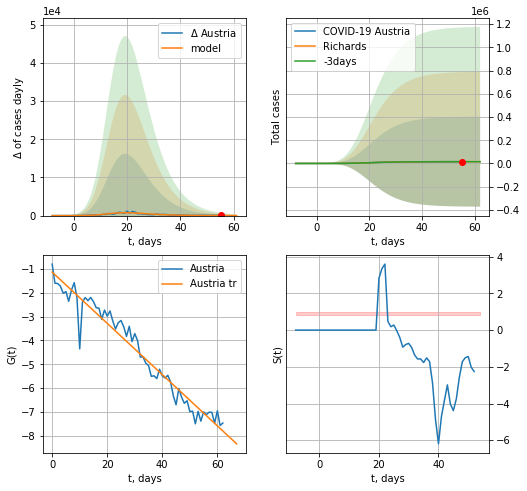

Austria data at: 2020-05-30
+3 day model MAPE: 0.006853
model: Richards
coeffs: [1.52399553e+04 8.17697795e-01 8.10432479e+00 1.79496396e-01]
rational stdev: 25.448318
forecast at the end of period: +7 days
	 deltaDaycases: 4
	 total cases: 15208 ± 387039
	 total death: 608 ± 46417
trend coefficient of determination: 0.949604
 intercept: -1.138894
 slope: -0.107415


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


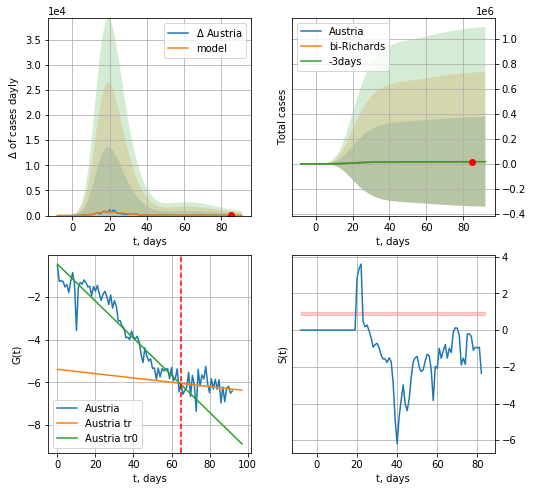

Austria data at: 2020-05-30
+3 day model MAPE: 0.000748
model: bi-Richards
coeffs: [1.80038329e+03 8.10395619e+00 3.35500066e-03 8.97904131e-03]
rational stdev: 21.347437
forecast at the end of period: +7 days
	 deltaDaycases: 16
	 total cases: 16808 ± 358812
	 total death: 672 ± 43036
bi-Richards approximation splitting point: 65
trend coefficient of determination: 0.902850
 intercept: -0.455000
 slope: -0.086934
trend coefficient of determination: 0.030359
 intercept: -5.393739
 slope: -0.010096


In [239]:
vL=65
x = forecastRR('Austria',dfAT[1:vL],d1,10*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Austria',dfAT[1:],d1,10*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#xx = forecast2R('Austria',dfAT[:],d1,8*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


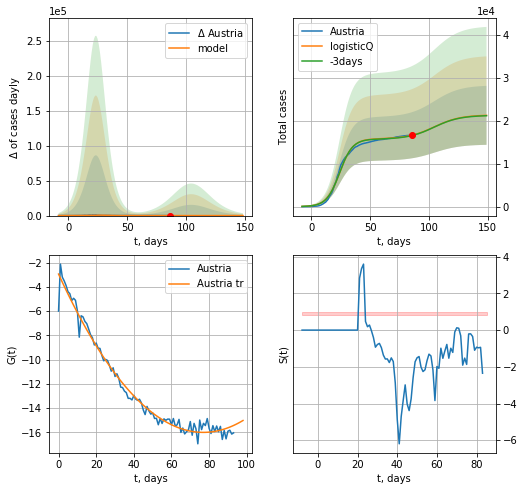

Austria data at: 2020-05-30
+3 day model MAPE: 0.004030
model: logisticQ
coeffs: [ 1.57662270e+04  6.43936442e-07  2.39960291e+01 -2.78417353e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.322945
forecast at the end of period: +63 days
	 deltaDaycases: 9
	 total cases: 21250 ± 6862
	 total death: 850 ± 823
trend coefficient of determination: 0.979893
 intercept_: -2.945826068695114
 coeffs_: [ 0.         -0.3395614   0.00220738]


In [240]:
vL = 68
x = forecastRRR('Austria',dfAT[:],d1,18*7-dT,addpred=True,xcoef=koreaCoeffs)
#xx = forecast2RRR('Austria',dfAT[:],d1,18*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


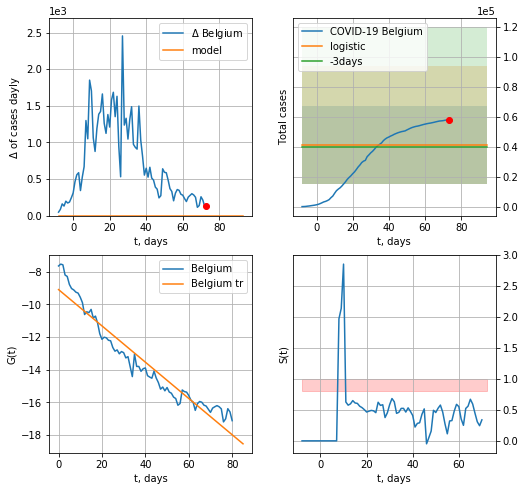

Belgium data at: 2020-05-30
+3 day model MAPE: 0.029506139876580767
model: logistic
coeffs:  [ 3.30718292e+04 -6.83925058e+00  2.32167951e+02]
scenario coeffs:  [0.25, 1.0, 3.0]
rational stdev:  0.6352817134226308
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  41339 ± 26262
	 total death:  6716 ± 12799
trend coefficient of determination: 0.926039
 intercept: -9.094189
 slope: -0.111026


In [241]:
vL=9
x = forecast('Belgium',dfBG[vL:],d1,12*7-dT,addpred=True,xcoef=[0.25,1.,3.])
#xx = forecast2('Belgium',dfBG[vL:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

BG
          date  cases  active   death
86 2020-05-26  57455   32801  9334.0
87 2020-05-27  57592   32763  9364.0
88 2020-05-28  57849   32889  9388.0
89 2020-05-29  58061   32949  9430.0
90 2020-05-30  58186   32964  9453.0


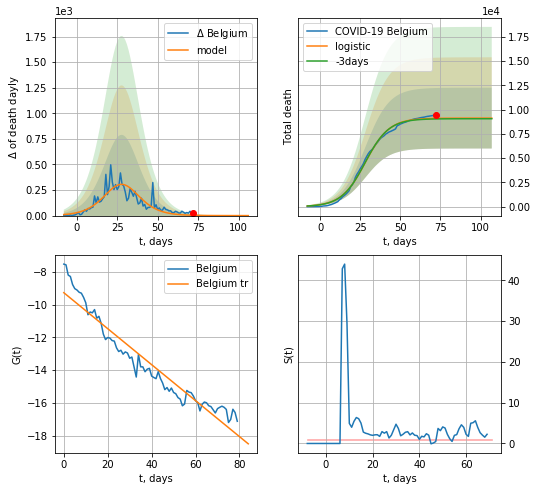

Belgium data at: 2020-05-30
+3 day model MAPE: 0.006924567191512254
model: logistic
coeffs:  [9.13203661e+03 1.33842393e-01 2.82013778e+01]
rational stdev:  0.343383129422642
forecast at the end of period: +35 days
	 total death:  9131 ± 3135
trend coefficient of determination: 0.925319
 intercept: -9.277492
 slope: -0.109653


In [242]:
dfBG = read_df(pd.DataFrame(),"BG")
x = forecast('Belgium',dfBG[10:],d1,14*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


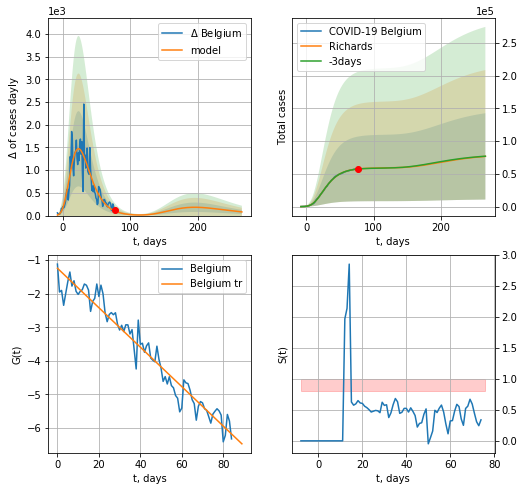

Belgium data at: 2020-05-30
+3 day model MAPE: 0.002482
model: Richards
coeffs: [ 5.91430896e+04  4.20582843e+00 -3.68036007e+01  1.62058491e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.859336
forecast at the end of period: +189 days
	 deltaDaycases: 80
	 total cases: 76785 ± 65984
	 total death: 12474 ± 32158
trend coefficient of determination: 0.948832
 intercept: -1.241661
 slope: -0.058725


In [243]:
x = forecastRR('Belgium',dfBG[5:],d1,36*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


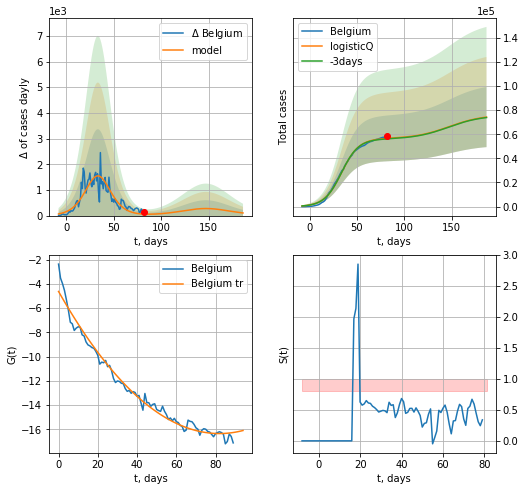

Belgium data at: 2020-05-30
+3 day model MAPE: 0.006902
model: logisticQ
coeffs: [ 5.63064004e+04  6.38058488e-07  3.38190135e+01 -1.72055553e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.335662
forecast at the end of period: +105 days
	 deltaDaycases: 102
	 total cases: 74236 ± 24918
	 total death: 12060 ± 12144
trend coefficient of determination: 0.980208
 intercept_: -4.623437318389243
 coeffs_: [ 0.         -0.28590083  0.00174352]


In [244]:
x = forecastRRR('Belgium',dfBG[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

In [245]:
dfBZ.tail()

,date,cases,active,death
91,2020-05-26,394507.0,211321,24593.0
92,2020-05-27,414661.0,222317,25697.0
93,2020-05-28,438812.0,218867,26764.0
94,2020-05-29,468338.0,247213,27944.0
95,2020-05-30,499966.0,265746,28849.0


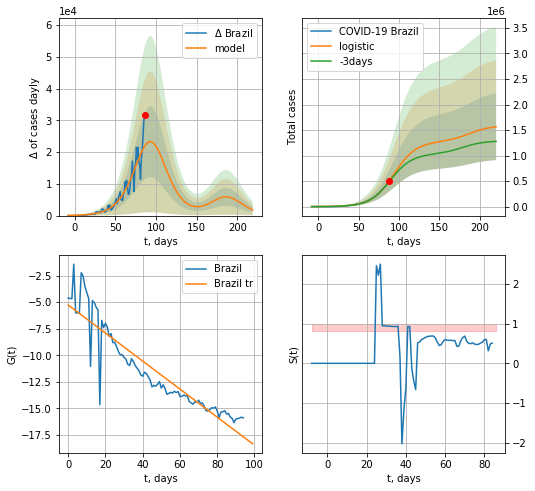

Brazil data at: 2020-05-30
+3 day model MAPE: 0.03343980529301989
model: logistic
coeffs:  [1.27217157e+06 7.30653030e-02 9.35392559e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.4170604479393894
forecast at the end of period: +133 days
	 deltaDaycases:  1828
	 total cases:  1563769 ± 652186
	 total death:  90232 ± 112896
trend coefficient of determination: 0.851904
 intercept: -5.262748
 slope: -0.131918


In [246]:
x = forecast('Brazil',dfBZ[:],d1,28*7-dT,addpred=True,xcoef=[0.25,1.,2.])
#xx = forecast2('Brazil',dfBZ[:],d1,4*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


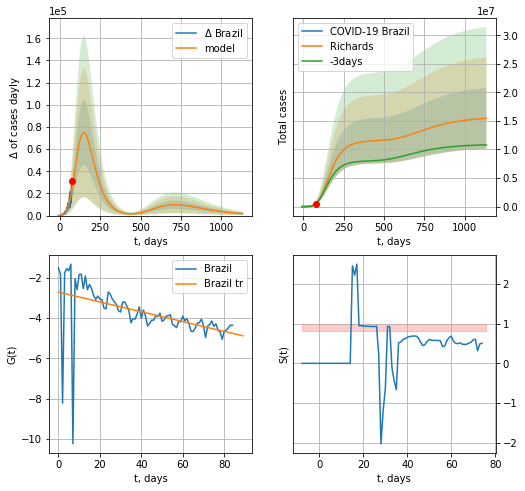

Brazil data at: 2020-05-30
+3 day model MAPE: 0.012381
model: Richards
coeffs: [1.15473464e+07 1.53761508e-01 3.62441188e+01 1.21380988e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.345383
forecast at the end of period: +1057 days
	 deltaDaycases: 1718
	 total cases: 15453837 ± 5337487
	 total death: 891716 ± 923949
trend coefficient of determination: 0.226175
 intercept: -2.710511
 slope: -0.024340


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


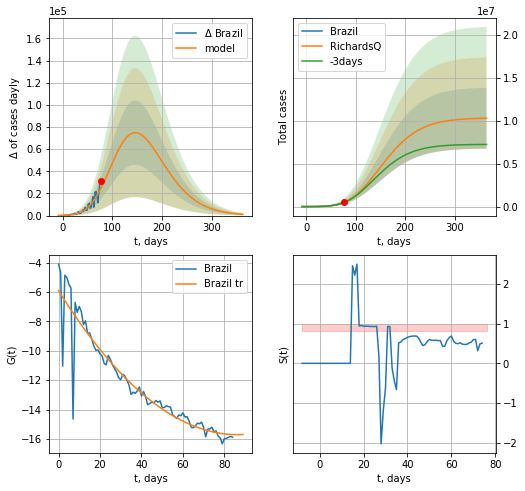

Brazil data at: 2020-05-30
+3 day model MAPE: 0.012132
model: RichardsQ
coeffs: [ 1.03091497e+07  1.22481631e-03 -2.52632067e+02 -2.53061161e+02
  2.05569769e-02]
rational stdev: 0.344458
forecast at the end of period: +287 days
	 deltaDaycases: 1088
	 total cases: 10274572 ± 3539158
	 total death: 592862 ± 612648
trend coefficient of determination: 0.880414
 intercept_: -5.898607968549488
 coeffs_: [ 0.         -0.22669883  0.00130974]


In [247]:
x = forecastRR('Brazil',dfBZ[10:],d1,160*7-dT,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Brazil',dfBZ[10:],d1,50*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


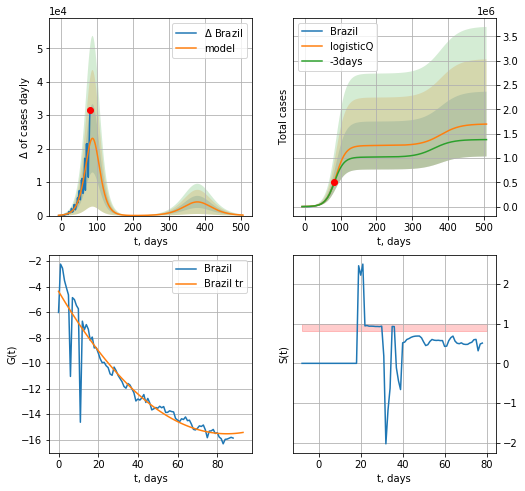

Brazil data at: 2020-05-30
+3 day model MAPE: 0.033964
model: logisticQ
coeffs: [ 1.25542624e+06  6.95546722e-06  8.72055995e+01 -1.04939864e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.392553
forecast at the end of period: +427 days
	 deltaDaycases: 147
	 total cases: 1696087 ± 665804
	 total death: 97867 ± 115253
trend coefficient of determination: 0.895211
 intercept_: -4.362168275345984
 coeffs_: [ 0.         -0.26366195  0.00155433]


In [248]:
x = forecastRRR('Brazil',dfBZ[6:],d1,70*7-dT,addpred=True,xcoef=koreaCoeffs)

In [249]:
#x = forecastRRR('Brazil',dfBZ[5:],d1,25*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

AS
           date   cases  active  death
101 2020-05-26  7139.0     476  103.0
102 2020-05-27  7150.0     468  103.0
103 2020-05-28  7165.0     482  103.0
104 2020-05-29  7184.0     476  103.0
105 2020-05-30  7195.0     478  103.0


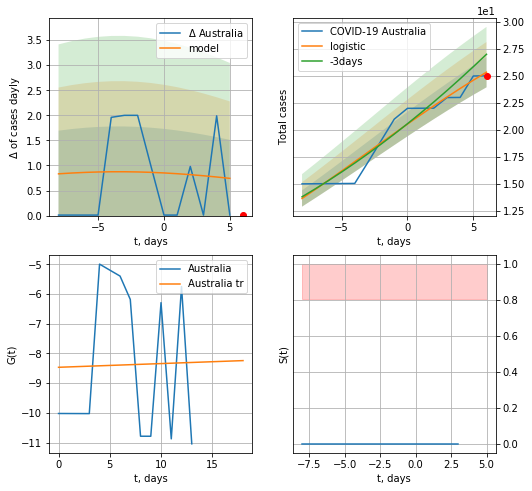

Australia data at: 2020-05-30
model: logistic
coeffs:  [35.98153551  0.09728993 -2.93367767]
rational stdev:  0.0551816162827012
forecast at the end of period: +0 days
	 deltaDaycases:  0
	 total cases:  25 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.000431
 intercept: -8.467221
 slope: 0.012491


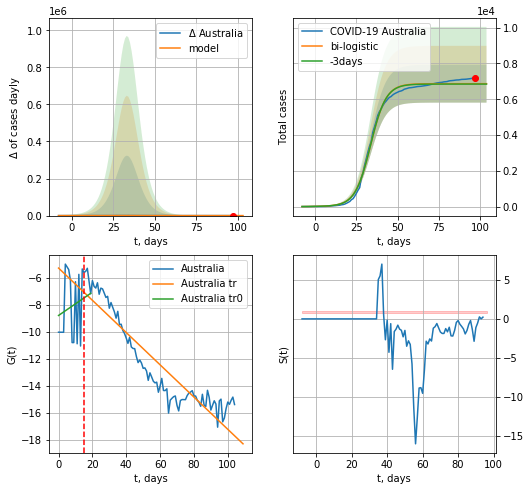

Australia data at: 2020-05-30
+3 day model MAPE: 0.0032371789365991752
model: bi-logistic
coeffs:  [6.83575967e+03 2.12717798e-01 3.36499460e+01] [35.98153551  0.09728993 -2.93367767]
rational stdev:  0.1536665403650266
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  6871 ± 1055
	 total death:  98 ± 45
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.022779
 intercept: -8.785888
 slope: 0.086030
trend coefficient of determination: 0.853062
 intercept: -5.284939
 slope: -0.119089


In [250]:
dfAS = read_df(pd.DataFrame(),"AS")
try:
    x = forecast('Australia',dfAS[:15],d1,9*7-dT,pMAPE=False)
    xx = forecast2('Australia',dfAS[:],d1,10*7-dT,x,vL=15,addpred=False,xcoef=[0.25/4,1.,1.8])
except:
    print("Exception occurs")

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


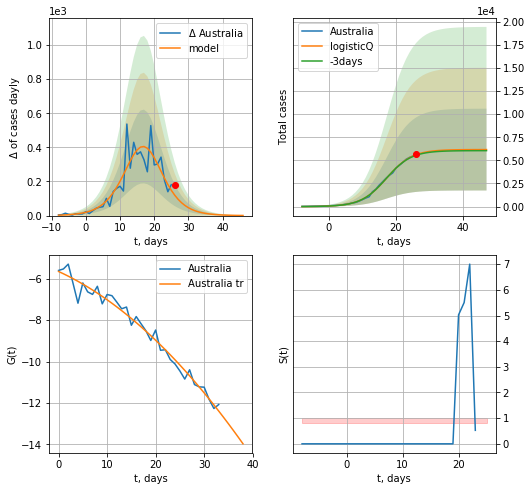

Australia data at: 2020-05-30
+3 day model MAPE: 0.012936
model: logisticQ
coeffs: [ 6.16825959e+03  4.63202537e-05  1.72354346e+01 -5.67168730e+03]
rational stdev: 0.716728
forecast at the end of period: +21 days
	 deltaDaycases: 0
	 total cases: 6165 ± 4419
	 total death: 88 ± 189
trend coefficient of determination: 0.975101
 intercept_: -5.657250296853678
 coeffs_: [ 0.         -0.10702975 -0.00294069]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


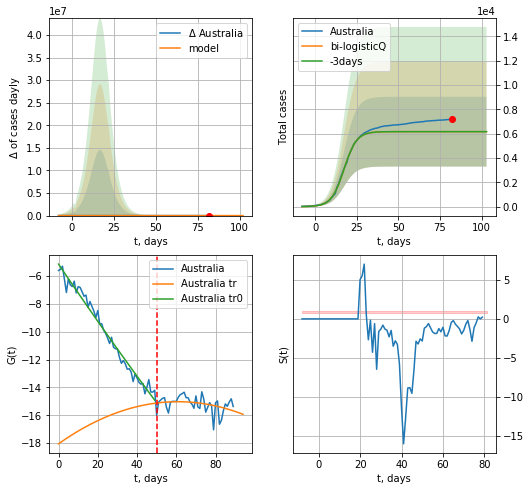

Australia data at: 2020-05-30
+3 day model MAPE: 0.000000
model: bi-logisticQ
coeffs: [-8.84346093 -1.80099638 22.52646829  2.33158157]
rational stdev: 0.465450
forecast at the end of period: +21 days
	 deltaDaycases: 0
	 total cases: 6168 ± 2871
	 total death: 88 ± 122
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.978786
 intercept_: -5.1508340728883
 coeffs_: [ 0.00000000e+00 -2.09278795e-01  2.06303704e-04]
trend coefficient of determination: 0.111191
 intercept_: -18.04392027157836
 coeffs_: [ 0.          0.09942559 -0.00081819]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


In [251]:
#axcoef = [koreaCoeffs[0],koreaCoeffs[1],koreaCoeffs[2],koreaCoeffs[3]]
vL = 50
x = forecastRRR('Australia',dfAS[15:vL],d1,12*7-dT,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Australia',dfAS[15:],d1,12*7-dT,x,addpred=False,xcoef=koreaCoeffs,vL=vL)

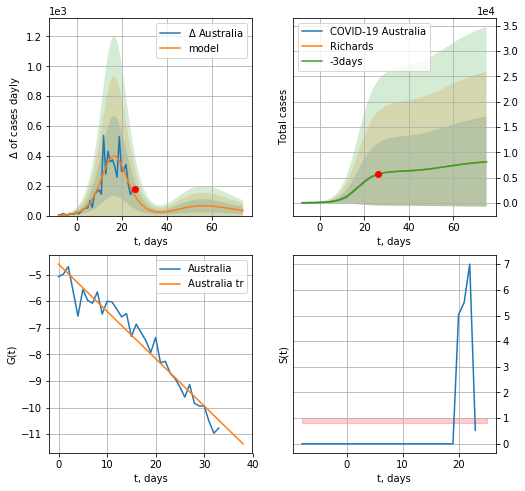

Australia data at: 2020-05-30
+3 day model MAPE: 0.004122
model: Richards
coeffs: [6.29844024e+03 2.85463605e-01 1.64695760e+01 8.48736456e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 1.092498
forecast at the end of period: +49 days
	 deltaDaycases: 33
	 total cases: 8131 ± 8884
	 total death: 116 ± 380
trend coefficient of determination: 0.945167
 intercept: -4.606318
 slope: -0.177832


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


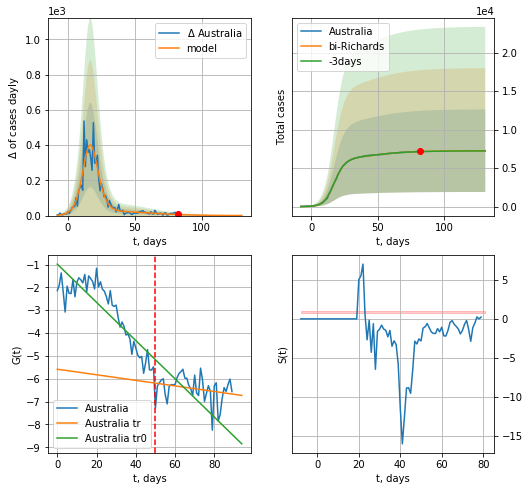

Australia data at: 2020-05-30
+3 day model MAPE: 0.001841
model: bi-Richards
coeffs: [ 9.74453257e+02  6.23633993e+00 -3.68106124e+01  9.18530522e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.738244
forecast at the end of period: +49 days
	 deltaDaycases: 0
	 total cases: 7265 ± 5363
	 total death: 104 ± 230
bi-Richards approximation splitting point: 50
trend coefficient of determination: 0.756735
 intercept: -0.982086
 slope: -0.083707
trend coefficient of determination: 0.060526
 intercept: -5.583013
 slope: -0.012210


In [252]:
x = forecastRR('Australia',dfAS[15:50],d1,16*7-dT,addpred=True,xcoef=RkoreaCoeffs)
xx = forecast2RR('Australia',dfAS[15:],d1,16*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=50)

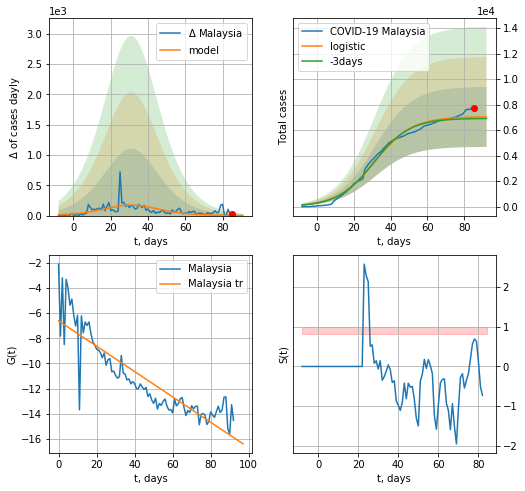

Malaysia data at: 2020-05-30
+3 day model MAPE: 0.0180875502863505
model: logistic
coeffs:  [7.05054962e+03 9.88319060e-02 3.14496303e+01]
rational stdev:  0.33422837679532286
forecast at the end of period: +7 days
	 deltaDaycases:  1
	 total cases:  7032 ± 2350
	 total death:  104 ± 104
trend coefficient of determination: 0.776162
 intercept: -6.617015
 slope: -0.100535


In [253]:
x = forecast('Malaysia',dfML[:],d1,10*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


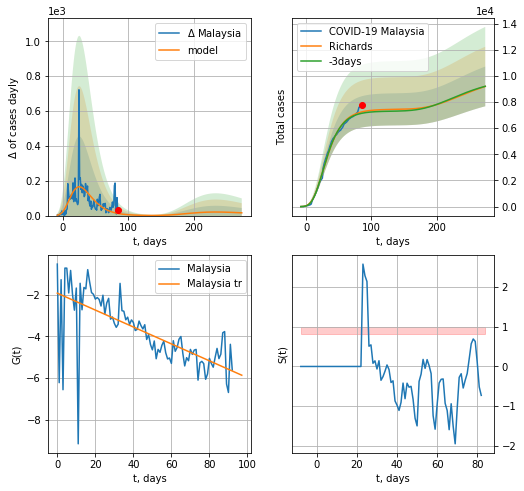

Malaysia data at: 2020-05-30
+3 day model MAPE: 0.014972
model: Richards
coeffs: [ 7.44837327e+03  8.66097052e+00 -5.60473306e+01  6.99180762e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.165100
forecast at the end of period: +189 days
	 deltaDaycases: 15
	 total cases: 9193 ± 1517
	 total death: 136 ± 67
trend coefficient of determination: 0.461088
 intercept: -1.919654
 slope: -0.040709


In [254]:
x = forecastRR('Malaysia',dfML[:],d1,36*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


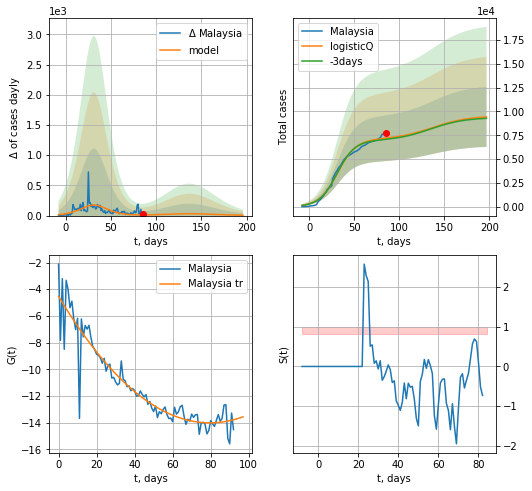

Malaysia data at: 2020-05-30
+3 day model MAPE: 0.017476
model: logisticQ
coeffs: [ 7.05046972e+03  3.51200429e-07  3.14501692e+01 -2.81301655e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.334287
forecast at the end of period: +112 days
	 deltaDaycases: 5
	 total cases: 9426 ± 3151
	 total death: 139 ± 139
trend coefficient of determination: 0.875385
 intercept_: -4.528738640317531
 coeffs_: [ 0.         -0.23823028  0.00149673]


In [255]:
x = forecastRRR('Malaysia',dfML[:],d1,25*7-dT,addpred=True,xcoef=koreaCoeffs)

ZL
          date    cases  active  death
88 2020-05-26  1504.30      21   21.0
89 2020-05-27  1504.35       8   22.0
90 2020-05-28  1504.40       1   22.0
91 2020-05-29  1504.00       1   22.0
92 2020-05-30  1504.00       1   22.0


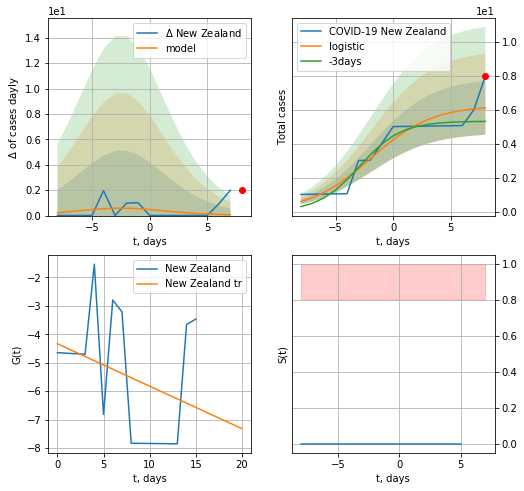

New Zealand data at: 2020-05-30
model: logistic
coeffs:  [ 6.26235961  0.37662733 -1.95315921]
rational stdev:  0.26005250078288755
forecast at the end of period: +0 days
	 deltaDaycases:  0
	 total cases:  6 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.103357
 intercept: -4.332661
 slope: -0.149156
Exception occurs


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: invalid value encountered in log


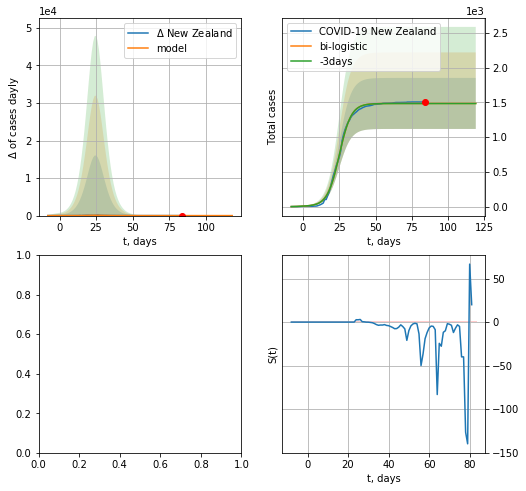

In [256]:
vL=17
dfZL = read_df(pd.DataFrame(),"ZL")
try:
    x = forecast('New Zealand',dfZL[:vL],d1,9*7-dT,pMAPE=False)
    xx = forecast2('New Zealand',dfZL[:],d1,14*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)#
except:
    print ("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:647: RuntimeWarning: invalid value encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

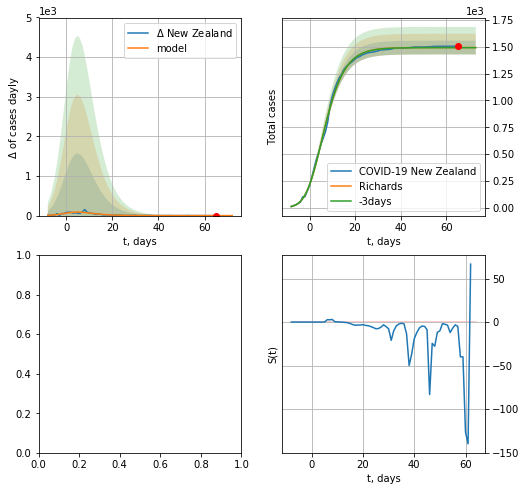

In [252]:
x = forecastRR('New Zealand',dfZL[18:],d1,10*7-dT,addpred=False,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:571: RuntimeWarning: invalid value encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

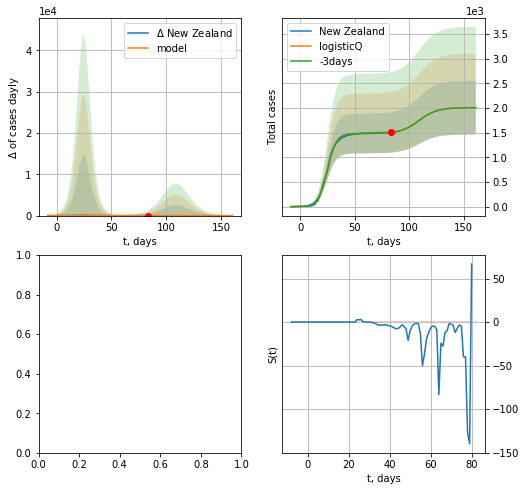

In [253]:
x = forecastRRR('New Zealand',dfZL[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

BR
          date    cases  active  death
88 2020-05-26  38059.0   22765  208.0
89 2020-05-27  38956.0   22819  214.0
90 2020-05-28  39858.0   22979  219.0
91 2020-05-29  40764.0   23150  224.0
92 2020-05-30  41658.0   23465  229.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


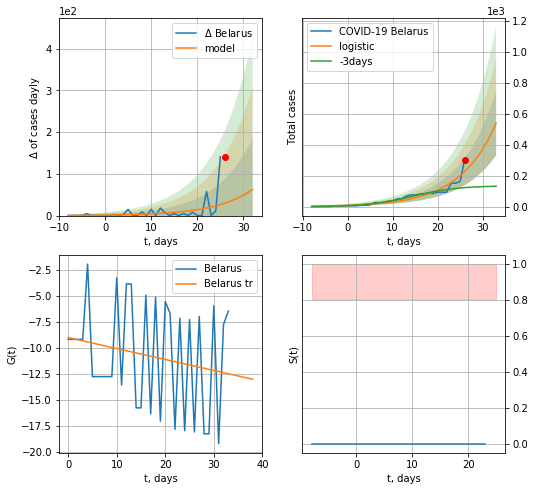

Belarus data at: 2020-05-30
+3 day model MAPE: 1.0426298586333318
model: logistic
coeffs:  [1.42197961e+06 1.24002034e-01 9.65329254e+01]
rational stdev:  0.38452901172178605
forecast at the end of period: +7 days
	 deltaDaycases:  62
	 total cases:  538 ± 207
	 total death:  2 ± 2
trend coefficient of determination: 0.039182
 intercept: -9.040329
 slope: -0.105417


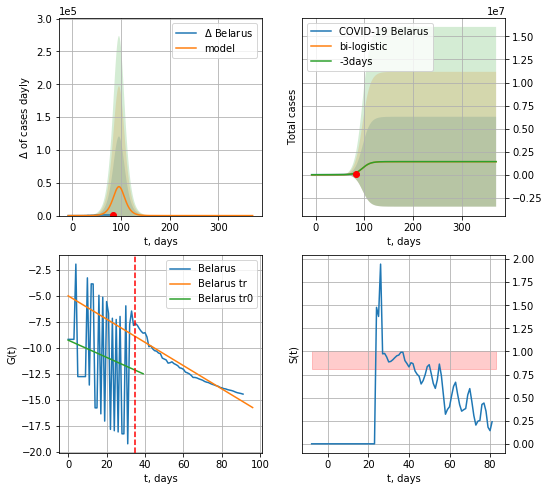

Belarus data at: 2020-05-30
+3 day model MAPE: 0.021230158951826898
model: bi-logistic
coeffs:  [-1.42679201e+04  7.73323905e+00 -1.69301818e+02] [1.42197961e+06 1.24002034e-01 9.65329254e+01]
rational stdev:  3.464165709167676
forecast at the end of period: +287 days
	 deltaDaycases:  0
	 total cases:  1407711 ± 4876546
	 total death:  7738 ± 80417
bi-logistic approximation splitting point: 35
trend0 coefficient of determination: 0.026128
 intercept: -9.289300
 slope: -0.082783
trend coefficient of determination: 0.933546
 intercept: -5.026221
 slope: -0.111910


In [258]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[:35],d1,7*10-dT)
xx = forecast2('Belarus',dfBR[:],d1,50*7-dT,x,addpred=False,xcoef=[0.25,1.,1.8],vL=35)

BR
          date    cases  active  death
88 2020-05-26  38059.0   22765  208.0
89 2020-05-27  38956.0   22819  214.0
90 2020-05-28  39858.0   22979  219.0
91 2020-05-29  40764.0   23150  224.0
92 2020-05-30  41658.0   23465  229.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: invalid value encountered in true_divide


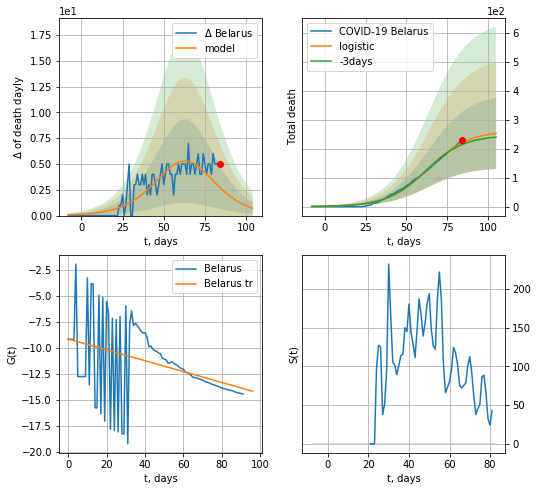

Belarus data at: 2020-05-30
+3 day model MAPE: 0.0318947545691121
model: logistic
coeffs:  [2.61496833e+02 8.07324890e-02 6.33925899e+01]
rational stdev:  0.4845533105114057
forecast at the end of period: +21 days
	 total death:  252 ± 122
trend coefficient of determination: 0.150273
 intercept: -9.168289
 slope: -0.052380


In [259]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[:],d1,12*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


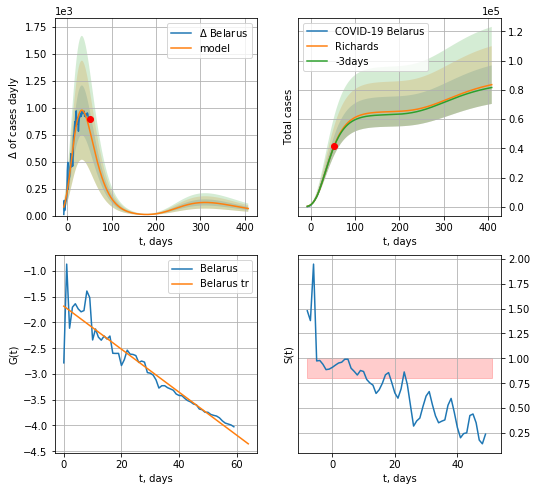

Belarus data at: 2020-05-30
+3 day model MAPE: 0.008587
model: Richards
coeffs: [ 6.52145420e+04  2.39223443e+00 -6.55043614e+01  1.72088349e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.157626
forecast at the end of period: +357 days
	 deltaDaycases: 65
	 total cases: 83563 ± 13171
	 total death: 459 ± 217
trend coefficient of determination: 0.902101
 intercept: -1.683403
 slope: -0.041756


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


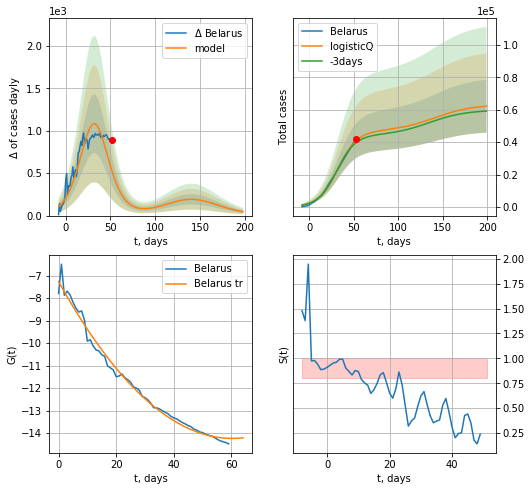

Belarus data at: 2020-05-30
+3 day model MAPE: 0.029509
model: logisticQ
coeffs: [ 4.67242714e+04  1.32106795e-06  3.22639518e+01 -6.97788417e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.262539
forecast at the end of period: +147 days
	 deltaDaycases: 45
	 total cases: 62238 ± 16339
	 total death: 342 ± 269
trend coefficient of determination: 0.987530
 intercept_: -7.25839787035367
 coeffs_: [ 0.         -0.23154718  0.00192042]


In [260]:
x = forecastRR('Belarus',dfBR[32:],d1,60*7-dT,addpred=True,xcoef=RkoreaCoeffs)
x = forecastRRR('Belarus',dfBR[32:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


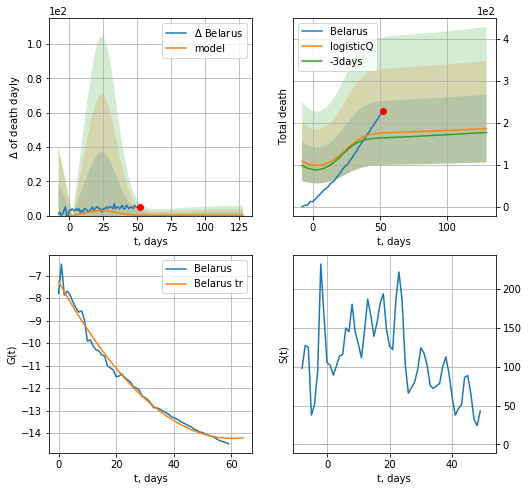

Belarus data at: 2020-05-30
+3 day model MAPE: 0.070824
model: logisticQ
coeffs: [ 1.48898447e+02  2.28818772e-03  6.93229157e+00 -1.19713275e+00]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.432073
forecast at the end of period: +77 days
	 total death: 186 ± 80
trend coefficient of determination: 0.987530
 intercept_: -7.25839787035367
 coeffs_: [ 0.         -0.23154718  0.00192042]


In [261]:
x = forecastRRR('Belarus',dfBR[32:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

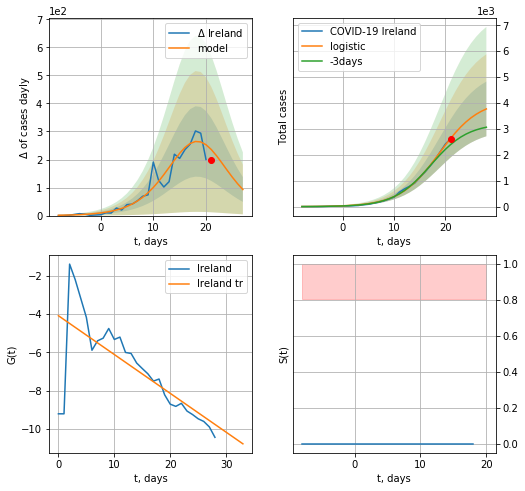

Ireland data at: 2020-05-30
+3 day model MAPE: 0.12282208812559416
model: logistic
coeffs:  [4.12730398e+03 2.56984382e-01 1.88154165e+01]
rational stdev:  0.27980533262906077
forecast at the end of period: +7 days
	 deltaDaycases:  92
	 total cases:  3771 ± 1055
	 total death:  249 ± 209
trend coefficient of determination: 0.521820
 intercept: -4.083344
 slope: -0.202899


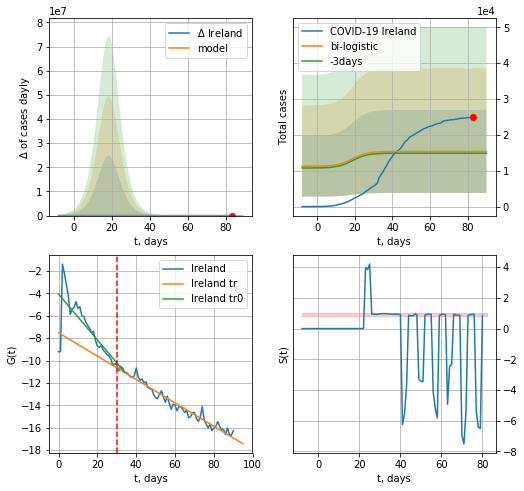

Ireland data at: 2020-05-30
+3 day model MAPE: 0.03326966637874496
model: bi-logistic
coeffs:  [ 9.00190627e+03 -8.51530820e+00  2.17789543e+02] [4.12730398e+03 2.56984382e-01 1.88154165e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.7527237605841824
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  15379 ± 11576
	 total death:  1018 ± 2298
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.551550
 intercept: -4.065434
 slope: -0.204818
trend coefficient of determination: 0.961164
 intercept: -7.520447
 slope: -0.104436


In [262]:
vL=30
x = forecast('Ireland',dfIR[:vL],d1,10*7-dT)
xx = forecast2('Ireland',dfIR[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


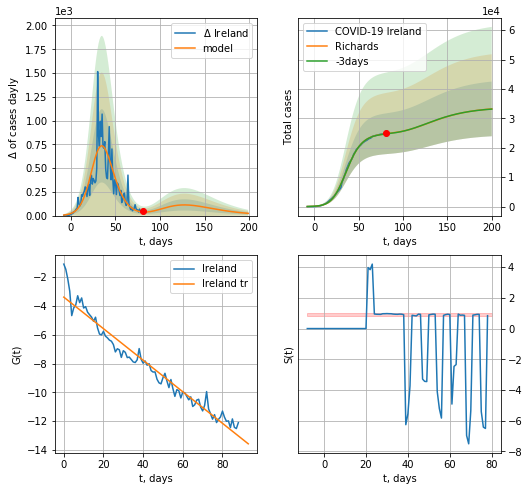

Ireland data at: 2020-05-30
+3 day model MAPE: 0.002331
model: Richards
coeffs: [2.48948760e+04 1.75035179e-01 2.99312558e+01 5.87648595e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.279779
forecast at the end of period: +119 days
	 deltaDaycases: 23
	 total cases: 33230 ± 9297
	 total death: 2200 ± 1846
trend coefficient of determination: 0.957005
 intercept: -3.392229
 slope: -0.109471


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


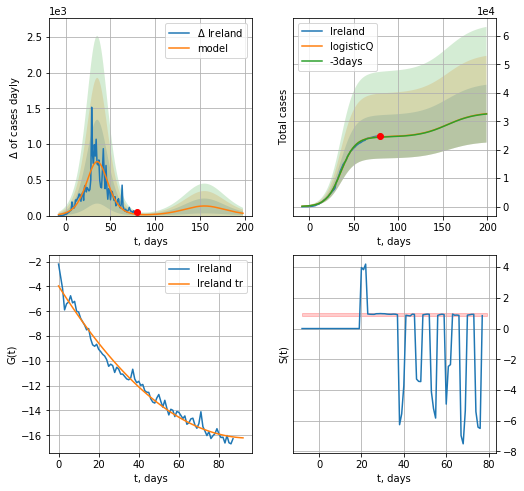

Ireland data at: 2020-05-30
+3 day model MAPE: 0.003925
model: logisticQ
coeffs: [ 2.45219387e+04  1.34489391e-06  3.56430358e+01 -9.14667908e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.311119
forecast at the end of period: +119 days
	 deltaDaycases: 32
	 total cases: 32660 ± 10161
	 total death: 2163 ± 2018
trend coefficient of determination: 0.983007
 intercept_: -3.9586461632264616
 coeffs_: [ 0.         -0.25751447  0.00135197]


In [264]:
x = forecastRR('Ireland',dfIR[2:],d1,26*7-dT,addpred=True,xcoef=RkoreaCoeffs)
x = forecastRRR('Ireland',dfIR[3:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs)

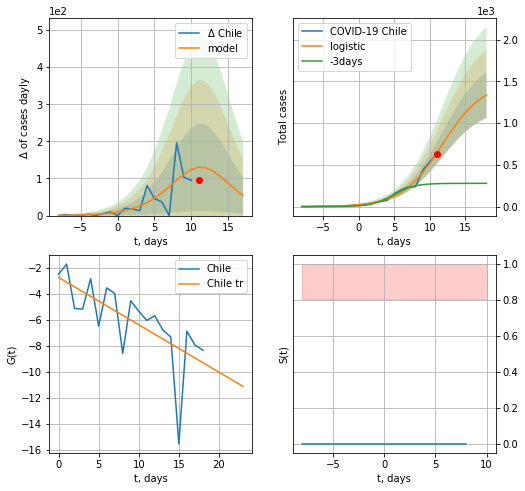

Chile data at: 2020-05-30
+3 day model MAPE: 1.792944169915196
model: logistic
coeffs:  [1.48337612e+03 3.52807696e-01 1.17654757e+01]
rational stdev:  0.20396784879776983
forecast at the end of period: +7 days
	 deltaDaycases:  54
	 total cases:  1335 ± 272
	 total death:  14 ± 8
trend coefficient of determination: 0.458420
 intercept: -2.731631
 slope: -0.364960


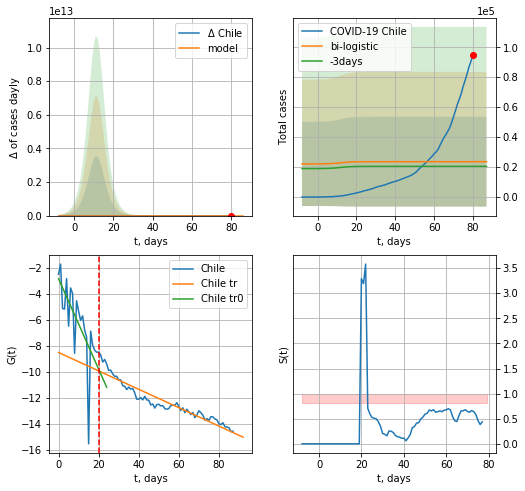

Chile data at: 2020-05-30
+3 day model MAPE: 0.15241207366218493
model: bi-logistic
coeffs:  [ 1.77050870e+04 -4.17594965e+00  1.14257117e+02] [1.48337612e+03 3.52807696e-01 1.17654757e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  1.270021672420725
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  23614 ± 29991
	 total death:  248 ± 944
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.470301
 intercept: -2.832141
 slope: -0.348208
trend coefficient of determination: 0.893596
 intercept: -8.517102
 slope: -0.070839


In [266]:
vL=20
x = forecast('Chile',dfCL[:vL],d1,7*10-dT)
xx = forecast2('Chile',dfCL[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


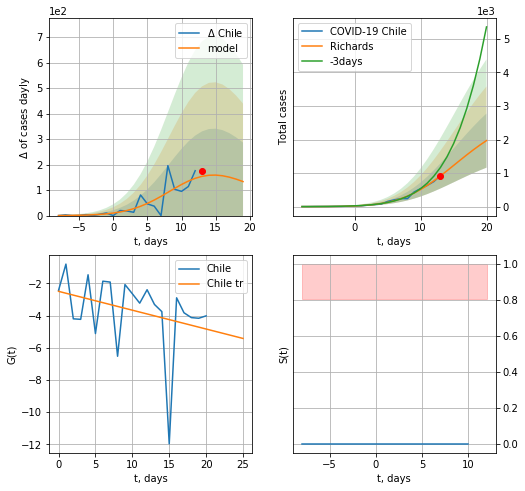

Chile data at: 2020-05-30
+3 day model MAPE: 0.280244
model: Richards
coeffs: [2.96603660e+03 4.92800903e-01 8.96517979e+00 3.45895404e-01]
rational stdev: 0.410204
forecast at the end of period: +7 days
	 deltaDaycases: 133
	 total cases: 1968 ± 807
	 total death: 20 ± 24
trend coefficient of determination: 0.098210
 intercept: -2.493671
 slope: -0.117098


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


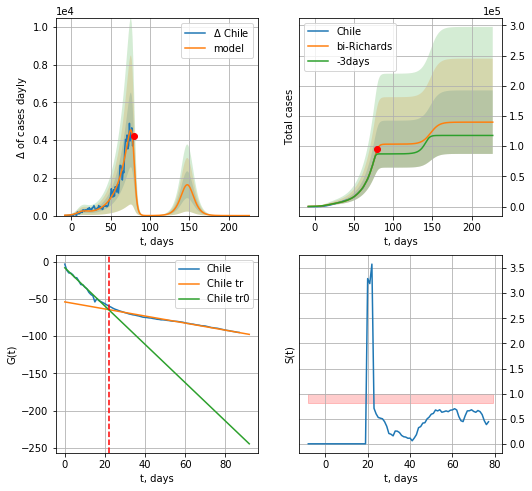

Chile data at: 2020-05-30
+3 day model MAPE: 0.117632
model: bi-Richards
coeffs: [1.00422555e+05 6.71621362e-02 8.01556827e+01 8.01808489e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.375969
forecast at the end of period: +147 days
	 deltaDaycases: 0
	 total cases: 139783 ± 52554
	 total death: 1469 ± 1656
bi-Richards approximation splitting point: 22
trend coefficient of determination: 0.977519
 intercept: -8.111717
 slope: -2.570646
trend coefficient of determination: 0.982096
 intercept: -53.940159
 slope: -0.474142


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


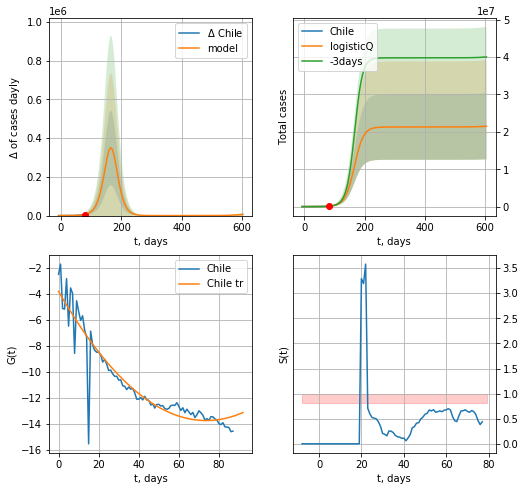

Chile data at: 2020-05-30
+3 day model MAPE: 0.025477
model: logisticQ
coeffs: [ 2.13026297e+07  3.20319107e-05  1.65602354e+02 -1.88374316e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.412108
forecast at the end of period: +525 days
	 deltaDaycases: 5896
	 total cases: 21502383 ± 8861300
	 total death: 225999 ± 279407
trend coefficient of determination: 0.875527
 intercept_: -3.8056228848128324
 coeffs_: [ 0.         -0.27026144  0.0018351 ]


In [267]:
vL = 22
x = forecastRR('Chile',dfCL[:vL],d1,10*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Chile',dfCL[:],d1,30*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
x = forecastRRR('Chile',dfCL[:],d1,84*7-dT,addpred=True,xcoef=koreaCoeffs)

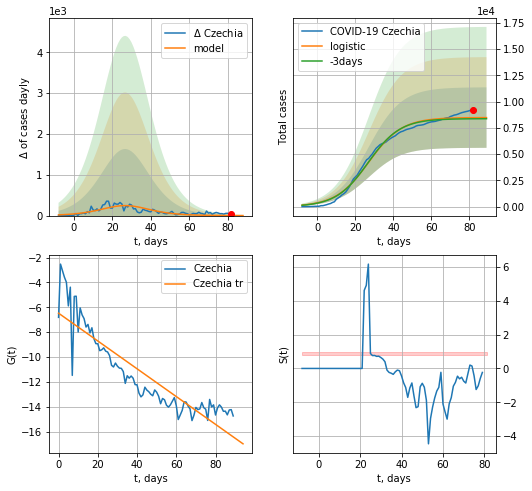

Czechia data at: 2020-05-30
+3 day model MAPE: 0.012601592608139764
model: logistic
coeffs:  [8.49029467e+03 1.15435593e-01 2.70972014e+01]
rational stdev:  0.33951173472719925
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  8483 ± 2880
	 total death:  293 ± 298
trend coefficient of determination: 0.805508
 intercept: -6.474488
 slope: -0.111686


In [268]:
x = forecast('Czechia',dfCH[:],d1,10*7-dT,shift=1.,addpred=False,xcoef=[0.25,1.,2.4])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


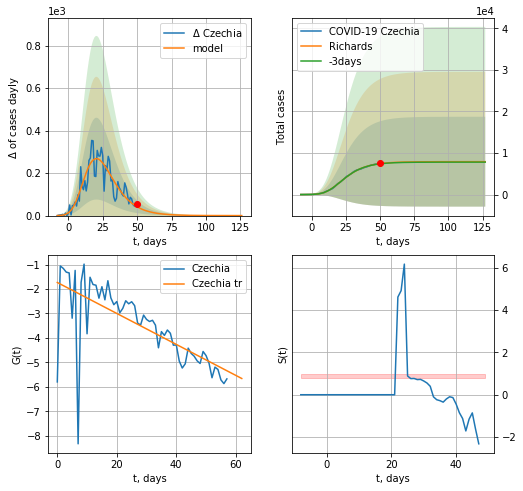

Czechia data at: 2020-05-30
+3 day model MAPE: 0.007369
model: Richards
coeffs: [ 7.90689533e+03  1.12645119e+00 -4.69210858e+00  8.53971991e-02]
rational stdev: 1.366945
forecast at the end of period: +77 days
	 deltaDaycases: 0
	 total cases: 7906 ± 10807
	 total death: 273 ± 1119
trend coefficient of determination: 0.470375
 intercept: -1.735202
 slope: -0.063324


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


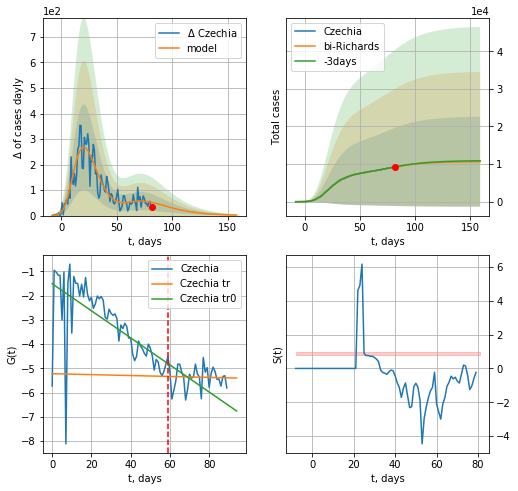

Czechia data at: 2020-05-30
+3 day model MAPE: 0.002688
model: bi-Richards
coeffs: [2.76921451e+03 2.29640416e+00 2.44902172e+00 2.26004453e-02]
rational stdev: 1.122604
forecast at the end of period: +77 days
	 deltaDaycases: 1
	 total cases: 10640 ± 11944
	 total death: 367 ± 1235
bi-Richards approximation splitting point: 59
trend coefficient of determination: 0.410805
 intercept: -1.509073
 slope: -0.055889
trend coefficient of determination: 0.001386
 intercept: -5.223703
 slope: -0.001894


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


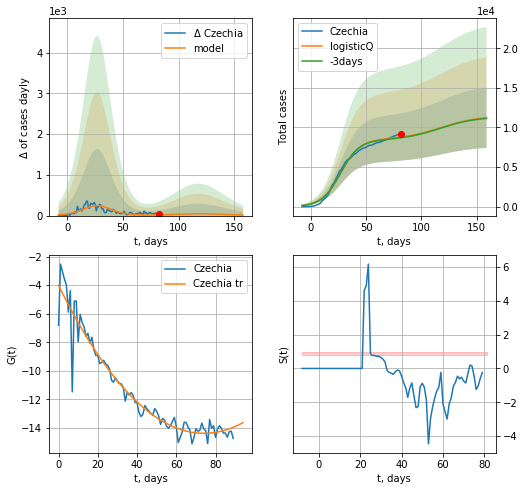

Czechia data at: 2020-05-30
+3 day model MAPE: 0.011563
model: logisticQ
coeffs: [ 8.49027336e+03  3.66090352e-07  2.70979198e+01 -3.15193573e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.339572
forecast at the end of period: +77 days
	 deltaDaycases: 13
	 total cases: 11241 ± 3817
	 total death: 388 ± 395
trend coefficient of determination: 0.929525
 intercept_: -4.013417678889006
 coeffs_: [ 0.         -0.27949532  0.00188555]


In [269]:
vL= 59
x = forecastRR('Czechia',dfCH[:vL],d1,20*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Czechia',dfCH[:],d1,20*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
x = forecastRRR('Czechia',dfCH[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

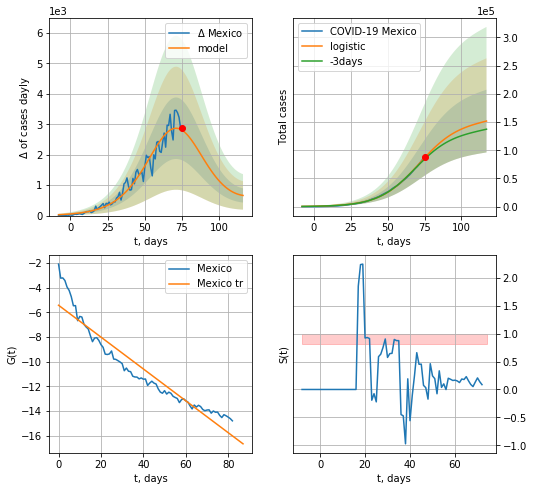

Mexico data at: 2020-05-30
+3 day model MAPE: 0.03132804173054751
model: logistic
coeffs:  [1.51664795e+05 7.53848681e-02 7.13536008e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.36680734662680087
forecast at the end of period: +42 days
	 deltaDaycases:  661
	 total cases:  151730 ± 55655
	 total death:  16955 ± 18657
trend coefficient of determination: 0.907613
 intercept: -5.415085
 slope: -0.129196


In [270]:
x = forecast('Mexico',dfMX[:],d1,15*7-dT,addpred=True,xcoef=[.25,1.,2.])#

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


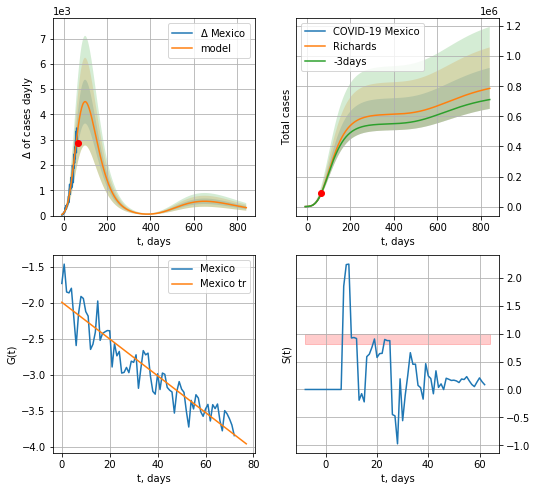

Mexico data at: 2020-05-30
+3 day model MAPE: 0.008486
model: Richards
coeffs: [ 6.14875618e+05  5.36768379e-01 -6.16166238e+01  3.78071259e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.173304
forecast at the end of period: +777 days
	 deltaDaycases: 313
	 total cases: 786087 ± 136232
	 total death: 87841 ± 45669
trend coefficient of determination: 0.876687
 intercept: -1.992759
 slope: -0.025501


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


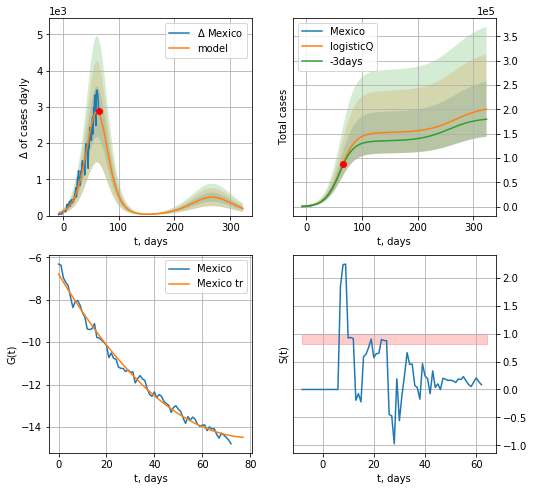

Mexico data at: 2020-05-30
+3 day model MAPE: 0.031347
model: logisticQ
coeffs: [ 1.52175311e+05  3.14602848e-06  6.14409531e+01 -2.38728321e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.281534
forecast at the end of period: +259 days
	 deltaDaycases: 197
	 total cases: 200322 ± 56397
	 total death: 22384 ± 18905
trend coefficient of determination: 0.991019
 intercept_: -6.789243229937135
 coeffs_: [ 0.         -0.19034437  0.00117365]


In [271]:
x = forecastRR('Mexico',dfMX[10:],d1,120*7-dT,addpred=True,xcoef=RkoreaCoeffs)#
x = forecastRRR('Mexico',dfMX[10:],d1,46*7-dT,addpred=True,xcoef=koreaCoeffs)#

LT
          date   cases  active  death     tests
78 2020-05-26  1647.0     389   66.0  281232.0
79 2020-05-27  1656.0     395   68.0  287982.0
80 2020-05-28  1662.0     370   68.0  294091.0
81 2020-05-29  1670.0     362   70.0  299428.0
82 2020-05-30  1670.0     371   70.0       NaN
Exception occurs


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


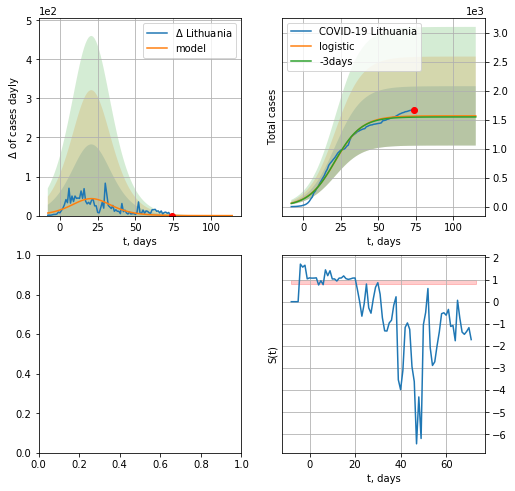

In [272]:
vL = 17
dfLT = read_df(pd.DataFrame(),"LT")
try:
    x = forecast('Lithuania',dfLT[:],d1,6*7-1)
except:
    print("Exception occurs")
#xx = forecast2('Lithuania',dfLT[:],d1,8*7-1,x,shift=1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)

In [58]:
#dfLT = read_df(pd.DataFrame(),"LT")
#plt.plot(range(len(dfLT[3:])),dfLT[3:].cases/dfLT[3:].tests)

#plt.grid()#

In [59]:
#np.diff(dfLT["cases"])

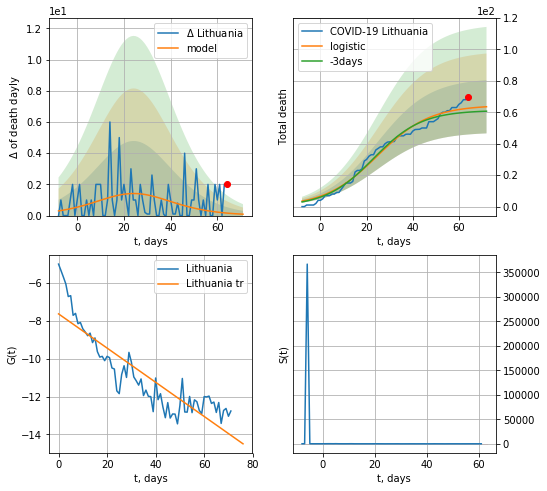

Lithuania data at: 2020-05-29
+3 day model MAPE: 0.04193809613451784
model: logistic
coeffs:  [64.4965201   0.08774727 24.65622221]
rational stdev:  0.2665391132368716
forecast at the end of period: +8 days
	 total death:  63 ± 16
trend coefficient of determination: 0.777550
 intercept: -7.632159
 slope: -0.090301


In [375]:
x = forecast('Lithuania',dfLT[9:],d1,7*10-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


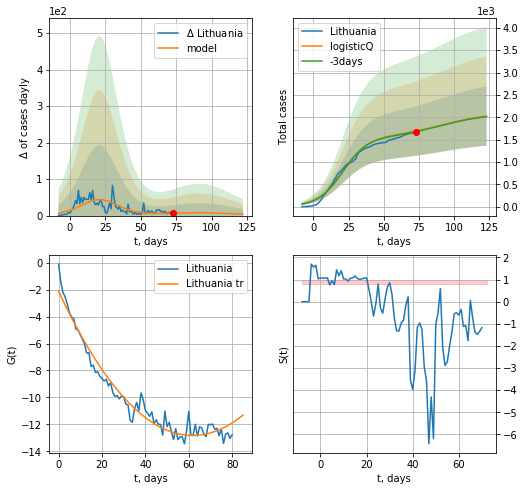

Lithuania data at: 2020-05-29
+3 day model MAPE: 0.008196
model: logisticQ
coeffs: [ 1.55800339e+03  4.07809058e-07  2.11484239e+01 -2.74736799e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.327818
forecast at the end of period: +50 days
	 deltaDaycases: 4
	 total cases: 2027 ± 664
	 total death: 82 ± 80
trend coefficient of determination: 0.959289
 intercept_: -2.1109580845104983
 coeffs_: [ 0.         -0.34667986  0.00280551]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


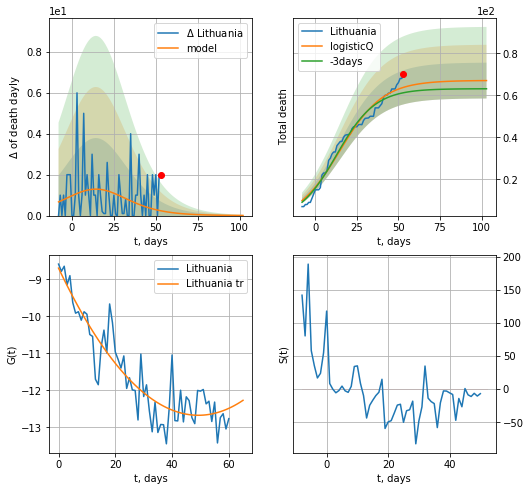

Lithuania data at: 2020-05-29
+3 day model MAPE: 0.042853
model: logisticQ
coeffs: [ 6.70593827e+01  4.91483181e-07  1.47181348e+01 -1.56976095e+05]
rational stdev: 0.127134
forecast at the end of period: +50 days
	 total death: 66 ± 8
trend coefficient of determination: 0.829699
 intercept_: -8.698625236805668
 coeffs_: [ 0.         -0.16117592  0.00163509]


In [376]:
#x = forecast('Lithuania',dfLT[10-4:],d1,6*7-1,cases='active')
x = forecastRRR('Lithuania',dfLT[:],d1,16*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Lithuania',dfLT[20:],d1,16*7-dT,addpred=False,xcoef=koreaCoeffs,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


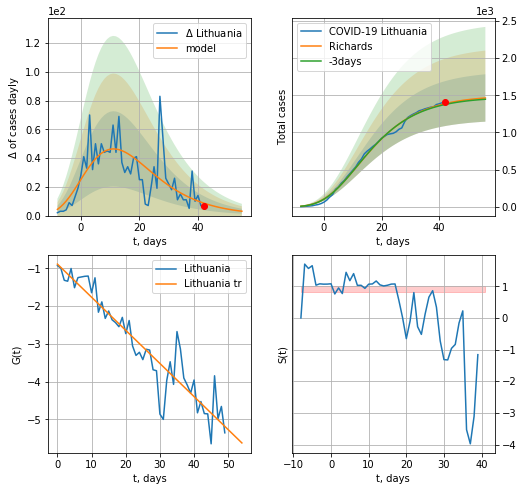

Lithuania data at: 2020-05-29
+3 day model MAPE: 0.008864
model: Richards
coeffs: [ 1.49807054e+03  1.16493346e+01 -4.66048651e+01  7.25754681e-03]
rational stdev: 0.217634
forecast at the end of period: +14 days
	 deltaDaycases: 3
	 total cases: 1463 ± 318
	 total death: 59 ± 38
trend coefficient of determination: 0.880614
 intercept: -0.888606
 slope: -0.087673


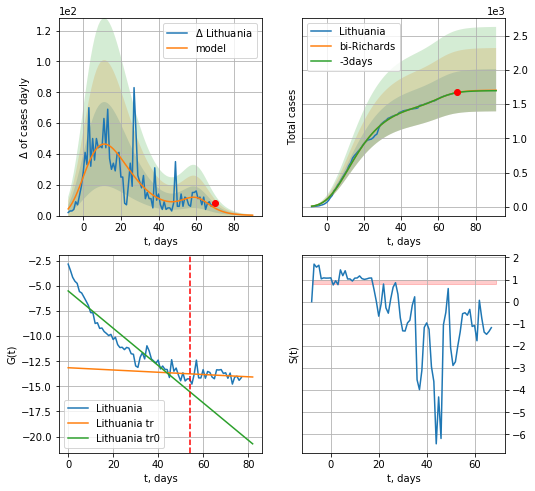

Lithuania data at: 2020-05-29
+3 day model MAPE: 0.001626
model: bi-Richards
coeffs: [2.05453971e+02 1.69915720e-01 6.09352076e+01 1.18379097e+00]
rational stdev: 0.181124
forecast at the end of period: +21 days
	 deltaDaycases: 0
	 total cases: 1701 ± 308
	 total death: 69 ± 37
bi-Richards approximation splitting point: 54
trend coefficient of determination: 0.883064
 intercept: -5.493402
 slope: -0.185798
trend coefficient of determination: 0.022882
 intercept: -13.147165
 slope: -0.011263


In [390]:
vL = 54
x = forecastRR('Lithuania',dfLT[3:vL],d1,11*7-1-dT,addpred=False,xcoef=RkoreaCoeffs)#
xx = forecast2RR('Lithuania',dfLT[3:],d1,12*7-1-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)#
#xx = forecast2R('Lithuania',dfLT[:],d1,2*7-1,x,shift=1.0,addpred=True,xcoef=[0.25,1.,1.5])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


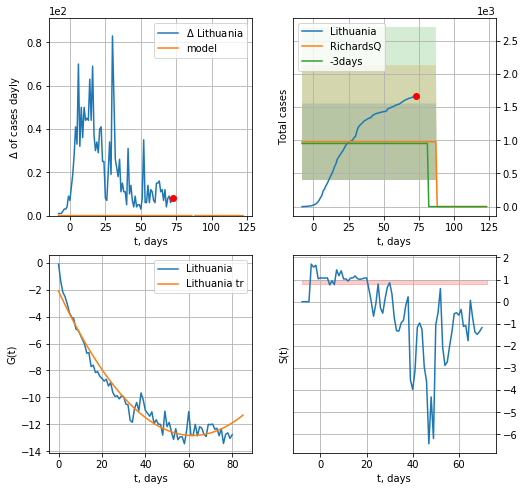

Lithuania data at: 2020-05-29
+3 day model MAPE: 0.027268
model: RichardsQ
coeffs: [ 9.78623171e+02 -2.11441175e+00 -1.13410616e+02  8.75913870e+01
  2.87289529e-01]
rational stdev: 0.590189
forecast at the end of period: +50 days
	 deltaDaycases: 0
	 total cases: 0 ± 0
	 total death: 0 ± 0
trend coefficient of determination: 0.959289
 intercept_: -2.1109580845104983
 coeffs_: [ 0.         -0.34667986  0.00280551]


In [383]:
x = forecastQR('Lithuania',dfLT[:],d1,16*7-dT,addpred=False,xcoef=[0.35,.52,4.,1.,1.])

LX
          date   cases  active  death
80 2020-05-26  3995.0     102  110.0
81 2020-05-27  4001.0     100  110.0
82 2020-05-28  4008.0      95  110.0
83 2020-05-29  4012.0      87  110.0
84 2020-05-30  4016.0      91  110.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


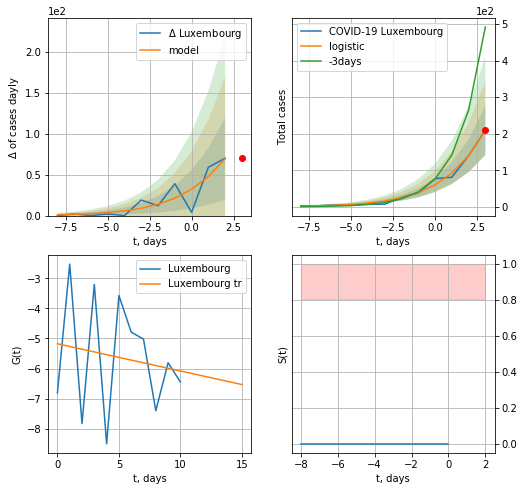

Luxembourg data at: 2020-05-30
model: logistic
coeffs:  [1.56298312e+03 4.51684200e-01 7.13428385e+00]
rational stdev:  0.3215238047871676
forecast at the end of period: +0 days
	 deltaDaycases:  69
	 total cases:  209 ± 67
	 total death:  5 ± 4
trend coefficient of determination: 0.022967
 intercept: -5.176630
 slope: -0.090347


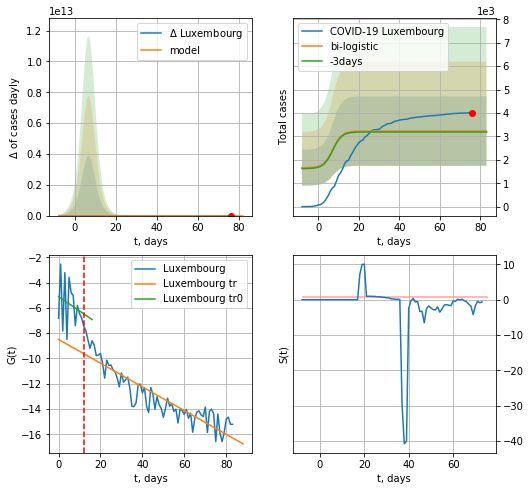

Luxembourg data at: 2020-05-30
+3 day model MAPE: 0.012508716592590561
model: bi-logistic
coeffs:  [1480.07678819   -6.03227161  231.1984603 ] [1.56298312e+03 4.51684200e-01 7.13428385e+00]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.4592265281210644
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  3228 ± 1482
	 total death:  88 ± 121
bi-logistic approximation splitting point: 12
trend0 coefficient of determination: 0.045986
 intercept: -5.098250
 slope: -0.113861
trend coefficient of determination: 0.822391
 intercept: -8.494439
 slope: -0.093881


In [273]:
dfLX = read_df(pd.DataFrame(),"LX")
x = forecast("Luxembourg",dfLX[:12],d1,9*7-dT,pMAPE=False)
xx = forecast2("Luxembourg",dfLX[:],d1,10*7-dT,x,vL=12,addpred=True,xcoef=[0.25/2,1.,2.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


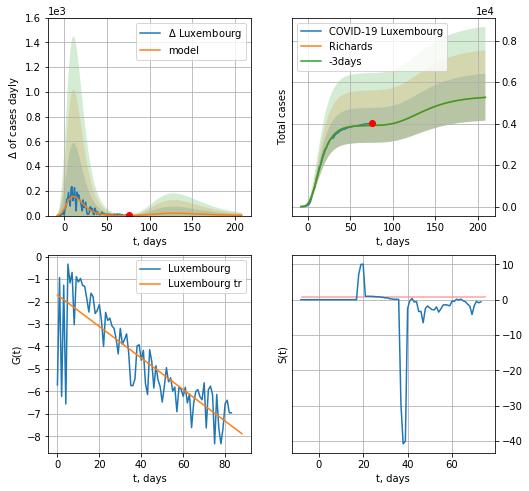

Luxembourg data at: 2020-05-30
+3 day model MAPE: 0.002539
model: Richards
coeffs: [ 3.92084508e+03  2.06181593e+01 -3.75305280e+01  5.21865162e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.214401
forecast at the end of period: +133 days
	 deltaDaycases: 2
	 total cases: 5269 ± 1129
	 total death: 144 ± 92
trend coefficient of determination: 0.686548
 intercept: -1.706402
 slope: -0.070212


In [274]:
x = forecastRR("Luxembourg",dfLX[:],d1,28*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


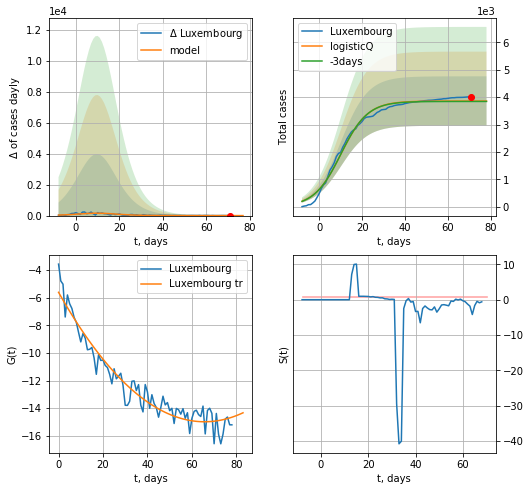

Luxembourg data at: 2020-05-30
+3 day model MAPE: 0.003660
model: logisticQ
coeffs: [ 3.85937062e+03  6.29090152e-07  1.01616826e+01 -2.53407302e+05]
rational stdev: 0.233742
forecast at the end of period: +7 days
	 deltaDaycases: 0
	 total cases: 3859 ± 902
	 total death: 105 ± 73
trend coefficient of determination: 0.930410
 intercept_: -5.61422685264106
 coeffs_: [ 0.         -0.28531299  0.00217117]


In [275]:
x = forecastRRR("Luxembourg",dfLX[5:],d1,10*7-dT,addpred=False,xcoef=koreaCoeffs)

ED
          date    cases   active   death
87 2020-05-26  37729.0  16149.0  3203.0
88 2020-05-27  38103.0  16403.0  3275.0
89 2020-05-28  38471.0  16733.0  3313.0
90 2020-05-29  38571.0  16047.0  3334.0
91 2020-05-30  38571.0  16047.0  3334.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: invalid value encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

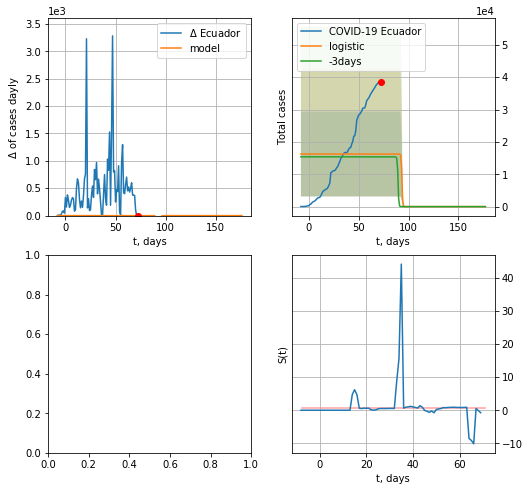

In [276]:
dfED = read_df(pd.DataFrame(),"ED")
x = forecast("Ecuador",dfED[11:],d1,24*7-dT)
#xx = forecast2(c,adf[:],d1,4*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:647: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

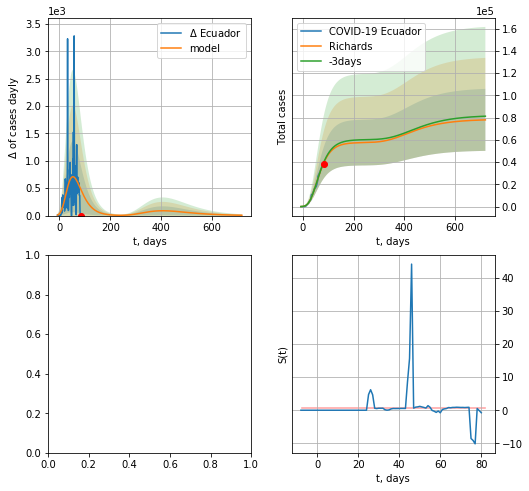

In [277]:
x = forecastRR("Ecuador",dfED[:],d1,100*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


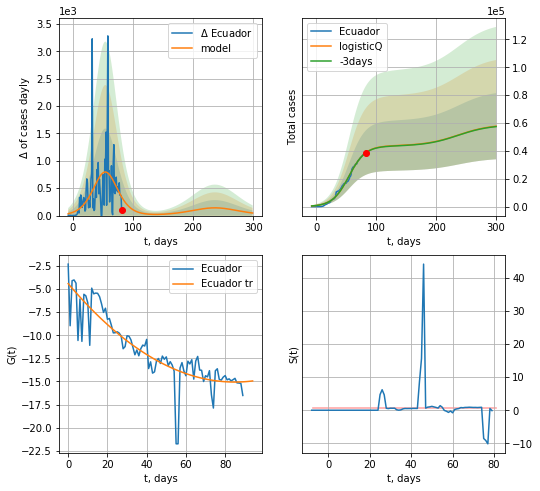

Ecuador data at: 2020-05-29
+3 day model MAPE: 0.003132
model: logisticQ
coeffs: [ 4.36348716e+04  8.34512392e-07  5.42949631e+01 -8.73169614e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.411738
forecast at the end of period: +218 days
	 deltaDaycases: 46
	 total cases: 57709 ± 23761
	 total death: 4988 ± 6161
trend coefficient of determination: 0.756730
 intercept_: -4.411121775465512
 coeffs_: [ 0.         -0.25086309  0.00147681]


In [276]:
x = forecastRRR("Ecuador",dfED[:],d1,40*7-dT,addpred=True,xcoef=koreaCoeffs)

FI
          date   cases  active  death
91 2020-05-26  6628.0    1216  312.0
92 2020-05-27  6692.0    1279  313.0
93 2020-05-28  6743.0     930  313.0
94 2020-05-29  6776.0     962  314.0
95 2020-05-30  6826.0    1010  316.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


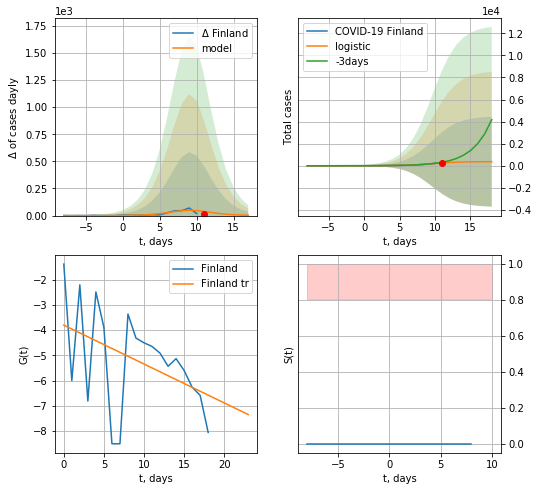

Finland data at: 2020-05-30
+3 day model MAPE: 0.3536794792474036
model: logistic
coeffs:  [373.20900186   0.53490302   9.59276199]
rational stdev:  11.028448708024662
forecast at the end of period: +7 days
	 deltaDaycases:  2
	 total cases:  369 ± 4070
	 total death:  17 ± 562
trend coefficient of determination: 0.182614
 intercept: -3.802910
 slope: -0.153962


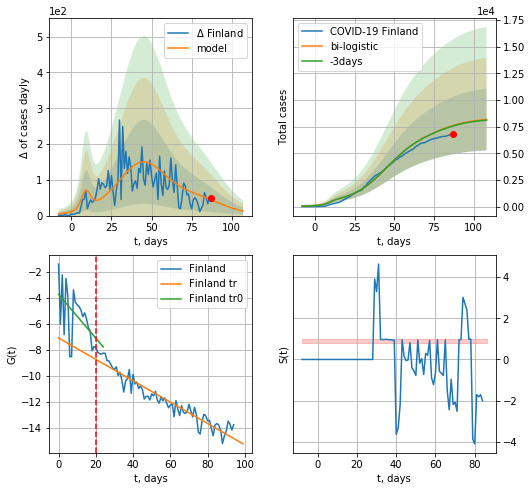

Finland data at: 2020-05-30
+3 day model MAPE: 0.005903663174336485
model: bi-logistic
coeffs:  [6.35822723e+03 9.12425690e-02 4.49121894e+01] [373.20900186   0.53490302   9.59276199]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.35377549397413877
forecast at the end of period: +21 days
	 deltaDaycases:  12
	 total cases:  8177 ± 2893
	 total death:  378 ± 401
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.234981
 intercept: -3.717136
 slope: -0.168257
trend coefficient of determination: 0.914135
 intercept: -7.067446
 slope: -0.082207


In [279]:
dfFI = read_df(pd.DataFrame(),"FI")
x = forecast("Finland",dfFI[:20],d1,7*10-dT)
xx = forecast2("Finland",dfFI[:],d1,12*7-dT,x,vL=20,addpred=True,xcoef=[0.25,1.,1.8])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


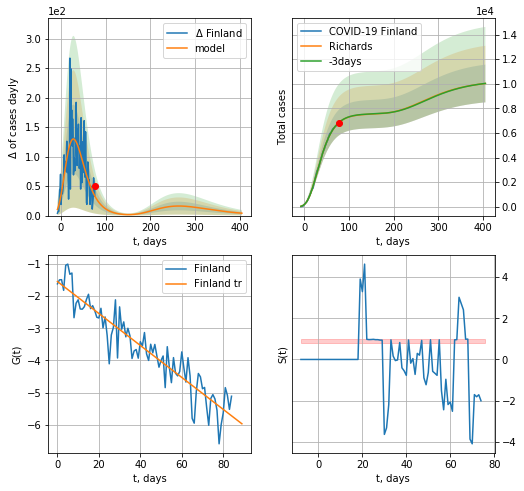

Finland data at: 2020-05-30
+3 day model MAPE: 0.001236
model: Richards
coeffs: [ 7.55268225e+03  2.15156859e+00 -5.25319355e+01  2.19754127e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.152925
forecast at the end of period: +329 days
	 deltaDaycases: 4
	 total cases: 10026 ± 1533
	 total death: 464 ± 212
trend coefficient of determination: 0.875223
 intercept: -1.551099
 slope: -0.049596


In [280]:
x = forecastRR("Finland",dfFI[10:],d1,56*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


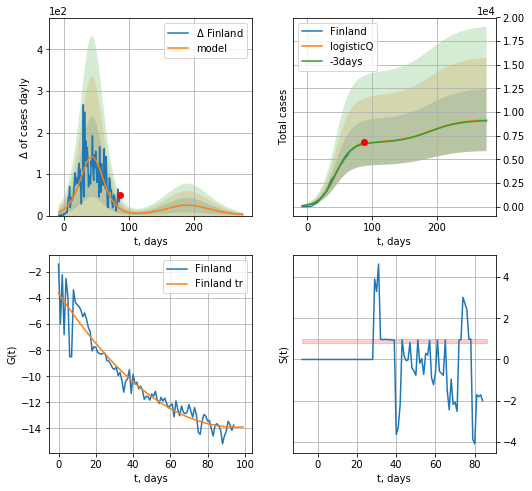

Finland data at: 2020-05-30
+3 day model MAPE: 0.007378
model: logisticQ
coeffs: [ 6.80950739e+03  6.05852113e-07  4.35843847e+01 -1.37298284e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.358355
forecast at the end of period: +189 days
	 deltaDaycases: 2
	 total cases: 9157 ± 3281
	 total death: 423 ± 454
trend coefficient of determination: 0.918135
 intercept_: -3.6018570158361047
 coeffs_: [ 0.         -0.21573145  0.0011291 ]


In [281]:
x = forecastRRR("Finland",dfFI[:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

BL
          date  cases  active  death
77 2020-05-26   2460  1415.0  133.0
78 2020-05-27   2477  1378.0  134.0
79 2020-05-28   2485  1333.0  136.0
80 2020-05-29   2499  1296.0  139.0
81 2020-05-30   2513  1299.0  140.0


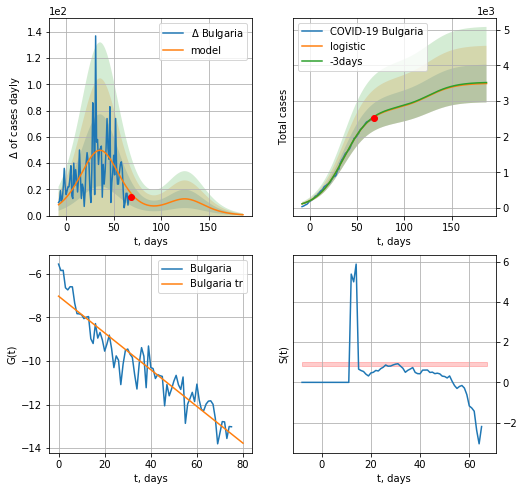

Bulgaria data at: 2020-05-30
+3 day model MAPE: 0.004703997728398487
model: logistic
coeffs:  [2.80192952e+03 7.09776811e-02 3.59827776e+01]
scenario coeffs:  [0.25, 1.0, 3.5]
rational stdev:  0.15157432218914565
forecast at the end of period: +119 days
	 deltaDaycases:  0
	 total cases:  3493 ± 529
	 total death:  194 ± 88
trend coefficient of determination: 0.890840
 intercept: -7.030816
 slope: -0.084268


In [282]:
dfBL = read_df(pd.DataFrame(),"BL").fillna(0)
try:
    x = forecast('Bulgaria',dfBL[5:],d1,26*7-dT,shift=1.0,addpred=True,xcoef=[0.25,1.,3.5])
except:
    print("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


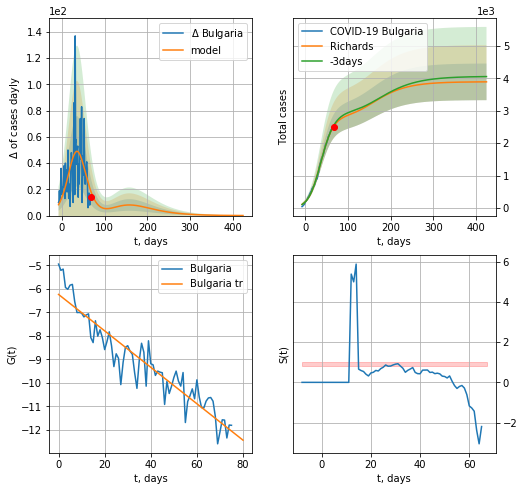

Bulgaria data at: 2020-05-30
+3 day model MAPE: 0.012168
model: Richards
coeffs: [2.86159527e+03 7.72241437e-02 3.30387896e+01 8.44338616e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.145271
forecast at the end of period: +357 days
	 deltaDaycases: 0
	 total cases: 3895 ± 565
	 total death: 217 ± 94
trend coefficient of determination: 0.882057
 intercept: -6.238080
 slope: -0.077440


In [283]:
x = forecastRR('Bulgaria',dfBL[5:],d1,60*7-dT,shift=1.0,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


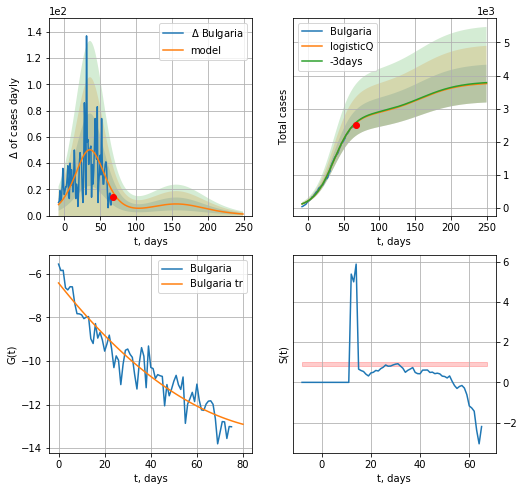

Bulgaria data at: 2020-05-30
+3 day model MAPE: 0.004586
model: logisticQ
coeffs: [ 2.79894852e+03  3.75072392e-06  3.59546129e+01 -1.89152398e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.151894
forecast at the end of period: +182 days
	 deltaDaycases: 1
	 total cases: 3756 ± 570
	 total death: 209 ± 95
trend coefficient of determination: 0.911542
 intercept_: -6.425861061056347
 coeffs_: [ 0.         -0.13332582  0.00065415]


In [284]:
x = forecastRRR('Bulgaria',dfBL[5:],d1,35*7-dT,shift=1.0,addpred=True,xcoef=koreaCoeffs)

TH
          date   cases  active  death
89 2020-05-26  3054.0    66.0   57.0
90 2020-05-27  3065.0    63.0   57.0
91 2020-05-28  3076.0    74.0   57.0
92 2020-05-29  3077.0    59.0   57.0
93 2020-05-30  3081.0    61.0   57.0


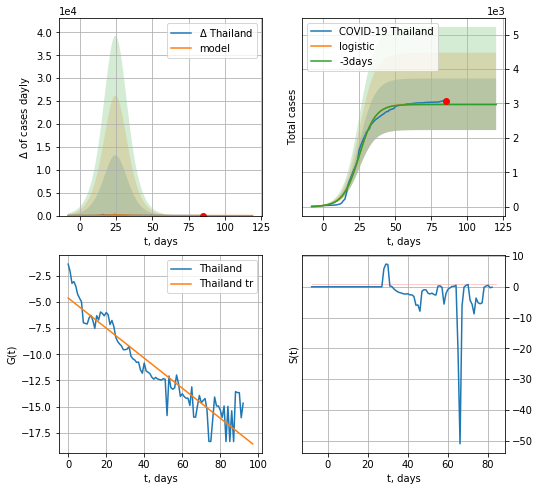

Thailand data at: 2020-05-30
+3 day model MAPE: 0.0029120134929966185
model: logistic
coeffs:  [2.97765064e+03 1.79080374e-01 2.50283102e+01]
rational stdev:  0.2518233258203402
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  2977 ± 749
	 total death:  55 ± 41
trend coefficient of determination: 0.880128
 intercept: -4.626370
 slope: -0.143588


In [285]:
dfTH = read_df(pd.DataFrame(),"TH")
dfTH = dfTH.fillna(0)
try:
    x = forecast("Thailand",dfTH[:],d1,14*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])
except:
    print("Exception occurs")
#xx = forecast2("Thailand",dfTH[:],d1,8*7-dT,x,vL=20,addpred=True,xcoef=[0.25,1.,1.8])

In [286]:
#x = forecastRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


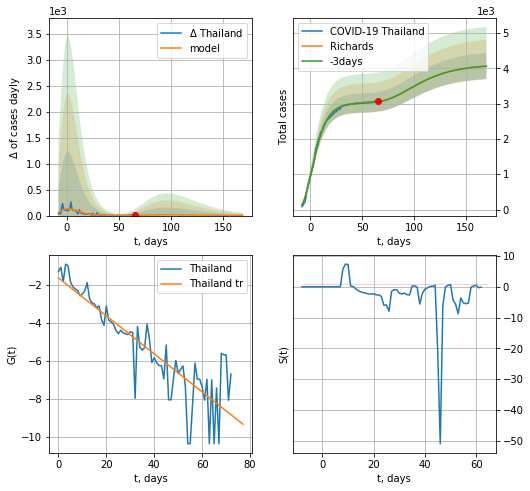

Thailand data at: 2020-05-30
+3 day model MAPE: 0.000582
model: Richards
coeffs: [ 3.02041882e+03  1.71101050e+01 -3.97819142e+01  7.01420052e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.090951
forecast at the end of period: +105 days
	 deltaDaycases: 2
	 total cases: 4062 ± 369
	 total death: 75 ± 20
trend coefficient of determination: 0.764227
 intercept: -1.634502
 slope: -0.100123


In [287]:
x = forecastRR("Thailand",dfTH[20:],d1,24*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


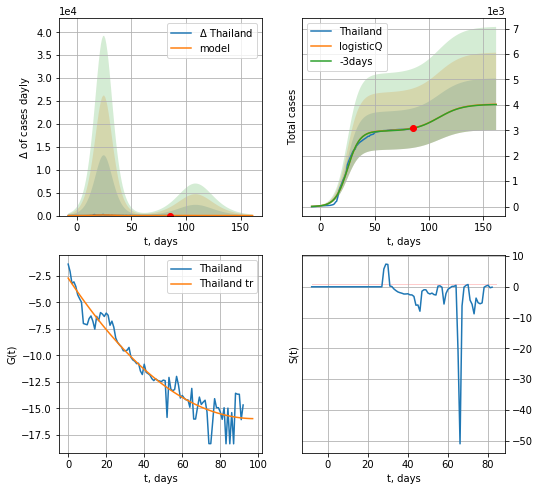

Thailand data at: 2020-05-30
+3 day model MAPE: 0.002740
model: logisticQ
coeffs: [ 2.97764749e+03  9.10550684e-07  2.50287804e+01 -1.96582155e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.252033
forecast at the end of period: +77 days
	 deltaDaycases: 0
	 total cases: 4023 ± 1014
	 total death: 74 ± 55
trend coefficient of determination: 0.926776
 intercept_: -2.706109572841571
 coeffs_: [ 0.         -0.27020686  0.00137633]


In [288]:
x = forecastRRR("Thailand",dfTH[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

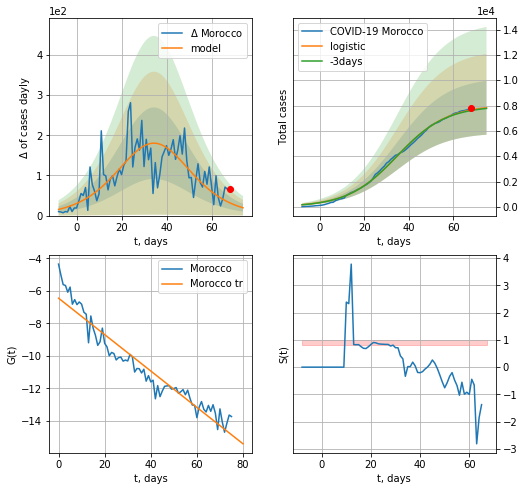

Morocco data at: 2020-05-30
+3 day model MAPE: 0.006281087107371074
model: logistic
coeffs:  [8.03679378e+03 8.97401485e-02 3.48737500e+01]
rational stdev:  0.2719178982460239
forecast at the end of period: +7 days
	 deltaDaycases:  19
	 total cases:  7823 ± 2127
	 total death:  205 ± 167
trend coefficient of determination: 0.923210
 intercept: -6.456128
 slope: -0.111875


In [289]:
x = forecast("Morocco",dfMR[5:],d1,10*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


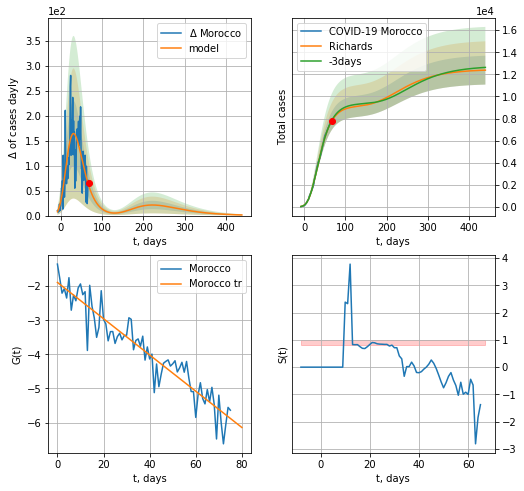

Morocco data at: 2020-05-30
+3 day model MAPE: 0.007826
model: Richards
coeffs: [ 9.14076886e+03  5.29296017e-01 -1.40846372e+01  9.69380655e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.105488
forecast at the end of period: +371 days
	 deltaDaycases: 1
	 total cases: 12380 ± 1305
	 total death: 324 ± 102
trend coefficient of determination: 0.889685
 intercept: -1.889624
 slope: -0.053199


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


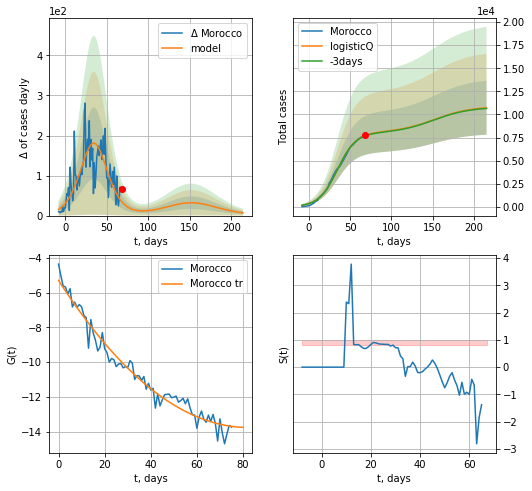

Morocco data at: 2020-05-30
+3 day model MAPE: 0.006223
model: logisticQ
coeffs: [ 8.03552947e+03  1.11261712e-06  3.48708449e+01 -8.06232561e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.272055
forecast at the end of period: +147 days
	 deltaDaycases: 6
	 total cases: 10725 ± 2917
	 total death: 281 ± 229
trend coefficient of determination: 0.967751
 intercept_: -5.298608765860947
 coeffs_: [ 0.         -0.20573972  0.0012516 ]


In [290]:
x = forecastRR("Morocco",dfMR[5:],d1,62*7-dT,addpred=True,xcoef=RkoreaCoeffs)
x = forecastRRR("Morocco",dfMR[5:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

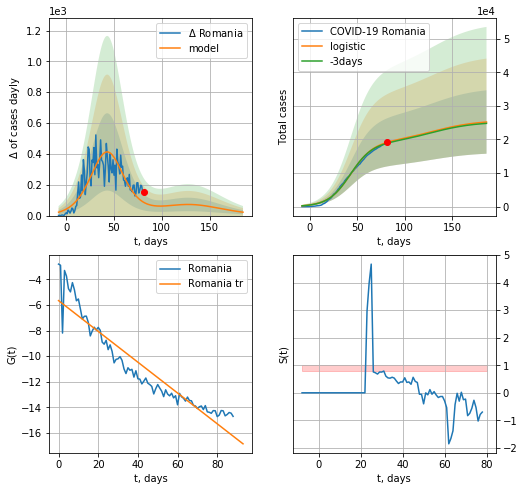

Romania data at: 2020-05-30
+3 day model MAPE: 0.013591646939912059
model: logistic
coeffs:  [1.90706508e+04 8.51984574e-02 4.31805282e+01]
scenario coeffs:  [0.35, 0.5, 3, 1]
rational stdev:  0.3747615751869552
forecast at the end of period: +105 days
	 deltaDaycases:  21
	 total cases:  25192 ± 9441
	 total death:  1657 ± 1862
trend coefficient of determination: 0.888264
 intercept: -5.653848
 slope: -0.120338


In [291]:
#dfRM = read_df(pd.DataFrame(),"RM")
x = forecast("Romania",dfRM[5:],d1,24*7-dT,addpred=True,xcoef=[0.35,.5,3,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


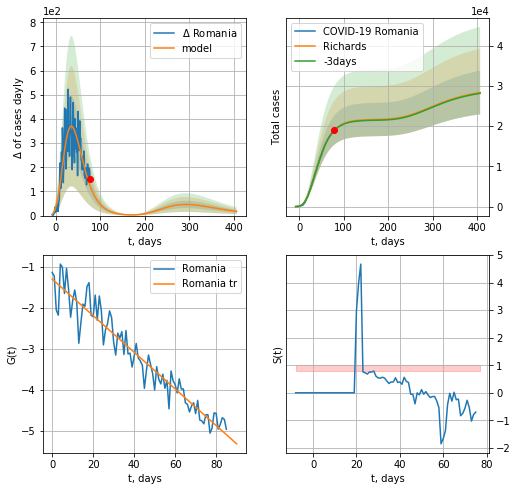

Romania data at: 2020-05-30
+3 day model MAPE: 0.004313
model: Richards
coeffs: [ 2.16823387e+04  3.58777205e+00 -5.75099627e+01  1.30147123e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.191590
forecast at the end of period: +329 days
	 deltaDaycases: 17
	 total cases: 28372 ± 5435
	 total death: 1866 ± 1072
trend coefficient of determination: 0.921887
 intercept: -1.292099
 slope: -0.044817


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


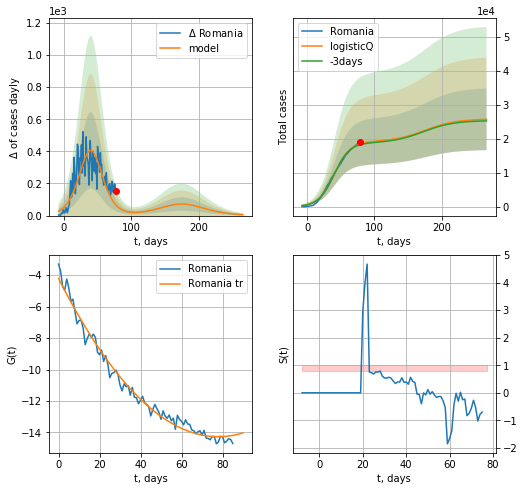

Romania data at: 2020-05-30
+3 day model MAPE: 0.014348
model: logisticQ
coeffs: [ 1.90801542e+04  5.86207320e-07  4.01963233e+01 -1.45006168e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.352973
forecast at the end of period: +189 days
	 deltaDaycases: 5
	 total cases: 25707 ± 9073
	 total death: 1691 ± 1790
trend coefficient of determination: 0.984327
 intercept_: -4.208304343566742
 coeffs_: [ 0.         -0.25831512  0.00165842]


In [292]:
x = forecastRR("Romania",dfRM[8:],d1,56*7-dT,addpred=True,xcoef=RkoreaCoeffs)
xx = forecastRRR("Romania",dfRM[8:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

In [293]:
#x = forecastRRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.35/4,.5,2.2,1])

EU
           date    cases  active     death
108 2020-05-26  1179710  310635  124777.0
109 2020-05-27  1183737  307802  125193.0
110 2020-05-28  1191580  308479  125547.0
111 2020-05-29  1196230  307739  125930.0
112 2020-05-30  1201370  306992  126251.0


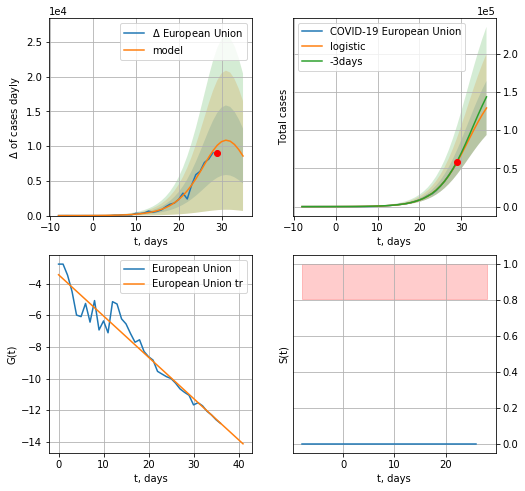

European Union data at: 2020-05-30
+3 day model MAPE: 0.026654473576493115
model: logistic
coeffs:  [1.71206811e+05 2.54019570e-01 3.15968250e+01]
rational stdev:  0.2741183518342743
forecast at the end of period: +7 days
	 deltaDaycases:  8579
	 total cases:  129040 ± 35372
	 total death:  13560 ± 11151
trend coefficient of determination: 0.946316
 intercept: -3.442935
 slope: -0.260531


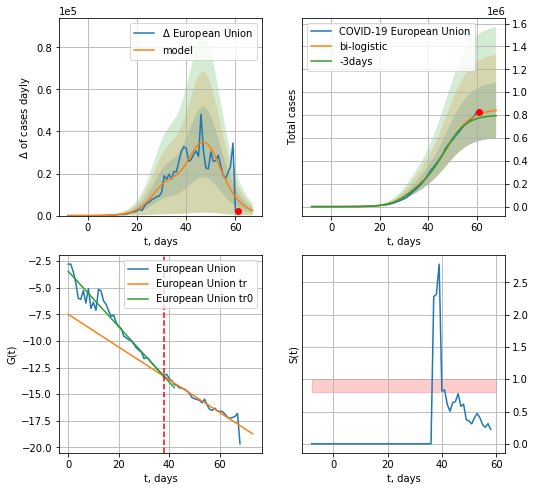

European Union data at: 2020-05-30
+3 day model MAPE: 0.04651829112234155
model: bi-logistic
coeffs:  [6.80547246e+05 2.01837730e-01 4.76694046e+01] [1.71206811e+05 2.54019570e-01 3.15968250e+01]
rational stdev:  0.28952183224371997
forecast at the end of period: +7 days
	 deltaDaycases:  2428
	 total cases:  840680 ± 243395
	 total death:  88346 ± 76734
bi-logistic approximation splitting point: 38
trend0 coefficient of determination: 0.950267
 intercept: -3.442010
 slope: -0.260608
trend coefficient of determination: 0.919561
 intercept: -7.491452
 slope: -0.154009


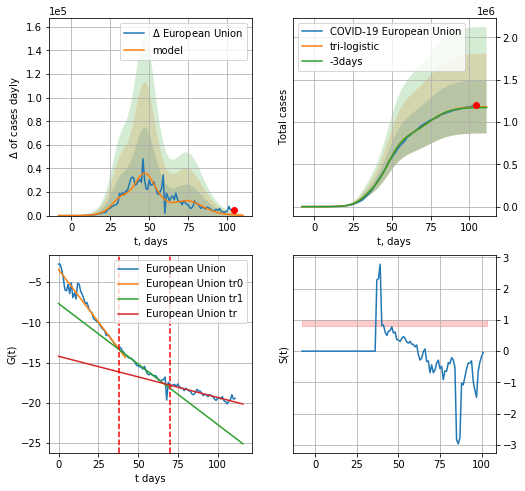

European Union data at: 2020-05-30
+3 day model MAPE: 0.007646319238709636
model: tri-logistic
coeffs:  [3.30012316e+05 1.46248668e-01 7.52062783e+01] [1.71206811e+05 2.54019570e-01 3.15968250e+01 6.80547246e+05
 2.01837730e-01 4.76694046e+01]
forecast rational stdev:  0.266423273611805
forecast at the end of period: +7 days
	 deltaDaycases:  274
	 total cases:  1180015 ± 314383
	 total death:  124006 ± 99114
tri-logistic approximation splitting points: 38,70
trend0 coefficient of determination: 0.950267
 intercept: -3.442010
 slope: -0.260608
trend1 coefficient of determination: 0.917498
 intercept: -7.673048
 slope: -0.150226
trend coefficient of determination: 0.857594
 intercept: -14.224273
 slope: -0.051152


In [295]:
vL=38
vL1=70
dfEU = read_df(pd.DataFrame(),"EU")
x = forecast("European Union",dfEU[:vL],d1,10*7-dT)
xx = forecast2("European Union",dfEU[:vL1],d1,10*7-dT,x,vL=38,addpred=False,xcoef=[0.25,1.,1.5])
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("European Union",dfEU,d1,10*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


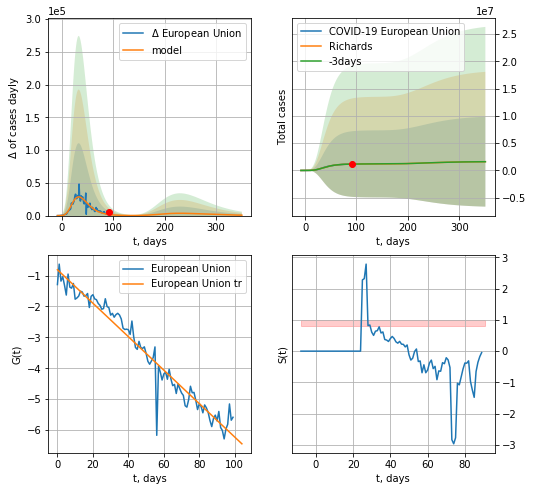

European Union data at: 2020-05-30
+3 day model MAPE: 0.004116
model: Richards
coeffs: [ 1.20243982e+06  6.79461375e+00 -3.78044533e+01  9.56844076e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 5.119362
forecast at the end of period: +259 days
	 deltaDaycases: 626
	 total cases: 1609305 ± 8238615
	 total death: 169120 ± 2597359
trend coefficient of determination: 0.951691
 intercept: -0.809433
 slope: -0.054225


In [296]:
x = forecastRR("European Union",dfEU[12:],d1,46*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


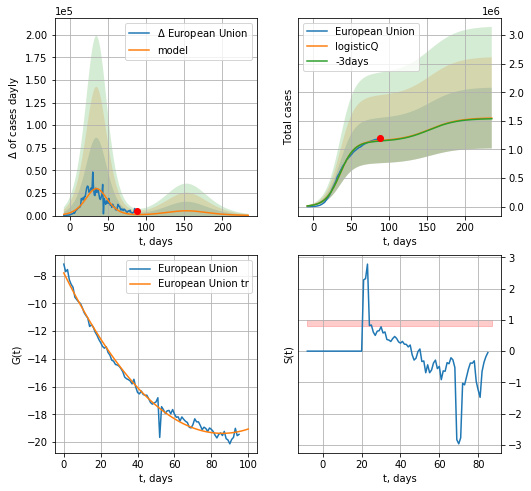

European Union data at: 2020-05-30
+3 day model MAPE: 0.007999
model: logisticQ
coeffs: [ 1.14807301e+06  4.55611049e-07  3.51834151e+01 -2.28092582e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.343096
forecast at the end of period: +147 days
	 deltaDaycases: 296
	 total cases: 1549075 ± 531481
	 total death: 162791 ± 167558
trend coefficient of determination: 0.989559
 intercept_: -7.799462014963414
 coeffs_: [ 0.         -0.26966085  0.00157004]


In [297]:
x = forecastRRR("European Union",dfEU[16:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/numpy/lib/function_base.py:1269: RuntimeWarning: invalid value encountered in subtract
  a = op(a[slice1], a[slice2])
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


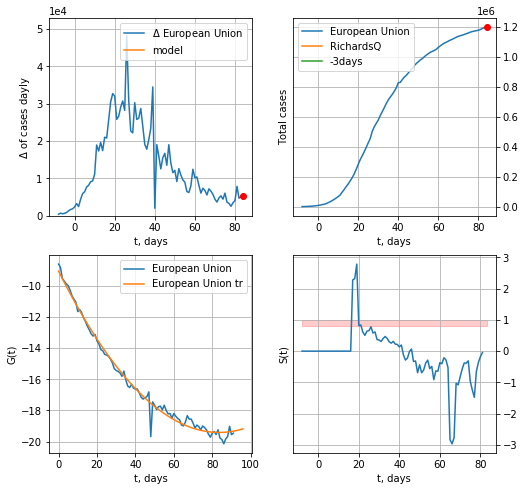

European Union data at: 2020-05-30
+3 day model MAPE: nan
model: RichardsQ
coeffs: [ 6.50264796e+05  4.26467509e+00 -1.27662935e+03  1.08769639e+03
 -2.20230435e+00]
S.Korea scenario coeffs: [ 3.69179628e-01  4.55901153e+01  3.02600169e-01 -6.49668395e+01
  2.33503320e-03]
rational stdev: 0.685263
forecast at the end of period: +35 days


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: invalid value encountered in double_scalars
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:115: RuntimeWarning: invalid value encountered in double_scalars


ValueError: cannot convert float NaN to integer

In [298]:
x = forecastQR("European Union",dfEU[20:],d1,14*7-dT,addpred=True,xcoef=QRkoreaCoeffs)

In [ ]:
#x = forecastRR("Romania",dfRM[5:],d1,14*7-dT)

In [ ]:
#x = forecastRRR("European Union",dfEU[:],d1,8*7-dT)

In [ ]:
#x = forecastRRR("Romania",dfRM[5:],d1,18*7-dT,addpred=True,xcoef=[0.35,.5,3.,1.])

In [ ]:
#dfIC[:]

IC
          date   cases  active  death
86 2020-05-26  1804.3       2   10.0
87 2020-05-27  1805.0       3   10.0
88 2020-05-28  1805.1       3   10.0
89 2020-05-29  1805.2       1   10.0
90 2020-05-30  1806.0       2   10.0


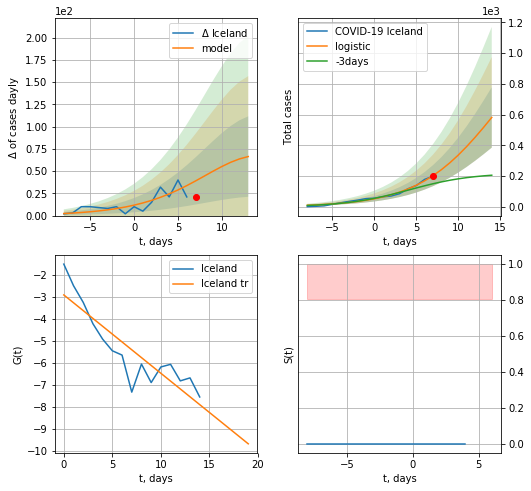

Iceland data at: 2020-05-30
+3 day model MAPE: 0.49229543132944575
model: logistic
coeffs:  [1.27194861e+03 2.12945173e-01 1.48141483e+01]
rational stdev:  0.3377978270267634
forecast at the end of period: +7 days
	 deltaDaycases:  66
	 total cases:  580 ± 196
	 total death:  3 ± 3
trend coefficient of determination: 0.778766
 intercept: -2.904405
 slope: -0.356109


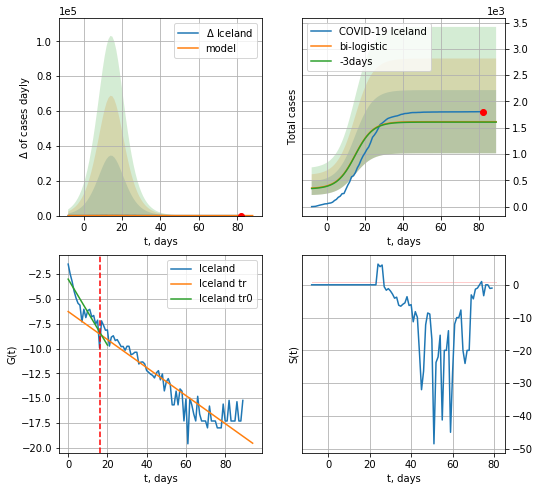

Iceland data at: 2020-05-30
+3 day model MAPE: 0.004742924679825302
model: bi-logistic
coeffs:  [322.9956588   -3.45600007 109.50098843] [1.27194861e+03 2.12945173e-01 1.48141483e+01]
scenario coeffs:  [0.0625, 1.0, 2]
rational stdev:  0.372033519627469
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  1615 ± 600
	 total death:  8 ± 8
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.772657
 intercept: -3.017482
 slope: -0.331878
trend coefficient of determination: 0.858553
 intercept: -6.279434
 slope: -0.140986


In [301]:
dfIC = read_df(pd.DataFrame(),"IC")
vL=16
try:
    x = forecast("Iceland",dfIC[:vL],d1,10*7-dT,addpred=False,xcoef=[0.25/2,1.,2])
    xx = forecast2("Iceland",dfIC[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25/4,1.,2],vL=vL)
except:
    print ("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


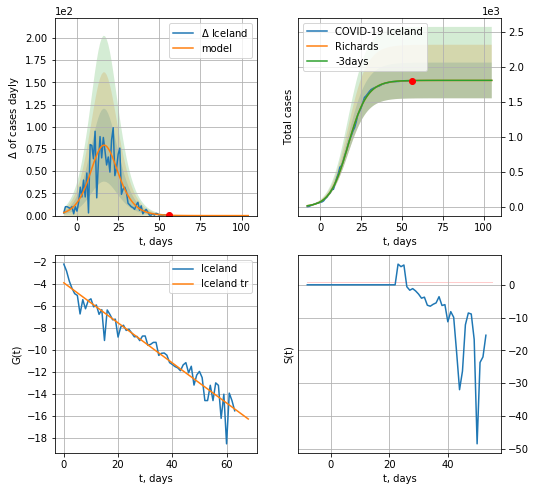

Iceland data at: 2020-05-30
+3 day model MAPE: 0.000574
model: Richards
coeffs: [1.80664071e+03 1.96329707e-01 1.60140797e+01 8.56236679e-01]
rational stdev: 0.141183
forecast at the end of period: +49 days
	 deltaDaycases: 0
	 total cases: 1806 ± 255
	 total death: 10 ± 4
trend coefficient of determination: 0.937183
 intercept: -3.923109
 slope: -0.181532


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


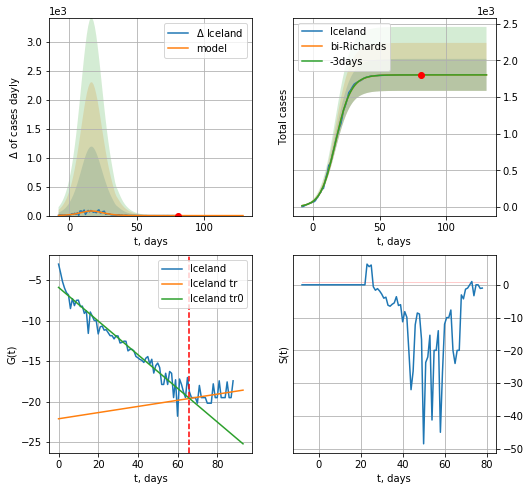

Iceland data at: 2020-05-30
+3 day model MAPE: 0.000218
model: bi-Richards
coeffs: [-3.16858656  1.19363782 35.06135176  1.29585741]
rational stdev: 0.121173
forecast at the end of period: +49 days
	 deltaDaycases: 0
	 total cases: 1803 ± 218
	 total death: 9 ± 3
bi-Richards approximation splitting point: 66
trend coefficient of determination: 0.942959
 intercept: -5.892752
 slope: -0.207871
trend coefficient of determination: 0.082667
 intercept: -22.128589
 slope: 0.038025


In [302]:
vL = 66
x = forecastRR("Iceland",dfIC[1:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Iceland",dfIC[1:],d1,16*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastRRR("Iceland",dfIC[:20],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


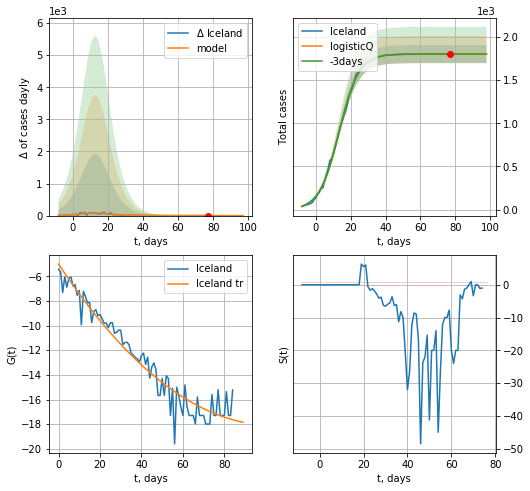

Iceland data at: 2020-05-30
+3 day model MAPE: 0.000117
model: logisticQ
coeffs: [ 1.80267683e+03  8.35445177e-06  1.33258395e+01 -2.11907264e+04]
rational stdev: 0.058147
forecast at the end of period: +21 days
	 deltaDaycases: 0
	 total cases: 1802 ± 104
	 total death: 9 ± 1
trend coefficient of determination: 0.933689
 intercept_: -5.015116946837249
 coeffs_: [ 0.         -0.25356125  0.00122989]


In [303]:
x = forecastRRR("Iceland",dfIC[5:],d1,12*7-dT,addpred=False,xcoef=[0.35/6,.5,4.,1.])

PM
          date  cases  active  death
77 2020-05-26  11447  4755.0  313.0
78 2020-05-27  11728  4034.0  315.0
79 2020-05-28  12131  4432.0  320.0
80 2020-05-29  12531  4665.0  326.0
81 2020-05-30  13018  3274.0  330.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


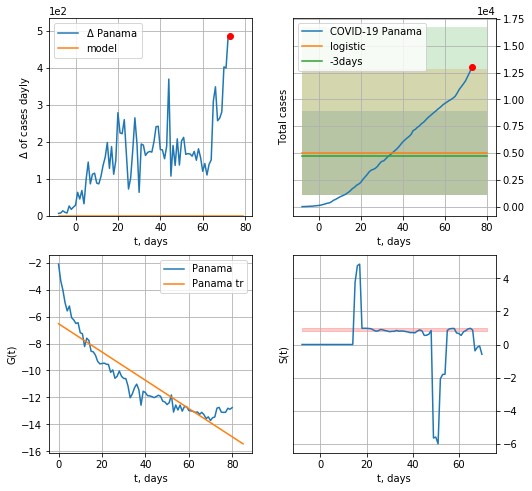

Panama data at: 2020-05-30
+3 day model MAPE: 0.06129918022332053
model: logistic
coeffs:  [ 4.98219511e+03 -3.61108195e+00  1.15320251e+02]
rational stdev:  0.7874414728278217
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  4982 ± 3923
	 total death:  126 ± 297
trend coefficient of determination: 0.813588
 intercept: -6.529351
 slope: -0.104922


In [305]:
dfPM = read_df(pd.DataFrame(),"PM").fillna(0)
x = forecast("Panama",dfPM[:],d1,10*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


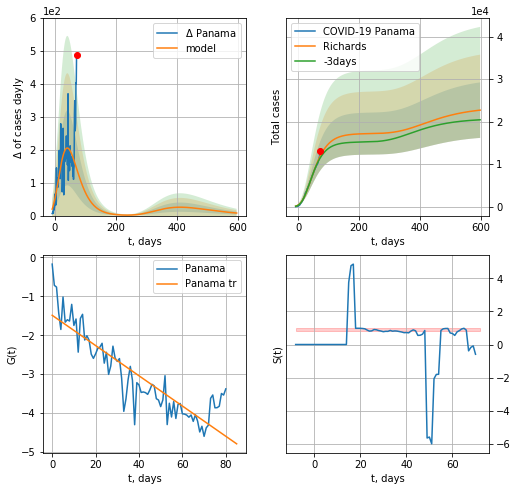

Panama data at: 2020-05-30
+3 day model MAPE: 0.040054
model: Richards
coeffs: [ 1.72030933e+04  3.32709169e+00 -9.97885467e+01  9.79703732e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.287585
forecast at the end of period: +525 days
	 deltaDaycases: 7
	 total cases: 22697 ± 6527
	 total death: 575 ± 496
trend coefficient of determination: 0.784808
 intercept: -1.487890
 slope: -0.038843


In [306]:
x = forecastRR("Panama",dfPM[:],d1,84*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


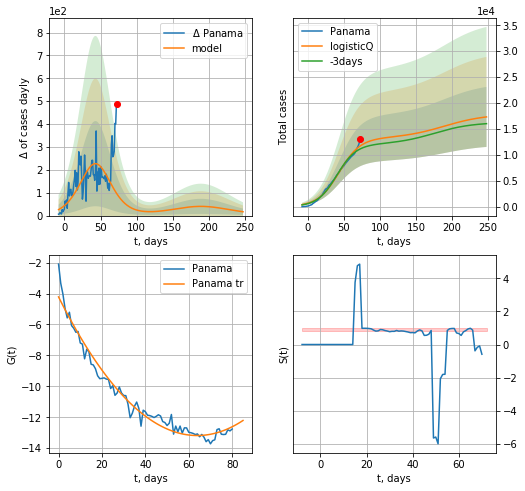

Panama data at: 2020-05-30
+3 day model MAPE: 0.054421
model: logisticQ
coeffs: [ 1.31877021e+04  4.28147849e-07  4.34103659e+01 -1.60087685e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.334523
forecast at the end of period: +175 days
	 deltaDaycases: 16
	 total cases: 17315 ± 5792
	 total death: 438 ± 439
trend coefficient of determination: 0.969028
 intercept_: -4.220331724000891
 coeffs_: [ 0.         -0.28030332  0.00219235]


In [307]:
x = forecastRRR("Panama",dfPM[:],d1,34*7-dT,addpred=True,xcoef=koreaCoeffs)

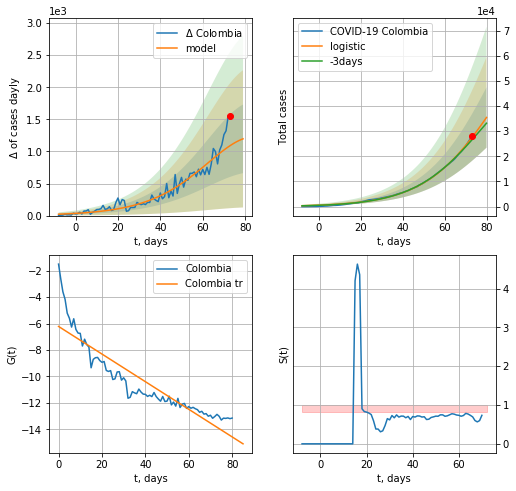

Colombia data at: 2020-05-30
+3 day model MAPE: 0.03951211427462964
model: logistic
coeffs:  [8.49214271e+04 5.82222080e-02 8.57051727e+01]
rational stdev:  0.3385432967644167
forecast at the end of period: +7 days
	 deltaDaycases:  1196
	 total cases:  35472 ± 12009
	 total death:  1118 ± 1135
trend coefficient of determination: 0.821845
 intercept: -6.218477
 slope: -0.104494


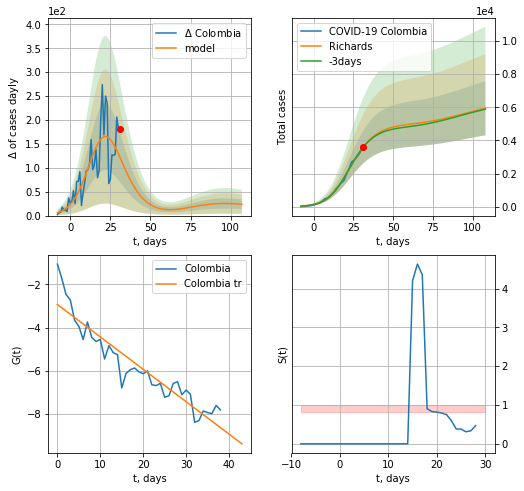

Colombia data at: 2020-05-30
+3 day model MAPE: 0.003462
model: Richards
coeffs: [4.99315067e+03 1.95979830e-01 1.78374870e+01 5.90307623e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.275146
forecast at the end of period: +77 days
	 deltaDaycases: 23
	 total cases: 5946 ± 1636
	 total death: 187 ± 154
trend coefficient of determination: 0.874880
 intercept: -2.931794
 slope: -0.150492


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


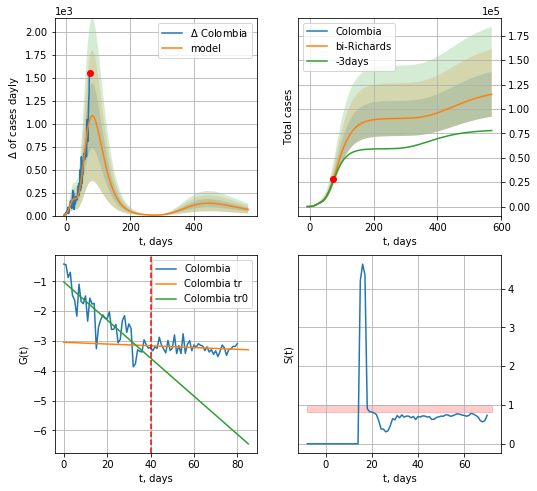

Colombia data at: 2020-05-30
+3 day model MAPE: 0.050175
model: bi-Richards
coeffs: [ 8.53545612e+04  1.96050877e+00 -3.37337647e+01  1.78028217e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.199700
forecast at the end of period: +497 days
	 deltaDaycases: 66
	 total cases: 115052 ± 22976
	 total death: 3626 ± 2172
bi-Richards approximation splitting point: 40
trend coefficient of determination: 0.746857
 intercept: -1.023844
 slope: -0.063821
trend coefficient of determination: 0.042759
 intercept: -3.043807
 slope: -0.002967


In [309]:
dfCB = dfCB.fillna(0)
x = forecast("Colombia",dfCB[:],d1,10*7-dT)
x = forecastRR("Colombia",dfCB[:40],d1,20*7-dT,addpred=True,xcoef=RkoreaCoeffs)
xx = forecast2RR("Colombia",dfCB[:],d1,80*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=40)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


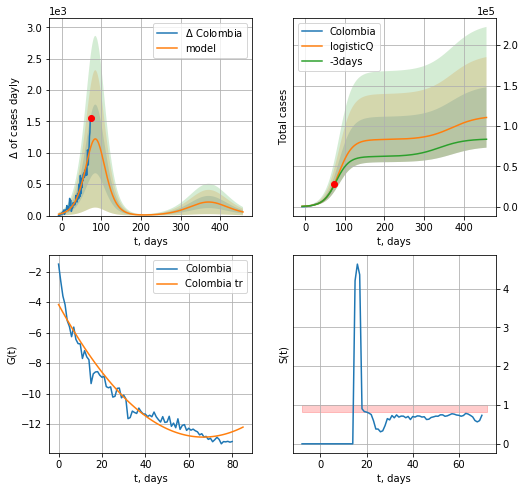

Colombia data at: 2020-05-30
+3 day model MAPE: 0.039802
model: logisticQ
coeffs: [ 8.30918762e+04  5.52898104e-06  8.50467712e+01 -1.05508994e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.338810
forecast at the end of period: +385 days
	 deltaDaycases: 57
	 total cases: 110425 ± 37413
	 total death: 3480 ± 3537
trend coefficient of determination: 0.948079
 intercept_: -4.156636427406231
 coeffs_: [ 0.         -0.26110177  0.00195767]


In [310]:
x = forecastRRR("Colombia",dfCB[:],d1,64*7-dT,addpred=True,xcoef=koreaCoeffs)

AR
          date   cases  active  death
83 2020-05-26  8697.0  3162.0  617.0
84 2020-05-27  8857.0  3105.0  623.0
85 2020-05-28  8997.0  3090.0  630.0
86 2020-05-29  9134.0  3074.0  638.0
87 2020-05-30  9267.0  3072.0  646.0


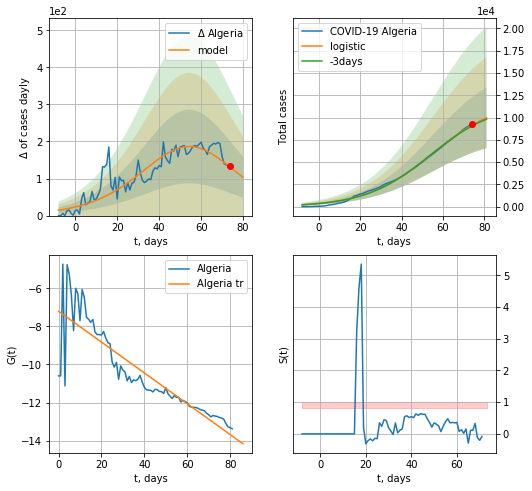

Algeria data at: 2020-05-30
+3 day model MAPE: 0.01163538799592017
model: logistic
coeffs:  [1.18995213e+04 6.26425989e-02 5.47822426e+01]
rational stdev:  0.34067760701797206
forecast at the end of period: +7 days
	 deltaDaycases:  103
	 total cases:  9970 ± 3396
	 total death:  695 ± 710
trend coefficient of determination: 0.771538
 intercept: -7.203985
 slope: -0.080958


In [312]:
dfAR = read_df(pd.DataFrame(),"AR")
dfAR = dfAR.fillna(0)
x = forecast("Algeria",dfAR[5:],d1,10*7-dT)
#dfAG

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


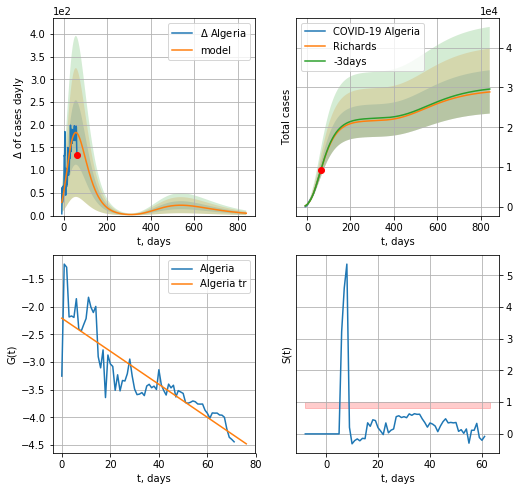

Algeria data at: 2020-05-30
+3 day model MAPE: 0.004003
model: Richards
coeffs: [ 2.17034656e+04  1.07735611e+00 -1.08805476e+02  2.15005261e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.188388
forecast at the end of period: +777 days
	 deltaDaycases: 5
	 total cases: 28878 ± 5440
	 total death: 2013 ± 1137
trend coefficient of determination: 0.758512
 intercept: -2.210069
 slope: -0.029820


In [313]:
x = forecastRR("Algeria",dfAR[15:],d1,120*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


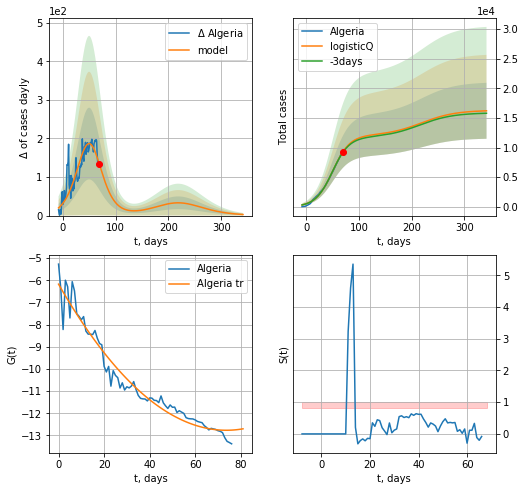

Algeria data at: 2020-05-30
+3 day model MAPE: 0.010219
model: logisticQ
coeffs: [ 1.20305284e+04  1.28641922e-06  5.01880914e+01 -4.80570731e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.291268
forecast at the end of period: +273 days
	 deltaDaycases: 2
	 total cases: 16201 ± 4718
	 total death: 1129 ± 986
trend coefficient of determination: 0.953982
 intercept_: -6.175530524524481
 coeffs_: [ 0.         -0.17886345  0.00121353]


In [314]:
x = forecastRRR("Algeria",dfAR[10:],d1,48*7-dT,addpred=True,xcoef=koreaCoeffs)

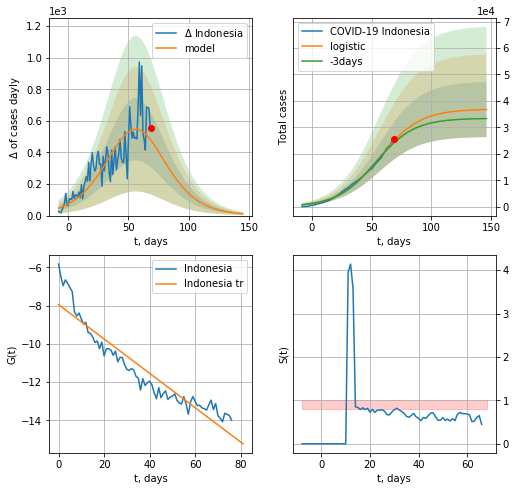

Indonesia data at: 2020-05-30
+3 day model MAPE: 0.032378166861292655
model: logistic
coeffs:  [3.69394487e+04 5.92344191e-02 5.64807480e+01]
rational stdev:  0.2831612357159025
forecast at the end of period: +77 days
	 deltaDaycases:  11
	 total cases:  36756 ± 10408
	 total death:  2243 ± 1905
trend coefficient of determination: 0.891433
 intercept: -7.949822
 slope: -0.089818


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


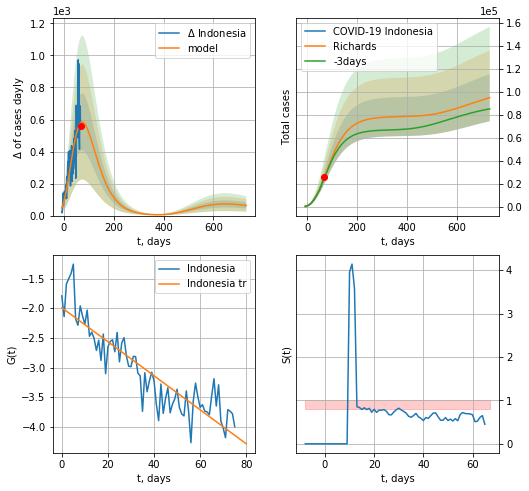

Indonesia data at: 2020-05-30
+3 day model MAPE: 0.018140
model: Richards
coeffs: [ 7.86285235e+04  1.28229612e+00 -1.29032437e+02  1.58682694e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.216340
forecast at the end of period: +665 days
	 deltaDaycases: 63
	 total cases: 95012 ± 20554
	 total death: 5798 ± 3763
trend coefficient of determination: 0.801979
 intercept: -1.991855
 slope: -0.028665


In [315]:
x = forecast("Indonesia",dfIE[5:],d1,20*7-dT)
x = forecastRR("Indonesia",dfIE[6:],d1,104*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


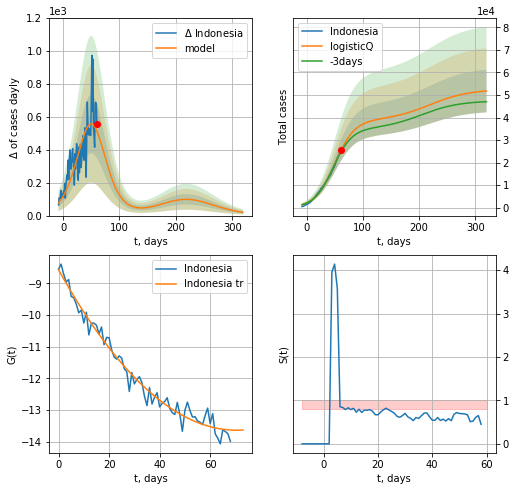

Indonesia data at: 2020-05-30
+3 day model MAPE: 0.027948
model: logisticQ
coeffs: [ 3.87641609e+04  1.18971764e-06  5.02490637e+01 -4.79488346e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.182896
forecast at the end of period: +259 days
	 deltaDaycases: 19
	 total cases: 51776 ± 9469
	 total death: 3160 ± 1733
trend coefficient of determination: 0.975495
 intercept_: -8.568100820105565
 coeffs_: [ 0.         -0.14393495  0.00102076]


In [316]:
x = forecastRRR("Indonesia",dfIE[13:],d1,46*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


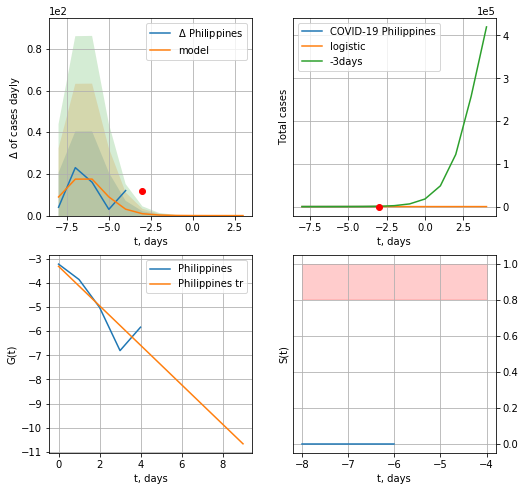

Philippines data at: 2020-05-30
+3 day model MAPE: 0.9724006736169737
model: logistic
coeffs:  [61.51692029  1.2919553  -5.99802409]
rational stdev:  0.19348550855350297
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  61 ± 11
	 total death:  3 ± 1
trend coefficient of determination: 0.794507
 intercept: -3.309972
 slope: -0.817432


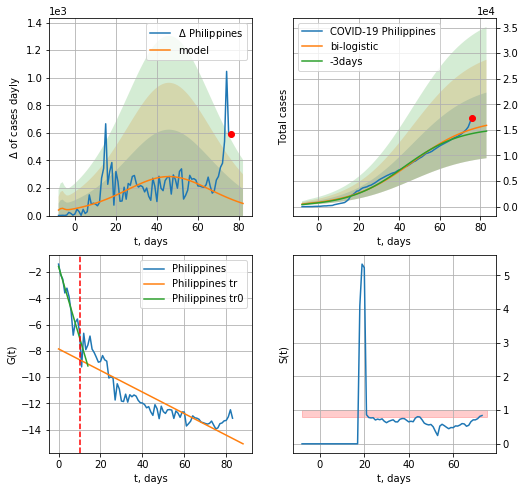

Philippines data at: 2020-05-30
+3 day model MAPE: 0.06298012835411115
model: bi-logistic
coeffs:  [1.72325558e+04 6.57280156e-02 4.63270405e+01] [61.51692029  1.2919553  -5.99802409]
rational stdev:  0.40408308331525294
forecast at the end of period: +7 days
	 deltaDaycases:  88
	 total cases:  15874 ± 6414
	 total death:  875 ± 1060
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.872436
 intercept: -1.560268
 slope: -0.541848
trend coefficient of determination: 0.780003
 intercept: -7.849574
 slope: -0.082176


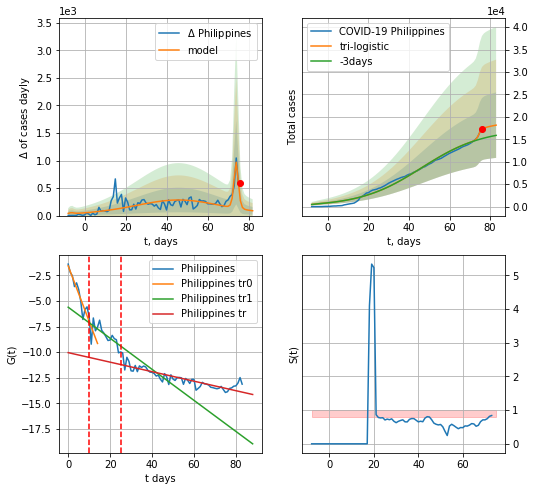

Philippines data at: 2020-05-30
+3 day model MAPE: 0.14645843549996337
model: tri-logistic
coeffs:  [2.28141421e+03 1.53888102e+00 7.44642982e+01] [ 6.15169203e+01  1.29195530e+00 -5.99802409e+00  1.72325558e+04
  6.57280156e-02  4.63270405e+01]
forecast rational stdev:  0.40182532499143947
forecast at the end of period: +7 days
	 deltaDaycases:  88
	 total cases:  18155 ± 7295
	 total death:  1001 ± 1206
tri-logistic approximation splitting points: 10,25
trend0 coefficient of determination: 0.872436
 intercept: -1.560268
 slope: -0.541848
trend1 coefficient of determination: 0.474240
 intercept: -5.600607
 slope: -0.151865
trend coefficient of determination: 0.744314
 intercept: -10.045888
 slope: -0.046514


In [318]:
vL=10
vL1=25
x = forecast("Philippines",dfPH[4:vL],d1,10*7-dT,addpred=False,xcoef=[0.25,1.,2.3])
xx = forecast2("Philippines",dfPH[:],d1,10*7-dT,x,vL=vL,addpred=False,xcoef=[0.25,1.,1.8])
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Philippines",dfPH,d1,10*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


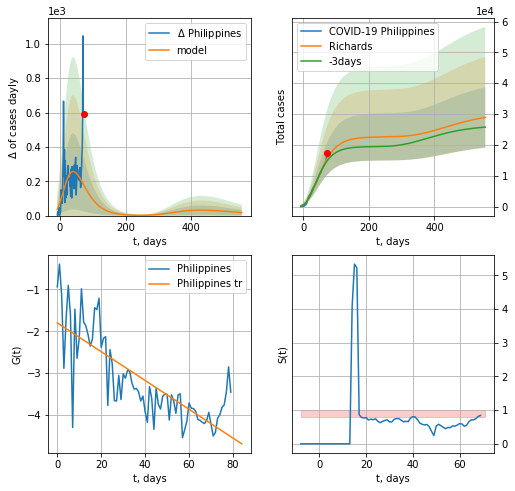

Philippines data at: 2020-05-30
+3 day model MAPE: 0.048689
model: Richards
coeffs: [ 2.26369425e+04  3.49321254e+00 -1.11481626e+02  8.87642398e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.338217
forecast at the end of period: +483 days
	 deltaDaycases: 17
	 total cases: 28914 ± 9779
	 total death: 1594 ± 1617
trend coefficient of determination: 0.609147
 intercept: -1.799811
 slope: -0.034483


In [319]:
x = forecastRR("Philippines",dfPH[4:],d1,78*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


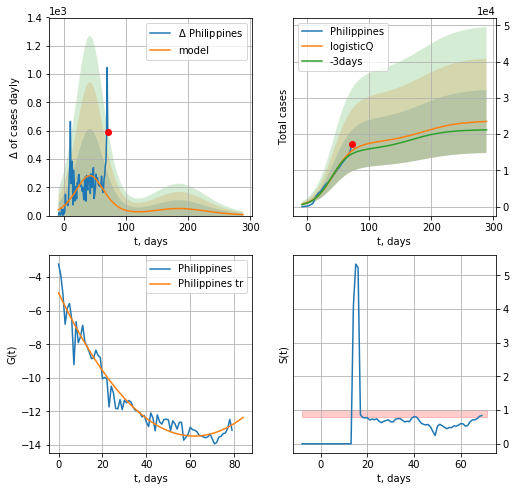

Philippines data at: 2020-05-30
+3 day model MAPE: 0.060390
model: logisticQ
coeffs: [ 1.74946532e+04  6.46939855e-07  4.26244072e+01 -9.91830569e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.370026
forecast at the end of period: +217 days
	 deltaDaycases: 6
	 total cases: 23477 ± 8687
	 total death: 1294 ± 1436
trend coefficient of determination: 0.947573
 intercept_: -4.9318267651365675
 coeffs_: [ 0.         -0.27690337  0.00224285]


In [320]:
x = forecastRRR("Philippines",dfPH[4:],d1,40*7-dT,addpred=True,xcoef=koreaCoeffs)

GC
          date  cases  active  death
87 2020-05-26   2892    1345  173.0
88 2020-05-27   2903    1356  173.0
89 2020-05-28   2906    1357  175.0
90 2020-05-29   2909    1360  175.0
91 2020-05-30   2915    1366  175.0


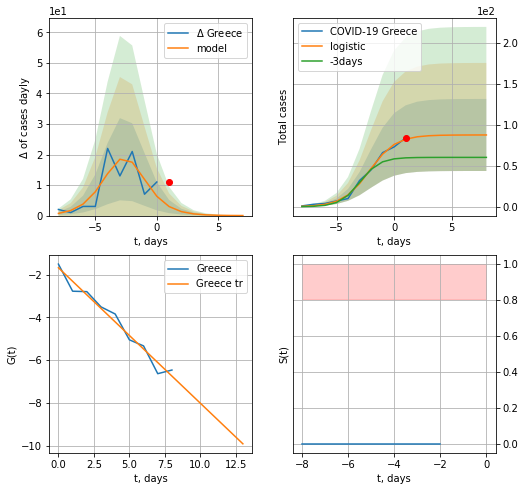

Greece data at: 2020-05-30
+3 day model MAPE: 0.42128754754463943
model: logistic
coeffs:  [87.54984336  0.87627722 -2.15069813]
rational stdev:  0.5018417290456435
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  87 ± 43
	 total death:  5 ± 7
trend coefficient of determination: 0.966991
 intercept: -1.674249
 slope: -0.634181


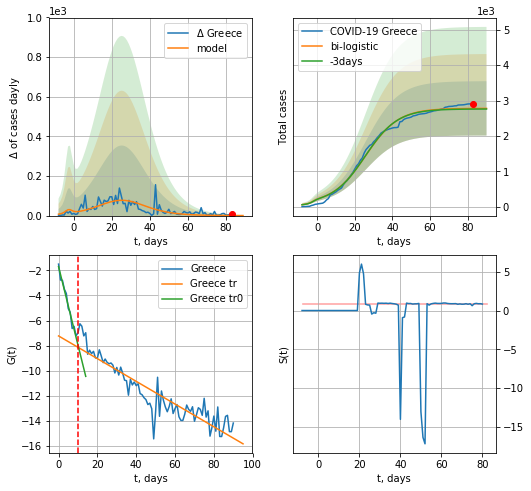

Greece data at: 2020-05-30
+3 day model MAPE: 0.006455391347643479
model: bi-logistic
coeffs:  [2.69323925e+03 1.14640930e-01 2.56986690e+01] [87.54984336  0.87627722 -2.15069813]
rational stdev:  0.27639373135474354
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  2779 ± 768
	 total death:  166 ± 137
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.974467
 intercept: -1.699561
 slope: -0.624689
trend coefficient of determination: 0.838658
 intercept: -7.224617
 slope: -0.090464


In [322]:
dfGC = read_df(pd.DataFrame(),"GC")
x = forecast("Greece",dfGC[:10],d1,10*7-dT)
xx = forecast2("Greece",dfGC[:],d1,10*7-dT,x,addpred=False,xcoef=[.25/2,1.,2.3],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


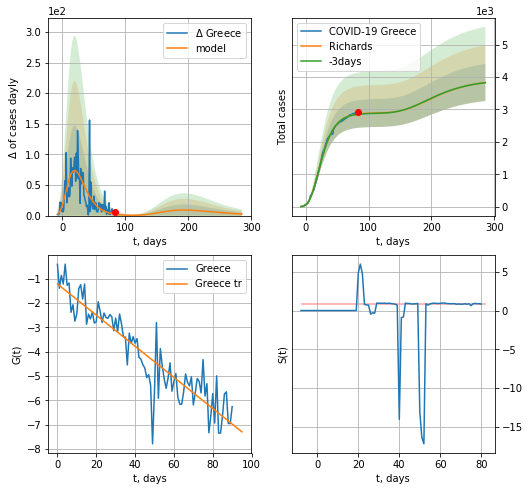

Greece data at: 2020-05-30
+3 day model MAPE: 0.003282
model: Richards
coeffs: [ 2.89327821e+03  7.32575617e+00 -4.72776749e+01  9.49188322e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.149150
forecast at the end of period: +203 days
	 deltaDaycases: 2
	 total cases: 3831 ± 571
	 total death: 229 ± 102
trend coefficient of determination: 0.838381
 intercept: -1.223029
 slope: -0.063896


In [323]:
x = forecastRR("Greece",dfGC[:],d1,38*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


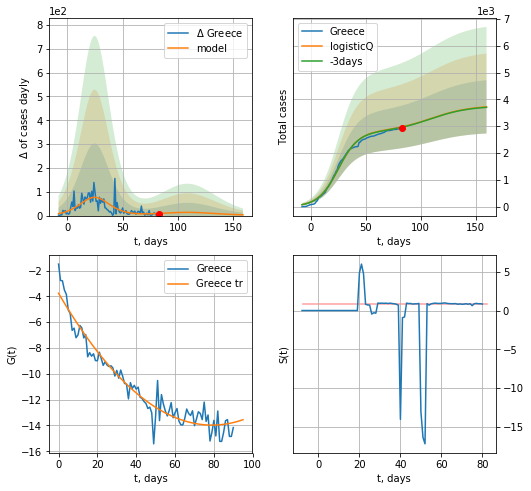

Greece data at: 2020-05-30
+3 day model MAPE: 0.004888
model: logisticQ
coeffs: [ 2.78992117e+03  4.70368693e-07  2.50554527e+01 -2.32051101e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.266974
forecast at the end of period: +77 days
	 deltaDaycases: 3
	 total cases: 3720 ± 993
	 total death: 223 ± 178
trend coefficient of determination: 0.934620
 intercept_: -3.7619932858826663
 coeffs_: [ 0.         -0.25841822  0.00163473]


In [324]:
x = forecastRRR("Greece",dfGC[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

HG
          date  cases  active  death
81 2020-05-26   3793    1432  505.0
82 2020-05-27   3816    1311  509.0
83 2020-05-28   3841    1300  517.0
84 2020-05-29   3867    1201  524.0
85 2020-05-30   3867    1201  524.0
Exception occurs


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


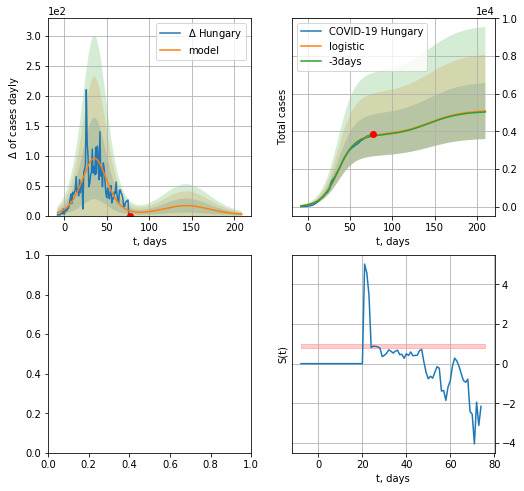

In [325]:
dfHG = read_df(pd.DataFrame(),"HG")
try:
    x = forecast("Hungary",dfHG[:],d1,28*7-dT,addpred=True,xcoef=[.35,.5,4,1])
except:
    print("Exception occurs")
#xx = forecast2("Hungary",dfHG[:],d1,4*7-dT,x,vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


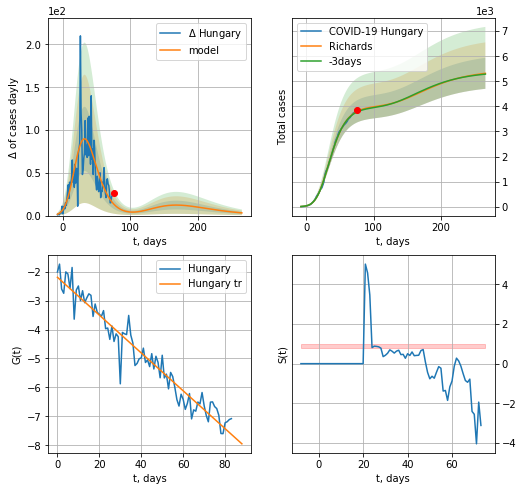

Hungary data at: 2020-05-29
+3 day model MAPE: 0.006273
model: Richards
coeffs: [4.00838214e+03 2.72113524e-01 1.23720769e+01 2.51154299e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.116024
forecast at the end of period: +190 days
	 deltaDaycases: 3
	 total cases: 5319 ± 617
	 total death: 716 ± 249
trend coefficient of determination: 0.939070
 intercept: -2.195748
 slope: -0.065347


In [392]:
x = forecastRR("Hungary",dfHG[:],d1,36*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


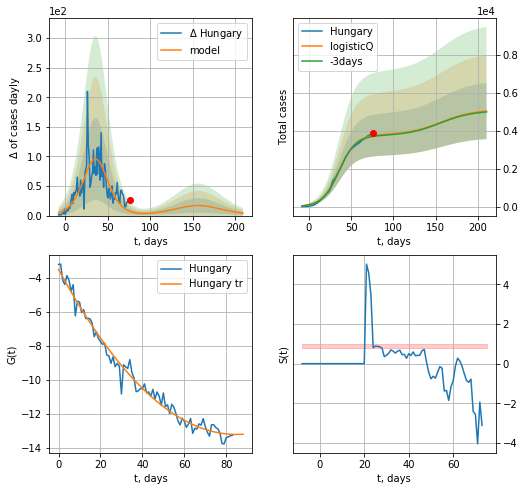

Hungary data at: 2020-05-29
+3 day model MAPE: 0.010233
model: logisticQ
coeffs: [ 3.78449055e+03  8.92950828e-07  3.58945128e+01 -1.13083715e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.293208
forecast at the end of period: +134 days
	 deltaDaycases: 4
	 total cases: 5042 ± 1478
	 total death: 678 ± 596
trend coefficient of determination: 0.982019
 intercept_: -3.5095120036018415
 coeffs_: [ 0.         -0.22865745  0.00134724]


In [393]:
x = forecastRRR("Hungary",dfHG[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs,cases='cases')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


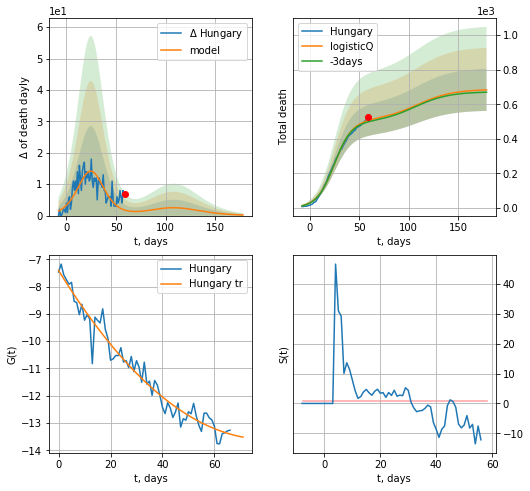

Hungary data at: 2020-05-29
+3 day model MAPE: 0.016859
model: logisticQ
coeffs: [ 5.06881908e+02  1.33865662e-06  2.49125897e+01 -8.29131618e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.177805
forecast at the end of period: +120 days
	 total death: 682 ± 121
trend coefficient of determination: 0.958848
 intercept_: -7.409608837156087
 coeffs_: [ 0.         -0.15445541  0.00096396]


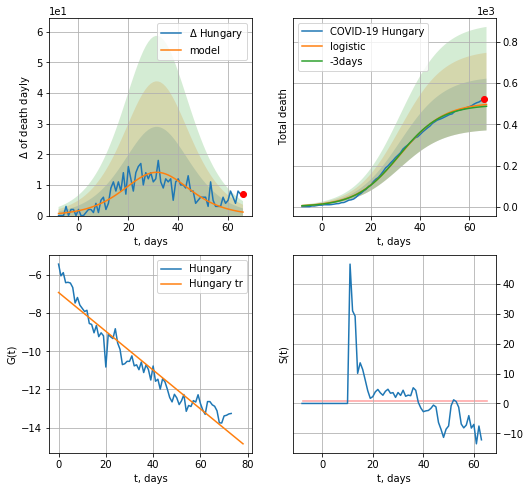

Hungary data at: 2020-05-29
+3 day model MAPE: 0.01768944751888193
model: logistic
coeffs:  [5.06295678e+02 1.11611004e-01 3.18867930e+01]
rational stdev:  0.2529899560667581
forecast at the end of period: +1 days
	 total death:  496 ± 125
trend coefficient of determination: 0.925823
 intercept: -6.915312
 slope: -0.101782


In [395]:
x = forecastRRR("Hungary",dfHG[17:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')
x = forecast("Hungary",dfHG[10:],d1,9*7-dT,cases='death')

MT
          date  cases  active  death
79 2020-05-26  611.5     120    6.0
80 2020-05-27  612.0     114    7.0
81 2020-05-28  616.0     108    7.0
82 2020-05-29  616.5      93    9.0
83 2020-05-30  618.0      84    9.0


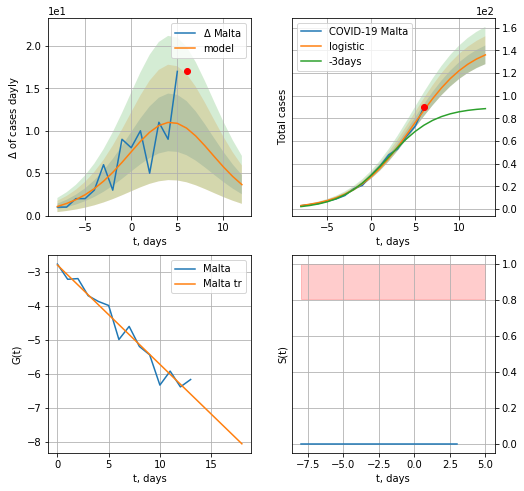

Malta data at: 2020-05-30
model: logistic
coeffs:  [147.79636191   0.29837112   4.7799048 ]
rational stdev:  0.06036954020755974
forecast at the end of period: +7 days
	 deltaDaycases:  3
	 total cases:  136 ± 8
	 total death:  1 ± 0
trend coefficient of determination: 0.952854
 intercept: -2.800130
 slope: -0.292111


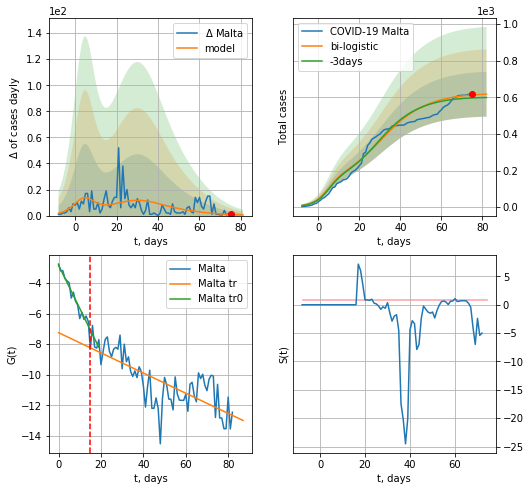

Malta data at: 2020-05-30
+3 day model MAPE: 0.027745084171077083
model: bi-logistic
coeffs:  [4.20826026e+02 1.07667087e-01 3.00768040e+01] [147.79636191   0.29837112   4.7799048 ]
scenario coeffs:  [0.125, 1.0, 1.8]
rational stdev:  0.19853198138022077
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  617 ± 122
	 total death:  8 ± 4
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.954424
 intercept: -2.840997
 slope: -0.282680
trend coefficient of determination: 0.564294
 intercept: -7.251205
 slope: -0.065918


In [328]:
dfMT = read_df(pd.DataFrame(),"MT")
x = forecast("Malta",dfMT[:15],d1,7*10-dT,pMAPE=False)
xx = forecast2("Malta",dfMT[:],d1,7*10-dT,x,vL=15,addpred=True,xcoef=[0.25/2,1.,1.8])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


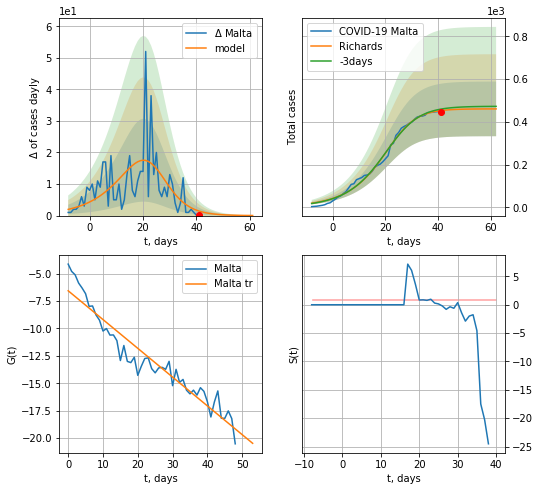

Malta data at: 2020-05-30
+3 day model MAPE: 0.016229
model: Richards
coeffs: [4.60753453e+02 9.94315746e-02 2.41437164e+01 1.98427317e+00]
rational stdev: 0.277865
forecast at the end of period: +21 days
	 deltaDaycases: 0
	 total cases: 460 ± 127
	 total death: 6 ± 5
trend coefficient of determination: 0.914701
 intercept: -6.567936
 slope: -0.262394


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


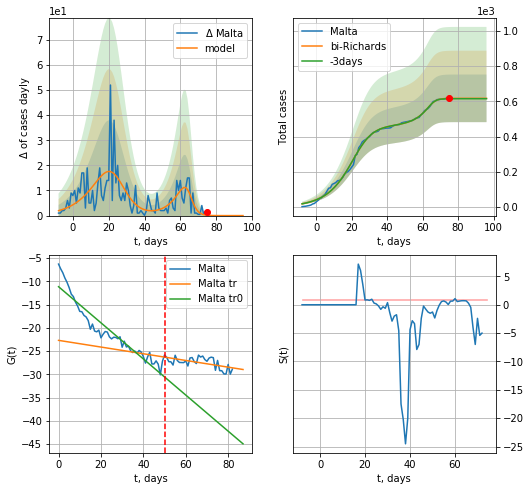

Malta data at: 2020-05-30
+3 day model MAPE: 0.003244
model: bi-Richards
coeffs: [1.55676260e+02 1.41909865e-01 6.54583222e+01 3.55634193e+00]
rational stdev: 0.218789
forecast at the end of period: +21 days
	 deltaDaycases: 0
	 total cases: 616 ± 134
	 total death: 8 ± 5
bi-Richards approximation splitting point: 50
trend coefficient of determination: 0.900665
 intercept: -11.167990
 slope: -0.388221
trend coefficient of determination: 0.315796
 intercept: -22.705218
 slope: -0.072000


In [329]:
vL = 50
x = forecastRR("Malta",dfMT[:vL],d1,12*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Malta",dfMT[:],d1,12*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


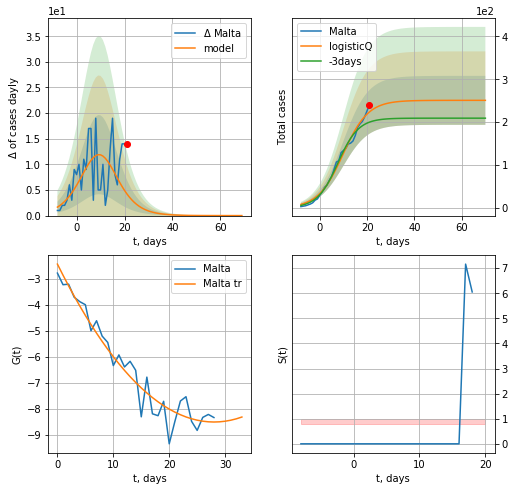

Malta data at: 2020-05-30
+3 day model MAPE: 0.130140
model: logisticQ
coeffs: [ 2.50920068e+02  3.54275509e-06  9.84690922e+00 -5.35768463e+04]
rational stdev: 0.227624
forecast at the end of period: +49 days
	 deltaDaycases: 0
	 total cases: 250 ± 57
	 total death: 3 ± 2
trend coefficient of determination: 0.935484
 intercept_: -2.4264251666881744
 coeffs_: [ 0.         -0.43368994  0.00773877]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


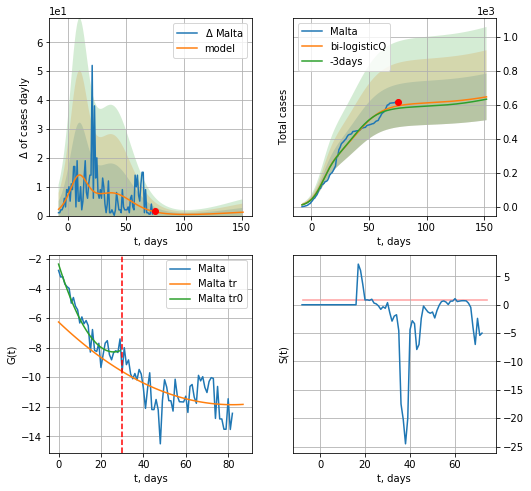

Malta data at: 2020-05-30
+3 day model MAPE: 0.025747
model: bi-logisticQ
coeffs: [ 3.56215405e+02  2.45924628e-07  3.90309705e+01 -3.50318380e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.211452
forecast at the end of period: +77 days
	 deltaDaycases: 1
	 total cases: 646 ± 136
	 total death: 9 ± 5
bi-logisticQ approximation splitting point: 30
trend coefficient of determination: 0.928360
 intercept_: -2.3445378489560733
 coeffs_: [ 0.         -0.45826686  0.00882824]
trend coefficient of determination: 0.269854
 intercept_: -6.263653535178101
 coeffs_: [ 0.         -0.13658134  0.0008327 ]


In [330]:
x = forecastRRR("Malta",dfMT[:30],d1,16*7-dT,addpred=False,xcoef=[0.35/4,.5,3,1.])
xx = forecast2RRR("Malta",dfMT[:],d1,20*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=30)

SL
          date   cases  active  death
77 2020-05-26  1515.0   160.0   28.0
78 2020-05-27  1520.0   160.0   28.0
79 2020-05-28  1520.0   160.0   28.0
80 2020-05-29  1520.0   154.0   28.0
81 2020-05-30  1521.0   137.0   28.0


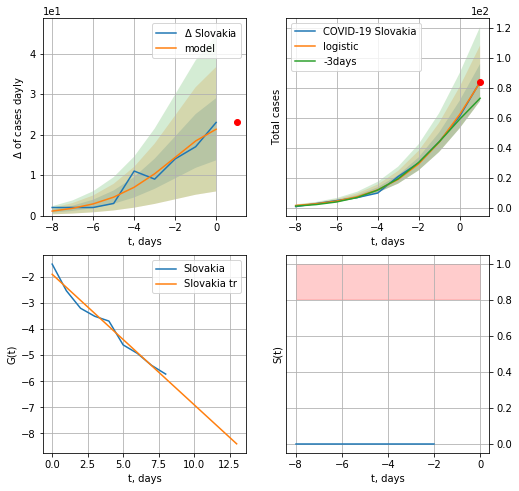

Slovakia data at: 2020-05-30
model: logistic
coeffs:  [177.28786794   0.4996723    1.23158092]
rational stdev:  0.14723856172050678
forecast at the end of period: +0 days
	 deltaDaycases:  21
	 total cases:  83 ± 12
	 total death:  1 ± 0
trend coefficient of determination: 0.974721
 intercept: -1.894823
 slope: -0.500610
Exception ocurs


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


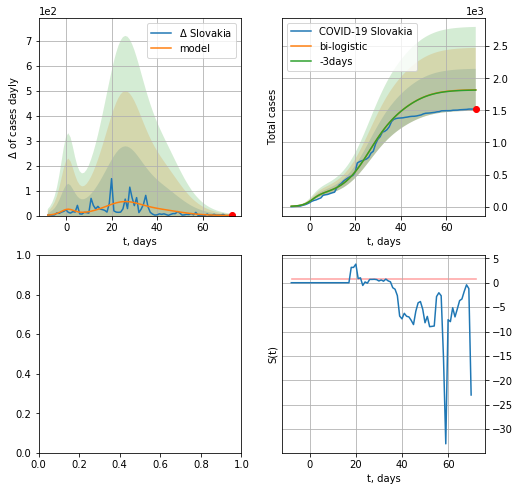

In [331]:
dfSL = read_df(pd.DataFrame(),"SL")
dfSL = dfSL.fillna(0)
try:
    x = forecast("Slovakia",dfSL[:10],d1,9*7-dT,pMAPE=False)
    xx = forecast2("Slovakia",dfSL[:],d1,9*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=10)
except:
    print("Exception ocurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


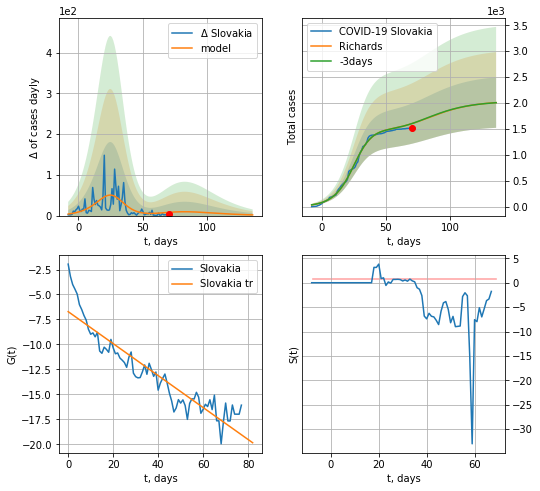

Slovakia data at: 2020-05-27
+3 day model MAPE: 0.000938
model: Richards
coeffs: [1.49905958e+03 1.06741930e-01 2.73944029e+01 1.41477774e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.242422
forecast at the end of period: +66 days
	 deltaDaycases: 1
	 total cases: 2008 ± 486
	 total death: 37 ± 26
trend coefficient of determination: 0.863167
 intercept: -6.718887
 slope: -0.160083


In [76]:
x = forecastRR("Slovakia",dfSL[:],d1,18*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


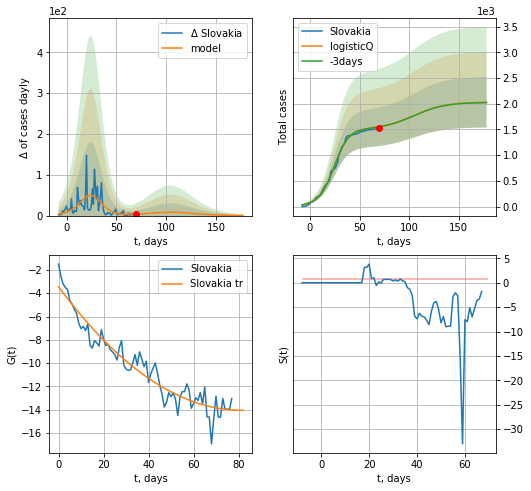

Slovakia data at: 2020-05-27
+3 day model MAPE: 0.002052
model: logisticQ
coeffs: [ 1.50079942e+03  3.99653968e-04  2.39267511e+01 -3.06466920e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.240998
forecast at the end of period: +108 days
	 deltaDaycases: 0
	 total cases: 2027 ± 488
	 total death: 37 ± 26
trend coefficient of determination: 0.919344
 intercept_: -3.452362114364039
 coeffs_: [ 0.         -0.26010482  0.0015971 ]


In [77]:
x = forecastRRR("Slovakia",dfSL[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

SV
          date   cases  active  death
82 2020-05-26  1471.0     9.0  108.0
83 2020-05-27  1471.1     9.0  108.0
84 2020-05-28  1473.0     9.0  108.0
85 2020-05-29  1473.0     8.0  108.0
86 2020-05-30  1473.0     8.0  108.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


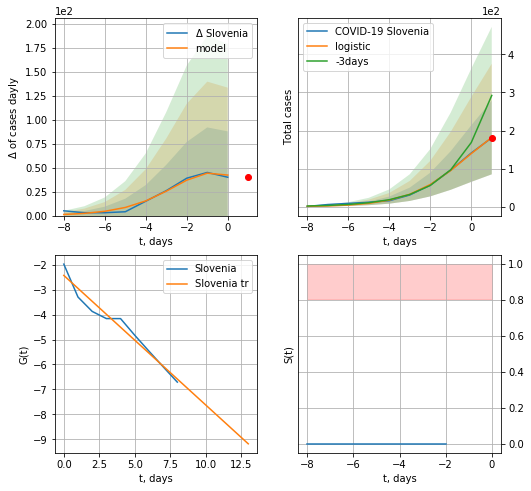

Slovenia data at: 2020-05-30
model: logistic
coeffs:  [ 2.61098711e+02  6.91755378e-01 -2.00021247e-01]
rational stdev:  0.5312441686508605
forecast at the end of period: +0 days
	 deltaDaycases:  42
	 total cases:  181 ± 96
	 total death:  13 ± 20
trend coefficient of determination: 0.958485
 intercept: -2.427236
 slope: -0.519636
Exception occurs


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


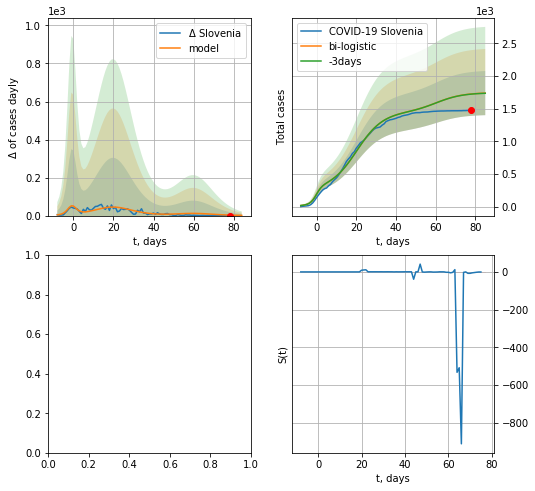

In [332]:
dfSV = read_df(pd.DataFrame(),"SV").fillna(0)
try:
    x = forecast("Slovenia",dfSV[:10],d1,7*9-dT,pMAPE=False)
    xx = forecast2("Slovenia",dfSV[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,3.],vL=10)
except:
    print ("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


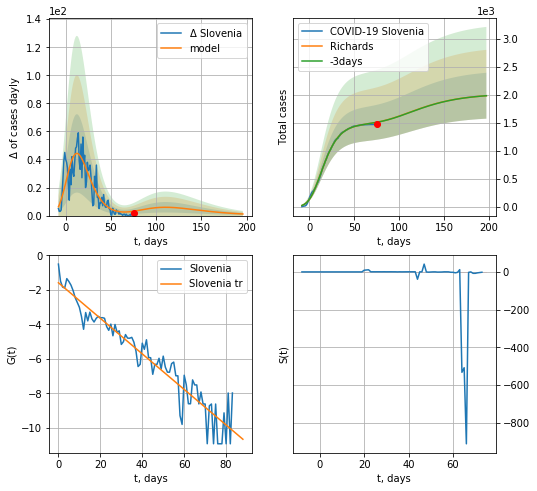

Slovenia data at: 2020-05-28
+3 day model MAPE: 0.000498
model: Richards
coeffs: [ 1.48328029e+03  4.89451853e-01 -6.41382319e+00  1.80936466e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.206727
forecast at the end of period: +121 days
	 deltaDaycases: 1
	 total cases: 1982 ± 409
	 total death: 145 ± 89
trend coefficient of determination: 0.910879
 intercept: -1.586511
 slope: -0.103007


In [320]:
x = forecastRR("Slovenia",dfSV[:],d1,26*7-dT,addpred=True,xcoef=RkoreaCoeffs)

[0.35416971, 0.02606324, 4.35859408, 19.30413219]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


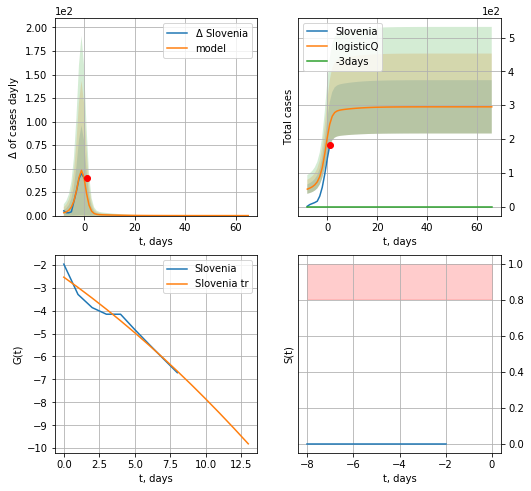

Slovenia data at: 2020-05-28
+3 day model MAPE: inf
model: logisticQ
coeffs: [ 2.17965799e+02  4.01733228e-02 -2.21208435e+01 -7.00287194e-01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.266979
forecast at the end of period: +65 days
	 deltaDaycases: 0
	 total cases: 295 ± 78
	 total death: 21 ± 16
trend coefficient of determination: 0.956027
 intercept_: -2.543480478113449
 coeffs_: [ 0.         -0.43771568 -0.00932819]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:234: RuntimeWarning: divide by zero encountered in double_scalars
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


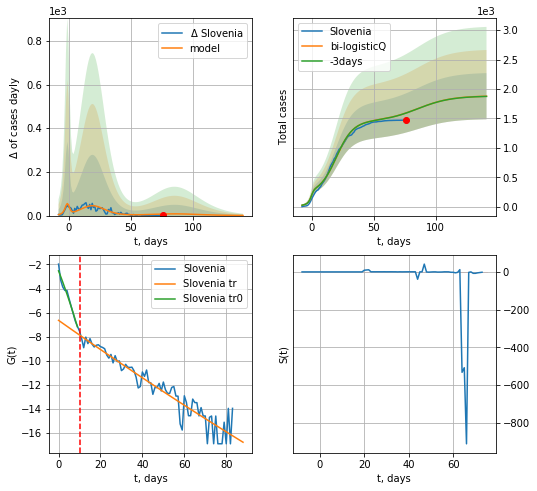

Slovenia data at: 2020-05-28
+3 day model MAPE: 0.001060
model: bi-logisticQ
coeffs: [ 1.23043502e+03  7.07743199e-07  1.96216112e+01 -2.07498912e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.209169
forecast at the end of period: +65 days
	 deltaDaycases: 0
	 total cases: 1877 ± 392
	 total death: 137 ± 85
bi-logisticQ approximation splitting point: 10
trend coefficient of determination: 0.968209
 intercept_: -2.53431844604435
 coeffs_: [ 0.         -0.45029183 -0.00732028]
trend coefficient of determination: 0.907296
 intercept_: -6.641418362191655
 coeffs_: [ 0.00000000e+00 -1.22751222e-01  8.85358814e-05]


In [321]:
print(koreaCoeffs)
x = forecastRRR("Slovenia",dfSV[:10],d1,18*7-dT,addpred=True,xcoef=koreaCoeffs)
xx = forecast2RRR("Slovenia",dfSV[:],d1,18*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=10)

SB
          date  cases  active  death
77 2020-05-26  11227  4921.0  239.0
78 2020-05-27  11275  4758.0  240.0
79 2020-05-28  11300  4621.0  241.0
80 2020-05-29  11354  4588.0  242.0
81 2020-05-30  11381  4533.0  242.0


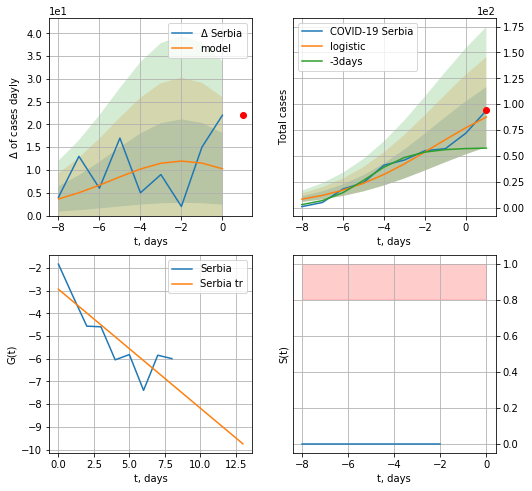

Serbia data at: 2020-05-30
model: logistic
coeffs:  [119.86809018   0.40041874  -1.48148467]
rational stdev:  0.3321032925412913
forecast at the end of period: +0 days
	 deltaDaycases:  10
	 total cases:  87 ± 29
	 total death:  1 ± 0
trend coefficient of determination: 0.723021
 intercept: -2.939233
 slope: -0.523684


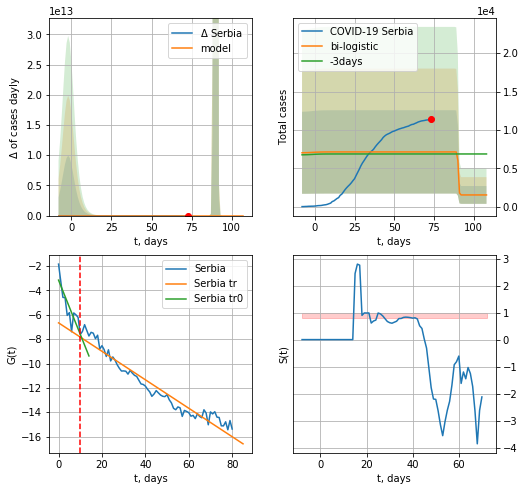

Serbia data at: 2020-05-30
+3 day model MAPE: 0.03887105454100577
model: bi-logistic
coeffs:  [ 5.60651831e+03 -4.42466745e+00  9.03146828e+01] [119.86809018   0.40041874  -1.48148467]
scenario coeffs:  [0.25, 1.0, 2.2]
rational stdev:  0.761839530962798
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  1521 ± 1159
	 total death:  32 ± 73
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.680312
 intercept: -3.149496
 slope: -0.444835
trend coefficient of determination: 0.941871
 intercept: -6.659554
 slope: -0.116938


In [333]:
dfSB = read_df(pd.DataFrame(),"SB")
dfSB = dfSB.fillna(0)
x = forecast("Serbia",dfSB[:10],d1,9*7-dT,pMAPE=False)
xx = forecast2("Serbia",dfSB[:],d1,14*7-dT,x,addpred=True,xcoef=[0.25,1.,2.2],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


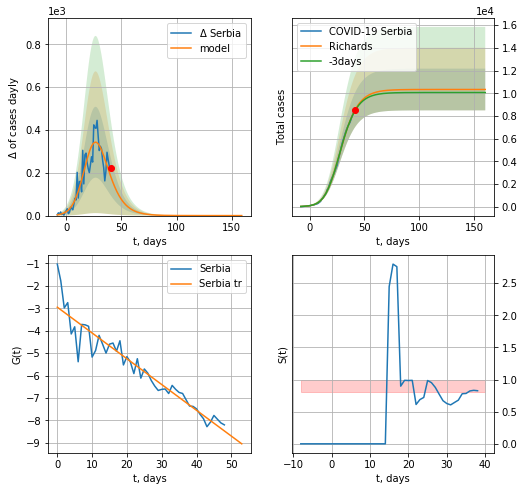

Serbia data at: 2020-05-30
+3 day model MAPE: 0.007628
model: Richards
coeffs: [1.03310156e+04 2.23147111e-01 2.10152369e+01 5.03005273e-01]
rational stdev: 0.178090
forecast at the end of period: +119 days
	 deltaDaycases: 0
	 total cases: 10331 ± 1839
	 total death: 219 ± 117
trend coefficient of determination: 0.905867
 intercept: -2.952078
 slope: -0.114857


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


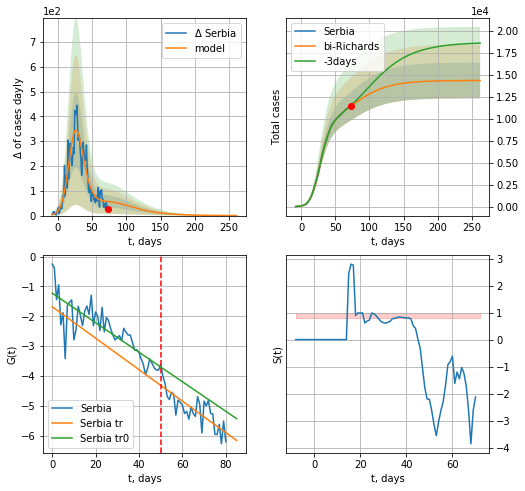

Serbia data at: 2020-05-30
+3 day model MAPE: 0.008209
model: bi-Richards
coeffs: [ 4.01109467e+03  2.04981285e+00 -3.50738953e+01  1.73002425e-02]
rational stdev: 0.141646
forecast at the end of period: +189 days
	 deltaDaycases: 0
	 total cases: 14335 ± 2030
	 total death: 304 ± 129
bi-Richards approximation splitting point: 50
trend coefficient of determination: 0.687961
 intercept: -1.224039
 slope: -0.049504
trend coefficient of determination: 0.629379
 intercept: -1.677896
 slope: -0.052757


In [334]:
vL=50
x = forecastRR("Serbia",dfSB[:vL],d1,26*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Serbia",dfSB[:],d1,36*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


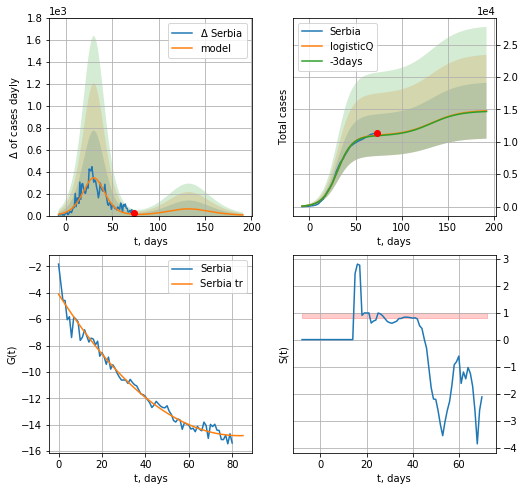

Serbia data at: 2020-05-30
+3 day model MAPE: 0.008407
model: logisticQ
coeffs: [ 1.09863233e+04  8.89558326e-07  3.04765872e+01 -1.40407479e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.291644
forecast at the end of period: +119 days
	 deltaDaycases: 5
	 total cases: 14785 ± 4311
	 total death: 314 ± 274
trend coefficient of determination: 0.977905
 intercept_: -4.103114375297279
 coeffs_: [ 0.         -0.25754665  0.00154616]


In [335]:
x = forecastRRR("Serbia",dfSB[:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs)

CT
          date   cases  active  death
87 2020-05-26  2244.3    97.0  101.0
88 2020-05-27  2244.4    96.0  101.0
89 2020-05-28  2245.0    92.0  102.0
90 2020-05-29  2245.5    83.0  103.0
91 2020-05-30  2246.0    80.0  103.0


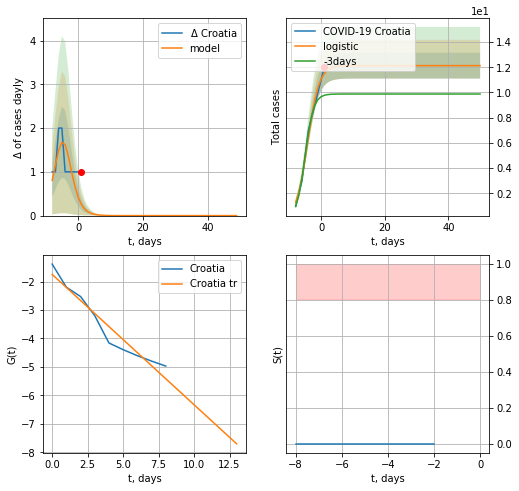

Croatia data at: 2020-05-30
model: logistic
coeffs:  [12.13023855  0.55939634 -4.20963748]
rational stdev:  0.08430442468045289
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  12 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.936719
 intercept: -1.749041
 slope: -0.458074


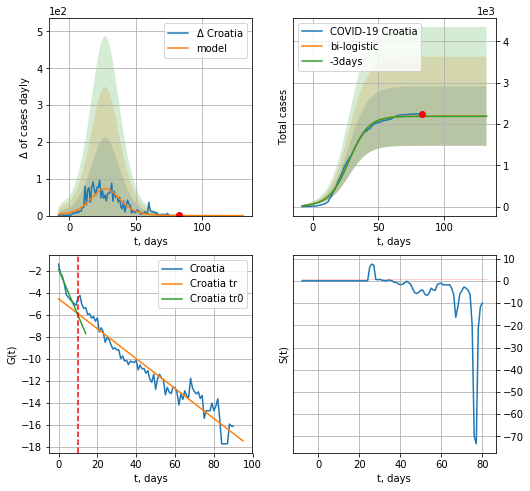

Croatia data at: 2020-05-30
+3 day model MAPE: 0.0029003671064524
model: bi-logistic
coeffs:  [2.18135834e+03 1.34702440e-01 2.75513853e+01] [12.13023855  0.55939634 -4.20963748]
rational stdev:  0.328001891887892
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  2193 ± 719
	 total death:  100 ± 98
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.922384
 intercept: -1.856940
 slope: -0.417612
trend coefficient of determination: 0.929545
 intercept: -4.538938
 slope: -0.136150


In [337]:
dfCT = read_df(pd.DataFrame(),"CT")
dfCT = dfCT.fillna(0)
x = forecast("Croatia",dfCT[:10],d1,16*7-dT,pMAPE=False)
xx = forecast2("Croatia",dfCT[:],d1,16*7-dT,x,addpred=False,xcoef=[0.25/2,1.,2.],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


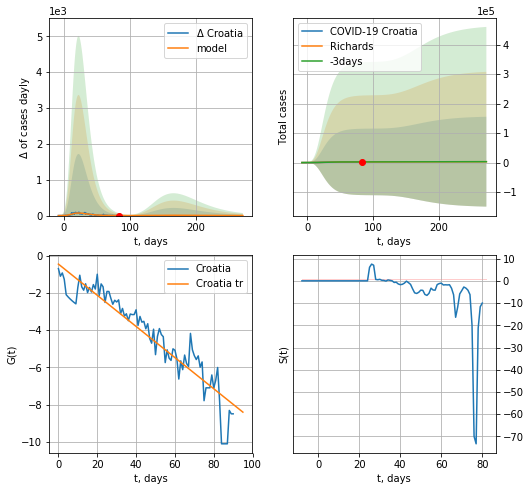

Croatia data at: 2020-05-30
+3 day model MAPE: 0.000512
model: Richards
coeffs: [ 2.25104972e+03  8.29276684e+00 -2.94783181e+01  1.04990384e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 50.248056
forecast at the end of period: +189 days
	 deltaDaycases: 1
	 total cases: 3032 ± 152358
	 total death: 139 ± 20953
trend coefficient of determination: 0.872409
 intercept: -0.459444
 slope: -0.083592


In [338]:
x = forecastRR("Croatia",dfCT[:],d1,36*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


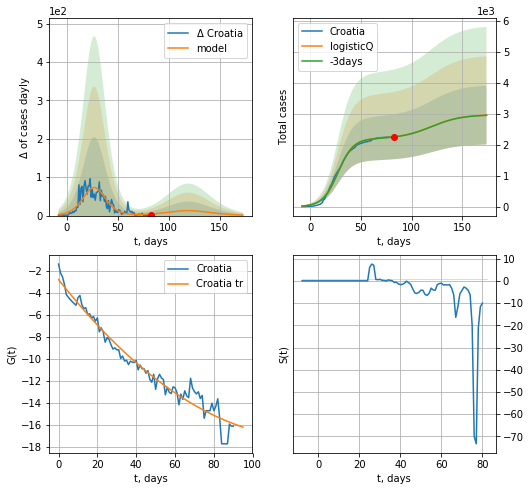

Croatia data at: 2020-05-30
+3 day model MAPE: 0.002735
model: logisticQ
coeffs: [ 2.19487638e+03  6.52286206e-07  2.74536232e+01 -2.04218889e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.321172
forecast at the end of period: +91 days
	 deltaDaycases: 1
	 total cases: 2952 ± 948
	 total death: 135 ± 130
trend coefficient of determination: 0.960554
 intercept_: -2.7927550757638206
 coeffs_: [ 0.         -0.22407251  0.00087141]


In [339]:
x = forecastRRR("Croatia",dfCT[:],d1,22*7-dT,addpred=True,xcoef=koreaCoeffs)

EG
          date  cases  active  death
81 2020-05-26  18756   12932  797.0
82 2020-05-27  19666   13645  816.0
83 2020-05-28  20793   14589  845.0
84 2020-05-29  22082   15692  879.0
85 2020-05-30  23449   16843  913.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


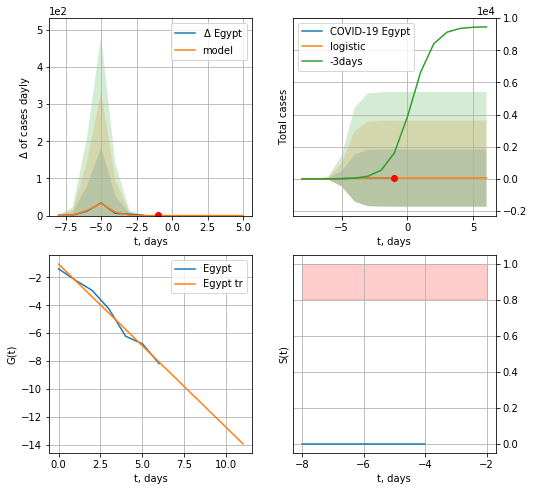

Egypt data at: 2020-05-30
+3 day model MAPE: 0.9848657964650105
model: logistic
coeffs:  [58.57021122  2.53530653 -4.60228222]
rational stdev:  30.428321363178444
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  58 ± 1782
	 total death:  2 ± 182
trend coefficient of determination: 0.982412
 intercept: -1.045837
 slope: -1.172929


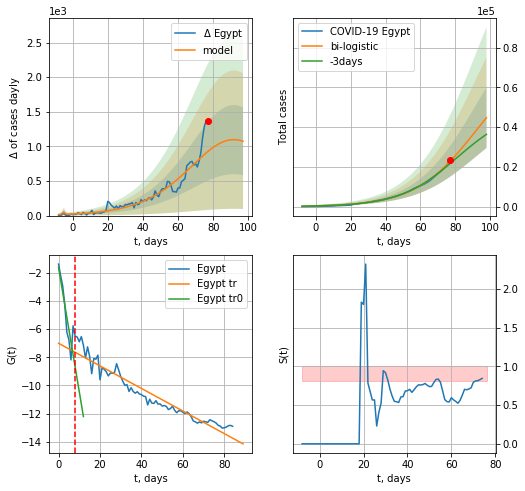

Egypt data at: 2020-05-30
+3 day model MAPE: 0.05717837789418012
model: bi-logistic
coeffs:  [7.41749928e+04 5.77590502e-02 9.14498945e+01] [58.57021122  2.53530653 -4.60228222]
scenario coeffs:  [0.25, 1.0, 1.7]
rational stdev:  0.34020824068843003
forecast at the end of period: +21 days
	 deltaDaycases:  1074
	 total cases:  44726 ± 15216
	 total death:  1741 ± 1776
bi-logistic approximation splitting point: 8
trend0 coefficient of determination: 0.807637
 intercept: -1.627174
 slope: -0.882261
trend coefficient of determination: 0.924981
 intercept: -7.008294
 slope: -0.080242


In [341]:
dfEG = read_df(pd.DataFrame(),"EG")
x = forecast("Egypt",dfEG[:8],d1,7*10-dT)
xx = forecast2("Egypt",dfEG[:],d1,12*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=8)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


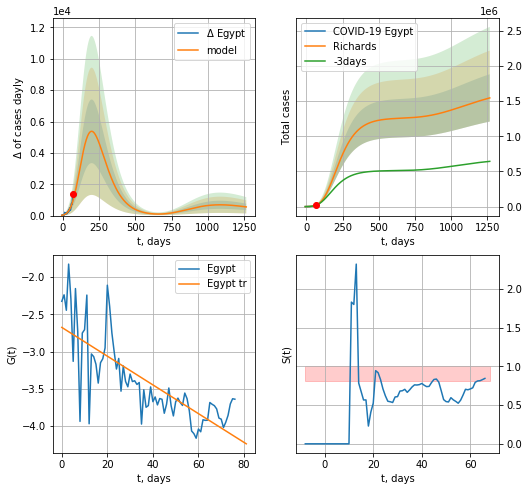

Egypt data at: 2020-05-30
+3 day model MAPE: 0.041430
model: Richards
coeffs: [ 1.26211806e+06  1.52062455e-01 -1.23597222e+01  7.91561222e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.217727
forecast at the end of period: +1197 days
	 deltaDaycases: 553
	 total cases: 1546986 ± 336820
	 total death: 60232 ± 39342
trend coefficient of determination: 0.604287
 intercept: -2.676229
 slope: -0.019266


In [342]:
x = forecastRR("Egypt",dfEG[8:],d1,180*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


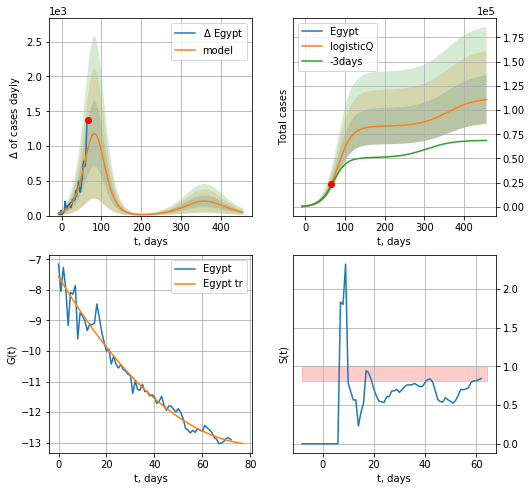

Egypt data at: 2020-05-30
+3 day model MAPE: 0.058746
model: logisticQ
coeffs: [ 8.31581875e+04  8.90480208e-06  8.24359505e+01 -6.29018591e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.225764
forecast at the end of period: +392 days
	 deltaDaycases: 47
	 total cases: 110863 ± 25028
	 total death: 4316 ± 2923
trend coefficient of determination: 0.967415
 intercept_: -7.568978072713167
 coeffs_: [ 0.         -0.1306382   0.00077548]


In [343]:
x = forecastRRR("Egypt",dfEG[12:],d1,65*7-dT,addpred=True,xcoef=koreaCoeffs)

IQ
          date  cases  active  death
84 2020-05-26   4848  1827.0  169.0
85 2020-05-27   5135  2056.0  175.0
86 2020-05-28   5457  2307.0  179.0
87 2020-05-29   5873  2644.0  185.0
88 2020-05-30   6179  2874.0  195.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


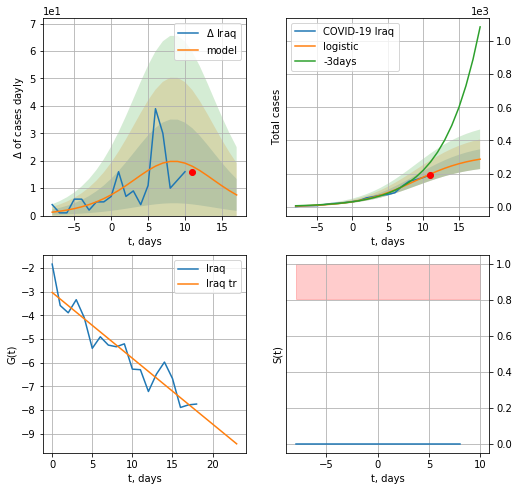

Iraq data at: 2020-05-30
+3 day model MAPE: 0.3447403684117319
model: logistic
coeffs:  [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.20777406895257303
forecast at the end of period: +7 days
	 deltaDaycases:  7
	 total cases:  287 ± 59
	 total death:  9 ± 5
trend coefficient of determination: 0.889033
 intercept: -3.031672
 slope: -0.278416


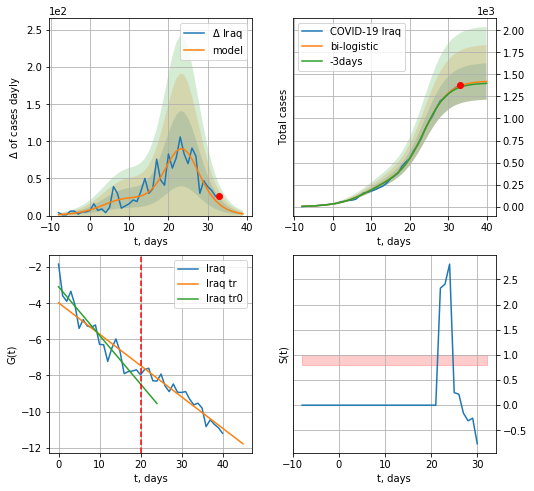

Iraq data at: 2020-05-30
+3 day model MAPE: 0.012548655608678476
model: bi-logistic
coeffs:  [1.10877596e+03 3.20225975e-01 2.39035989e+01] [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.14537179336300032
forecast at the end of period: +7 days
	 deltaDaycases:  2
	 total cases:  1419 ± 206
	 total death:  44 ± 19
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend coefficient of determination: 0.928562
 intercept: -3.976586
 slope: -0.173518


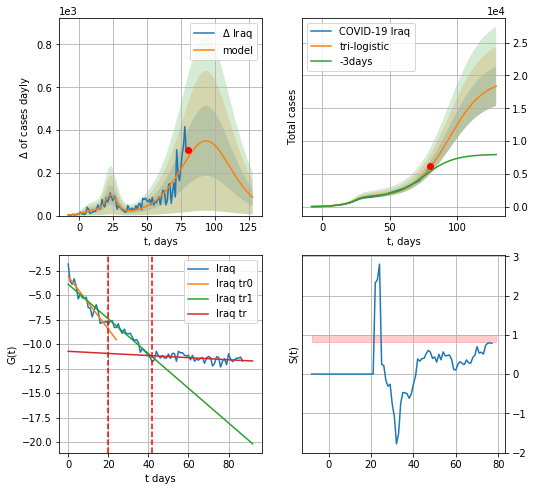

Iraq data at: 2020-05-30
+3 day model MAPE: 0.1325839084463969
model: tri-logistic
coeffs:  [1.80750024e+04 7.73680631e-02 9.41498799e+01] [3.17081296e+02 2.50431387e-01 8.98163530e+00 1.10877596e+03
 3.20225975e-01 2.39035989e+01]
forecast rational stdev:  0.16412006094054452
forecast at the end of period: +49 days
	 deltaDaycases:  85
	 total cases:  18358 ± 3013
	 total death:  579 ± 285
tri-logistic approximation splitting points: 20,42
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend1 coefficient of determination: 0.937217
 intercept: -3.879636
 slope: -0.177153
trend coefficient of determination: 0.152188
 intercept: -10.735320
 slope: -0.010749


In [345]:
vL=20
vL1=42
dfIQ = read_df(pd.DataFrame(),"IQ")
dfIQ = dfIQ.fillna(0)
x = forecast("Iraq",dfIQ[:vL],d1,10*7-dT)
xx = forecast2("Iraq",dfIQ[:vL1],d1,10*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Iraq",dfIQ[:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

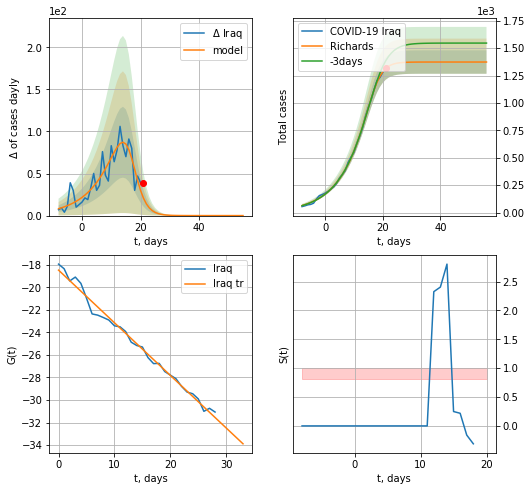

Iraq data at: 2020-05-30
+3 day model MAPE: 0.063091
model: Richards
coeffs: [1.37376214e+03 1.20916969e-01 1.73787930e+01 3.83489487e+00]
rational stdev: 0.077793
forecast at the end of period: +35 days
	 deltaDaycases: 0
	 total cases: 1373 ± 106
	 total death: 43 ± 10
trend coefficient of determination: 0.989067
 intercept: -18.464339
 slope: -0.467498


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


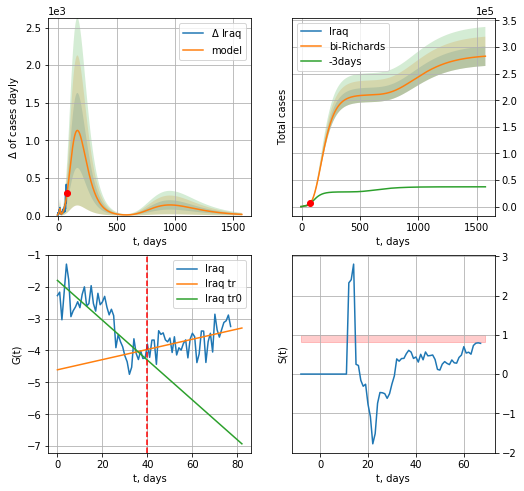

Iraq data at: 2020-05-30
+3 day model MAPE: 0.091976
model: bi-Richards
coeffs: [ 2.08872549e+05  5.40274730e-01 -7.65094000e+01  2.76580593e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.064916
forecast at the end of period: +1505 days
	 deltaDaycases: 15
	 total cases: 282783 ± 18357
	 total death: 8924 ± 1737
bi-Richards approximation splitting point: 40
trend coefficient of determination: 0.686847
 intercept: -1.800892
 slope: -0.062519
trend coefficient of determination: 0.198971
 intercept: -4.605346
 slope: 0.015978


In [347]:
vL=40
x = forecastRR("Iraq",dfIQ[10:vL],d1,14*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Iraq",dfIQ[10:],d1,224*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL)

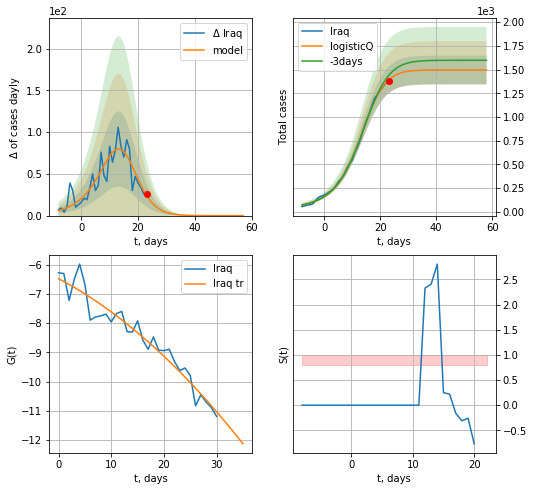

Iraq data at: 2020-05-30
+3 day model MAPE: 0.037622
model: logisticQ
coeffs: [ 1.49506808e+03  3.17947912e-03  1.23994223e+01 -5.37356409e+01]
rational stdev: 0.101331
forecast at the end of period: +35 days
	 deltaDaycases: 0
	 total cases: 1495 ± 151
	 total death: 47 ± 14
trend coefficient of determination: 0.935701
 intercept_: -6.475161114969037
 coeffs_: [ 0.         -0.094783   -0.00191217]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


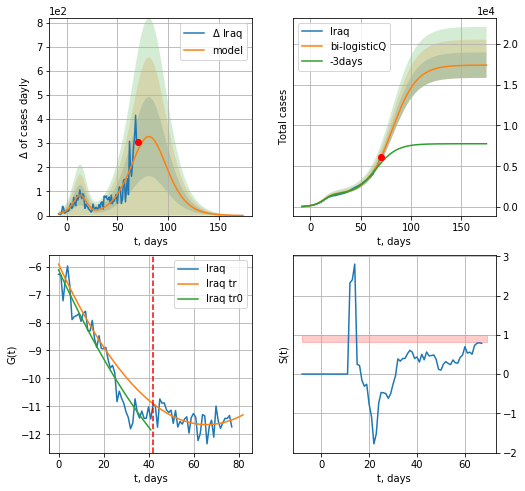

Iraq data at: 2020-05-30
+3 day model MAPE: 0.133992
model: bi-logisticQ
coeffs: [ 1.59005681e+04  1.80213602e-05  8.14131159e+01 -4.49214221e+03]
rational stdev: 0.089807
forecast at the end of period: +105 days
	 deltaDaycases: 0
	 total cases: 17389 ± 1561
	 total death: 548 ± 147
bi-logisticQ approximation splitting point: 42
trend coefficient of determination: 0.938502
 intercept_: -6.116864757771229
 coeffs_: [ 0.         -0.176838    0.00090835]
trend coefficient of determination: 0.333045
 intercept_: -5.910707476703982
 coeffs_: [ 0.         -0.17460439  0.0013273 ]


In [348]:
x = forecastRRR("Iraq",dfIQ[10:42],d1,14*7-dT,addpred=False,xcoef=[0.35,.5,4.,1])
xx = forecast2RRR("Iraq",dfIQ[10:],d1,24*7-dT,x,addpred=False,xcoef=koreaCoeffs,vL=42)

In [349]:
#len(dfAR)

AR
          date   cases  active  death
83 2020-05-26  8697.0  3162.0  617.0
84 2020-05-27  8857.0  3105.0  623.0
85 2020-05-28  8997.0  3090.0  630.0
86 2020-05-29  9134.0  3074.0  638.0
87 2020-05-30  9267.0  3072.0  646.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


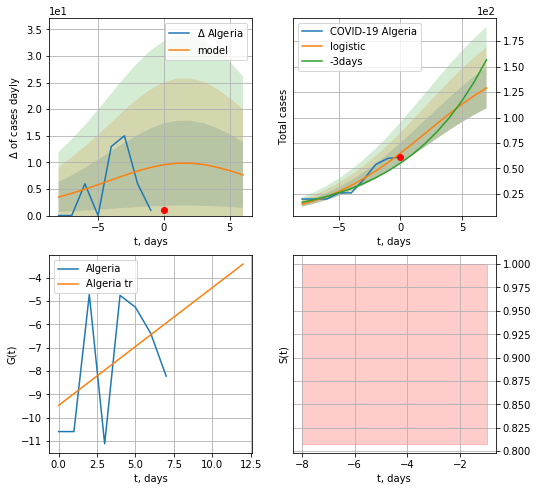

Algeria data at: 2020-05-30
+3 day model MAPE: 0.16392556519478307
model: logistic
coeffs:  [169.67177645   0.23328983   2.04237406]
rational stdev:  0.15467845008978148
forecast at the end of period: +7 days
	 deltaDaycases:  7
	 total cases:  129 ± 19
	 total death:  8 ± 3
trend coefficient of determination: 0.198482
 intercept: -9.477734
 slope: 0.504434


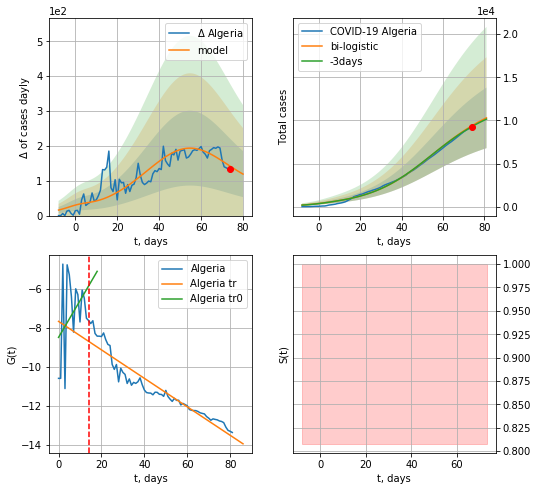

Algeria data at: 2020-05-30
+3 day model MAPE: 0.011133250773017942
model: bi-logistic
coeffs:  [1.14338668e+04 6.59086090e-02 5.44289313e+01] [169.67177645   0.23328983   2.04237406]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.3409410201033064
forecast at the end of period: +7 days
	 deltaDaycases:  119
	 total cases:  10305 ± 3513
	 total death:  718 ± 734
bi-logistic approximation splitting point: 14
trend0 coefficient of determination: 0.134003
 intercept: -8.492024
 slope: 0.188486
trend coefficient of determination: 0.902230
 intercept: -7.670473
 slope: -0.073146


In [351]:
dfAR = read_df(pd.DataFrame(),"AR")
x = forecast("Algeria",dfAR[5:14],d1,7*10-dT)
xx = forecast2("Algeria",dfAR[5:],d1,7*10-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=14)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


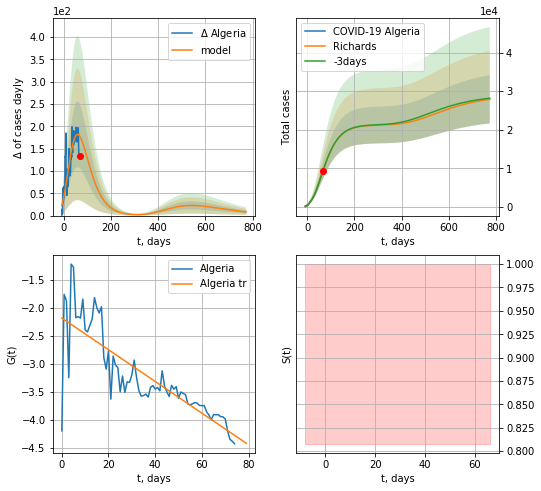

Algeria data at: 2020-05-30
+3 day model MAPE: 0.002676
model: Richards
coeffs: [ 2.12814905e+04  1.20319901e+00 -1.08693333e+02  1.95061272e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.224506
forecast at the end of period: +707 days
	 deltaDaycases: 8
	 total cases: 27882 ± 6259
	 total death: 1943 ± 1308
trend coefficient of determination: 0.678514
 intercept: -2.184065
 slope: -0.028199


In [352]:
x = forecastRR("Algeria",dfAR[12:],d1,110*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


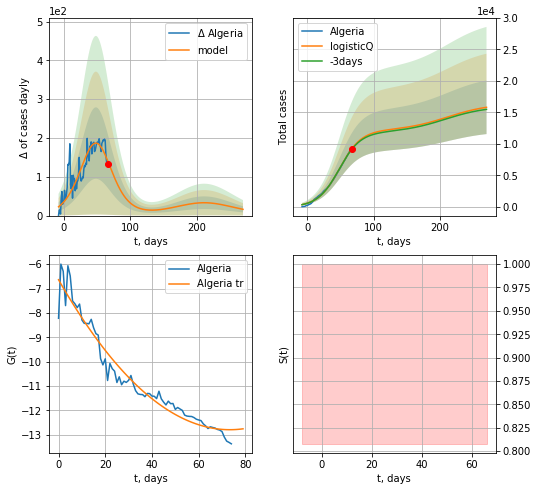

Algeria data at: 2020-05-30
+3 day model MAPE: 0.009455
model: logisticQ
coeffs: [ 1.21150916e+04  1.10235783e-06  4.84463060e+01 -5.56687139e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.268784
forecast at the end of period: +203 days
	 deltaDaycases: 16
	 total cases: 15806 ± 4248
	 total death: 1101 ± 887
trend coefficient of determination: 0.949363
 intercept_: -6.637430974895313
 coeffs_: [ 0.         -0.16794641  0.00114453]


In [353]:
x = forecastRRR("Algeria",dfAR[12:],d1,38*7-dT,addpred=True,xcoef=koreaCoeffs)

CP
          date  cases  active  death
75 2020-05-26  939.0   328.0   17.0
76 2020-05-27  939.5   328.0   17.0
77 2020-05-28  941.0   140.0   17.0
78 2020-05-29  942.0   141.0   17.0
79 2020-05-30  944.0   137.0   17.0


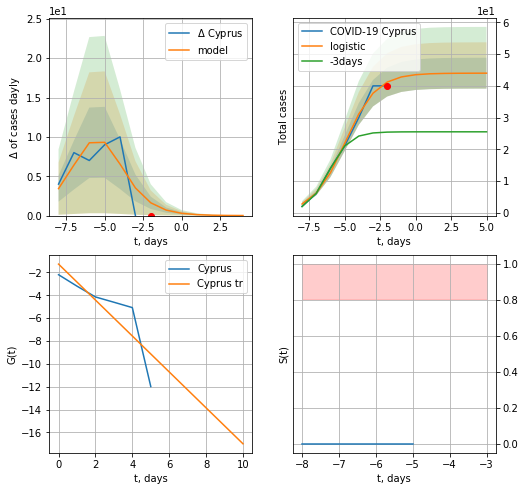

Cyprus data at: 2020-05-30
+3 day model MAPE: 0.6804910041763989
model: logistic
coeffs:  [44.00930084  0.89972657 -4.98223467]
rational stdev:  0.11057143078785021
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  44 ± 4
	 total death:  0 ± 0
trend coefficient of determination: 0.714597
 intercept: -1.270285
 slope: -1.572073


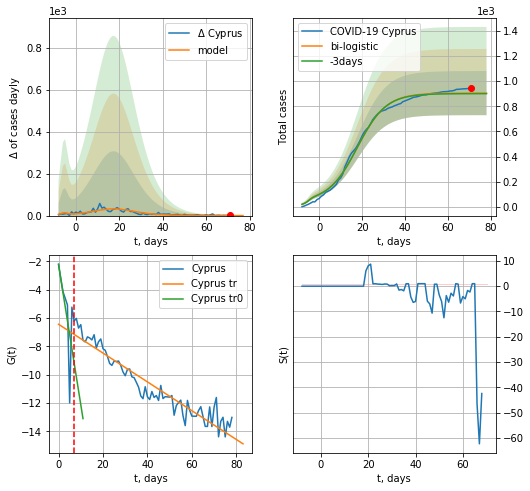

Cyprus data at: 2020-05-30
+3 day model MAPE: 0.005024895609497075
model: bi-logistic
coeffs:  [8.61325946e+02 1.48565252e-01 1.78422298e+01] [44.00930084  0.89972657 -4.98223467]
rational stdev:  0.19394563047195357
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  905 ± 175
	 total death:  16 ± 9
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.449603
 intercept: -2.247366
 slope: -0.985825
trend coefficient of determination: 0.903804
 intercept: -6.441183
 slope: -0.101551


In [355]:
dfCP = read_df(pd.DataFrame(),"CP")
dfCP = dfCP.fillna(0)
x = forecast("Cyprus",dfCP[:7],d1,7*10-dT)
xx = forecast2("Cyprus",dfCP[:],d1,10*7-dT,x,addpred=False,xcoef=[0.25,1.,2.3],vL=7)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


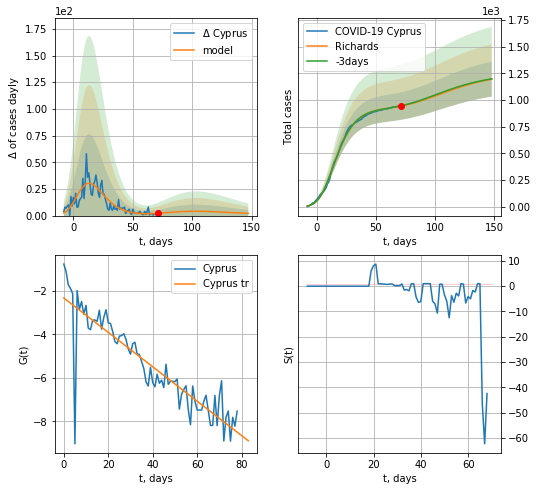

Cyprus data at: 2020-05-30
+3 day model MAPE: 0.002270
model: Richards
coeffs: [ 9.27643816e+02  4.86952522e-01 -2.74343060e+00  2.00415951e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.136542
forecast at the end of period: +77 days
	 deltaDaycases: 2
	 total cases: 1195 ± 163
	 total death: 21 ± 8
trend coefficient of determination: 0.790388
 intercept: -2.322687
 slope: -0.079152


In [356]:
vL=56
x = forecastRR("Cyprus",dfCP[:],d1,20*7-dT,addpred=True,xcoef=RkoreaCoeffs)
#x = forecast2RR("Cyprus",dfCP[:],d1,20*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


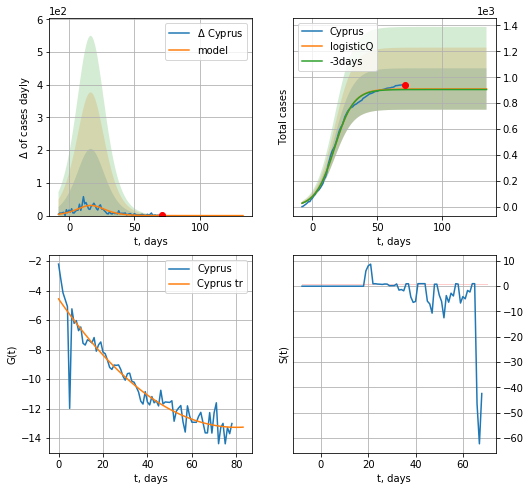

Cyprus data at: 2020-05-30
+3 day model MAPE: 0.004621
model: logisticQ
coeffs: [ 9.09412677e+02  7.94520220e-07  1.70297541e+01 -1.72078268e+05]
rational stdev: 0.175537
forecast at the end of period: +63 days
	 deltaDaycases: 0
	 total cases: 909 ± 159
	 total death: 16 ± 8
trend coefficient of determination: 0.887488
 intercept_: -4.554835107668598
 coeffs_: [ 0.         -0.2174064   0.00135648]


In [357]:
vL=33
x = forecastRRR("Cyprus",dfCP[:],d1,18*7-dT,addpred=False,xcoef=koreaCoeffs)
#xx = forecast2RRR("Cyprus",dfCP[:],d1,20*7-dT,x,addpred=True,xcoef=[0.35,.5,4,1],vL=vL)

PU
          date   cases   active   death
80 2020-05-26  129751  73057.0  3788.0
81 2020-05-27  135905  75753.0  3983.0
82 2020-05-28  141779  78238.0  4099.0
83 2020-05-29  148285  81264.0  4230.0
84 2020-05-30  155671  84853.0  4371.0


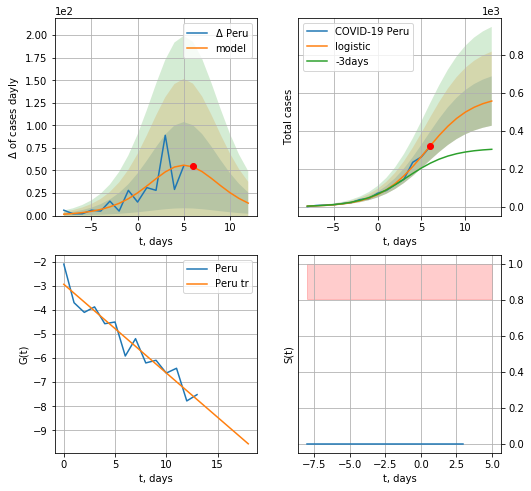

Peru data at: 2020-05-30
+3 day model MAPE: 0.4976759510371563
model: logistic
coeffs:  [5.88914141e+02 3.80777382e-01 5.52424877e+00]
rational stdev:  0.23355774891059702
forecast at the end of period: +7 days
	 deltaDaycases:  13
	 total cases:  556 ± 130
	 total death:  15 ± 10
trend coefficient of determination: 0.924015
 intercept: -2.937528
 slope: -0.367722


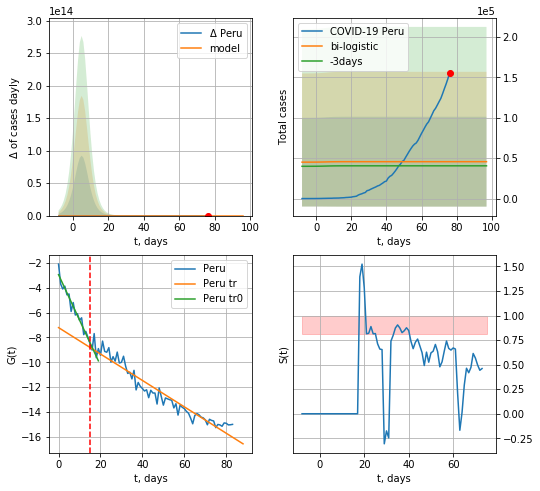

Peru data at: 2020-05-30
+3 day model MAPE: 0.1262473798958406
model: bi-logistic
coeffs:  [ 3.60599968e+04 -5.17874235e+00  1.37662680e+02] [5.88914141e+02 3.80777382e-01 5.52424877e+00]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  1.217941977194836
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  45663 ± 55615
	 total death:  1282 ± 4684
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.936345
 intercept: -2.948740
 slope: -0.365135
trend coefficient of determination: 0.933598
 intercept: -7.212412
 slope: -0.106312


In [359]:
dfPU = read_df(pd.DataFrame(),"PU")
dfPU = dfPU.fillna(0)
x = forecast("Peru",dfPU[:15],d1,7*10-dT)
xx = forecast2("Peru",dfPU[:],d1,12*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=15)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


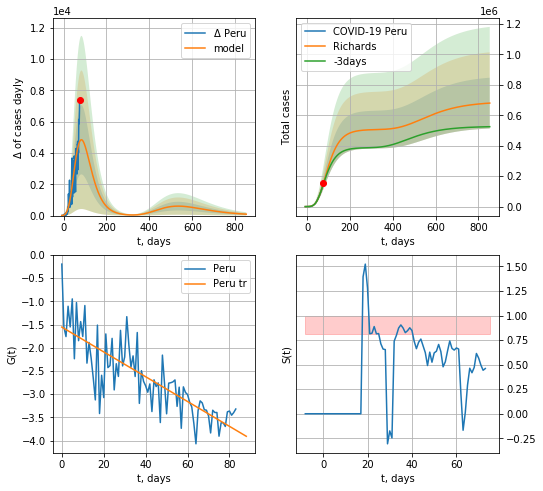

Peru data at: 2020-05-30
+3 day model MAPE: 0.033512
model: Richards
coeffs: [ 5.06727411e+05  1.15992678e+00 -5.99631037e+01  2.26821570e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.245367
forecast at the end of period: +777 days
	 deltaDaycases: 89
	 total cases: 680123 ± 166879
	 total death: 19096 ± 14056
trend coefficient of determination: 0.656665
 intercept: -1.554598
 slope: -0.026723


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


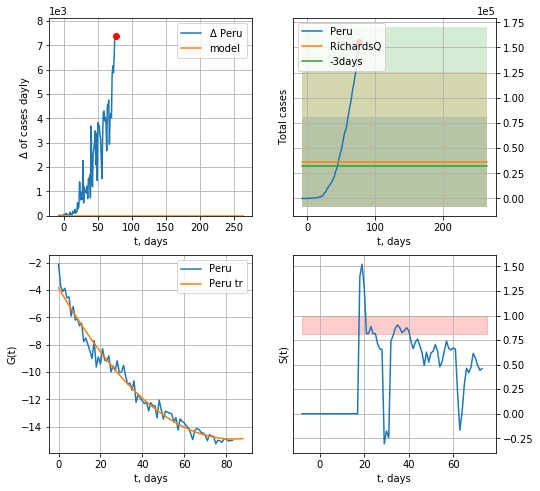

Peru data at: 2020-05-30
+3 day model MAPE: 0.126291
model: RichardsQ
coeffs: [ 3.65516587e+04  1.40951293e+01 -2.07201220e+03  1.77976084e+03
 -4.82997158e+00]
rational stdev: 1.221189
forecast at the end of period: +189 days
	 deltaDaycases: 0
	 total cases: 36551 ± 44636
	 total death: 1026 ± 3758
trend coefficient of determination: 0.977621
 intercept_: -3.8337154091994057
 coeffs_: [ 0.         -0.26619232  0.00159909]


In [361]:
x = forecastRR("Peru",dfPU[:],d1,120*7-dT,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR("Peru",dfPU[:],d1,36*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


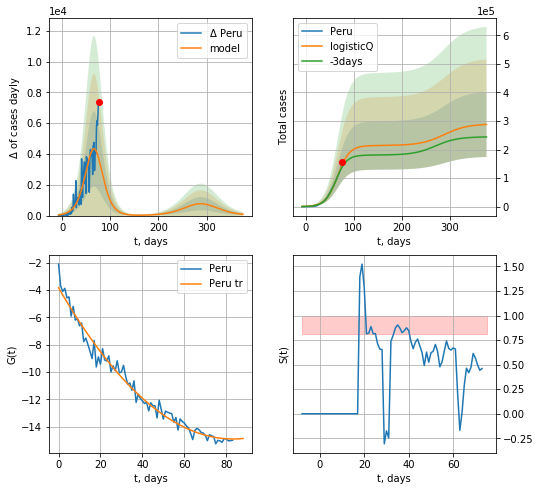

Peru data at: 2020-05-30
+3 day model MAPE: 0.063893
model: logisticQ
coeffs: [ 2.14065959e+05  1.54615812e-06  6.61553002e+01 -5.23142351e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.395759
forecast at the end of period: +301 days
	 deltaDaycases: 80
	 total cases: 287883 ± 113932
	 total death: 8083 ± 9596
trend coefficient of determination: 0.977621
 intercept_: -3.8337154091994057
 coeffs_: [ 0.         -0.26619232  0.00159909]


In [362]:
x = forecastRRR("Peru",dfPU[:].fillna(0),d1,52*7-dT,addpred=True,xcoef=koreaCoeffs)

ID
          date   cases   active   death
87 2020-05-26  151876  83104.0  4346.0
88 2020-05-27  158333  86050.0  4534.0
89 2020-05-28  165799  89982.0  4711.0
90 2020-05-29  173763  86156.0  4980.0
91 2020-05-30  182490  90320.0  5186.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


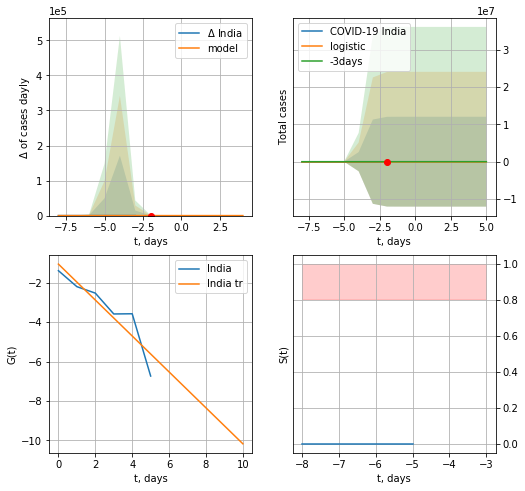

India data at: 2020-05-30
+3 day model MAPE: 0.19485949734745373
model: logistic
coeffs:  [29.40035511  4.01433678 -3.67575724]
rational stdev:  409363.3184161478
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  29 ± 12035426
	 total death:  0 ± 0
trend coefficient of determination: 0.835838
 intercept: -1.052904
 slope: -0.912220


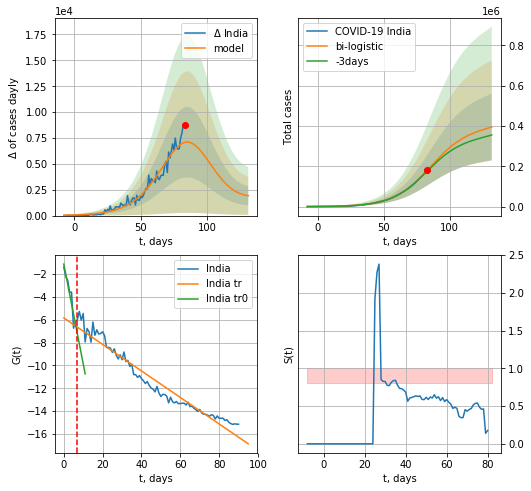

India data at: 2020-05-30
+3 day model MAPE: 0.02432546916628837
model: bi-logistic
coeffs:  [3.90736691e+05 7.22089449e-02 8.52513420e+01] [29.40035511  4.01433678 -3.67575724]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.41917463577397535
forecast at the end of period: +49 days
	 deltaDaycases:  1928
	 total cases:  394963 ± 165558
	 total death:  11224 ± 14114
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.879788
 intercept: -1.115653
 slope: -0.874570
trend coefficient of determination: 0.946640
 intercept: -5.833386
 slope: -0.116209


In [364]:
dfID = read_df(pd.DataFrame(),"ID")
dfID = dfID.fillna(0)
x = forecast("India",dfID[:7],d1,7*10-dT)
xx = forecast2("India",dfID[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=7)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


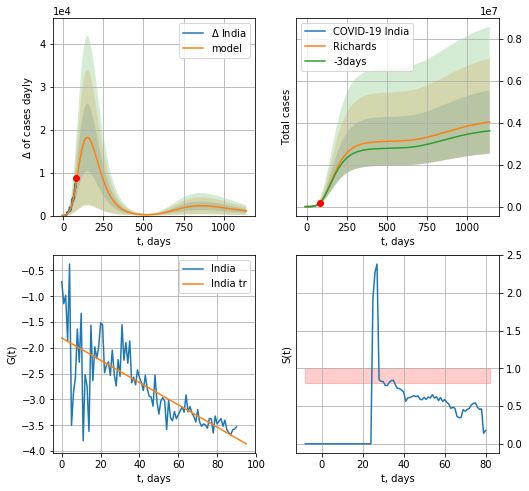

India data at: 2020-05-30
+3 day model MAPE: 0.006433
model: Richards
coeffs: [ 3.12642748e+06  3.98801020e-01 -4.67229344e+01  4.05781604e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.374255
forecast at the end of period: +1057 days
	 deltaDaycases: 1070
	 total cases: 4044120 ± 1513531
	 total death: 114925 ± 129033
trend coefficient of determination: 0.583252
 intercept: -1.808235
 slope: -0.021591


In [365]:
x = forecastRR("India",dfID[:],d1,160*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


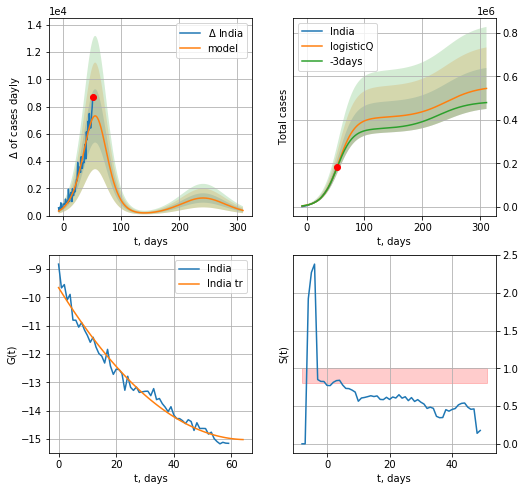

India data at: 2020-05-30
+3 day model MAPE: 0.021007
model: logisticQ
coeffs: [ 4.10168653e+05  1.38190270e-05  5.54330466e+01 -5.10671629e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.173100
forecast at the end of period: +259 days
	 deltaDaycases: 377
	 total cases: 544124 ± 94188
	 total death: 15462 ± 8029
trend coefficient of determination: 0.978565
 intercept_: -9.654087539187866
 coeffs_: [ 0.         -0.16438838  0.00125804]


In [366]:
x = forecastRRR("India",dfID[31:].fillna(0),d1,46*7-dT,addpred=True,xcoef=koreaCoeffs)

AG
          date    cases   active  death
83 2020-05-26  13228.0   8577.0  484.0
84 2020-05-27  13933.0   9084.0  500.0
85 2020-05-28  14702.0   9577.0  508.0
86 2020-05-29  15419.0  10111.0  520.0
87 2020-05-30  16214.0  10898.0  528.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


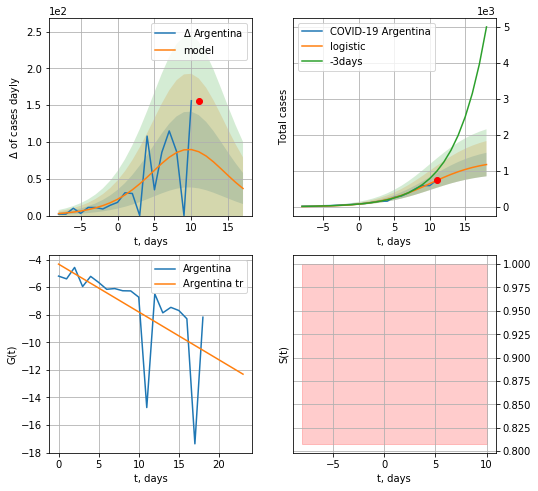

Argentina data at: 2020-05-30
+3 day model MAPE: 0.3427791439688051
model: logistic
coeffs:  [1.30607344e+03 2.75914265e-01 1.01155997e+01]
rational stdev:  0.2777261346981541
forecast at the end of period: +7 days
	 deltaDaycases:  36
	 total cases:  1172 ± 325
	 total death:  38 ± 31
trend coefficient of determination: 0.364190
 intercept: -4.325611
 slope: -0.347113


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


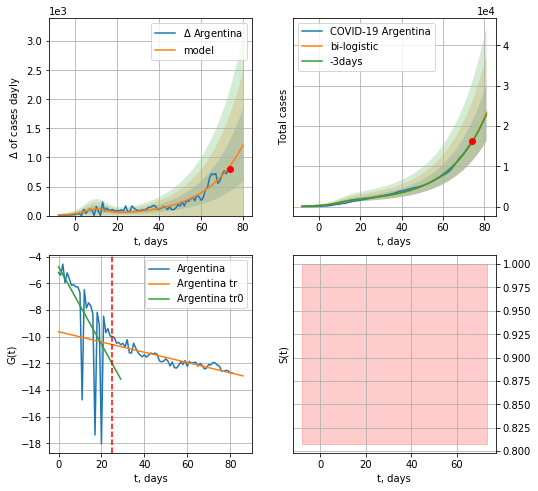

Argentina data at: 2020-05-30
+3 day model MAPE: 0.012010843356282688
model: bi-logistic
coeffs:  [4.38880976e+06 5.69129568e-02 1.73903290e+02] [1.30607344e+03 2.75914265e-01 1.01155997e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.3019489916253802
forecast at the end of period: +7 days
	 deltaDaycases:  1215
	 total cases:  23379 ± 7059
	 total death:  761 ± 689
bi-logistic approximation splitting point: 25
trend0 coefficient of determination: 0.360462
 intercept: -4.766843
 slope: -0.290012
trend coefficient of determination: 0.820817
 intercept: -9.628516
 slope: -0.038456


In [368]:
vL = 25
#vL1 = 40
dfAG = read_df(pd.DataFrame(),"AG")
x = forecast('Argentina',dfAG[5:vL],d1,7*10-dT,1.0)
xx = forecast2('Argentina',dfAG[5:],d1,10*7-dT,x,1.0,vL=vL,addpred=True,xcoef=[.25,1.,2.0])
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Argentina",dfAG[5:],d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


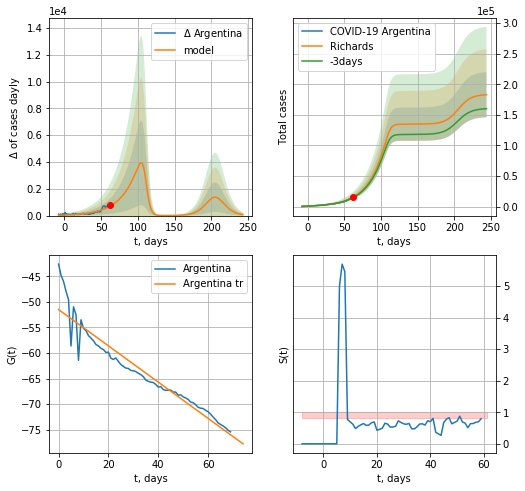

Argentina data at: 2020-05-30
+3 day model MAPE: 0.034613
model: Richards
coeffs: [1.34765828e+05 4.41116417e-02 1.11052868e+02 7.47137997e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.201610
forecast at the end of period: +182 days
	 deltaDaycases: 73
	 total cases: 182984 ± 36891
	 total death: 5958 ± 3603
trend coefficient of determination: 0.908027
 intercept: -51.506678
 slope: -0.354997


In [369]:
x = forecastRR('Argentina',dfAG[17:].fillna(0),d1,35*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


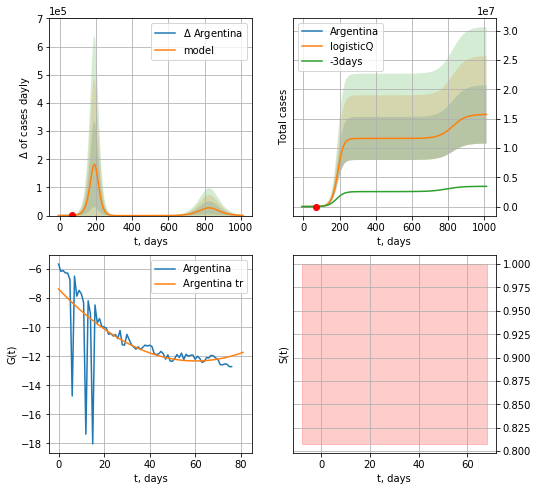

Argentina data at: 2020-05-30
+3 day model MAPE: 0.044190
model: logisticQ
coeffs: [ 1.16389174e+07  6.30178929e-05  1.89387477e+02 -8.01417874e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.316478
forecast at the end of period: +945 days
	 deltaDaycases: 685
	 total cases: 15736206 ± 4980164
	 total death: 512440 ± 486528
trend coefficient of determination: 0.441903
 intercept_: -7.367971516653975
 coeffs_: [ 0.         -0.1645733   0.00136723]


In [370]:
x = forecastRRR('Argentina',dfAG[10:],d1,144*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


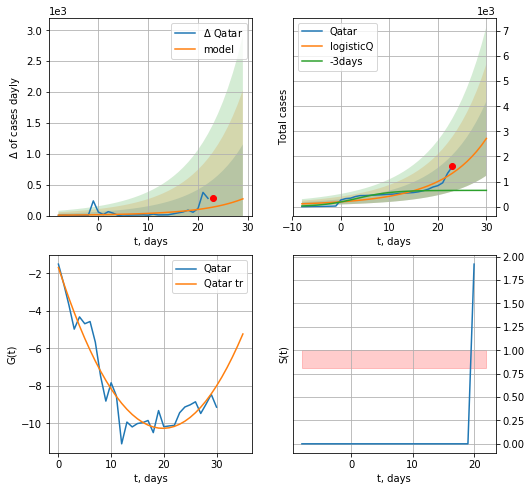

Qatar data at: 2020-05-30
+3 day model MAPE: 1.276947
model: logisticQ
coeffs: [ 3.06298216e+06  5.83123263e-04  8.16720504e+01 -2.03214903e+02]
rational stdev: 0.545415
forecast at the end of period: +7 days
	 deltaDaycases: 271
	 total cases: 2716 ± 1481
	 total death: 1 ± 1
trend coefficient of determination: 0.919409
 intercept_: -1.6852707465713292
 coeffs_: [ 0.         -0.86529683  0.02183056]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:294: RuntimeWarning: overflow encountered in exp


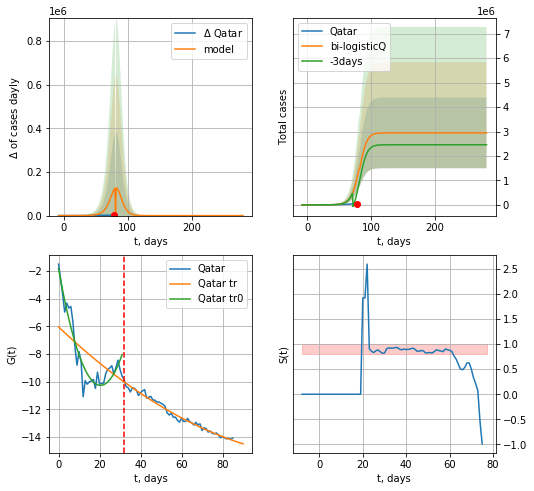

Qatar data at: 2020-05-30
+3 day model MAPE: 1.016533
model: bi-logisticQ
coeffs: [-1.19436904e+05  2.78259807e+02 -3.87828638e+02  8.16474177e+01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.490683
forecast at the end of period: +203 days
	 deltaDaycases: 0
	 total cases: 2943545 ± 1444347
	 total death: 1917 ± 2821
bi-logisticQ approximation splitting point: 32
trend coefficient of determination: 0.904406
 intercept_: -1.8341916285683908
 coeffs_: [ 0.         -0.82373816  0.02011068]
trend coefficient of determination: 0.979022
 intercept_: -6.042399499614075
 coeffs_: [ 0.         -0.14087238  0.00052223]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


In [372]:
vL=32
x = forecastRRR('Qatar',dfQR[:vL].fillna(0),d1,7*10-dT,1.0,addpred=False,xcoef=[.35,.5,4.0,1])
xx = forecast2RRR('Qatar',dfQR[:].fillna(0),d1,38*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


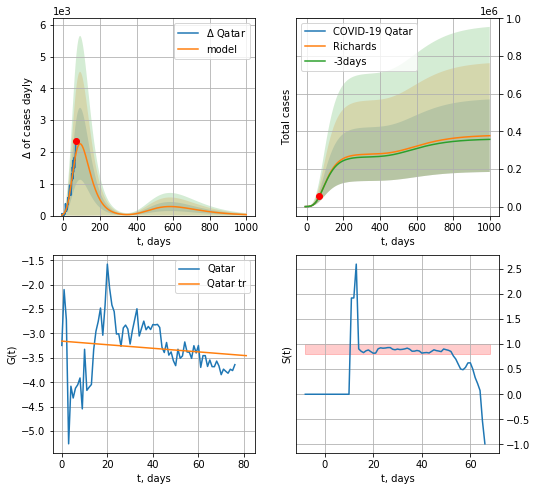

Qatar data at: 2020-05-30
+3 day model MAPE: 0.003814
model: Richards
coeffs: [ 2.79311692e+05  5.07383438e-01 -4.65015700e+01  4.42631697e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.511456
forecast at the end of period: +931 days
	 deltaDaycases: 30
	 total cases: 376474 ± 192550
	 total death: 245 ± 375
trend coefficient of determination: 0.019251
 intercept: -3.156940
 slope: -0.003675


In [373]:
x = forecastRR('Qatar',dfQR[9:].fillna(0),d1,142*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)

In [374]:
#x = forecast('Qatar',dfQR[:],d1,18*7-dT,1.0,addpred=True,xcoef=[.35,.5,4.0,1])

UAE
           date    cases  active  death
101 2020-05-26  31086.0   14851  253.0
102 2020-05-27  31969.0   15343  255.0
103 2020-05-28  32532.0   15589  258.0
104 2020-05-29  33170.0   15813  260.0
105 2020-05-30  33896.0   16088  262.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


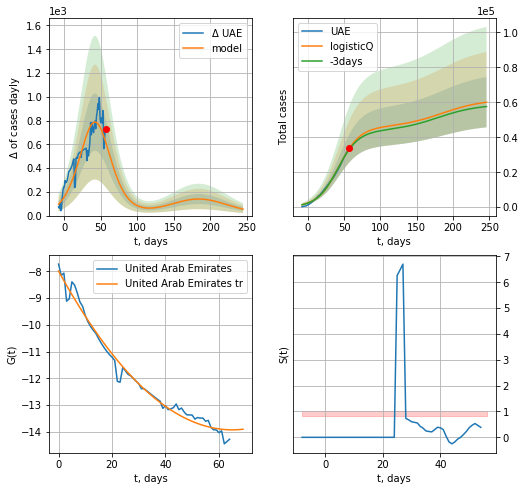

UAE data at: 2020-05-30
+3 day model MAPE: 0.016994
model: logisticQ
coeffs: [ 4.56162452e+04  1.32657699e-06  4.23897661e+01 -5.17257589e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.239222
forecast at the end of period: +189 days
	 deltaDaycases: 54
	 total cases: 60032 ± 14361
	 total death: 464 ± 332
trend coefficient of determination: 0.981167
 intercept_: -7.991256754834499
 coeffs_: [ 0.         -0.18254164  0.00140403]


In [375]:
dfUAE = read_df(pd.DataFrame(),"UAE")
x = forecastRRR('UAE',dfUAE[40:],d1,36*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in power


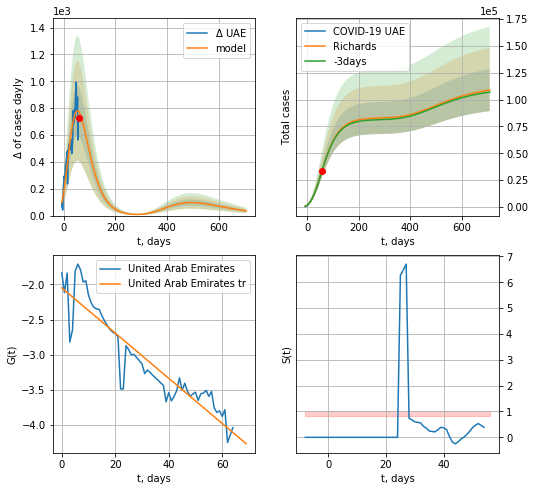

UAE data at: 2020-05-30
+3 day model MAPE: 0.003025
model: Richards
coeffs: [ 8.31071301e+04  1.40491978e+00 -1.02121998e+02  1.83349077e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.180059
forecast at the end of period: +651 days
	 deltaDaycases: 35
	 total cases: 108937 ± 19615
	 total death: 842 ± 454
trend coefficient of determination: 0.855760
 intercept: -2.049627
 slope: -0.032113


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


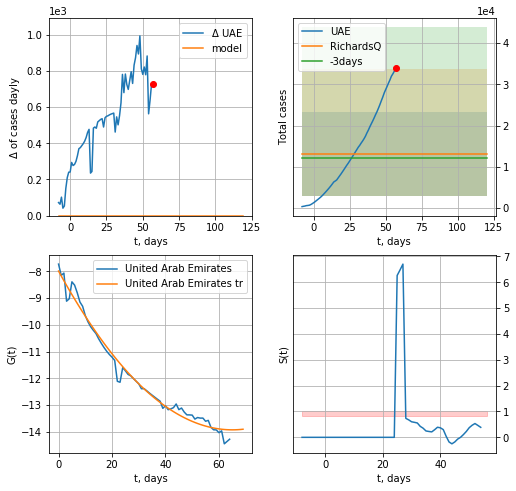

UAE data at: 2020-05-30
+3 day model MAPE: 0.079042
model: RichardsQ
coeffs: [ 1.30793788e+04 -6.53355877e+00 -7.67052588e+02  5.93045117e+02
  1.04971021e-01]
rational stdev: 0.786435
forecast at the end of period: +63 days
	 deltaDaycases: 0
	 total cases: 13079 ± 10286
	 total death: 101 ± 238
trend coefficient of determination: 0.981167
 intercept_: -7.991256754834499
 coeffs_: [ 0.         -0.18254164  0.00140403]


In [376]:
x = forecastRR('UAE',dfUAE[40:],d1,102*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('UAE',dfUAE[40:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

In [377]:
#plt.plot(range(len(dfUAE[45:])-1),np.log(np.log(np.log(np.diff(dfUAE[45:].cases)))))

SA
          date    cases  active  death
84 2020-05-26  76726.0   27865  411.0
85 2020-05-27  78541.0   27094  425.0
86 2020-05-28  80185.0   25191  441.0
87 2020-05-29  81766.0   24295  458.0
88 2020-05-30  83384.0   24021  480.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


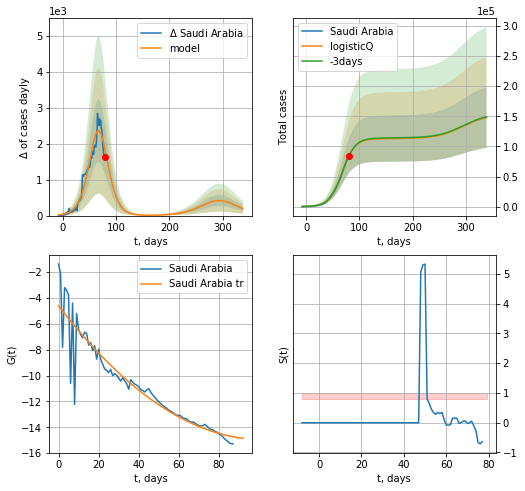

Saudi Arabia data at: 2020-05-30
+3 day model MAPE: 0.003673
model: logisticQ
coeffs: [ 1.12954502e+05  2.61742120e-06  6.73875854e+01 -3.19267485e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.339917
forecast at the end of period: +259 days
	 deltaDaycases: 192
	 total cases: 147777 ± 50231
	 total death: 850 ± 866
trend coefficient of determination: 0.879885
 intercept_: -4.603484461428117
 coeffs_: [ 0.         -0.20272909  0.00099302]


In [378]:
dfSA = read_df(pd.DataFrame(),"SA")
x = forecastRRR('Saudi Arabia',dfSA[:],d1,46*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


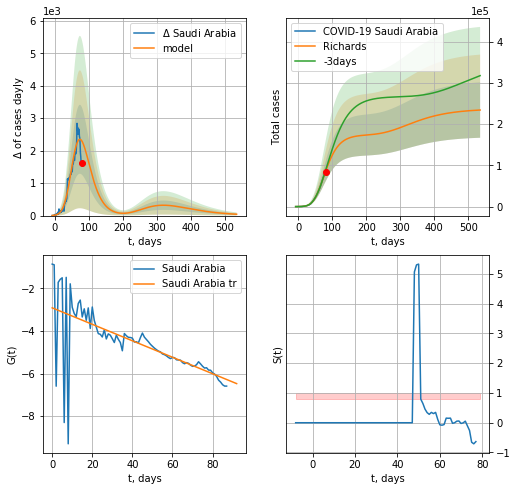

Saudi Arabia data at: 2020-05-30
+3 day model MAPE: 0.030283
model: Richards
coeffs: [1.74082182e+05 1.75118352e-01 3.82937048e+01 2.33565793e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.286934
forecast at the end of period: +455 days
	 deltaDaycases: 41
	 total cases: 234149 ± 67185
	 total death: 1347 ± 1159
trend coefficient of determination: 0.452762
 intercept: -2.909855
 slope: -0.038711


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


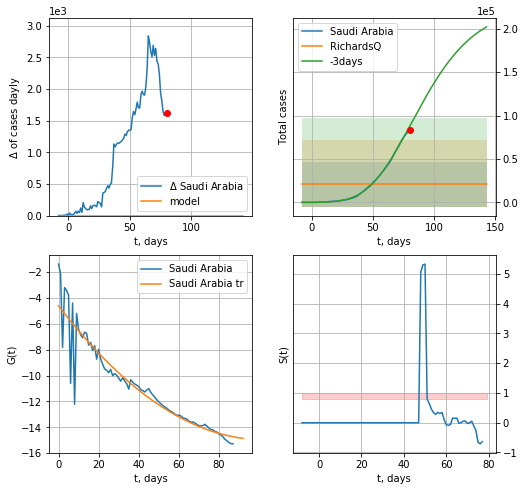

Saudi Arabia data at: 2020-05-30
+3 day model MAPE: 0.769040
model: RichardsQ
coeffs: [ 2.07807757e+04  8.15749595e+00 -1.14339317e+03  9.89189532e+02
 -2.67239470e+00]
rational stdev: 1.234032
forecast at the end of period: +63 days
	 deltaDaycases: 0
	 total cases: 20780 ± 25644
	 total death: 119 ± 440
trend coefficient of determination: 0.879885
 intercept_: -4.603484461428117
 coeffs_: [ 0.         -0.20272909  0.00099302]


In [382]:
x = forecastRR('Saudi Arabia',dfSA[:],d1,74*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Saudi Arabia',dfSA[:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

Sri
          date   cases  active  death
77 2020-05-26  1319.0     597   10.0
78 2020-05-27  1469.0     727   10.0
79 2020-05-28  1530.0     775   10.0
80 2020-05-29  1558.0     794   10.0
81 2020-05-30  1620.0     829   10.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


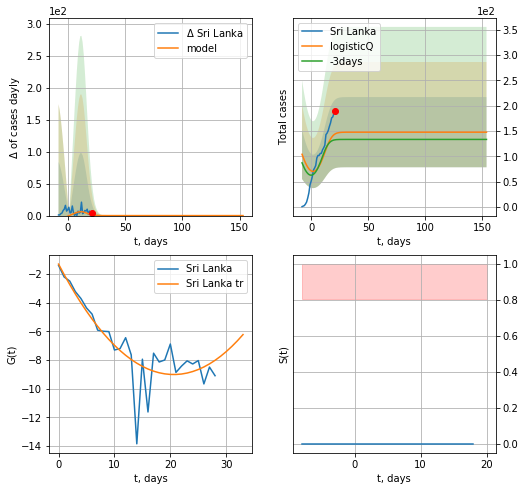

Sri Lanka data at: 2020-05-30
+3 day model MAPE: 0.092819
model: logisticQ
coeffs: [ 1.47873470e+02  1.02179685e-02  4.75701897e+00 -1.32324113e+00]
rational stdev: 0.468203
forecast at the end of period: +133 days
	 deltaDaycases: 0
	 total cases: 147 ± 69
	 total death: 0 ± 0
trend coefficient of determination: 0.737116
 intercept_: -1.300425972375204
 coeffs_: [ 0.         -0.74879164  0.01816974]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


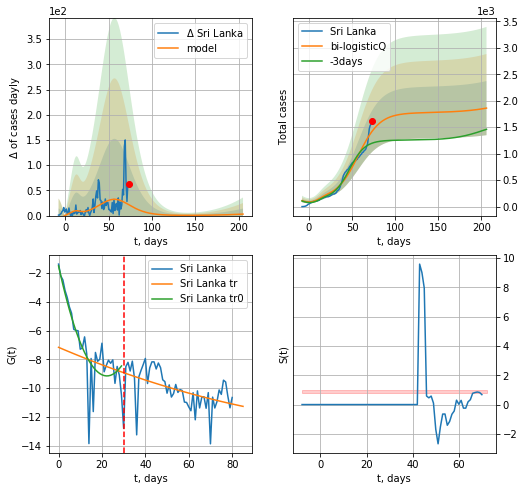

Sri Lanka data at: 2020-05-30
+3 day model MAPE: 0.196009
model: bi-logisticQ
coeffs: [ 1.62461991e+03  5.13921689e-07  5.70320436e+01 -1.54789526e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.274563
forecast at the end of period: +133 days
	 deltaDaycases: 2
	 total cases: 1861 ± 510
	 total death: 11 ± 9
bi-logisticQ approximation splitting point: 30
trend coefficient of determination: 0.725855
 intercept_: -1.5084890363019623
 coeffs_: [ 0.         -0.68634546  0.01540158]
trend coefficient of determination: 0.227926
 intercept_: -7.167264968199749
 coeffs_: [ 0.         -0.06444644  0.00019056]


In [383]:
dfSri = read_df(pd.DataFrame(),"Sri")
vL= 30
x = forecastRRR('Sri Lanka',dfSri[:vL],d1,28*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Sri Lanka',dfSri[:],d1,28*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


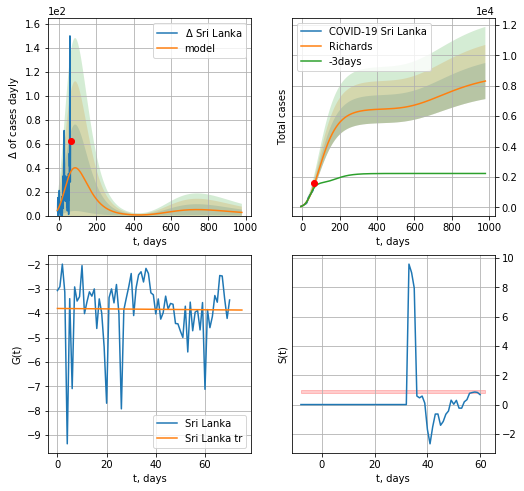

Sri Lanka data at: 2020-05-30
+3 day model MAPE: 0.153130
model: Richards
coeffs: [ 6.47718169e+03  6.39901110e-01 -1.26514277e+02  2.65315049e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.142915
forecast at the end of period: +917 days
	 deltaDaycases: 2
	 total cases: 8308 ± 1187
	 total death: 51 ± 21
trend coefficient of determination: 0.000168
 intercept: -3.806083
 slope: -0.000853


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


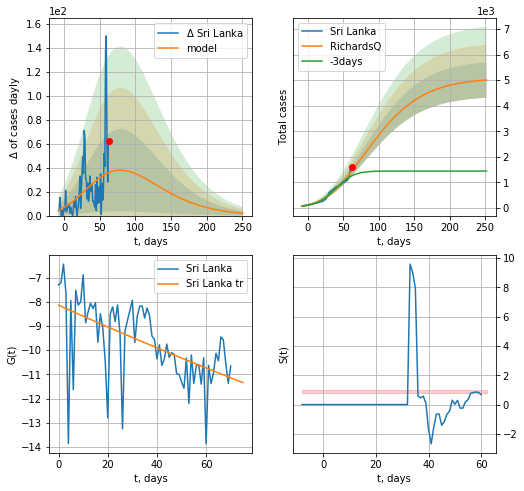

Sri Lanka data at: 2020-05-30
+3 day model MAPE: 0.179396
model: RichardsQ
coeffs: [ 5.07300568e+03  2.03901349e-03 -2.90915061e+02 -5.10024889e+02
  1.04904848e-02]
rational stdev: 0.138553
forecast at the end of period: +189 days
	 deltaDaycases: 1
	 total cases: 5004 ± 693
	 total death: 30 ± 12
trend coefficient of determination: 0.302484
 intercept_: -8.1410558242027
 coeffs_: [ 0.00000000e+00 -4.56493073e-02  4.00041375e-05]


In [385]:
vL=52
x = forecastRR('Sri Lanka',dfSri[10:],d1,140*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
#xx = forecast2RR('Sri Lanka',dfSri[10:],d1,30*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
x = forecastQR('Sri Lanka',dfSri[10:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

PS
          date    cases  active   death
89 2020-05-26  59151.0   38784  1225.0
90 2020-05-27  61227.0   39736  1260.0
91 2020-05-28  64028.0   40406  1317.0
92 2020-05-29  66457.0   40931  1395.0
93 2020-05-30  69496.0   42742  1483.0


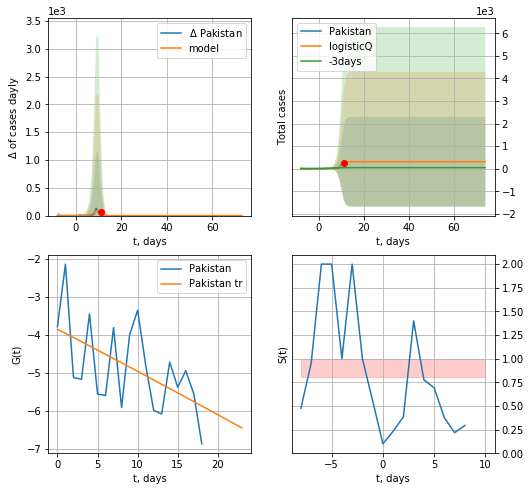

Pakistan data at: 2020-05-30
+3 day model MAPE: 5.954391
model: logisticQ
coeffs: [ 3.10300107e+02  5.80299152e-02  9.88962591e+00 -1.18245381e+01]
rational stdev: 6.420495
forecast at the end of period: +63 days
	 deltaDaycases: 0
	 total cases: 310 ± 1992
	 total death: 6 ± 115
trend coefficient of determination: 0.293073
 intercept_: -3.8498114630651457
 coeffs_: [ 0.         -0.10964083 -0.00016191]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


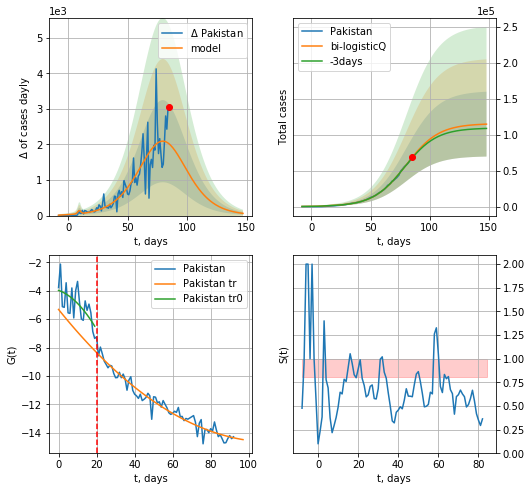

Pakistan data at: 2020-05-30
+3 day model MAPE: 0.014117
model: bi-logisticQ
coeffs: [ 1.15306311e+05  4.37813049e-06  8.00129951e+01 -1.65009039e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.392960
forecast at the end of period: +63 days
	 deltaDaycases: 61
	 total cases: 114837 ± 45126
	 total death: 2450 ± 2888
bi-logisticQ approximation splitting point: 20
trend coefficient of determination: 0.391568
 intercept_: -3.9808806978581046
 coeffs_: [ 0.         -0.04620278 -0.00453428]
trend coefficient of determination: 0.950728
 intercept_: -5.321479777582516
 coeffs_: [ 0.         -0.16637332  0.00074173]


In [386]:
dfPS = read_df(pd.DataFrame(),"PS")
vL= 20
x = forecastRRR('Pakistan',dfPS[:vL],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Pakistan',dfPS[:],d1,18*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


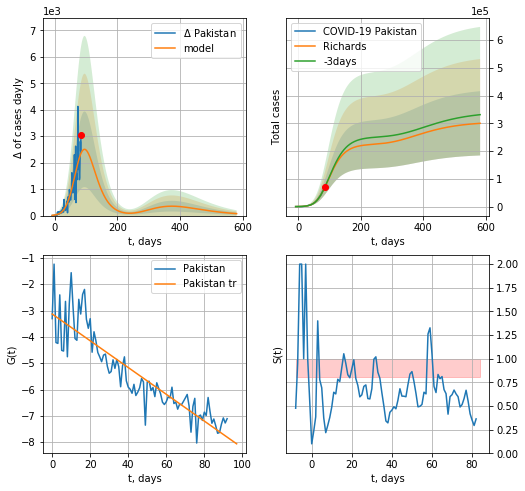

Pakistan data at: 2020-05-30
+3 day model MAPE: 0.004764
model: Richards
coeffs: [2.25051824e+05 9.95559871e-02 6.67707101e+01 3.56715449e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.385822
forecast at the end of period: +497 days
	 deltaDaycases: 73
	 total cases: 300283 ± 115855
	 total death: 6407 ± 7415
trend coefficient of determination: 0.801380
 intercept: -3.133394
 slope: -0.050800


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app


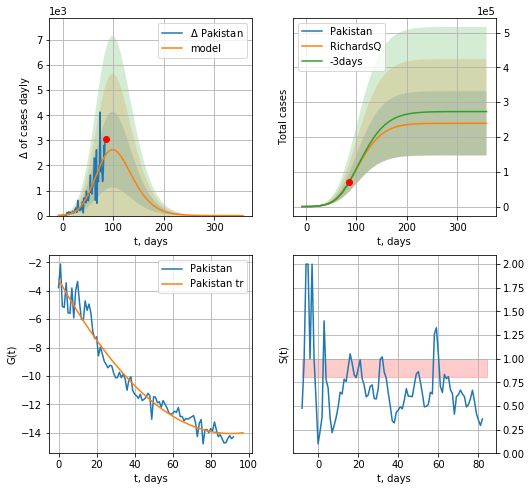

Pakistan data at: 2020-05-30
+3 day model MAPE: 0.006392
model: RichardsQ
coeffs: [ 2.39283581e+05  1.37018944e-03 -1.36883271e+02 -6.84366068e+01
  5.63082332e-02]
rational stdev: 0.385731
forecast at the end of period: +273 days
	 deltaDaycases: 0
	 total cases: 239283 ± 92299
	 total death: 5106 ± 5908
trend coefficient of determination: 0.957187
 intercept_: -3.2052527514995193
 coeffs_: [ 0.         -0.23981473  0.00132543]


In [387]:
x = forecastRR('Pakistan',dfPS[:],d1,80*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Pakistan',dfPS[:],d1,48*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

BN
          date    cases  active  death
79 2020-05-26  36751.0   28650  522.0
80 2020-05-27  38292.0   29823  544.0
81 2020-05-28  40321.0   31337  559.0
82 2020-05-29  42844.0   33247  582.0
83 2020-05-30  44608.0   34623  610.0


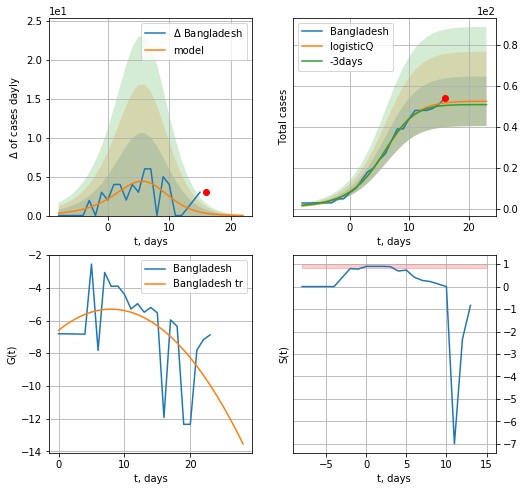

Bangladesh data at: 2020-05-30
+3 day model MAPE: 0.027574
model: logisticQ
coeffs: [ 5.24923176e+01  5.83632898e-03  5.49442770e+00 -5.18799455e+01]
rational stdev: 0.229670
forecast at the end of period: +7 days
	 deltaDaycases: 0
	 total cases: 52 ± 12
	 total death: 0 ± 0
trend coefficient of determination: 0.276192
 intercept_: -6.599187027141191
 coeffs_: [ 0.          0.32583568 -0.02049035]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:294: RuntimeWarning: overflow encountered in exp


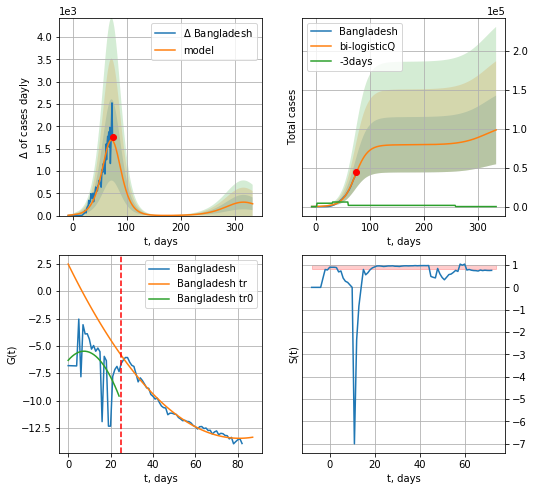

Bangladesh data at: 2020-05-30
+3 day model MAPE: 27.777442
model: bi-logisticQ
coeffs: [ 7.93806366e+04  2.90716501e-06  7.25871448e+01 -2.93126441e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.447638
forecast at the end of period: +259 days
	 deltaDaycases: 264
	 total cases: 98564 ± 44121
	 total death: 1347 ± 1808
bi-logisticQ approximation splitting point: 25
trend coefficient of determination: 0.232653
 intercept_: -6.325425729788838
 coeffs_: [ 0.          0.22449345 -0.0150245 ]
trend coefficient of determination: 0.985737
 intercept_: 2.479078096964514
 coeffs_: [ 0.         -0.39484128  0.00244581]


In [389]:
dfBN = read_df(pd.DataFrame(),"BN")
vL= 25
x = forecastRRR('Bangladesh',dfBN[:vL],d1,10*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Bangladesh',dfBN[:],d1,46*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


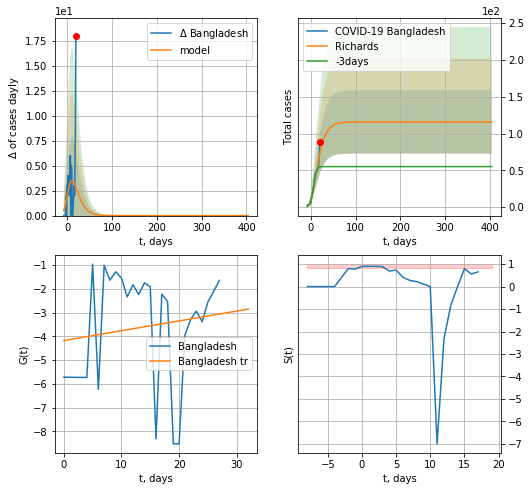

Bangladesh data at: 2020-05-30
+3 day model MAPE: 0.373626
model: Richards
coeffs: [ 1.15736925e+02  6.45824667e+00 -4.20178539e+01  1.27654554e-02]
rational stdev: 0.371727
forecast at the end of period: +385 days
	 deltaDaycases: 0
	 total cases: 115 ± 43
	 total death: 1 ± 1
trend coefficient of determination: 0.020746
 intercept: -4.180817
 slope: 0.041430


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


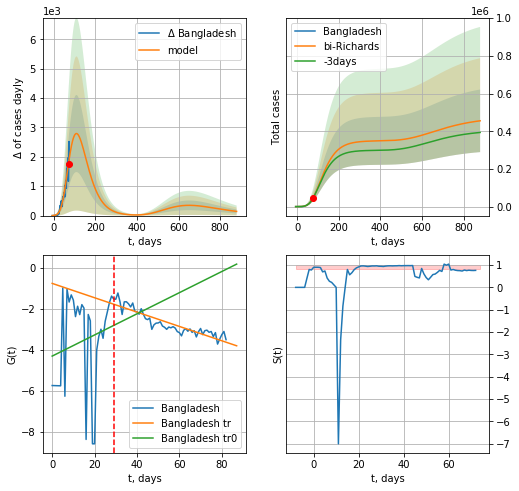

Bangladesh data at: 2020-05-30
+3 day model MAPE: 0.011524
model: bi-Richards
coeffs: [ 3.49338521e+05  8.73909804e-01 -5.80380794e+01  2.51894984e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.364730
forecast at the end of period: +805 days
	 deltaDaycases: 142
	 total cases: 455383 ± 166092
	 total death: 6227 ± 6813
bi-Richards approximation splitting point: 29
trend coefficient of determination: 0.034570
 intercept: -4.300872
 slope: 0.051510
trend coefficient of determination: 0.822868
 intercept: -0.758883
 slope: -0.034935


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


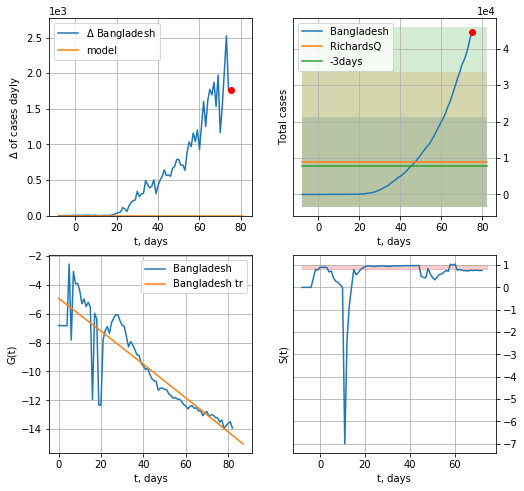

Bangladesh data at: 2020-05-30
+3 day model MAPE: 0.160725
model: RichardsQ
coeffs: [ 8.98796669e+03  1.09851134e+00 -1.11987104e+02  1.02510550e+02
 -2.37742076e-01]
rational stdev: 1.370471
forecast at the end of period: +7 days
	 deltaDaycases: 0
	 total cases: 8987 ± 12317
	 total death: 122 ± 501
trend coefficient of determination: 0.792746
 intercept_: -4.929634952931372
 coeffs_: [ 0.00000000e+00 -1.12877111e-01 -3.60558328e-05]


In [391]:
vL=29
x = forecastRR('Bangladesh',dfBN[:vL],d1,64*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Bangladesh',dfBN[:],d1,124*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
x = forecastQR('Bangladesh',dfBN[:],d1,10*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

KW
          date    cases  active  death
92 2020-05-26  22575.0   15097  172.0
93 2020-05-27  23267.0   15146  175.0
94 2020-05-28  24112.0   15229  185.0
95 2020-05-29  25184.0   15717  194.0
96 2020-05-30  26192.0   15831  205.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


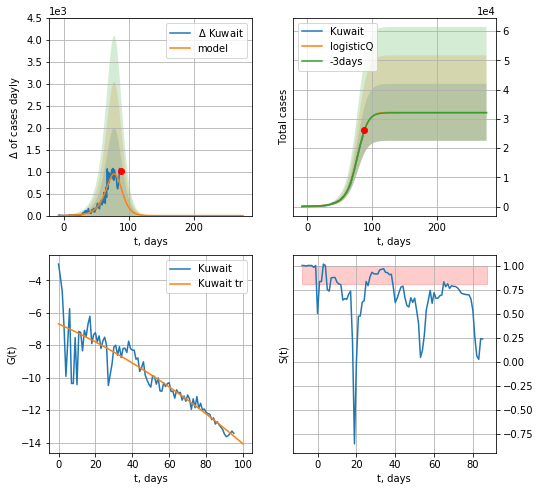

Kuwait data at: 2020-05-30
+3 day model MAPE: 0.001325
model: logisticQ
coeffs: [ 3.22486015e+04  6.02040386e-04  7.66428591e+01 -1.17475686e+02]
rational stdev: 0.301899
forecast at the end of period: +189 days
	 deltaDaycases: 0
	 total cases: 32248 ± 9735
	 total death: 252 ± 228
trend coefficient of determination: 0.808353
 intercept_: -6.6869524450491005
 coeffs_: [ 0.         -0.05114231 -0.00022744]


In [392]:
dfKW = read_df(pd.DataFrame(),"KW")
x = forecastRRR('Kuwait',dfKW[:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

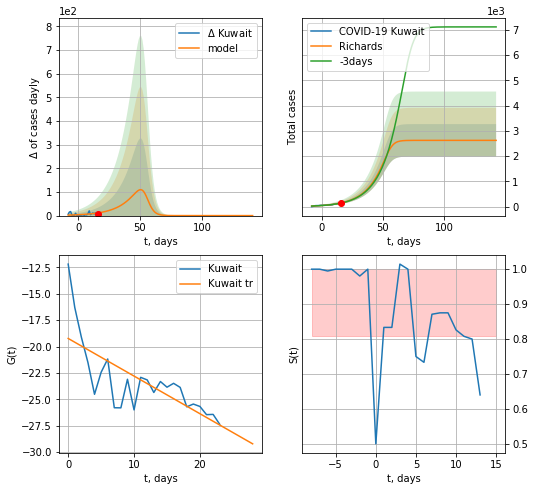

Kuwait data at: 2020-05-30
+3 day model MAPE: 0.021195
model: Richards
coeffs: [2.62618295e+03 7.26706329e-02 5.55128378e+01 4.83394479e+00]
rational stdev: 0.245134
forecast at the end of period: +126 days
	 deltaDaycases: 0
	 total cases: 2626 ± 643
	 total death: 20 ± 14
trend coefficient of determination: 0.533266
 intercept: -19.235922
 slope: -0.356305


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


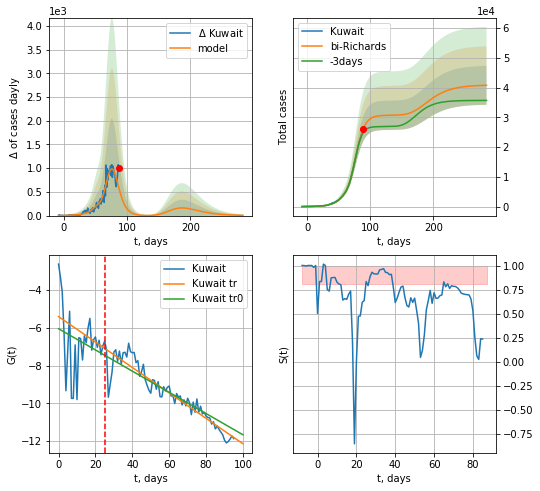

Kuwait data at: 2020-05-30
+3 day model MAPE: 0.048999
model: bi-Richards
coeffs: [2.80795715e+04 1.57940620e-01 7.53551011e+01 8.45687280e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.160375
forecast at the end of period: +196 days
	 deltaDaycases: 5
	 total cases: 40760 ± 6536
	 total death: 319 ± 153
bi-Richards approximation splitting point: 25
trend coefficient of determination: 0.053384
 intercept: -6.051546
 slope: -0.056111
trend coefficient of determination: 0.873502
 intercept: -5.409839
 slope: -0.067297


In [394]:
vL = 25
x = forecastRR('Kuwait',dfKW[:vL],d1,27*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Kuwait',dfKW[:],d1,37*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)

DM
          date    cases  active  death
86 2020-05-26  15264.0    6262  468.0
87 2020-05-27  15723.0    6459  474.0
88 2020-05-28  16068.0    6631  485.0
89 2020-05-29  16531.0    6777  488.0
90 2020-05-30  16908.0    6853  498.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


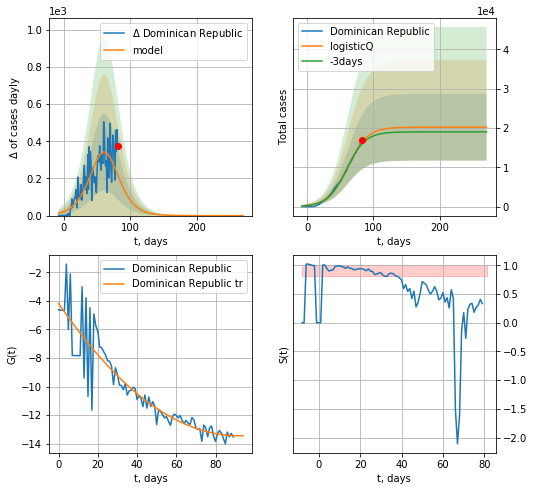

Dominican Republic data at: 2020-05-30
+3 day model MAPE: 0.028095
model: logisticQ
coeffs: [ 2.02081391e+04  7.00686442e-07  6.12783329e+01 -9.67355044e+04]
rational stdev: 0.420635
forecast at the end of period: +189 days
	 deltaDaycases: 0
	 total cases: 20208 ± 8500
	 total death: 595 ± 750
trend coefficient of determination: 0.837478
 intercept_: -4.170370021184779
 coeffs_: [ 0.         -0.20230047  0.00110286]


In [395]:
dfDM = read_df(pd.DataFrame(),"DM")
x = forecastRRR('Dominican Republic',dfDM[:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


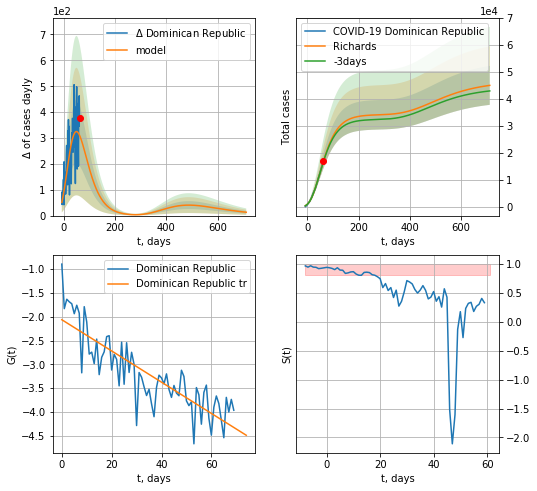

Dominican Republic data at: 2020-05-30
+3 day model MAPE: 0.009686
model: Richards
coeffs: [ 3.41165824e+04  1.57913052e+00 -1.07679375e+02  1.65244641e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.160341
forecast at the end of period: +651 days
	 deltaDaycases: 12
	 total cases: 44927 ± 7203
	 total death: 1323 ± 636
trend coefficient of determination: 0.709519
 intercept: -2.063303
 slope: -0.032776


In [396]:
x = forecastRR('Dominican Republic',dfDM[20:],d1,102*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)

In [ ]:
cD = {
    "Romania": ["RM",5,4*7],
    #"Finland":"FI",
    "India":["ID",5,6*7],
    "Ecuador":["ED",5,4*7],
    "Philippines":["PH",5,4*7],
    #"Pakistan":"PK",
#    "Luxembourg":"LX",
#    "Saudi Arabia":["SA",5,4*7],
    "Thailand":["TH",5,4*7],
    "Indonesia":["IE",5,16*7],
    "Mexico":["MX",5,8*7],
    "Panama":["PM",12,12*7],
    "Peru":["PU",5,4*7],
    "Serbia":["SB",5,4*7],
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":["UAE",5,8*7],
    "Argentina":["AG",5,8*7],
    "Iceland":["IC",5,4*7],
    "Colombia":["CB",10,16*7],
    "Qatar":["QR",5,6*7],
    "Algeria":["AR",5,16*7],
    "Croatia":["CT",0,12*7],
    "Egypt":["EG",5,4*7],
    "Slovenia":["SV",12,6*7],
    "Morocco":["MR",5,4*7],
    "Iraq":["IQ",2,8*7]
#    "Hong Kong":"HK"
}

dfArray = [dfRM,dfID,dfED,dfPH,dfTH,dfIE,dfMX,dfPM,dfPU,dfSB,dfAG,dfIC,dfCB,dfQR,dfAG,dfCT,dfEG,dfSV,dfMR,dfIQ]
for c,adf in zip(cD,dfArray):
    if c in ["Qatar","Peru","Argentina","Iraq","India","Philippines","Indonesia","Finland","Luxembourg","Ecuador","Thailand","Morocco","Romania","Iceland","Panama","Colombia","Mexico","Algeria", "Croatia","Slovenia","Egypt","Serbia"]:
        continue
    print (c)
    idS = cD[c][1]
    ipd = cD[c][2]
    x = forecast(c,adf[idS:],d1,ipd-dT)
    #xx = forecast2(c,adf[:],d1,ipd-dT,x)

In [4]:
import requests
import lxml.html as lh
#url='https://www.worldometers.info/coronavirus/#countries'#Create a handle, page, to handle the contents of the website
url='https://www.worldometers.info/coronavirus/#nav-today'
page = requests.get(url)#Store the contents of the website under doc
doc = lh.fromstring(page.content)#Parse data that are stored between <tr>..</tr> of HTML
tr_elements = doc.xpath('//tr')
#Check the length of the first 12 rows
print ([len(T) for T in tr_elements[:12]])
tr_elements = doc.xpath('//tr')#Create empty list
col=[]
i=0#For each row, store each first element (header) and an empty list
for t in tr_elements[0]:
    i+=1
    name=t.text_content()
    print ('%d:"%s"'%(i,name))
    col.append((name,[]))
    
#Since out first row is the header, data is stored on the second row onwards
for j in range(1,len(tr_elements)):
    #T is our j'th row
    T=tr_elements[j]
    #print (len(T))
    #If row is not of size 10, the //tr data is not from our table 
    if len(T)!=15:
        break
    
    #i is the index of our column
    i=0
    
    #Iterate through each element of the row
    for t in T.iterchildren():
        data=t.text_content() 
        #Check if row is empty
        if i>0:
        #Convert any numerical value to integers
            try:
                data=int(data)
            except:
                pass
        #Append the data to the empty list of the i'th column
        col[i][1].append(data)
        #Increment i for the next column
        i+=1
    
print ([len(C) for (title,C) in col])
Dict={title:column for (title,column) in col}
df=pd.DataFrame(Dict)

[15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15]
1:"#"
2:"Country,Other"
3:"TotalCases"
4:"NewCases"
5:"TotalDeaths"
6:"NewDeaths"
7:"TotalRecovered"
8:"ActiveCases"
9:"Serious,Critical"
10:"Tot Cases/1M pop"
11:"Deaths/1M pop"
12:"TotalTests"
13:"Tests/
1M pop
"
14:"Population"
15:"Continent"
[463, 463, 463, 463, 463, 463, 463, 463, 463, 463, 463, 463, 463, 463, 463]


In [5]:
df.head(10)
#df.columns[18]

,#,ActiveCases,Continent,"Country,Other",Deaths/1M pop,NewCases,NewDeaths,Population,"Serious,Critical",Tests/ 1M pop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,Tot Cases/1M pop
0,,"1,250,003",North America,\nNorth America\n,,"+3,635",386,,"19,435",,"2,044,468","123,858","670,607",,
1,,"461,707",South America,\nSouth America\n,,"+2,389",25,,"11,281",,"847,008","39,340","345,961",,
2,,"852,704",Europe,\nEurope\n,,14,1,,"8,796",,"2,004,240","173,281","978,255",,
3,,"408,494",Asia,\nAsia\n,,"+4,954",98,,"13,578",,"1,112,475","30,305","673,676",,
4,,"78,690",Africa,\nAfrica\n,,,,,370,,"143,769","4,092","60,987",,
5,,483,Australia/Oceania,\nOceania\n,,10,,,4,,"8,804",125,"8,196",,
6,,55,,\n\n,,,,,4,,721,15,651,,
7,,"3,052,136",All,World,47.6,"+11,002",510,,"53,468",,"6,161,485","371,016","2,738,333",,790
8,1,"1,176,025",North America,USA,319,,,"330,838,184","17,163","52,203","1,816,820","105,557","535,238","17,270,841","5,492"
9,2,"265,746",South America,Brazil,136,"+1,526",15,"212,430,396","8,318","4,378","499,966","28,849","205,371","930,013","2,354"


In [6]:
#df.rename(columns={"Country,Other":"Country",df.columns[9]:"TotDeathsper1Mpop"})
df=df.rename(columns={"Country,Other":"Country",'Deaths/1M pop':"Deathsper1Mpop","Serious,Critical":"Serious_Critical",'Tests/\n1M pop\n':"Testsper1Mpop",'Tot\xa0Cases/1M pop':"TotCasesper1Mpop"})
df.head()

,#,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,"1,250,003",North America,\nNorth America\n,,"+3,635",386,,"19,435",,"2,044,468","123,858","670,607",,
1,,"461,707",South America,\nSouth America\n,,"+2,389",25,,"11,281",,"847,008","39,340","345,961",,
2,,"852,704",Europe,\nEurope\n,,14,1,,"8,796",,"2,004,240","173,281","978,255",,
3,,"408,494",Asia,\nAsia\n,,"+4,954",98,,"13,578",,"1,112,475","30,305","673,676",,
4,,"78,690",Africa,\nAfrica\n,,,,,370,,"143,769","4,092","60,987",,


In [7]:
df[df["Country"]=="Lithuania"]

,#,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
103,96,371,Europe,Lithuania,26,,,"2,725,125",17,"109,877","1,670",70,"1,229","299,428",613
335,96,371,Europe,Lithuania,26,8,2,"2,725,125",17,"109,877","1,670",70,"1,229","299,428",613


In [8]:
totIdx = np.where(df['ActiveCases']=='ActiveCases')[0][0]
print(totIdx)

231


In [9]:
df.head(30)

,#,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,"1,250,003",North America,\nNorth America\n,,"+3,635",386,,"19,435",,"2,044,468","123,858","670,607",,
1,,"461,707",South America,\nSouth America\n,,"+2,389",25,,"11,281",,"847,008","39,340","345,961",,
2,,"852,704",Europe,\nEurope\n,,14,1,,"8,796",,"2,004,240","173,281","978,255",,
3,,"408,494",Asia,\nAsia\n,,"+4,954",98,,"13,578",,"1,112,475","30,305","673,676",,
4,,"78,690",Africa,\nAfrica\n,,,,,370,,"143,769","4,092","60,987",,
5,,483,Australia/Oceania,\nOceania\n,,10,,,4,,"8,804",125,"8,196",,
6,,55,,\n\n,,,,,4,,721,15,651,,
7,,"3,052,136",All,World,47.6,"+11,002",510,,"53,468",,"6,161,485","371,016","2,738,333",,790
8,1,"1,176,025",North America,USA,319,,,"330,838,184","17,163","52,203","1,816,820","105,557","535,238","17,270,841","5,492"
9,2,"265,746",South America,Brazil,136,"+1,526",15,"212,430,396","8,318","4,378","499,966","28,849","205,371","930,013","2,354"


In [10]:
df.at[12, 'TotalRecovered'] = 0
df.at[27, 'TotalRecovered'] = 0
df.at[12,"ActiveCases"] = 0
df.at[27,"ActiveCases"] = 0
#df.at[12, 'TotalRecovered'] = 0
df = df.fillna(0)

In [11]:
import lxml
def sanitize(data):
    #print (type(data))
    if type(data) == lxml.etree._ElementUnicodeResult:
        data=str(data).strip()
    if str(data).find(',') != -1:
        data = data.replace(',','')
    #print(str(data).find(',') != -1)
    return data
df=df[df.index<totIdx-1]
df["ActiveCases"] = pd.to_numeric(df["ActiveCases"].apply(sanitize))
df["Deathsper1Mpop"] = pd.to_numeric(df["Deathsper1Mpop"].apply(sanitize))
df["NewCases"] = pd.to_numeric(df["NewCases"].apply(sanitize))
df["NewDeaths"] = pd.to_numeric(df["NewDeaths"].apply(sanitize))
df["Serious_Critical"] = pd.to_numeric(df["Serious_Critical"].apply(sanitize))
df["TotalCases"] = pd.to_numeric(df["TotalCases"].apply(sanitize))
df["TotalDeaths"] = pd.to_numeric(df["TotalDeaths"].apply(sanitize))
df["TotalRecovered"] = pd.to_numeric(df["TotalRecovered"].apply(sanitize))
df["TotCasesper1Mpop"] = pd.to_numeric(df["TotCasesper1Mpop"].apply(sanitize))
df["TotalTests"] = pd.to_numeric(df["TotalTests"].apply(sanitize))
df["Testsper1Mpop"] = pd.to_numeric(df["Testsper1Mpop"].apply(sanitize))
df.head(15)

,#,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,1250003,North America,\nNorth America\n,NaN,3635.0,386.0,,19435.0,NaN,2044468,123858.0,670607.0,NaN,NaN
1,,461707,South America,\nSouth America\n,NaN,2389.0,25.0,,11281.0,NaN,847008,39340.0,345961.0,NaN,NaN
2,,852704,Europe,\nEurope\n,NaN,14.0,1.0,,8796.0,NaN,2004240,173281.0,978255.0,NaN,NaN
3,,408494,Asia,\nAsia\n,NaN,4954.0,98.0,,13578.0,NaN,1112475,30305.0,673676.0,NaN,NaN
4,,78690,Africa,\nAfrica\n,NaN,NaN,NaN,,370.0,NaN,143769,4092.0,60987.0,NaN,NaN
5,,483,Australia/Oceania,\nOceania\n,NaN,10.0,NaN,,4.0,NaN,8804,125.0,8196.0,NaN,NaN
6,,55,,\n\n,NaN,NaN,NaN,,4.0,NaN,721,15.0,651.0,NaN,NaN
7,,3052136,All,World,47.6,11002.0,510.0,,53468.0,NaN,6161485,371016.0,2738333.0,NaN,790.0
8,1,1176025,North America,USA,319.0,NaN,NaN,"330,838,184",17163.0,52203.0,1816820,105557.0,535238.0,17270841.0,5492.0
9,2,265746,South America,Brazil,136.0,1526.0,15.0,"212,430,396",8318.0,4378.0,499966,28849.0,205371.0,930013.0,2354.0


In [12]:
cLst = countriesEU
ActiveCasesEU = sum([ w for w in df[df['Country'].isin(cLst)].ActiveCases if w>0])
CountryEU = "European Union" 
Deathsper1MpopEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])/445.250514
NewCasesEU = sum([w for w in df[df['Country'].isin(cLst)].NewCases if w>0 ])
NewDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].NewDeaths if w>0])
Serious_CriticalEU = sum([w for w in df[df['Country'].isin(cLst)].Serious_Critical if w>0])
Testsper1MpopEU = sum([ w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])/445.250514
TotalCasesEu = sum([w for w in df[df['Country'].isin(cLst)].TotalCases if w>0])
TotalDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])
TotalRecoveredEU = sum([w for w in df[df['Country'].isin(cLst)].TotalRecovered if w>0] )
TotalTestsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])
TotCasesper1MpopEU = TotalCasesEu/445.250514

rowEU = {"ActiveCases":ActiveCasesEU,"Continent":"Europe","Country": CountryEU,"Deathsper1Mpop": Deathsper1MpopEU,"NewCases": NewCasesEU,"NewDeaths": NewDeathsEU,"Serious_Critical": Serious_CriticalEU,"Testsper1Mpop": Testsper1MpopEU,"TotalCases": TotalCasesEu,"TotalDeaths": TotalDeathsEU,"TotalRecovered": TotalRecoveredEU,"TotalTests": TotalTestsEU,"TotCasesper1Mpop": TotCasesper1MpopEU }
df = df.append(rowEU, ignore_index=True)
df.tail()

,#,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
226,,408494,Asia,Total:,NaN,4954.0,98.0,,13578.0,NaN,1112475,30305.0,673676.0,NaN,NaN
227,,78690,Africa,Total:,NaN,NaN,NaN,,370.0,NaN,143769,4092.0,60987.0,NaN,NaN
228,,483,Australia/Oceania,Total:,NaN,10.0,NaN,,4.0,NaN,8804,125.0,8196.0,NaN,NaN
229,,55,,Total:,NaN,NaN,NaN,,4.0,NaN,721,15.0,651.0,NaN,NaN
230,NaN,306992,Europe,European Union,283.550487,14.0,1.0,NaN,4239.0,44447.140155,1201370,126251.0,727821.0,19790112.0,2698.188912


In [13]:
#df['Reported1st case'] = df['Reported1st case'].map(lambda x: x.lstrip('\n'))
df["Country"] = df["Country"].str.strip('\n')
df.head()

,#,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,1250003,North America,North America,NaN,3635.0,386.0,,19435.0,NaN,2044468,123858.0,670607.0,NaN,NaN
1,,461707,South America,South America,NaN,2389.0,25.0,,11281.0,NaN,847008,39340.0,345961.0,NaN,NaN
2,,852704,Europe,Europe,NaN,14.0,1.0,,8796.0,NaN,2004240,173281.0,978255.0,NaN,NaN
3,,408494,Asia,Asia,NaN,4954.0,98.0,,13578.0,NaN,1112475,30305.0,673676.0,NaN,NaN
4,,78690,Africa,Africa,NaN,NaN,NaN,,370.0,NaN,143769,4092.0,60987.0,NaN,NaN


In [28]:
#totIdx0 = np.where(df['Country']=='Total:')[0][0]
#df.at[totIdx0,'Country'] = 'World'

In [29]:
#df

In [14]:
#df[df['Country'].isnull()]
#df['Country']=df['Country'].dropna()
##for idx in df['Country'].isnull():
##    #print(idx)
##    if idx == True:
##        ind = df[df['Country'].isnull()].index[0]
##        df = df.drop(df.index[ind])
df = df.drop(df.index[6])
df.head(10)

,#,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,1250003,North America,North America,NaN,3635.0,386.0,,19435.0,NaN,2044468,123858.0,670607.0,NaN,NaN
1,,461707,South America,South America,NaN,2389.0,25.0,,11281.0,NaN,847008,39340.0,345961.0,NaN,NaN
2,,852704,Europe,Europe,NaN,14.0,1.0,,8796.0,NaN,2004240,173281.0,978255.0,NaN,NaN
3,,408494,Asia,Asia,NaN,4954.0,98.0,,13578.0,NaN,1112475,30305.0,673676.0,NaN,NaN
4,,78690,Africa,Africa,NaN,NaN,NaN,,370.0,NaN,143769,4092.0,60987.0,NaN,NaN
5,,483,Australia/Oceania,Oceania,NaN,10.0,NaN,,4.0,NaN,8804,125.0,8196.0,NaN,NaN
7,,3052136,All,World,47.6,11002.0,510.0,,53468.0,NaN,6161485,371016.0,2738333.0,NaN,790.0
8,1,1176025,North America,USA,319.0,NaN,NaN,"330,838,184",17163.0,52203.0,1816820,105557.0,535238.0,17270841.0,5492.0
9,2,265746,South America,Brazil,136.0,1526.0,15.0,"212,430,396",8318.0,4378.0,499966,28849.0,205371.0,930013.0,2354.0
10,3,224551,Europe,Russia,31.0,NaN,NaN,"145,929,337",2300.0,70693.0,396575,4555.0,167469.0,10316200.0,2718.0


In [15]:
df.to_csv('data/coronaAll_%s.csv'%(date.today()- timedelta(days=1)), index=False)

In [16]:
countryDic = {
  "USA": "US",
"Italy":"IT",
"Spain":"SP",
"Germany":"GR",
"France":"FR",
"Iran":"IN",
"UK":"GB",
"Switzerland":"SZ",
"S. Korea":"KR",
"Norway":"NG",
"Sweden":"SW",
"Israel":"IS",
"Denmark":"DK",
"Poland":"PL",
"Estonia":"ES",
"Ukraine":"Ukr",
"Latvia":"LV",
    "Lithuania":"LT",
    "China":"CN",
    "USA":"US",
    "Russia":"RS",
    "Japan":"JP",
    "Netherlands":"NL",
    "Belgium":"BG",
    "Singapore":"SG",
    "Austria":"AT",
    "Turkey":"TR",
    "Canada":"CA",
    "Portugal":"PT",
    "World":"World",
    "Australia":"AS",
    "Brazil":"BZ",
    "Malaysia":"ML",
    "New Zealand":"ZL",
    "Belarus":"BR",
    "Ireland":"IR",
    "Chile":"CL",
    "Czechia":"CH",
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
#    "Pakistan":"PK",
    "Luxembourg":"LX",
    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
#    "South Africa":"AF",
    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "European Union":"EU",
    "Bulgaria":"BL",
    "Hungary":"HG",
    "Malta":"MT",
    "Slovakia":"SL",
    "Cyprus":"CP",
    "Greece":"GC",
    "Dominican Republic":"DM",
    "Kuwait":"KW",
    "Bangladesh":"BN",
    "Sri Lanka":"Sri",
    "Pakistan":"PS"
#    "Hong Kong":"HK"
}
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)

for c in countryDic:
    print (c,countryDic[c])

Sri Lanka Sri
Colombia CB
China CN
Serbia SB
India ID
USA US
UAE UAE
Panama PM
Canada CA
Turkey TR
Portugal PT
European Union EU
Singapore SG
Denmark DK
Japan JP
Austria AT
Greece GC
Luxembourg LX
Spain SP
Saudi Arabia SA
Australia AS
Ecuador ED
Chile CL
Italy IT
Indonesia IE
Slovakia SL
Malaysia ML
Poland PL
Belarus BR
Argentina AG
Kuwait KW
Egypt EG
Czechia CH
Hungary HG
Israel IS
New Zealand ZL
Iran IN
Belgium BG
Iraq IQ
Ukraine Ukr
Russia RS
Netherlands NL
Iceland IC
Ireland IR
Brazil BZ
Germany GR
Mexico MX
Romania RM
Finland FI
Algeria AR
Latvia LV
Philippines PH
Peru PU
Sweden SW
Croatia CT
Morocco MR
Dominican Republic DM
Slovenia SV
Thailand TH
UK GB
Lithuania LT
S. Korea KR
World World
Bulgaria BL
Pakistan PS
Cyprus CP
Norway NG
Qatar QR
Malta MT
France FR
Estonia ES
Switzerland SZ
Bangladesh BN


In [17]:
len(countryDic)

73

In [18]:
df = pd.read_csv('data/coronaAll_%s.csv'%(date.today()- timedelta(days=1)),',')
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)
from datetime import date, timedelta
for c in df.Country: 
    #if c!='European Union':
    #    continue
    f = open("data/tmp/corona%sOneRaw.csv"%(c),'w')
    #print ("corona%sOneRaw.csv"%(c),date.today()- timedelta(days=1),c,df[df.Country == c].TotalCases.values[0])
    print(c)
    if c!='World':
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    else:
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    f.close()

North America
North America 2020-05-30,2044468,1250003,123858.0
South America
South America 2020-05-30,847008,461707,39340.0
Europe
Europe 2020-05-30,2004240,852704,173281.0
Asia
Asia 2020-05-30,1112475,408494,30305.0
Africa
Africa 2020-05-30,143769,78690,4092.0
Oceania
Oceania 2020-05-30,8804,483,125.0
World
World 2020-05-30,6161485,3052136,371016.0
USA
USA 2020-05-30,1816820,1176025,105557.0
Brazil
Brazil 2020-05-30,499966,265746,28849.0
Russia
Russia 2020-05-30,396575,224551,4555.0
Spain
Spain 2020-05-30,286308,62225,27125.0
UK
UK 2020-05-30,272826,0,38376.0
Italy
Italy 2020-05-30,232664,43691,33340.0
France
France 2020-05-30,188625,91586,28771.0
Germany
Germany 2020-05-30,183294,9794,8600.0
India
India 2020-05-30,182490,90320,5186.0
Turkey
Turkey 2020-05-30,163103,31604,4515.0
Peru
Peru 2020-05-30,155671,84853,4371.0
Iran
Iran 2020-05-30,148950,24389,7734.0
Chile
Chile 2020-05-30,94858,53430,997.0
Canada
Canada 2020-05-30,90190,35014,7073.0
Mexico
Mexico 2020-05-30,87512,15862,9779

Turks and Caicos
Turks and Caicos 2020-05-30,12,0,1.0
Vatican City
Vatican City 2020-05-30,12,10,nan
Montserrat
Montserrat 2020-05-30,11,0,1.0
Seychelles
Seychelles 2020-05-30,11,0,nan
MS Zaandam
MS Zaandam 2020-05-30,9,7,2.0
Western Sahara
Western Sahara 2020-05-30,9,2,1.0
British Virgin Islands
British Virgin Islands 2020-05-30,8,0,1.0
Papua New Guinea
Papua New Guinea 2020-05-30,8,0,nan
Caribbean Netherlands
Caribbean Netherlands 2020-05-30,6,0,nan
St. Barth
St. Barth 2020-05-30,6,0,nan
Anguilla
Anguilla 2020-05-30,3,0,nan
Lesotho
Lesotho 2020-05-30,2,1,nan
Saint Pierre Miquelon
Saint Pierre Miquelon 2020-05-30,1,0,nan
China
China 2020-05-30,83001,63,4634.0
Total:
Total: 2020-05-30,2044468,1250003,123858.0
Total:
Total: 2020-05-30,2044468,1250003,123858.0
Total:
Total: 2020-05-30,2044468,1250003,123858.0
Total:
Total: 2020-05-30,2044468,1250003,123858.0
Total:
Total: 2020-05-30,2044468,1250003,123858.0
Total:
Total: 2020-05-30,2044468,1250003,123858.0
Total:
Total: 2020-05-30,204446

In [19]:
#c='World'
#print(c,"%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0]))

In [20]:
for c in countryDic: 
    #if c not in ['European Union']:
    #    continue
    ff = open("data/tmp/corona%sOneRaw.csv"%(c),'r')
    fff = open("data/corona%s.csv"%(countryDic[c]),'a')
    for l in ff:
        #print(c,l)
        print("append data/corona%s.csv"%(countryDic[c]),"%s"%(l))
        fff.write(l)
    ff.close()
    fff.close()

append data/coronaSri.csv 2020-05-30,1620,829,10.0

append data/coronaCB.csv 2020-05-30,28236,20225,890.0

append data/coronaCN.csv 2020-05-30,83001,63,4634.0

append data/coronaSB.csv 2020-05-30,11381,4533,242.0

append data/coronaID.csv 2020-05-30,182490,90320,5186.0

append data/coronaUS.csv 2020-05-30,1816820,1176025,105557.0

append data/coronaUAE.csv 2020-05-30,33896,16088,262.0

append data/coronaPM.csv 2020-05-30,13018,3274,330.0

append data/coronaCA.csv 2020-05-30,90190,35014,7073.0

append data/coronaTR.csv 2020-05-30,163103,31604,4515.0

append data/coronaPT.csv 2020-05-30,32203,11621,1396.0

append data/coronaEU.csv 2020-05-30,1201370,306992,126251.0

append data/coronaSG.csv 2020-05-30,34366,13616,23.0

append data/coronaDK.csv 2020-05-30,11633,735,571.0

append data/coronaJP.csv 2020-05-30,16804,1512,886.0

append data/coronaAT.csv 2020-05-30,16685,497,668.0

append data/coronaGC.csv 2020-05-30,2915,1366,175.0

append data/coronaLX.csv 2020-05-30,4016,91,110.0

append da

In [21]:
import pandas as pd
import io
import requests
url="https://opendata.ecdc.europa.eu/covid19/casedistribution/csv"
s=requests.get(url).content
#print (s)
dfc=pd.read_csv(io.StringIO(s.decode(encoding='windows-1252')))
dfc.to_csv("data/europa_corona.csv", index=False)

In [22]:
countryDic1 = {
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
    "Pakistan":"PK",
    "Luxembourg":"LX",
#    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "Bulgaria":"BL"
#    "Hong Kong":"HK"
}
countryDic2 = {
    "Austria":"AT",
    "Italy":"IT",
    "Belgium":"BG",
    "Latvia":"LV",
    "Bulgaria":"BL",
    "Lithuania":"LT",
    "Croatia":"CT",
    "Luxembourg":"LX",
    "Cyprus":"CP",
    "Malta":"MT",
    "Czechia":"CH",
    "Netherlands":"NL",
    "Denmark":"DK",
    "Poland":"PL",
    "Estonia":"ES",
    "Portugal":"PT",
    "Finland":"FI",
    "Romania":"RM",
    "France":"FR",
    "Slovakia":"SL",
    "Germany":"GR",
    "Slovenia":"SV",
    "Greece":"GC",
    "Spain":"SP",
    "Hungary":"HG",
    "Sweden":"SW",
    "Ireland":"IR"      
}
cD3 = {"Malta":"MT","Slovakia":"SL","Greece":"GC","Hungary":"HG","Cyprus":"CP","South Africa":"SAF"}
    
for  c in cD3:#countryDic1:
    if c != "South Africa":
        continue
    dfc = pd.read_csv("europa_corona.csv",",")
    dfc = dfc[dfc['countriesAndTerritories']==c].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
    print(c,sum(dfc["cases"].values))
    dfc=dfc.rename(columns={"dateRep":"date"})
    dfc = dfc[dfc["cases"]>0]
    dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
    #dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
    dfc["cases"]=np.cumsum(dfc["cases"].values)
    dfc[['date', 'cases']].to_csv('data/corona%s.csv'%(cD3[c]), index=False)#countryDic1

FileNotFoundError: [Errno 2] File b'europa_corona.csv' does not exist: b'europa_corona.csv'

In [ ]:
#dfRM = read_df(pd.DataFrame(),"RM")

In [ ]:
dfc.head()#[['date', 'cases']]

In [ ]:
date(2012, 3, 16)

In [ ]:
len(countriesEU)

In [ ]:
dfc = pd.read_csv("europa_corona.csv",",")
cLst = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania","Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands","Denmark","Poland","Estonia","Portugal","Finland","Romania","France","Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
dfc = dfc[dfc['countriesAndTerritories'].isin(cLst)].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
print(c,sum(dfc["cases"].values))
dfc=dfc.rename(columns={"dateRep":"date"})
dfc = dfc[dfc["cases"]>0]
dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
#dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
dfc["cases"]=np.cumsum(dfc["cases"].values)
dfc[['date', 'cases']].to_csv('/home/algiz/Desktop/corona%s.csv'%("EU"), index=False)

In [ ]:
#subsetDataFrame = dfObj[dfObj['Product'].isin(['Mangos', 'Grapes']) ]

#dfD = dfAll[dfAll['Country'].isin(cLst)].TotalTests


In [ ]:
#dfD

In [ ]:
#dfAll[dfAll['Country'].isin(cLst)]

In [364]:
TT = sum(dfAll[dfAll.TotalTests>0].TotalTests) - dfAll[dfAll['Country']=='European Union'].TotalTests.values[0]
print(TT,TT/7.7776e3)

73588073.0 9461.539935198518


In [365]:
TT/7.7776e3

9461.539935198518

In [366]:
dfAll[dfAll['Country']=='European Union'].TotalTests.values[0]/(popEU/1e6)

41267.80412880107

In [367]:
sum(dfp.Population)/1e6

16014.157998

In [ ]:
dfAll[dfAll.TotalTests>0]

In [ ]:
cDicEU = {
    "Austria":["AT",dfAT],
    "Italy":["IT",dfIT],
    "Belgium":["BG",dfBG],
    "Latvia":["LV",dfLV],
    "Bulgaria":["BL",dfBL],
    "Lithuania":["LT",dfLT],
    "Croatia":["CT",dfCT],
    "Luxembourg":["LX",dfLX],
    "Cyprus":["CP",dfCP],
    "Malta":["MT",dfMT],
    "Czechia":["CH",dfCH],
    "Netherlands":["NL",dfNL],
    "Denmark":["DK",dfDK],
    "Poland":["PL",dfPL],
    "Estonia":["ES",dfES],
    "Portugal":["PT",dfPT],
    "Finland":["FI",dfFI],
    "Romania":["RM",dfRM],
    "France":["FR",dfFR],
    "Slovakia":["SL",dfSL],
    "Germany":["GR",dfGR],
    "Slovenia":["SV",dfSV],
    "Greece":["GC",dfGC],
    "Spain":["SP",dfSP],
    "Hungary":["HG",dfHG],
    "Sweden":["SW",dfSW],
    "Ireland":["IR",dfIR],
}

In [ ]:
def addDataFrames(f_arg, *argv):
    dfTotal = f_arg
    for arg in argv:
        dfTotal = dfTotal.set_index('date').add(arg.set_index('date'), fill_value = 0)
        dfTotal['date'] = dfTotal.index
    return dfTotal
dfTot = cDicEU["Austria"][1]
for cD in cDicEU:
    if cD == "Austria":
        continue
    dfTot = addDataFrames(dfTot, cDicEU[cD][1])
    
dfTot.to_csv("~/Documents/coronaEU1.csv")

In [ ]:
#cDicEU["Ireland"][1]

In [367]:
dfAll[df["Country"]=="European Union"].TotalTests.values[0]/445.250514

41042.88131153061

In [368]:
dfAll[df["Country"]=="Total:"].TotalTests.values[0]/445

0.0

In [369]:
#dfAll

In [370]:
(sum(dfAll.TotalTests)-dfAll[df["Country"]=="European Union"].TotalTests.values[0])/(7.777e3-445.250514)

9765.488323996455

In [371]:
CList = ["USA",
"Spain", "Italy", "UK", "France", "Germany", "Turkey", "Russia", "Iran", "Brazil", "Canada", "Belgium",
"Peru", "Netherlands", "India", "Switzerland", "Ecuador", "Portugal", "Saudi Arabia", "Sweden", "Ireland",
"Mexico", "Pakistan", "Singapore", "Chile", "Israel", "Austria", "Belarus", "Japan", "Qatar", "Poland",
"UAE", "Romania", "Ukraine", "South_Korea", "Indonesia", "Denmark", "Serbia", "Philippines", "Norway", "Czechia",
"Colombia", "Australia", "Malaysia", "Egypt", "Finland", "Morocco", "Argentina", "Algeria", "Moldova", 
"Luxembourg", "Thailand", "Hungary", "Greece", "Iraq", "Croatia", "Iceland", "Estonia", "Bulgaria",
"New_Zealand", "Slovenia", "Slovakia", "Lithuania", "Latvia", "Cyprus", "Malta","Bangladesh","Kuwait","Dominican Republic"
]

In [372]:
len(CList)

69

In [373]:
popModelled = sum(dfp[dfp["Country (or dependency)"].isin(CList) ].Population)
popModelled

4078403521

In [ ]:
for CItem in CList:
    a = """
    %s
    <br />
    <img src="pictures/covidcases%s35_Q.png" alt="hi" class="inline"/><br /> 

      {%% include_relative _includes/covidcases%s35_Q.txt %%}
          <br /> 
    """%(CItem,CItem,CItem)
    print (a)

In [ ]:
R = (dfLT[:].cases.values/0.9240855762594893).astype(int)+1 -dfLT[:].active.values+dfLT[:].death.values
I = dfLT[:].active.values
S = 1700-R[:]-I
plt.plot(range(len(dfLT)),R,label="R")
plt.plot(range(len(dfLT)),I,label="I")
plt.plot(range(len(dfLT)),S,label="S")
plt.legend()
plt.grid()

In [ ]:
plt.plot(np.multiply(I,S)[1:]/1700,-np.diff(S[:]))
plt.grid()

In [ ]:
plt.plot(np.diff(R[:]),I[1:]/950)
plt.grid()

In [ ]:
plt.plot(np.diff(R[:])+np.diff(I)+np.diff(S))
plt.grid()

In [ ]:
def fS(x0,u):
    return x0*u
def fI(gamma,beta,x0,C1,u):
    return gamma*np.log(u)/beta-x0*u-C1/beta
def fR(gamma,beta,u):
    return -gamma*np.log(u)/beta
def fT(C1,gamma,x0,beta,u,u0):
    from scipy.integrate import quad
    def integrand(x, C1,gamma,x0,beta):
        return 1/(beta*x*(C1/beta-gamma*np.log(x)/beta+x0*x)) 
    return quad(integrand, u0, u, args=(C1,gamma,x0,beta),epsrel=1e-12)
vfS = np.vectorize(fS)
vfI = np.vectorize(fI)
vfR = np.vectorize(fR)
vfT = np.vectorize(fT)

In [ ]:
import scipy.optimize as optimize

T = np.linspace(.00001, 55., num=len(dfLT))
#U = np.linspace(1.0, 10*len(dfLT), num=len(dfLT))

def f(params):
    # print(params)  # <-- you'll see that params is a NumPy array
    gamma, norm = params # <-- for readability you may wish to assign names to the component variables
    C1 = -N*beta
    minT = np.min(vfT(C1,gamma,x0,beta,U[:],u0)[0])
    sumT = np.sum((T[:]-(vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm)**2)
    sumS = np.sum((S[:]-vfS(x0,U[:]))**2)
    sumI = np.sum((I[:]-vfI(gamma,beta,x0,C1,U[:]))**2)
    sumR = np.sum((R[:]-vfR(gamma,beta,U[:]))**2)
    return sumR+sumI+sumS+sumT
N = 1700
x0 = N*0.98
gamma = 4.18201705e+01
beta = 0.135
C1 = -N*beta
u0 = 4.00000000e-02
U = np.logspace(u0,0.995,num=len(dfLT),dtype='float64')/10#np.linspace(u0, .995, num=len(dfLT))
norma = 55*2
initial_guess = [gamma, norma]
result = optimize.minimize(f, initial_guess)
if result.success:
    fitted_params = result.x
    print(fitted_params)
else:
    fitted_params = result.x
    print(fitted_params)
    raise ValueError(result.message)

In [ ]:
55*19

In [ ]:
N = 1700
#x0 = N*0.995
gamma =  fitted_params[0]
#beta = 0.135
C1 = -N*beta
u0 = 4.00000000e-02*0.13
norm = fitted_params[1]
U = np.logspace(u0,0.995,num=len(dfLT),dtype='float64')/10#np.linspace(u0, .995, num=len(dfLT))
minT = min(vfT(C1,gamma,x0,beta,U[:],u0)[0])
plt.plot(U[:-1],(np.diff(vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT))*norm)
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfS(x0,U[:]))
plt.plot(range(len(dfLT)),S,label="S")
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfI(gamma,beta,x0,C1,U[:]))
plt.plot(range(len(dfLT)),I,label="I")
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfR(gamma,beta,U[:]))
plt.plot(range(len(dfLT)),R,label="R")
plt.grid()

In [ ]:
#T = np.linspace(1.0, len(dfLT), num=len(dfLT))

In [ ]:
#u0 = [1,0.01]
#vfS(x0,u0),vfI(gamma,beta,x0,C1,u0),vfR(gamma,beta,u0)

In [ ]:
gamma/(beta*x0)*55*4

In [ ]:
np.logspace(0.1,0.9,num=9-2+1,dtype='float64')/10

In [ ]:
10**0.1

In [ ]:
np.multiply(I,S)[1:].shape

In [ ]:
np.diff(S).shape

In [ ]:
50./400